<a href="https://colab.research.google.com/github/rociavl/Biostatistics/blob/main/Proyecto1_Rocio_Ainhoa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Primer proyecto: Predicción de Enfermedad Renal - Análisis, Modelado y Evaluación


## 1. Introducción

La Enfermedad Renal Crónica (ERC) es un problema de salud pública global con una creciente prevalencia. Su detección temprana es clave para mejorar la calidad de vida de los pacientes y optimizar los tratamientos. Este código implementa un pipeline completo de ciencia de datos con el objetivo de desarrollar modelos predictivos eficientes para la identificación y clasificación de la ERC.

Para ello y para tener una mejor comprensión del contenido del código, hemos decidido dividirlo en cinco puntos clave, facilitando así su análisis y desarrollo. A lo largo del proyecto se aplicarán técnicas avanzadas de análisis exploratorio de datos (EDA), preprocesamiento, modelado y evaluación de algoritmos de aprendizaje automático.

Por otro lado, siguiendo las directrices establecidas por el profesorado, a nuestro grupo se le ha asignado la tarea de regresión utilizando la variable "bu" (urea en sangre) como objetivo, lo que permitirá analizar su relación con otras variables clínicas relevantes. Asimismo, se nos ha encomendado la comparación de tres modelos distintos para la clasificación:
*   Linear Discriminant Analysis (LDA).
*   Quadratic Discriminant Analysis (QDA).
*   Support Vector Machine (SVM) con función de activación sigmoidal.

Finalmente, conforme a la asignación, implementaremos un modelo basado en Boosting para ensamblar múltiples clasificadores y mejorar el rendimiento predictivo.

## 2. Análisis exploratorio de datos (EDA)



### 2.1. Procesamiento de datos
En esta sección, realizamos la carga y exploración inicial de los datos relacionados con la enfermedad renal crónica (ERC). El objetivo es familiarizarnos con las características del conjunto de datos y garantizar que estén correctamente estructurados para su posterior análisis.

Para ello, lo primero que debemos hacer es importar la biblioteca necesaria para cargar archivos en Google Colab y cargar el archivo de datos `kidney_disease.csv` desde nuestro almacenamiento local.

In [ ]:
from google.colab import files
datos = files.upload()
print(datos)

Saving kidney_disease.csv to kidney_disease (2).csv
{'kidney_disease (2).csv': b'id,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,bu,sc,sod,pot,hemo,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification\n0,48.0,80.0,1.02,1.0,0.0,,normal,notpresent,notpresent,121.0,36.0,1.2,,,15.4,44,7800,5.2,yes,yes,no,good,no,no,ckd\n1,7.0,50.0,1.02,4.0,0.0,,normal,notpresent,notpresent,,18.0,0.8,,,11.3,38,6000,,no,no,no,good,no,no,ckd\n2,62.0,80.0,1.01,2.0,3.0,normal,normal,notpresent,notpresent,423.0,53.0,1.8,,,9.6,31,7500,,no,yes,no,poor,no,yes,ckd\n3,48.0,70.0,1.005,4.0,0.0,normal,abnormal,present,notpresent,117.0,56.0,3.8,111.0,2.5,11.2,32,6700,3.9,yes,no,no,poor,yes,yes,ckd\n4,51.0,80.0,1.01,2.0,0.0,normal,normal,notpresent,notpresent,106.0,26.0,1.4,,,11.6,35,7300,4.6,no,no,no,good,no,no,ckd\n5,60.0,90.0,1.015,3.0,0.0,,,notpresent,notpresent,74.0,25.0,1.1,142.0,3.2,12.2,39,7800,4.4,yes,yes,no,good,yes,no,ckd\n6,68.0,70.0,1.01,0.0,0.0,,normal,notpresent,notpresent,100.0,54.0,24.0,104.0,4.0,12.4,36,,,no,no,no,good

A continuación instalamos todas las bibliotecas necesarias a lo largo del código.

In [ ]:
!pip install pandas
!pip install tabulate
!pip install seaborn
!pip install matplotlib
!pip install missingno
!pip install missingpy

El siguiente paso es importar la biblioteca `Pandas`, esencial para el manejo de dataframes y análisis de datos.

Una vez hecho esto, cargamos el dataset en un DataFrame de Pandas. Durante este proceso, especificamos el parámetro `index_col='id'` para que la columna de identificación no sea tratada como una variable regular dentro del análisis.

Finalmente, una vez cargado el conjunto de datos, realizamos una exploración inicial mostrando las primeras 18 filas del DataFrame. Esto nos permite obtener una visión general de su estructura, identificar posibles valores nulos o inconsistencias, y comenzar a comprender la distribución de las variables.

In [ ]:
import pandas as pd

kidney_df = pd.read_csv('kidney_disease.csv', index_col='id')
kidney_df.head(18)

,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
id,,,,,,,,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,NaN,normal,notpresent,notpresent,121.00,...,44,7800,5.2,yes,yes,no,good,no,no,ckd
1,7.00,50.00,1.02,4.00,0.00,NaN,normal,notpresent,notpresent,NaN,...,38,6000,NaN,no,no,no,good,no,no,ckd
2,62.00,80.00,1.01,2.00,3.00,normal,normal,notpresent,notpresent,423.00,...,31,7500,NaN,no,yes,no,poor,no,yes,ckd
3,48.00,70.00,1.00,4.00,0.00,normal,abnormal,present,notpresent,117.00,...,32,6700,3.9,yes,no,no,poor,yes,yes,ckd
4,51.00,80.00,1.01,2.00,0.00,normal,normal,notpresent,notpresent,106.00,...,35,7300,4.6,no,no,no,good,no,no,ckd
5,60.00,90.00,1.01,3.00,0.00,NaN,NaN,notpresent,notpresent,74.00,...,39,7800,4.4,yes,yes,no,good,yes,no,ckd
6,68.00,70.00,1.01,0.00,0.00,NaN,normal,notpresent,notpresent,100.00,...,36,NaN,NaN,no,no,no,good,no,no,ckd
7,24.00,NaN,1.01,2.00,4.00,normal,abnormal,notpresent,notpresent,410.00,...,44,6900,5,no,yes,no,good,yes,no,ckd
8,52.00,100.00,1.01,3.00,0.00,normal,abnormal,present,notpresent,138.00,...,33,9600,4.0,yes,yes,no,good,no,yes,ckd


Observando el DataFrame, podemos apreciar que las características principales, que incluyen tanto mediciones clínicas como resultados de laboratorio, son las siguientes:

*   **age:** edad del paciente.
*   **bp:** tensión arterial (en mm/Hg).
*   **sg:** peso específico de la orina.
*   **al:** niveles de albúmina en orina.
*   **su:** niveles de azúcar en orina.
*   **rbc:** glóbulos rojos en orina (normal/anormal).
*   **pc:** células de pus en orina (normal/anormal).
*   **pcc:** acúmulos de células de pus (presentes/no presentes).
*   **ba:** bacterias en orina (presente/no presente).
*   **bgr:** glucosa en sangre aleatoria (en mgs/dl).
*   **bu:** urea en sangre (en mgs/dl).
*   **sc:** creatinina sérica (en mgs/dl).
*   **sod:** niveles de sodio (en mEq/L).
*   **pot:** niveles de potasio (en mEq/L).
*   **hemo:** niveles de hemoglobina (en gms).
*   **pcv:** volumen celular empaquetado.
*   **wc:** recuento de glóbulos blancos.
*   **rc:** recuento de glóbulos rojos.
*   **htn:** hipertensión (sí/no).
*   **dm:** diabetes mellitus (sí/no).
*   **cad:** enfermedad coronaria (sí/no).
*   **appet:** apetito (bueno/deficiente).
*   **pe:** edema pedio (sí/no).
*   **ane:** anemia (sí/no).
*   **classification:** clase (ckd/notckd) que indica la presencia o ausencia de enfermedad renal crónica.


Además, durante esta primera exploración de los datos, se pueden identifican valores faltantes (NaN) en varias variables. Esto se puede deber a registros incompletos o errores en la recopilación de datos. El tratamiento de estos datos es esencial para garantizar la calidad del análisis y el desempeño de los modelos predictivos.

### 2.2. Análisis exploratorio de las características del dataset

En este apartado, nos centraremos en comprender la estructura y propiedades del conjunto de datos. Este proceso nos puede ser útil para detectar patrones, identificar posibles problemas, y obtener información relevante sobre la distribución de las variables.

El primer paso a realizar es importar la librería `tabulate`, que permite formatear y mostrar tablas de manera más legible.

In [ ]:
from tabulate import tabulate

El codigo que encontramos en las celdas que hay a continuación nos proporciona información clave sobre su estructura, tipos de variables y estadísticas descriptivas.

Lo primero que hacemos es imprimir el número de filas y columnas que contiene el dataset.

In [ ]:
print(f"\n🔹 Forma del dataset: {kidney_df.shape}")


🔹 Forma del dataset: (400, 25)


Seguidamente, utilizando el método `.info()` obtenemos un resumen con los siguientes datos:

*   El número total de entradas (filas).
*   El número de valores no nulos en cada columna.
*   Los tipos de datos de cada variable.




In [ ]:
print("\n🔹 Información del dataset:")
kidney_df.info()


🔹 Información del dataset:
<class 'pandas.core.frame.DataFrame'>
Index: 400 entries, 0 to 399
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             391 non-null    float64
 1   bp              388 non-null    float64
 2   sg              353 non-null    float64
 3   al              354 non-null    float64
 4   su              351 non-null    float64
 5   rbc             248 non-null    object 
 6   pc              335 non-null    object 
 7   pcc             396 non-null    object 
 8   ba              396 non-null    object 
 9   bgr             356 non-null    float64
 10  bu              381 non-null    float64
 11  sc              383 non-null    float64
 12  sod             313 non-null    float64
 13  pot             312 non-null    float64
 14  hemo            348 non-null    float64
 15  pcv             330 non-null    object 
 16  wc              295 non-null    object 
 17  rc          

Para visualizar si las variables son numéricas, categóricas o de otro tipo, creamos un DataFrame temporal con los tipos de datos de cada columna y lo mostramos en un formato tabular usando `tabulate`.

In [ ]:
print("\n🔹 Tipos de datos de cada columna:")
dtypes_table = pd.DataFrame(kidney_df.dtypes, columns=["Tipo de Dato"])
print(tabulate(dtypes_table, headers="keys", tablefmt="pretty"))


🔹 Tipos de datos de cada columna:
+----------------+--------------+
|                | Tipo de Dato |
+----------------+--------------+
|      age       |   float64    |
|       bp       |   float64    |
|       sg       |   float64    |
|       al       |   float64    |
|       su       |   float64    |
|      rbc       |    object    |
|       pc       |    object    |
|      pcc       |    object    |
|       ba       |    object    |
|      bgr       |   float64    |
|       bu       |   float64    |
|       sc       |   float64    |
|      sod       |   float64    |
|      pot       |   float64    |
|      hemo      |   float64    |
|      pcv       |    object    |
|       wc       |    object    |
|       rc       |    object    |
|      htn       |    object    |
|       dm       |    object    |
|      cad       |    object    |
|     appet      |    object    |
|       pe       |    object    |
|      ane       |    object    |
| classification |    object    |
+------------

Además, para generar las estadísticas descriptivas de todas las columnas hemos utilizado el método `.describe(include='all')`, el cual nos devuelve:

*   Media, mediana y desviación estándar en variables numéricas.
*   Conteo de valores únicos en variables categóricas.
*   Valores mínimo y máximo en variables numéricas.
*   Cuartiles (25%, 50%, 75%).

En el código, la tabla se transpone para facilitar su lectura.




In [ ]:
print("\n🔹 Descripción estadística del dataset:")
describe_table = kidney_df.describe(include='all').transpose()
print(tabulate(describe_table, headers="keys", tablefmt="fancy_grid"))


🔹 Descripción estadística del dataset:
╒════════════════╤═════════╤══════════╤════════════╤════════╤════════════╤══════════════╤═════════╤════════╤════════╤════════╤═════════╕
│                │   count │   unique │ top        │   freq │       mean │          std │     min │    25% │    50% │    75% │     max │
╞════════════════╪═════════╪══════════╪════════════╪════════╪════════════╪══════════════╪═════════╪════════╪════════╪════════╪═════════╡
│ age            │     391 │      nan │ nan        │    nan │  51.4834   │  17.1697     │   2     │  42    │  55    │  64.5  │  90     │
├────────────────┼─────────┼──────────┼────────────┼────────┼────────────┼──────────────┼─────────┼────────┼────────┼────────┼─────────┤
│ bp             │     388 │      nan │ nan        │    nan │  76.4691   │  13.6836     │  50     │  70    │  80    │  80    │ 180     │
├────────────────┼─────────┼──────────┼────────────┼────────┼────────────┼──────────────┼─────────┼────────┼────────┼────────┼─────────┤
│

En la siguiente celda, se trabaja con ambos grupos de datos, numéricos y categóricos, con el objetivo de obtener un mejor conocimiento de la estructura del dataset.

Lo primero que hacemos es convertir ciertas variables categóricas a formato numérico, ya que parece que algunas se han cargado como texto debido a errores en los datos. Para ello:

*   Se convierten las columnas "pcv" (volumen celular empaquetado), "wc" (recuento de glóbulos blancos) y "rc" (recuento de glóbulos rojos) a formato numérico con `pd.to_numeric()`.
*   El parámetro `errors='coerce'` transforma valores inválidos en NaN, evitando errores en el análisis.

Seguidamente, identificamos ambos grupos de variables con las siguientes líneas de código:

*   `select_dtypes(include=['number'])` selecciona todas las columnas numéricas.
*   `select_dtypes(include=['object'])` selecciona todas las columnas categóricas.

Finalmente, calculamos el porcentaje de columnas numéricas con respecto al total de variables en el dataset. Esto permite conocer la proporción de datos numéricos y categóricos, lo que puede influir en la selección y el entrenamiento de modelos.

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Convierte pcv, wc y rc en numéricos si actualmente son objetos
kidney_df['pcv'] = pd.to_numeric(kidney_df['pcv'], errors='coerce')
kidney_df['wc'] = pd.to_numeric(kidney_df['wc'], errors='coerce')
kidney_df['rc'] = pd.to_numeric(kidney_df['rc'], errors='coerce')
numerical_cols = kidney_df.select_dtypes(include=['number']).columns
categorical_cols = kidney_df.select_dtypes(include=['object']).columns
print("Variables numéricas:", numerical_cols.tolist())
print("Variables categóricas:", categorical_cols.tolist())

# Calcular porcentaje de variables numéricas
percentage_numerical = (len(numerical_cols) / len(kidney_df.columns)) * 100
print(f"\n📊 Porcentaje de variables numéricas: {percentage_numerical:.2f}%")


Variables numéricas: ['age', 'bp', 'sg', 'al', 'su', 'bgr', 'bu', 'sc', 'sod', 'pot', 'hemo', 'pcv', 'wc', 'rc']
Variables categóricas: ['rbc', 'pc', 'pcc', 'ba', 'htn', 'dm', 'cad', 'appet', 'pe', 'ane', 'classification']

📊 Porcentaje de variables numéricas: 56.00%


Para obtener únicamente las estadísticas descriptivas de las variables numéricas, empleamos `.describe().T` sobre las columnas numéricas (`numerical_cols`) previamente definidas, obteniendo estadísticas como: media, mediana, desviación estándar, mínimo, máximo y cuartiles.

Además, para mejorar la visualización de los resultados, aplicamos los siguientes formatos:

*   `.style.format("{:,.2f}")` para formatear la tabla con dos decimales.
*   `.background_gradient(cmap="Blues")` añade un degradado en tonos azules, resaltando valores más altos o bajos.
*  `display(numerical_stats)` permite mostrar la tabla de manera más visual, especialmente en Jupyter Notebook.

In [ ]:
pd.options.display.float_format = "{:,.2f}".format

# Tabla de datos estadísticos
numerical_stats = kidney_df[numerical_cols].describe().T
numerical_stats = numerical_stats.style.format("{:,.2f}").background_gradient(cmap="Blues")
print("\n🔹 Estadísticas descriptivas de las variables numéricas:")
display(numerical_stats)


🔹 Estadísticas descriptivas de las variables numéricas:


,count,mean,std,min,25%,50%,75%,max
age,391.00,51.48,17.17,2.00,42.00,55.00,64.50,90.00
bp,388.00,76.47,13.68,50.00,70.00,80.00,80.00,180.00
sg,353.00,1.02,0.01,1.00,1.01,1.02,1.02,1.02
al,354.00,1.02,1.35,0.00,0.00,0.00,2.00,5.00
su,351.00,0.45,1.10,0.00,0.00,0.00,0.00,5.00
bgr,356.00,148.04,79.28,22.00,99.00,121.00,163.00,490.00
bu,381.00,57.43,50.50,1.50,27.00,42.00,66.00,391.00
sc,383.00,3.07,5.74,0.40,0.90,1.30,2.80,76.00
sod,313.00,137.53,10.41,4.50,135.00,138.00,142.00,163.00
pot,312.00,4.63,3.19,2.50,3.80,4.40,4.90,47.00


### 2.3. Matriz de correlación

Para identificar las relaciones entre las variables, utilizamos un gráfico de calor (heatmap). En este gráfico, las variables con valores de correlación cercanos a 1 están fuertemente correlacionadas positivamente, mientras que aquellas con valores cercanos a -1 están fuertemente correlacionadas negativamente. En cambio, valores próximos a 0 indican ausencia de correlación.

La intensidad de la correlación se representa con colores, en este caso:
*   Tonos azules indican una correlación positiva fuerte.
*   Tonos rojos representan una correlación negativa fuerte.
*   Colores intermedios sugieren una correlación débil o moderada.


Para generar este gráfico, utilizamos el comando `sns.heatmap()` de Seaborn, el cual nos permite visualizar la correlación entre las variables numéricas. Además, aplicamos personalización para mejorar su interpretación:

*   `kidney_df[numerical_cols].corr()` calcula la matriz de correlación entre las variables.
*   `annot=True, fmt=".2f"` muestra los valores de correlación con dos decimales dentro del heatmap.
*   `cmap="spectral"` utiliza una paleta de colores explicada anteriormente.
*   `linewidths=0.5, linecolor="gray"` añade líneas de separación para mayor claridad.
*   `plt.title("...", fontsize=15, pad=20, fontweight='bold')` agrega un título con fuente más grande, negrita y espaciado adecuado.
*   `plt.xticks(rotation=45)` y `plt.yticks(rotation=0)` ajustan la rotación de las etiquetas para mejorar la legibilidad.

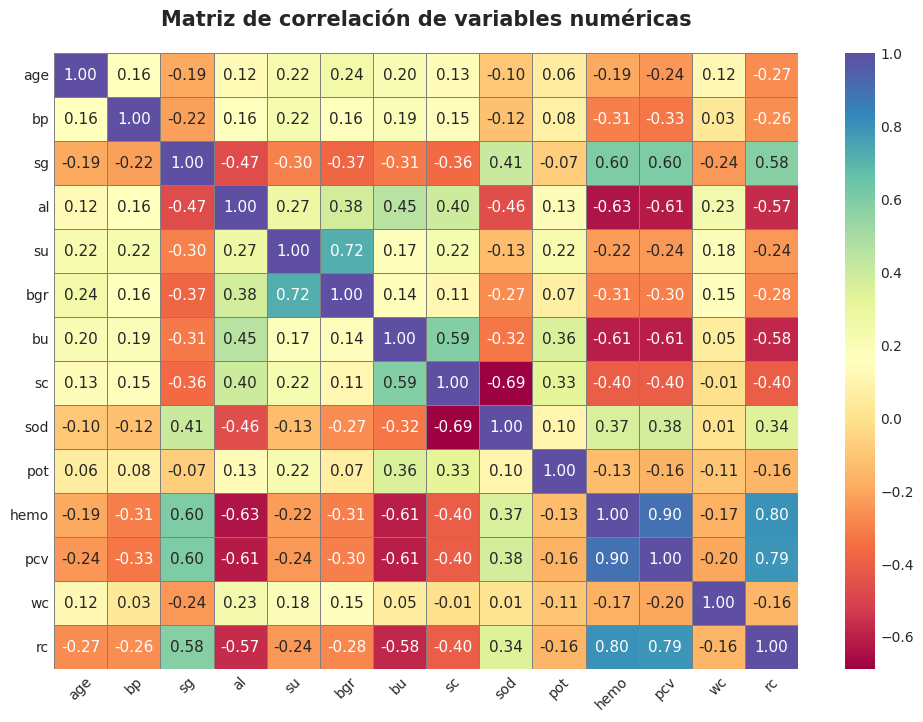

In [ ]:
plt.figure(figsize=(12, 8))
sns.heatmap(
    kidney_df[numerical_cols].corr(),
    annot=True, fmt=".2f", cmap="Spectral",
    linewidths=0.5, linecolor="gray", cbar=True
)
plt.title("Matriz de correlación de variables numéricas", fontsize=15, pad=20, fontweight='bold')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

Examinando la matriz de correlación entre las variables numéricas del conjunto de datos, podemos identificar relaciones lineales relevantes entre ellas. Algunas de estas relaciones son:

1. Parámetros hematológicos: se observó una fuerte correlación positiva entre las variables `hemo`, `pcv` y `rc`, con coeficientes de correlación superiores a 0.79. Esta asociación es esperable desde un punto de vista fisiológico, dado que estos parámetros suelen variar de forma conjunta en función del estado hematológico del paciente.

2. Función renal: la variable objetivo `bu` mostró una correlación negativa moderada con los parámetros hematológicos mencionados anteriormente (r ≈ -0.6). Esta relación sugiere que a medida que los niveles de urea aumentan (indicador típico de deterioro de la función renal) tienden a disminuir los valores de estos marcadores hematológicos, lo cual podría reflejar la aparición de anemia asociada a enfermedad renal crónica. Por otro lado, `bu` se correlaciona positivamente con `sc` (r = 0.59), lo que respalda su validez como indicador del estado renal del paciente, ya que ambas variables aumentan comúnmente en presencia de disfunción renal.

3. Electrolitos: se evidenció una correlación negativa significativa entre `sc` y `sod` (r = -0.69). Esta relación puede estar vinculada a alteraciones hidroelectrolíticas que suelen acompañar a los trastornos renales, como la hiponatremia dilucional en el contexto de insuficiencia renal.

4. Otras variables: variables como `age`, `bp` y `pot` presentan correlaciones débiles o poco significativas con la mayoría de las variables clínicas, aunque podrían tener relevancia en modelos multivariantes, especialmente al interactuar con otras variables o bajo enfoques no lineales.

### 2.4. Valores corrompidos

En este fragmento de código, nos centramos en el tratamiento de variables categóricas dentro del conjunto de datos. La limpieza y exploración de estas variables es fundamental, ya que inconsistencias como espacios en blanco pueden afectar el análisis y la modelización.

Por eso, en el primer bloque de código nos centraremos en identificar los valores únicos dentro de las variables categóricas del dataset. Los pasos para conseguirlo son:

*   Recorrer cada columna categórica dentro de `categorical_cols` con un bucle for.
*   Finalmente, `kidney_df[col].unique()` obtiene los valores únicos de cada variable categórica y los imprime.

In [ ]:
for col in categorical_cols:
    unique_vals = kidney_df[col].unique()
    print(f"Unique values in {col}: {unique_vals}")

Unique values in rbc: [nan 'normal' 'abnormal']
Unique values in pc: ['normal' 'abnormal' nan]
Unique values in pcc: ['notpresent' 'present' nan]
Unique values in ba: ['notpresent' 'present' nan]
Unique values in htn: ['yes' 'no' nan]
Unique values in dm: ['yes' 'no' ' yes' '\tno' '\tyes' nan]
Unique values in cad: ['no' 'yes' '\tno' nan]
Unique values in appet: ['good' 'poor' nan]
Unique values in pe: ['no' 'yes' nan]
Unique values in ane: ['no' 'yes' nan]
Unique values in classification: ['ckd' 'ckd\t' 'notckd']


Al revisar los valores únicos, observamos valores con espacios y tabulaciones en varias variables categóricas, como:

*   'ckd\t' en `classification`.
*   '\tno' en `cad`.
*   '\tyes', '  yes' y '\tno' en `dm`.

Estos errores pueden generar inconsistencias al analizar y modelar los datos, ya que 'ckd' y 'ckd\t' serán tratados como valores distintos.

Para solucionar estos problemas, en el siguiente bloque de código limpiamos las variables categóricas eliminando los espacios innecesarios al inicio o final de los valores. Para ello:

*   Definimos `categorical_cols_spac`, que almacena una lista con las variables categóricas de interés: "cad", "classification" y "dm".
*   Hacemos una copia del DataFrame original para no modificarlo directamente.
*   Aplicamos `str.replace(r'^\s+|\s+$', '', regex=True)` a cada columna categórica en `categorical_cols_space`, donde:
  *   `^\s+` elimina espacios en blanco o tabulaciones al inicio del texto.
  *   `\s+$` elimina espacios en blanco o tabulaciones al final del texto.
  *   `regex=True` indica que estamos usando expresiones regulares.

Esto garantiza que los valores sean uniformes y no contengan caracteres ocultos. Después de limpiar los datos, verificamos si los valores han sido corregidos comparando las versiones originales y limpias de cada variable:

*   Recorremos las mismas columnas categóricas.
*   Imprimimos los valores únicos antes y después de la limpieza para comparar.
*   Mostramos un fragmento del DataFrame limpio con `display(cleaned_kidney_df.head())` para corroborar que la limpieza se ha realizado correctamente.

In [ ]:
categorical_cols_space = ['cad', 'classification', 'dm']
cleaned_kidney_df = kidney_df.copy()

for col in categorical_cols_space:
    cleaned_kidney_df[col] = cleaned_kidney_df[col].str.replace(r'^\s+|\s+$', '', regex=True)

for col in categorical_cols_space:
    unique_vals_original = kidney_df[col].unique()
    unique_vals_cleaned = cleaned_kidney_df[col].unique()
    print(f"Original unique values in {col}: {unique_vals_original}")
    print(f"Cleaned unique values in {col}: {unique_vals_cleaned}\n")

display(cleaned_kidney_df.head())

Original unique values in cad: ['no' 'yes' '\tno' nan]
Cleaned unique values in cad: ['no' 'yes' nan]

Original unique values in classification: ['ckd' 'ckd\t' 'notckd']
Cleaned unique values in classification: ['ckd' 'notckd']

Original unique values in dm: ['yes' 'no' ' yes' '\tno' '\tyes' nan]
Cleaned unique values in dm: ['yes' 'no' nan]



,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
id,,,,,,,,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,NaN,normal,notpresent,notpresent,121.00,...,44.00,"7,800.00",5.20,yes,yes,no,good,no,no,ckd
1,7.00,50.00,1.02,4.00,0.00,NaN,normal,notpresent,notpresent,NaN,...,38.00,"6,000.00",NaN,no,no,no,good,no,no,ckd
2,62.00,80.00,1.01,2.00,3.00,normal,normal,notpresent,notpresent,423.00,...,31.00,"7,500.00",NaN,no,yes,no,poor,no,yes,ckd
3,48.00,70.00,1.00,4.00,0.00,normal,abnormal,present,notpresent,117.00,...,32.00,"6,700.00",3.90,yes,no,no,poor,yes,yes,ckd
4,51.00,80.00,1.01,2.00,0.00,normal,normal,notpresent,notpresent,106.00,...,35.00,"7,300.00",4.60,no,no,no,good,no,no,ckd


Para concluir el análisis de las variables categóricas, hemos decidido recopilar la información en una tabla resumen. Esta tabla nos permitirá visualizar de manera estructurada las características principales de cada variable categórica en el dataset ya que nos proporciona:

*   Nombre de la variable
*   Valores únicos: lista de los valores distintos que toma la variable.
*   Distribución de valores: muestra la cantidad y porcentaje de registros que corresponden a cada categoría.

In [ ]:
categorical_cols = cleaned_kidney_df.select_dtypes(include=['object']).columns
summary_df = pd.DataFrame(columns=['Variable', 'Valores únicos', 'Distribución de valores'])

for i, col in enumerate(categorical_cols):
    unique_vals = cleaned_kidney_df[col].unique()
    value_counts = cleaned_kidney_df[col].value_counts().sort_values(ascending=False)
    unique_values_str = ', '.join(map(str, unique_vals))

    total = len(cleaned_kidney_df)
    value_counts_str = '<br>'.join([
    f"{val}: {count} ({count/total:.2%})"
    for val, count in value_counts.items()
    ])

    summary_df.loc[i] = [
    col,
    unique_values_str,
    value_counts_str
    ]

styled_table = summary_df.style.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})

styled_table = styled_table.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

styled_table

,Variable,Valores únicos,Distribución de valores
0,rbc,"nan, normal, abnormal",normal: 201 (50.25%)abnormal: 47 (11.75%)
1,pc,"normal, abnormal, nan",normal: 259 (64.75%)abnormal: 76 (19.00%)
2,pcc,"notpresent, present, nan",notpresent: 354 (88.50%)present: 42 (10.50%)
3,ba,"notpresent, present, nan",notpresent: 374 (93.50%)present: 22 (5.50%)
4,htn,"yes, no, nan",no: 251 (62.75%)yes: 147 (36.75%)
5,dm,"yes, no, nan",no: 261 (65.25%)yes: 137 (34.25%)
6,cad,"no, yes, nan",no: 364 (91.00%)yes: 34 (8.50%)
7,appet,"good, poor, nan",good: 317 (79.25%)poor: 82 (20.50%)
8,pe,"no, yes, nan",no: 323 (80.75%)yes: 76 (19.00%)
9,ane,"no, yes, nan",no: 339 (84.75%)yes: 60 (15.00%)


### 2.5. Recursos visuales

En este apartado, nos enfocaremos en la creación de visualizaciones variadas y efectivas para analizar y mostrar los hallazgos del conjunto de datos de manera clara y comprensible.

El uso de gráficos nos permitirá identificar patrones, tendencias y posibles relaciones entre las variables, facilitando así la interpretación de los datos. Esto será clave para detectar valores atípicos, evaluar la distribución de los datos y obtener información valiosa que contribuirá al desarrollo de modelos predictivos eficientes.



#### 2.5.1. Variables numéricas
A continuación, se presenta un código para generar diagramas de caja (boxplots) de todas las variables numéricas del dataset utilizando la función `sns.boxplot()`. Estos diagramas son herramientas esenciales para el análisis exploratorio de datos, ya que permiten visualizar la distribución de las variables y detectar posibles anomalías. Con ellos, podemos observar:

*   Mediana: representada por la línea dentro del cuadro, indica el valor central de la distribución.
*   Media: representada por un punto naranja en nuestro caso, indica el valor promedio.
*   Cuartiles (Q1 y Q3): dividen los datos en cuatro partes iguales, proporcionando información sobre la dispersión de los valores.
*   Rango intercuartil (IQR = Q3 - Q1): mide la variabilidad de los datos, excluyendo valores extremos.
*   Valores atípicos (outliers): se representan como puntos fuera de los "bigotes" del diagrama y pueden indicar errores o casos excepcionales en los datos.

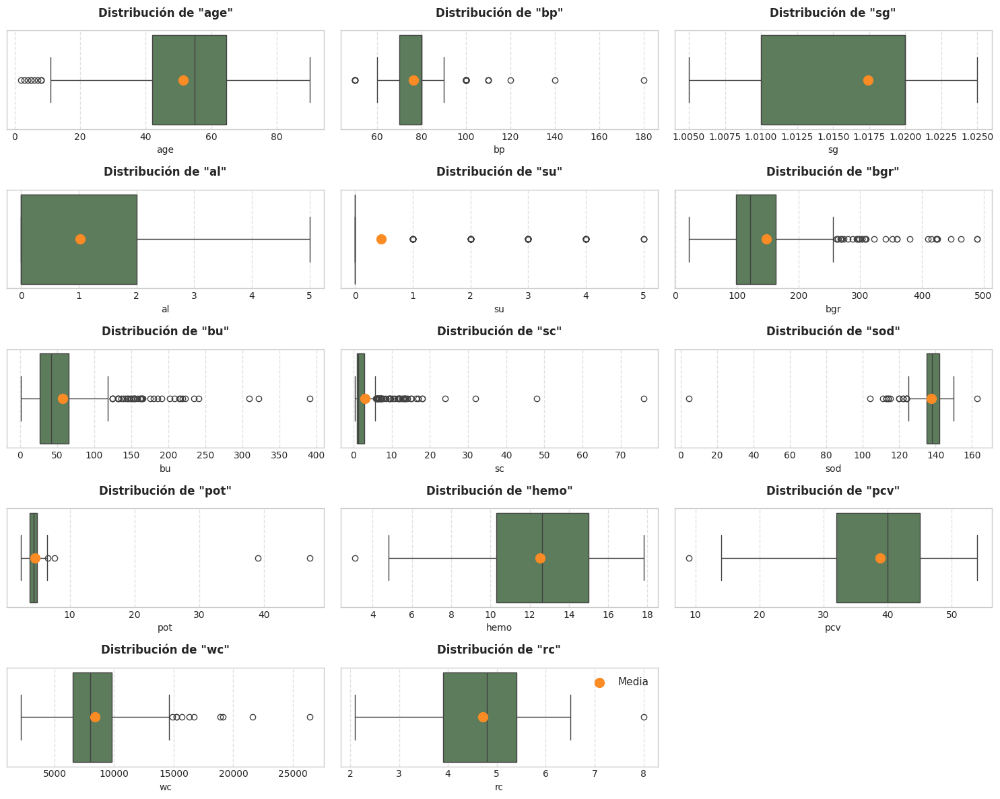

In [ ]:
num_vars = len(numerical_cols)
fig_height = max(12, num_vars * 0.5)
fig_width = 15
numerical_stats = kidney_df[numerical_cols].describe()
plt.figure(figsize=(fig_width, fig_height))

# Diagramas de caja individuales para cada columna numérica
for i, col in enumerate(numerical_cols, 1):
    plt.subplot((num_vars // 3) + 1, 3, i)
    sns.boxplot(data=kidney_df, x=col, orient='h', width=0.6, color="#588157")

    # Título y etiquetas
    plt.title(f'Distribución de "{col}"', fontsize=12, pad=15, fontweight='bold')
    plt.xlabel(f'{col}', fontsize=10)
    plt.ylabel('')
    plt.grid(axis='x', linestyle='--', alpha=0.6)

    mean_value = numerical_stats.loc['mean', col]
    plt.scatter(mean_value, 0, color='#fb8b24', zorder=10, label='Media', s=100, marker='o')
    if i == len(numerical_cols):
        plt.legend()

plt.tight_layout()
plt.show()

Para comprender mejor la distribución de nuestras variables numéricas, hemos optado por representarlas mediante histogramas. Este tipo de gráfico nos permite analizar la frecuencia con la que aparecen ciertos valores dentro de los datos, proporcionando información valiosa sobre su forma y dispersión.

El siguiente bloque de código genera histogramas, utilizando `sns.histplot()`, para todas las variables numéricas del dataset. Además, hemos decidido superponer una curva de densidad para visualizar mejor la distribución.

Para hacer un mejor análisis, hemos dibujamos líneas verticales para la media (línea punteada naranja) y la mediana (línea solida roja), lo que permite comparar la simetría de la distribución.

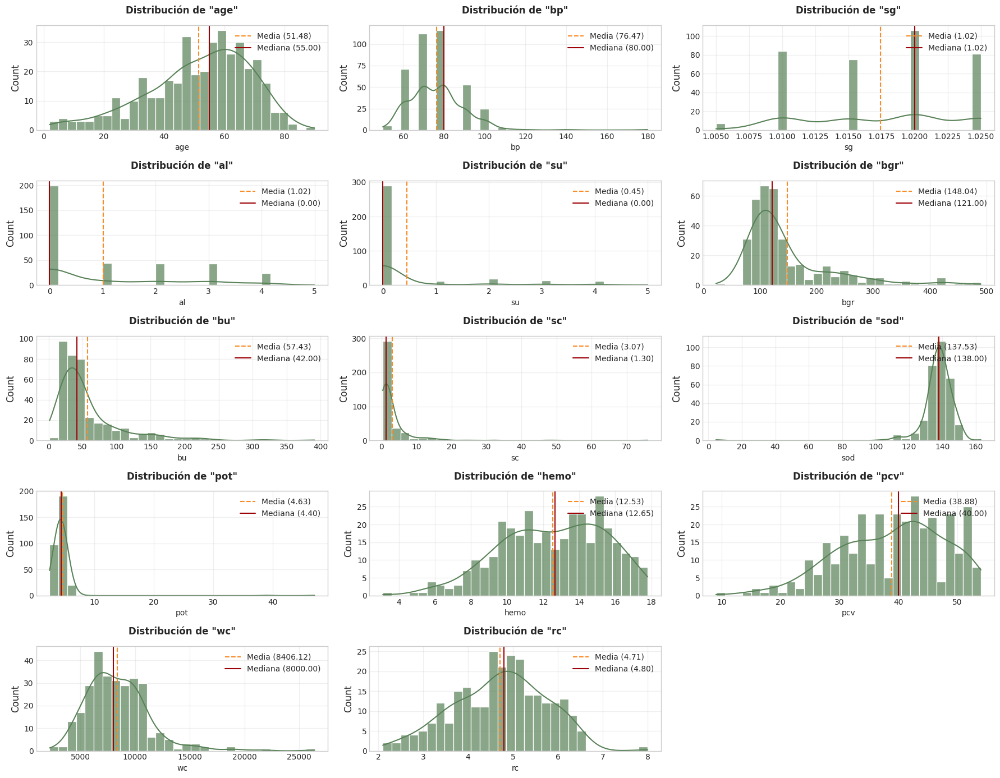

In [ ]:
mean_vals = kidney_df[numerical_cols].mean()
median_vals = kidney_df[numerical_cols].median()

plt.figure(figsize=(18, 14))
for i, col in enumerate(numerical_cols, 1):
    plt.subplot((len(numerical_cols) // 3) + 1, 3, i)
    sns.histplot(kidney_df[col].dropna(), kde=True, bins=30, color="#588157", alpha=0.7)

    # Media y mediana
    plt.axvline(mean_vals[col], color='#fb8b24', linestyle='--', label=f'Media ({mean_vals[col]:.2f})')
    plt.axvline(median_vals[col], color='#9d0208', linestyle='-', label=f'Mediana ({median_vals[col]:.2f})')
    plt.title(f'Distribución de "{col}"', fontsize=12, pad=15, fontweight='bold')
    plt.xlabel(f'{col}', fontsize=10)
    plt.legend(loc='upper right', fontsize=10)

plt.tight_layout()
plt.show()

#### 2.5.2. Variables categóricas
Ahora nos enfocaremos en las variables categóricas del dataset y, para comenzar, exploraremos su distribución mediante gráficos de barras (countplot). Este tipo de visualización nos permitirá comprender la frecuencia con la que aparecen las distintas categorías en cada variable, lo cual es fundamental para detectar posibles desequilibrios en los datos.

Para ello, utilizaremos el dataset limpio de inconsistencias y la función `sns.countplot()`. Además, para mejorar la visualización, aplicaremos una paleta de colores personalizada, lo que permitirá diferenciar claramente cada categoría.

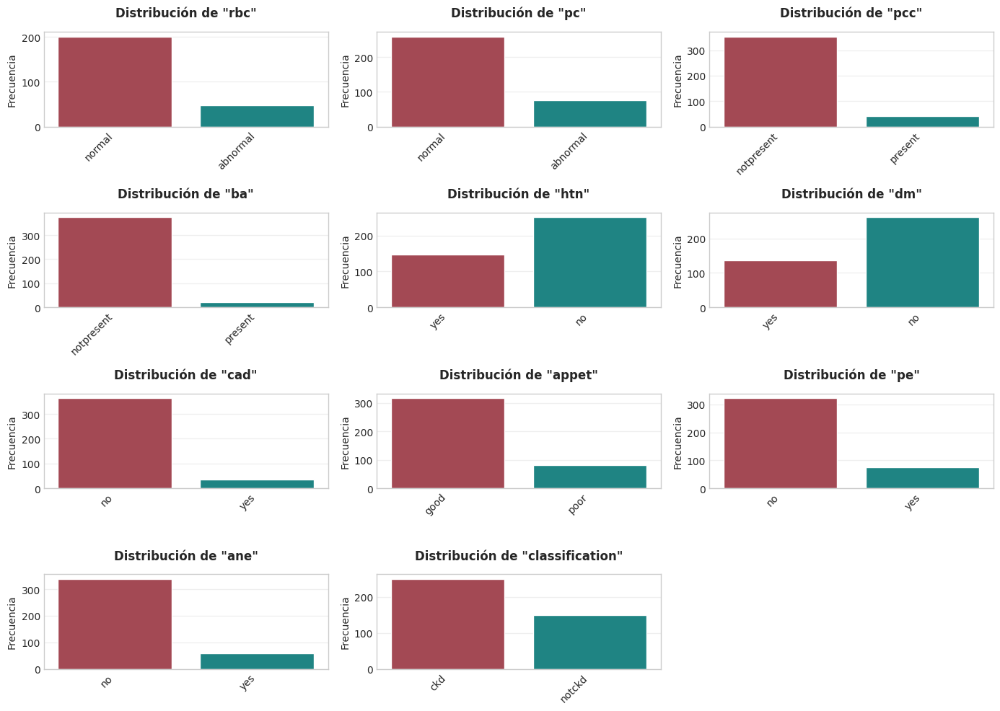

In [ ]:
categorical_cols_cleaned = cleaned_kidney_df.select_dtypes(include=['object']).columns # Datos limpios
palette_colour = ['#b23a48', '#0e9594']

plt.figure(figsize=(14, 10))
for i, col in enumerate(categorical_cols_cleaned, 1):
    plt.subplot((len(categorical_cols_cleaned) // 3) + 1, 3, i)
    sns.countplot(x=cleaned_kidney_df[col], hue=cleaned_kidney_df[col], palette=palette_colour, legend=False)
    plt.title(f'Distribución de "{col}"', fontsize=12, pad=15, fontweight='bold')
    plt.xlabel('')
    plt.ylabel('Frecuencia', fontsize=10)
    plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()


Como complemento a este análisis, también realizaremos gráficos de pastel (pie charts) utilizando `plt.pie()`. Para mantener la coherencia visual, emplearemos la misma paleta de colores utilizada en los gráficos de barras.

Los gráficos de pastel nos ayudarán a representar la proporción de cada categoría dentro de una variable, permitiendo identificar de forma intuitiva si alguna categoría predomina sobre las demás o si la distribución es equilibrada.




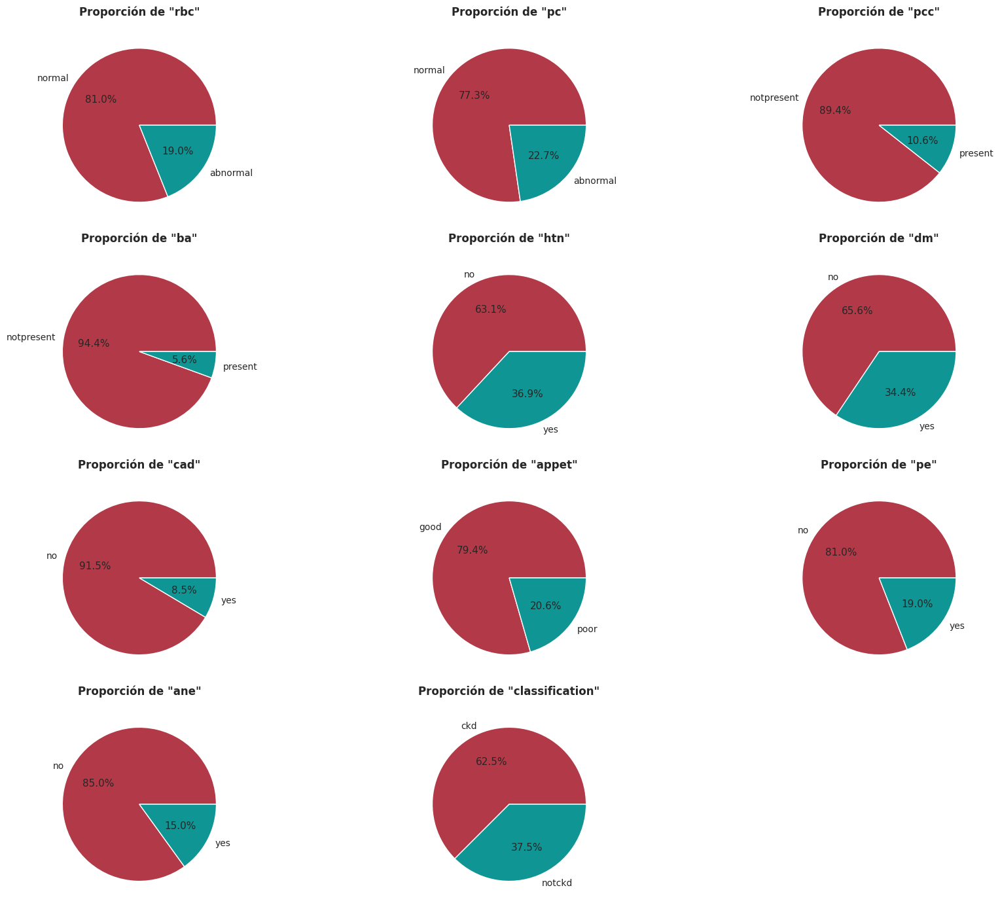

In [ ]:
plt.figure(figsize=(18, 14))
for i, col in enumerate(categorical_cols_cleaned, 1):
    plt.subplot((len(categorical_cols_cleaned) // 3) + 1, 3, i)
    category_counts = cleaned_kidney_df[col].value_counts()
    plt.pie(category_counts, labels=category_counts.index, autopct='%1.1f%%', colors=palette_colour)
    plt.title(f'Proporción de "{col}"', fontsize=12, pad=15, fontweight='bold')

plt.tight_layout()
plt.show()

Para finalizar la representación de las variables categóricas, realizaremos un conteo de frecuencia de cada categoría dentro de las variables categóricas del dataset limpio. Esto nos permitirá identificar posibles desequilibrios en la distribución de categorías y detectar valores poco frecuentes que podrían afectar el análisis o el modelado.

Para lograrlo, utilizamos `apply(lambda x: x.value_counts())`, que calcula el número de apariciones de cada categoría en cada variable.

In [ ]:
categorical_counts = cleaned_kidney_df[categorical_cols_cleaned].apply(lambda x: x.value_counts())

print("\n🔹 Frecuencia de las variables categóricas (limpias):\n")
display(categorical_counts)


🔹 Frecuencia de las variables categóricas (limpias):



,rbc,pc,pcc,ba,htn,dm,cad,appet,pe,ane,classification
abnormal,47.00,76.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ckd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,250.00
good,NaN,NaN,NaN,NaN,NaN,NaN,NaN,317.00,NaN,NaN,NaN
no,NaN,NaN,NaN,NaN,251.00,261.00,364.00,NaN,323.00,339.00,NaN
normal,201.00,259.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
notckd,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,150.00
notpresent,NaN,NaN,354.00,374.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
poor,NaN,NaN,NaN,NaN,NaN,NaN,NaN,82.00,NaN,NaN,NaN
present,NaN,NaN,42.00,22.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
yes,NaN,NaN,NaN,NaN,147.00,137.00,34.00,NaN,76.00,60.00,NaN


#### 2.5.3. Ausencia de datos
En esta sección, nos centraremos en la identificación y cuantificación de valores faltantes en el dataset. Este análisis es fundamental, ya que la presencia de valores nulos puede afectar significativamente la calidad de los resultados y el rendimiento de los modelos predictivos.

Para ello, realizamos las siguientes acciones:

*   Calculamos los valores faltantes (`cleaned_kidney_df.isnull().sum()`) y su porcentaje (`missing_percentage = (missing_data / total_registros) * 100`).
*   Identificamos las columnas con y sin valores faltantes, que corresponden a  `columnas_con_faltantes` y `columnas_sin_faltantes` respectivamente.
*   Creamos un DataFrame resumen con la información detallada sobre cada variable, incluyendo:
    *   Número total de registros en el dataset.
    *   Cantidad y porcentaje de valores faltantes.
    *   Cantidad y porcentaje de valores válidos (no nulos).

In [ ]:
# Calcular valores faltantes y porcentajes
total_registros = len(cleaned_kidney_df)
missing_data = cleaned_kidney_df.isnull().sum()
missing_percentage = (missing_data / total_registros) * 100

# Crear DataFrame de resumen
resumen_faltantes = pd.DataFrame({
    'Variable': missing_data.index,
    'Valores totales': total_registros,
    'Valores faltantes': [f"{val} ({pct:.2f}%)" for val, pct in zip(missing_data, missing_percentage)],
    'Valores válidos': [f"{total_registros - val} ({(100 - pct):.2f}%)" for val, pct in zip(missing_data, missing_percentage)]
})

# Mostrar información resumida
print(f"\nTotal de columnas: {len(cleaned_kidney_df.columns)}")
print(f"Total de registros: {total_registros}")

columnas_con_faltantes = cleaned_kidney_df.columns[missing_data > 0]
print(f"\nNúmero de columnas con datos faltantes: {len(columnas_con_faltantes)}")
print(f"Columnas con datos faltantes: {columnas_con_faltantes.tolist()}")

columnas_sin_faltantes = cleaned_kidney_df.columns[missing_data == 0]
print(f"\nNúmero de columnas sin valores faltantes: {len(columnas_sin_faltantes)}")
print(f"Columnas sin valores faltantes: {columnas_sin_faltantes.tolist()}")

print("\n🔹 Resumen completo:\n")

styled_table2 = resumen_faltantes.style.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})
styled_table2 = styled_table2.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

styled_table2


Total de columnas: 25
Total de registros: 400

Número de columnas con datos faltantes: 24
Columnas con datos faltantes: ['age', 'bp', 'sg', 'al', 'su', 'rbc', 'pc', 'pcc', 'ba', 'bgr', 'bu', 'sc', 'sod', 'pot', 'hemo', 'pcv', 'wc', 'rc', 'htn', 'dm', 'cad', 'appet', 'pe', 'ane']

Número de columnas sin valores faltantes: 1
Columnas sin valores faltantes: ['classification']

🔹 Resumen completo:



,Variable,Valores totales,Valores faltantes,Valores válidos
0,age,400,9 (2.25%),391 (97.75%)
1,bp,400,12 (3.00%),388 (97.00%)
2,sg,400,47 (11.75%),353 (88.25%)
3,al,400,46 (11.50%),354 (88.50%)
4,su,400,49 (12.25%),351 (87.75%)
5,rbc,400,152 (38.00%),248 (62.00%)
6,pc,400,65 (16.25%),335 (83.75%)
7,pcc,400,4 (1.00%),396 (99.00%)
8,ba,400,4 (1.00%),396 (99.00%)
9,bgr,400,44 (11.00%),356 (89.00%)


Para complementar el análisis de valores faltantes, utilizaremos diversas visualizaciones gráficas que nos ayudarán a entender mejor la distribución de los datos faltantes y detectar patrones de ausencia de los datos del dataset.

En este primer caso, crearemos un mapa de calor de valores faltantes utilizando `seaborn.heatmap()`. Este gráfico nos ayuda a visualizar la distribución de los valores nulos, lo que facilita la detección de patrones en los datos ausentes.

Además, hemos definido una paleta de colores personalizada para mejorar la interpretación del gráfico:

*   Azul: representa los valores presentes en el dataset.
*   Amarillo: representa los valores faltantes (NaN).


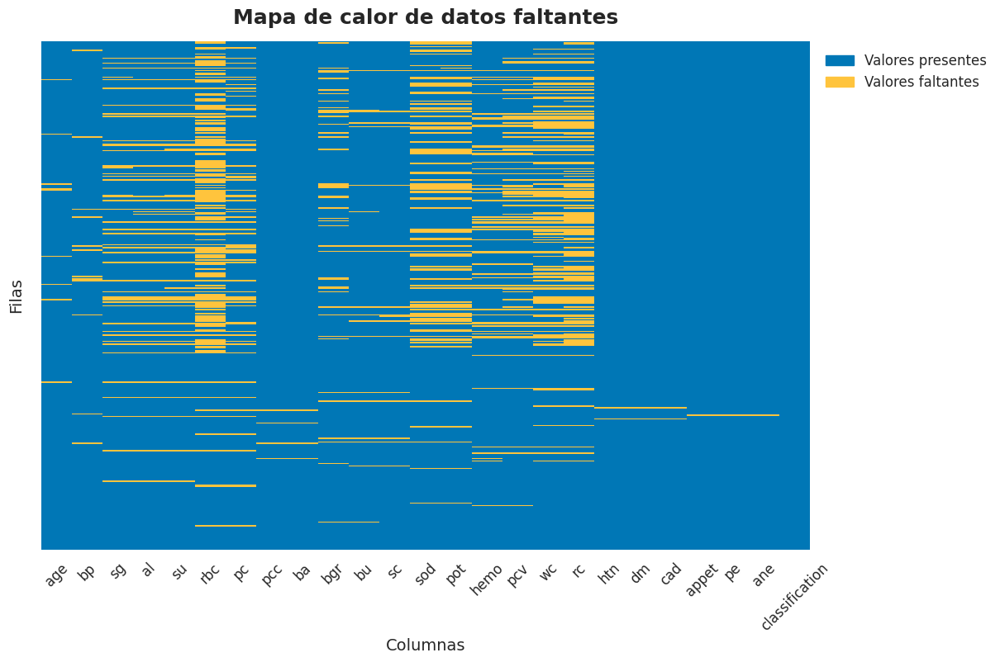

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

sns.set(style="whitegrid")

paleta_colores = ['#0077b6', '#ffc43d']

plt.figure(figsize=(12, 8))
ax = sns.heatmap(cleaned_kidney_df.isnull(), cmap=paleta_colores, cbar=False, xticklabels=True, yticklabels=False)
legend_labels = [Patch(color='#0077b6', label='Valores presentes'),
                 Patch(color='#ffc43d', label='Valores faltantes')]

plt.legend(handles=legend_labels, bbox_to_anchor=(1.005, 1), loc='upper left', fontsize=12)
plt.title('Mapa de calor de datos faltantes', fontsize=18, pad=15, fontweight='bold')
plt.xlabel('Columnas', fontsize=14)
plt.ylabel('Filas', fontsize=14, labelpad=15)
plt.xticks(fontsize=12, rotation=45)
plt.show()


Al examinar el mapa de calor de los datos faltantes, podemos identificar patrones sistemáticos de ausencia de información, lo que indica que los datos no están distribuidos de forma aleatoria. Este hallazgo tiene importantes implicancias para el análisis posterior y la construcción de modelos predictivos.

1. Patrones por columnas: se observa una alta proporción de valores ausentes en variables como `rbc`, `pc`, `pcc`, `ba`, `sod`, `pot`, `hemo`, `pcv`, `wc` y `rc`. Estas variables están asociadas principalmente a análisis clínicos de laboratorio, tales como pruebas hematológicas, de orina y electrolitos. La coincidencia en los patrones de ausencia entre estas columnas sugiere que las pruebas correspondientes no fueron realizadas o registradas en ciertos pacientes. Las causas pueden ser diversas, incluyendo decisiones clínicas, limitaciones administrativas, o recursos disponibles en el momento de la atención.

2. Patrones por filas: se identifican registros de pacientes con múltiples valores faltantes simultáneamente, lo que apunta a una ausencia estructurada de información en determinados individuos. Es posible que estos pacientes no hayan sido sometidos a todas las evaluaciones médicas por factores como el estado clínico, la fase de seguimiento, limitaciones logísticas, o incluso la priorización de pruebas diagnósticas en contextos de atención médica limitada.

3. Relación potencial con otras variables: aunque el mapa de calor no permite establecer directamente la relación con la variable objetivo `classification`, la concentración de valores ausentes en variables clínicas sugiere que podría haber una relación indirecta con el estado general del paciente. Por ejemplo, pacientes con enfermedad menos avanzada podrían no haber requerido ciertas pruebas, mientras que en pacientes con mayor complejidad clínica se habrían realizado estudios más completos.

El patrón de datos faltantes podria tener ciertas limitaciones:
*   Posible sesgo de selección: la ausencia no aleatoria puede introducir sesgos en el análisis, especialmente si se ignora la causa estructural de los datos faltantes. Los modelos predictivos podrían sobreajustarse a subconjuntos no representativos de la población.
*   Pérdida de información valiosa: la eliminación directa de filas o columnas con grandes cantidades de datos faltantes podría resultar en la pérdida de casos clínicamente relevantes o de variables predictoras clave.
*   Necesidad de estrategias de imputación sofisticadas: dada la naturaleza estructurada de los datos faltantes, lo ideas sería aplicar técnicas de imputación inteligentes y contextualizadas, que consideren la naturaleza de la variable (numérica o categórica) y su relación con otras columnas.

En resumen, el análisis de los datos faltantes evidencia patrones sistemáticos vinculados a variables clínicas específicas y a determinados subgrupos de pacientes. Debemos gestionar cuidadosamente esta ausencia no aleatoria para así minimizar sesgos y preservar la integridad de los análisis posteriores.

Moviendonos a la siguiente sección, utilizaremos la biblioteca missingno (`msno`) para representar gráficamente los valores nulos en el dataset.

En la siguinete celda realizaremos una matriz de nulidad (`msno.matrix()`). Este gráfico muestra los datos como una matriz binaria y nos puede ayudar a detectar patrones en los valores nulos. En este tipo de diagrama las líneas blancas representan los valores faltantes y las negras los datos completos en las filas.


<Figure size 1200x800 with 0 Axes>

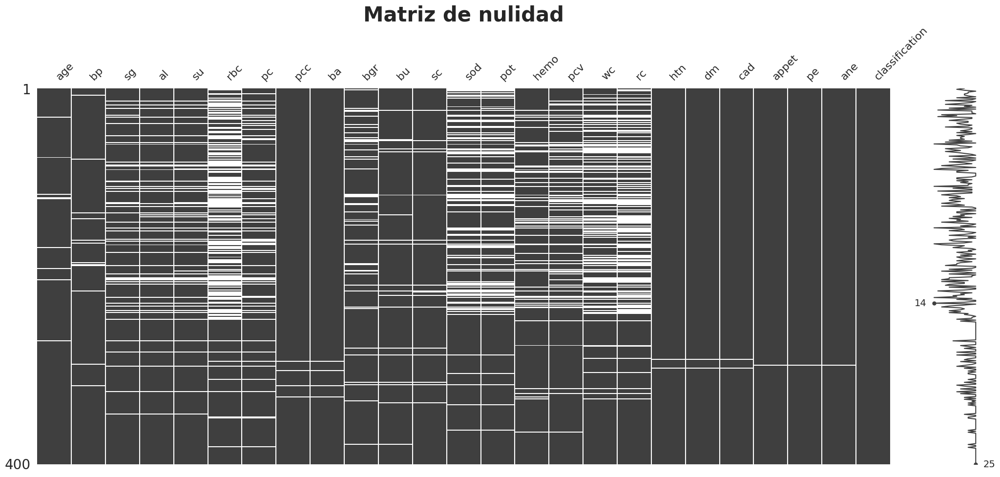

In [ ]:
from missingno import matrix
import missingno as msno
plt.figure(figsize=(12, 8))
msno.matrix(cleaned_kidney_df)
plt.title('Matriz de nulidad', fontsize=30, fontweight='bold')
plt.show()

A continuación encontramos la creación de un mapa de calor (`heatmap()`) en el que se muestra la correlación entre los valores nulos de las variables. Su funcionamiento consiste en que:

*   Valores cercanos a 1 (amarillo) indican que cuando una columna tiene un valor nulo, la otra también tiende a tenerlo.
*   Valores más bajos (azules) indican poca relación en la ausencia de datos.

<Figure size 1200x800 with 0 Axes>

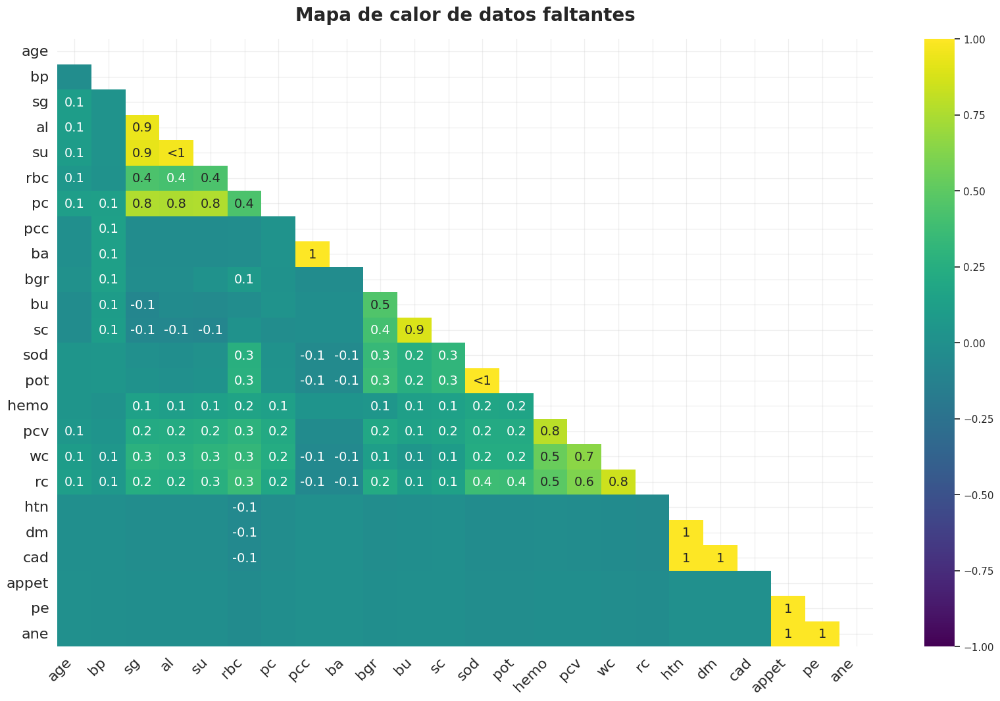

In [ ]:
plt.figure(figsize=(12, 8))
msno.heatmap(cleaned_kidney_df, cmap='viridis')
plt.title('Mapa de calor de datos faltantes', fontsize=20, pad=20, fontweight='bold')
plt.show()

Seguidamente tenemos un gráfico de barras (`msno.bar()`) que representa la cantidad de valores no nulos en cada columna.

Las barras más altas indican menos valores faltantes, mientras que las más bajas muestran variables con más datos ausentes.

Este tipo de diagrama nos puede ser útil para identificar variables que pueden requerir imputación o eliminación.

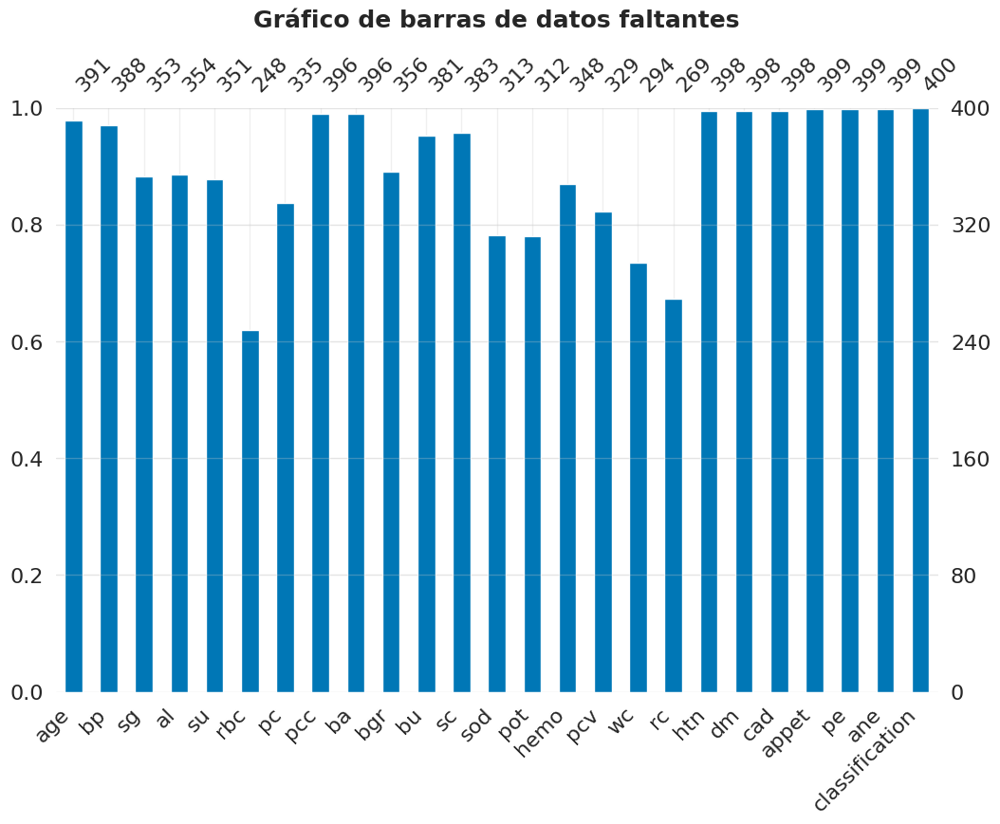

In [ ]:
plt.figure(figsize=(12, 8))
msno.bar(cleaned_kidney_df, color='#0077b6', figsize=(12, 8))
plt.title('Gráfico de barras de datos faltantes', fontsize=18, pad=20, fontweight='bold')
plt.show()

Finalmente, realizamos un dendrograma (`msno.dendrogram()`) que muestra una agrupación jerárquica de las variables basada en la similitud en sus valores nulos. Gracias a el podemos entender qué variables tienen patrones similares de datos ausentes y pueden ser analizadas en conjunto.

Las agrupaciones en una misma rama indican que esas variables tienen un comportamiento similar respecto los valores faltantes.

<Figure size 1000x800 with 0 Axes>

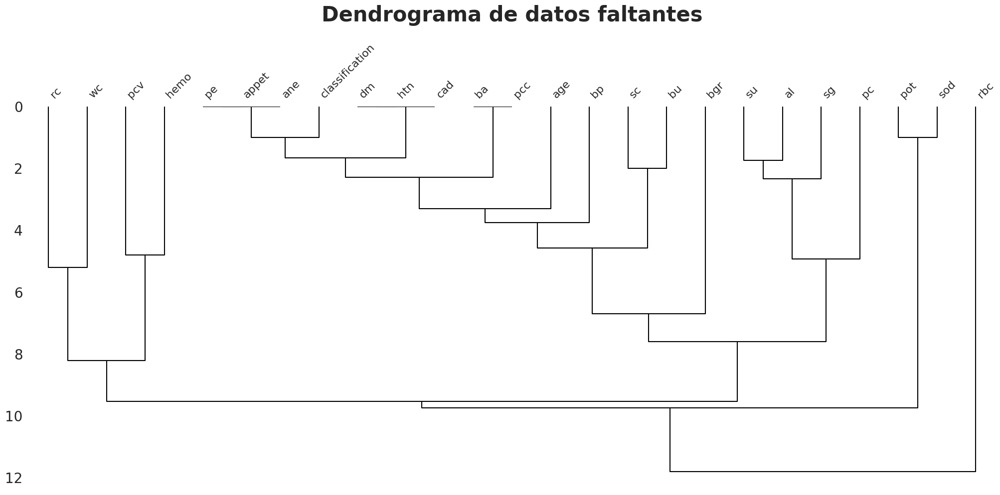

In [ ]:
plt.figure(figsize=(10, 8))
msno.dendrogram(cleaned_kidney_df)
plt.title('Dendrograma de datos faltantes', fontsize=30, pad=30, fontweight='bold')
plt.show()

#### 2.5.4. Variable objetivo y relaciones entre variables

A continuación, nos enfocaremos en analizar nuestra variable objetivo "bu", mencionada previamente en la introducción. Este análisis descriptivo univariable nos permitirá comprender su distribución y sus características estadísticas clave.

Para ello, realizaremos las siguientes acciones:
*   Cálculo de medidas estadísticas como media, mediana, moda, rango, varianza y curtosis.
*   Análisis de asimetría y curtosis para entender la forma de la distribución.
*   Visualización de la distribución de "bu" mediante histogramas, gráficos de densidad y boxplots.





📊 Análisis estadístico para "bu":

🔹 Medidas de tendencia central:
   • Media: 57.426
   • Mediana: 42.000
   • Moda: 46.000
🔹 Medidas de dispersión:
   • Desviación estándar: 50.503
   • Varianza: 2550.554
   • Rango: 389.500
   • Rango intercuartílico (IQR): 39.000
🔹 Valores extremos:
   • Mínimo: 1.500
   • Máximo: 391.000
   • Primer cuartil (Q1): 27.000
   • Tercer cuartil (Q3): 66.000
🔹 Forma de la distribución:
   • Asimetría: 2.624 (positiva)
   • Curtosis: 9.207 (leptocúrtica)



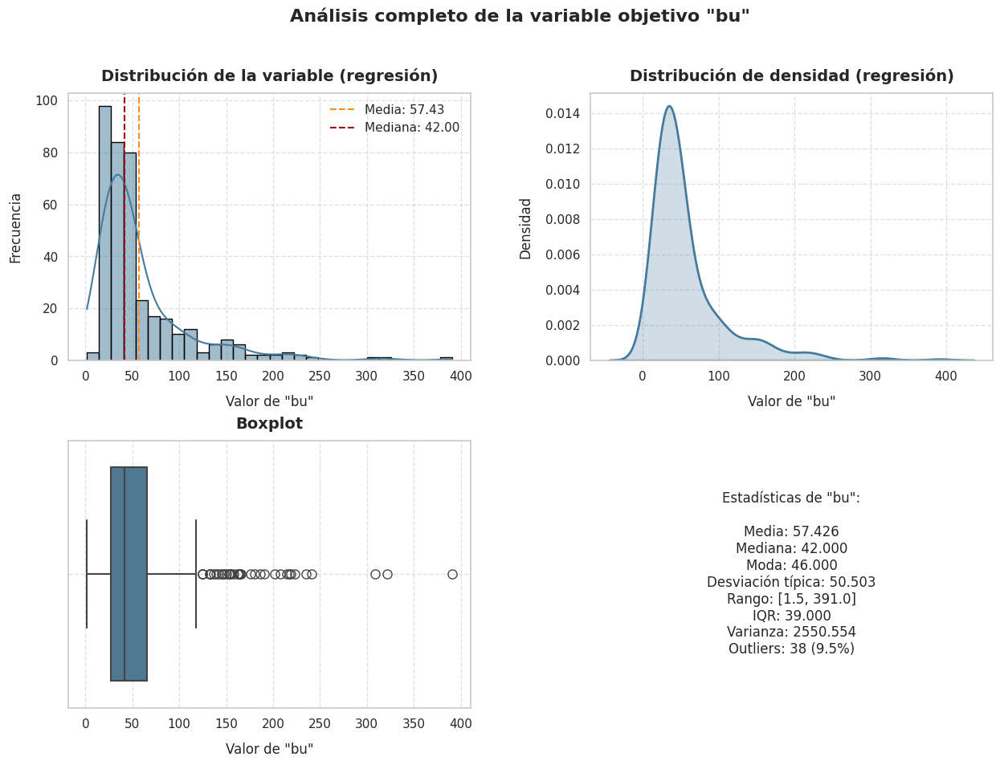

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

media = cleaned_kidney_df["bu"].mean()
mediana = cleaned_kidney_df["bu"].median()
moda = cleaned_kidney_df["bu"].mode()[0]
desviacion_tipica = cleaned_kidney_df["bu"].std()
var = cleaned_kidney_df["bu"].var()
min_val = cleaned_kidney_df["bu"].min()
max_val = cleaned_kidney_df["bu"].max()
rango = max_val - min_val
iqr = cleaned_kidney_df["bu"].quantile(0.75) - cleaned_kidney_df["bu"].quantile(0.25)
varianza = cleaned_kidney_df["bu"].var()
asimetria = stats.skew(cleaned_kidney_df["bu"].dropna())
curtosis = stats.kurtosis(cleaned_kidney_df["bu"].dropna())
q1 = cleaned_kidney_df["bu"].quantile(0.25)
q3 = cleaned_kidney_df["bu"].quantile(0.75)

# Mostrar las medidas
print(f'''
📊 Análisis estadístico para "bu":\n
🔹 Medidas de tendencia central:
   • Media: {media:.3f}
   • Mediana: {mediana:.3f}
   • Moda: {moda:.3f}
🔹 Medidas de dispersión:
   • Desviación estándar: {desviacion_tipica:.3f}
   • Varianza: {var:.3f}
   • Rango: {rango:.3f}
   • Rango intercuartílico (IQR): {iqr:.3f}
🔹 Valores extremos:
   • Mínimo: {min_val:.3f}
   • Máximo: {max_val:.3f}
   • Primer cuartil (Q1): {q1:.3f}
   • Tercer cuartil (Q3): {q3:.3f}
🔹 Forma de la distribución:
   • Asimetría: {asimetria:.3f} ({'positiva' if asimetria > 0 else 'negativa' if asimetria < 0 else 'simétrica'})
   • Curtosis: {curtosis:.3f} ({'leptocúrtica' if curtosis > 0 else 'platicúrtica' if curtosis < 0 else 'mesocúrtica'})
''')

lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = cleaned_kidney_df[(cleaned_kidney_df["bu"] < lower_bound) | (cleaned_kidney_df["bu"] > upper_bound)]["bu"]

fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.tight_layout(pad=6.0)
plt.subplots_adjust(hspace=0.3)

# Histograma de la variable 'bu'
sns.histplot(cleaned_kidney_df['bu'], kde=True, color='#457b9d', bins=30, edgecolor='black', ax=axes[0, 0])
axes[0, 0].axvline(media, color='#fb8b24', linestyle='--', linewidth=1.5, label=f"Media: {media:.2f}")
axes[0, 0].axvline(mediana, color='#9d0208', linestyle='--', linewidth=1.5, label=f"Mediana: {mediana:.2f}")
axes[0, 0].legend(loc='upper right')
axes[0, 0].set_title('Distribución de la variable (regresión)', fontsize=14, pad=11, fontweight='bold')
axes[0, 0].set_xlabel('Valor de "bu"', fontsize=12, labelpad=11)
axes[0, 0].set_ylabel('Frecuencia', fontsize=12, labelpad=11)
axes[0, 0].grid(True, linestyle='--', alpha=0.6)

# Gráfico de Densidad (KDE)
sns.kdeplot(cleaned_kidney_df['bu'], fill=True, color='#457b9d', linewidth=2, ax=axes[0, 1])
axes[0, 1].set_title('Distribución de densidad (regresión)', fontsize=14, pad=11, fontweight='bold')
axes[0, 1].set_xlabel('Valor de "bu"', fontsize=12, labelpad=11)
axes[0, 1].set_ylabel('Densidad', fontsize=12, labelpad=11)
axes[0, 1].grid(True, linestyle='--', alpha=0.6)

# Boxplot para identificar valores atípicos
sns.boxplot(x=cleaned_kidney_df['bu'], color='#457b9d', fliersize=8, linewidth=1.5, ax=axes[1, 0])
axes[1, 0].set_title('Boxplot', fontsize=14, pad=11, fontweight='bold')
axes[1, 0].set_xlabel('Valor de "bu"', fontsize=12, labelpad=11)
axes[1, 0].grid(True, linestyle='--', alpha=0.6)

# Histograma con valores descriptivos
axes[1, 1].text(0.5, 0.5, f"""
Estadísticas de "bu":\n
Media: {media:.3f}
Mediana: {mediana:.3f}
Moda: {moda:.3f}
Desviación típica: {desviacion_tipica:.3f}
Rango: [{min_val:.1f}, {max_val:.1f}]
IQR: {iqr:.3f}
Varianza: {varianza:.3f}
Outliers: {len(outliers)} ({(len(outliers) / len(cleaned_kidney_df)) * 100:.1f}%)
""", horizontalalignment='center', verticalalignment='center', fontsize=12)
axes[1, 1].axis('off')  # Apagar los ejes ya que es solo texto

plt.suptitle(f'Análisis completo de la variable objetivo "bu"', fontsize=16, fontweight='bold', y=1)
plt.show()

Hacer este tipo de análisis exploratorio no solo nos permite comprender el comportamiento estadístico de nuestra variable objetivo, sino que resulta esencial para definir estrategias de imputación, selección de modelos y técnicas de transformación adecuadas en el flujo de trabajo analítico.

La comparación entre la media (57.43) y la mediana (42.00) revela una distribución claramente asimétrica hacia la derecha, lo cual es corroborado por la presencia de valores extremos en el rango superior. Esta asimetría positiva sugiere que una proporción reducida de pacientes presenta niveles de urea considerablemente elevados, lo cual podría estar asociado a estados avanzados de insuficiencia renal.

La alta desviación estándar (50.50) y la amplitud del rango (de 1.5 a 391.0) indican una gran dispersión en los valores de la variable, lo cual podría afectar negativamente a modelos sensibles a la escala o a la normalidad de los datos. La detección de outliers en un 9.5% de los casos refuerza esta observación y subraya la necesidad de considerar transformaciones o técnicas de manejo específicas.



Después de haber analizado en profundidad nuestra variable objetivo "bu" y comprendido su distribución, hemos decidido explorar de manera más amplia las relaciones entre las distintas variables numéricas del conjunto de datos. Este análisis visual nos permite identificar patrones, posibles relaciones lineales o no lineales, y detectar potenciales outliers que podrían afectar el rendimiento de los modelos predictivos.

Para ello, hemos generado una serie de diagramas de dispersión que muestran las relaciones entre todos los pares posibles de variables numéricas presentes en el dataset. Esto incluye, por ejemplo, la relación entre albúmina y gravedad específica de la orina, o entre edad y niveles de azúcar en sangre, entre otras.

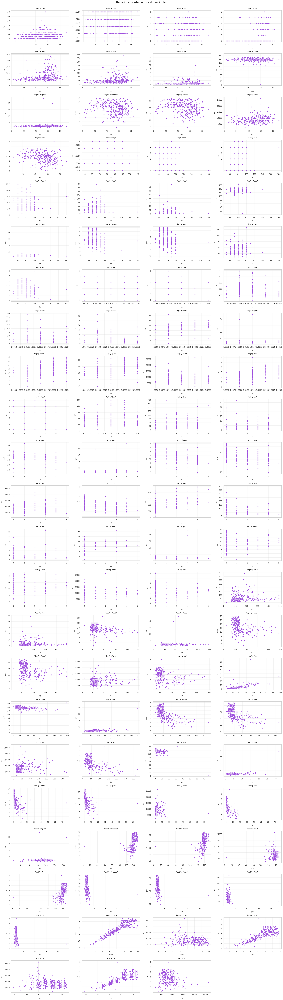

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from itertools import combinations

# Obtener las variables numéricas
numeric_columns = cleaned_kidney_df.select_dtypes(include=[np.number]).columns.tolist()

# Generar todas las combinaciones posibles de pares
all_combinations = list(combinations(numeric_columns, 2))

# Calcular número de filas y columnas necesarias para el subplots grid
n_plots = len(all_combinations)
n_cols = 4
n_rows = int(np.ceil(n_plots / n_cols))

# Crear la figura y los subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(25, 4 * n_rows))
fig.tight_layout(pad=6.0)
plt.subplots_adjust(hspace=0.5, wspace=0.4)

# Aplanar el array de ejes
axes = axes.flatten()

# Crear cada gráfico de dispersión
for i, (var1, var2) in enumerate(all_combinations):
    if i < len(axes):
        ax = axes[i]

        sns.scatterplot(x=cleaned_kidney_df[var1], y=cleaned_kidney_df[var2], color='#9d4edd', ax=ax)
        ax.set_title(f'"{var1}" y "{var2}"', fontsize=10, pad=10, fontweight='bold')
        ax.set_xlabel(var1, fontsize=9, labelpad=10)
        ax.set_ylabel(var2, fontsize=9, labelpad=10)

# Ocultar los subplots vacíos
for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.suptitle('Relaciones entre pares de variables', fontsize=16, fontweight='bold', y=0.95)
plt.tight_layout(rect=[0, 0, 1, 0.95])  # Ajuste para que el título principal no se superponga
plt.show()

## 3. Limpieza de datos y preprocesamiento

### 3.1. Eliminación de inconsistencias en las variables categóricas

En esta sección se describe el proceso de limpieza aplicado a ciertas variables categóricas del conjunto de datos, con el objetivo de mejorar la calidad y coherencia de los valores registrados que serán utilizados en las siguientes etapas del análisis. Tal como se explicó en el apartado 2.2, esta fase resulta fundamental, ya que la presencia de inconsistencias o errores en los datos puede comprometer la correcta agrupación de categorías, generar valores redundantes y distorsionar los resultados del análisis.

El enfoque principal consistió en identificar y corregir  variaciones sutiles en algunas columnas categóricas, en este caso: `'cad'`, `'classification'` y `'dm'`. Estas columnas presentaban variaciones no deseadas producto de espacios en blanco al inicio o final de las cadenas de texto. Este tipo de errores suele originarse por la introducción manual de datos o por inconsistencias al unificar información proveniente de diferentes fuentes.

Para abordar este problema, se implementó una estrategia de normalización textual, utilizando expresiones regulares en combinación con la función `replace()` de pandas. En concreto, se aplicó la eliminación de espacios en blanco al principio y al final de cada valor categórico mediante la expresión `r'^\s+|\s+$'`.

### 3.2. Imputación

En este apartado nos centraremos en el tratamiento de los valores faltantes presentes en el conjunto de datos, los cuales ya fueron identificados y analizados en detalle en el apartado 2.5. La presencia de valores nulos puede comprometer la calidad del análisis y afectar negativamente la precisión de los modelos predictivos.

La imputación de valores faltantes consiste en reemplazar dichos valores ausentes por estimaciones razonables, basadas en la información disponible en el conjunto de datos. El objetivo principal de esta técnica es evitar la pérdida de información valiosa y preservar la estructura del dataset, minimizando los sesgos que podrían generarse si se eliminaran directamente las observaciones incompletas.

Para llevar a cabo este proceso, se aplicarán distintas estrategias de imputación, seleccionadas en función del tipo de variable (categórica o numérica). Además, como veremos más adelante, cada uno de los métodos presenta ventajas y limitaciones, tanto en términos de simplicidad como de impacto en la distribución de los datos. Por ello, a lo largo de esta sección, se analizará la conveniencia de cada técnica en función de distintos parámetros.

#### 3.2.1. Variables numéricas

Como primer paso en el proceso de imputación, abordaremos las variables numéricas que presentan valores faltantes. Antes de decidir qué técnica aplicar, es fundamental realizar un análisis exploratorio que nos permita identificar qué columnas están afectadas y en qué medida, para así cuantificar la magnitud del problema.

Para ello, mediante el siguiente fragmento de código, se obtiene un resumen claro de la cantidad y el porcentaje de valores faltantes en cada una de las columnas numéricas del conjunto de datos.

In [ ]:
# Obtener las columnas numéricas con valores NA
numerical_cols_with_na = cleaned_kidney_df.select_dtypes(include=['number']).columns[
    cleaned_kidney_df.select_dtypes(include=['number']).isna().any()
].tolist()

# Obtener el total de registros (filas) en el DataFrame
total_registros = len(cleaned_kidney_df)

# Calcular el número de valores NA por columna numérica
na_counts = cleaned_kidney_df[numerical_cols_with_na].isna().sum()
na_percentages = (na_counts / total_registros) * 100

# Crear DataFrame de resumen
resumen_faltantes = pd.DataFrame({
    'Variable': numerical_cols_with_na,
    'Valores totales': total_registros,
    'Valores faltantes': [f"{val} ({pct:.2f}%)" for val, pct in zip(na_counts, na_percentages)],
    'Valores válidos': [f"{total_registros - val} ({(100 - pct):.2f}%)" for val, pct in zip(na_counts, na_percentages)]
})

print("🔹 Resumen completo de las variables numéricas:\n")

styled_table3 = resumen_faltantes.style.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})

styled_table3 = styled_table3.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

styled_table3

🔹 Resumen completo de las variables numéricas:



,Variable,Valores totales,Valores faltantes,Valores válidos
0,age,400,9 (2.25%),391 (97.75%)
1,bp,400,12 (3.00%),388 (97.00%)
2,sg,400,47 (11.75%),353 (88.25%)
3,al,400,46 (11.50%),354 (88.50%)
4,su,400,49 (12.25%),351 (87.75%)
5,bgr,400,44 (11.00%),356 (89.00%)
6,bu,400,19 (4.75%),381 (95.25%)
7,sc,400,17 (4.25%),383 (95.75%)
8,sod,400,87 (21.75%),313 (78.25%)
9,pot,400,88 (22.00%),312 (78.00%)


Una de las formas más comunes y sencillas de abordar los valores faltantes en este tipo de variables es mediante la imputación por media o mediana. Estas técnicas consisten en sustituir los valores nulos por el valor medio o mediano de cada variable, respectivamente.

El siguiente bloque de código imputa los valores faltantes en columnas numéricas utilizando las estrategias de media y mediana, ofreciendo además herramientas de validación cruzada y visualización diagnóstica para evaluar la calidad de la imputación.

Es por ello que se ha creado la función `impute_with_strategy()` la cual generaliza la imputación utilizando `SimpleImputer` de `sklearn`, y ofrece múltiples utilidades:
1.   Selección de columnas numéricas con valores faltantes.
2.   Aplicación de la estrategia seleccionada (`mean` o `median`).
3.   Visualización diagnóstica:
    *   Histogramas antes y después de la imputación.
    *   Comparación mediante boxplots.
4.   Evaluación de la imputación con validación cruzada, midiendo el error cuadrático medio (RMSE) y el coeficiente de determinación (R²).
5.   Análisis estadístico de los cambios introducidos por la imputación (media, desviación, variación porcentual, etc.).
6.   Control de errores y verificación de condiciones.

También hemos creado la función `run_both_imputations()`, que ejecuta la imputación dos veces sobre el mismo dataset, cada una de ellas con una estrategia diferente.


Realizando validación cruzada para evaluar la calidad de la imputación por mean.


  0%|          | 0/14 [00:00<?, ?it/s]


📊 Resumen de imputación por MEAN para 14 columnas con valores faltantes.

🔹 COLUMNA "age":
   Valores faltantes: 9 (2.2%)
   Datos originales: Media = 51.48, Mediana = 55.00, Desviación típica = 17.17
   Valor imputado (mean): 51.48
   Datos después de imputación: Media = 51.48, Mediana = 54.00, Desviación típica = 16.97
   Cambio respecto a media original: 0.0%
   Resultados de la validación cruzada: RMSE = 17.153 ± 0.734, R² = -0.007 ± 0.004

🔹 COLUMNA "bp":
   Valores faltantes: 12 (3.0%)
   Datos originales: Media = 76.47, Mediana = 80.00, Desviación típica = 13.68
   Valor imputado (mean): 76.47
   Datos después de imputación: Media = 76.47, Mediana = 78.23, Desviación típica = 13.48
   Cambio respecto a media original: 0.0%
   Resultados de la validación cruzada: RMSE = 13.300 ± 3.213, R² = -0.011 ± 0.008

🔹 COLUMNA "sg":
   Valores faltantes: 47 (11.8%)
   Datos originales: Media = 1.02, Mediana = 1.02, Desviación típica = 0.01
   Valor imputado (mean): 1.02
   Datos después de

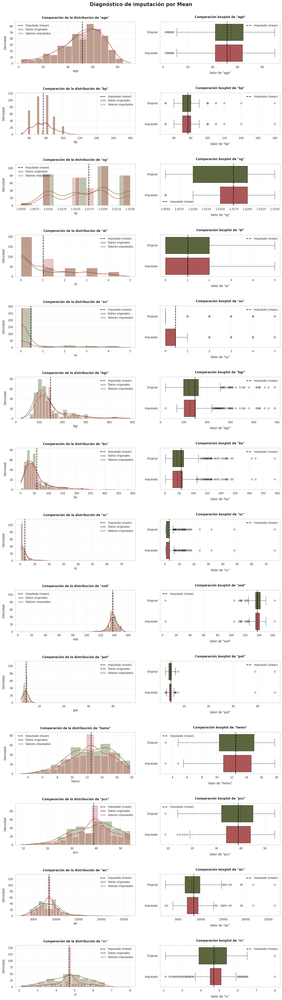


Realizando validación cruzada para evaluar la calidad de la imputación por median.


  0%|          | 0/14 [00:00<?, ?it/s]


📊 Resumen de imputación por MEDIAN para 14 columnas con valores faltantes.

🔹 COLUMNA "age":
   Valores faltantes: 9 (2.2%)
   Datos originales: Media = 51.48, Mediana = 55.00, Desviación típica = 17.17
   Valor imputado (median): 55.00
   Datos después de imputación: Media = 51.56, Mediana = 55.00, Desviación típica = 16.98
   Cambio respecto a media original: 6.8%
   Resultados de la validación cruzada: RMSE = 17.412 ± 0.765, R² = -0.038 ± 0.033

🔹 COLUMNA "bp":
   Valores faltantes: 12 (3.0%)
   Datos originales: Media = 76.47, Mediana = 80.00, Desviación típica = 13.68
   Valor imputado (median): 80.00
   Datos después de imputación: Media = 76.58, Mediana = 80.00, Desviación típica = 13.49
   Cambio respecto a media original: 4.6%
   Resultados de la validación cruzada: RMSE = 14.192 ± 2.973, R² = -0.169 ± 0.120

🔹 COLUMNA "sg":
   Valores faltantes: 47 (11.8%)
   Datos originales: Media = 1.02, Mediana = 1.02, Desviación típica = 0.01
   Valor imputado (median): 1.02
   Datos de

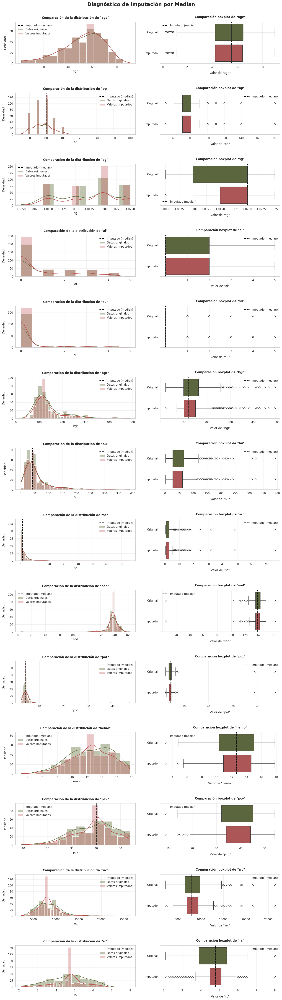

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, r2_score
import warnings
from tqdm.auto import tqdm

def impute_with_strategy(df, strategy='mean', diagnostic_plots=True,
                        cross_validation=False, n_splits=5, verbose=True,
                        random_state=42):
    """
    Imputación utilizando SimpleImputer con visualización y validación cruzada

    -----------
    Parámetros:
    -----------
    df : DataFrame de entrada con valores faltantes.
    strategy : estrategia de imputación ('mean', 'median', 'most_frequent', o 'constant').
    diagnostic_plots : si se generan gráficos de diagnóstico.
    cross_validation : si se realiza validación cruzada para evaluar precisión.
    n_splits : número de divisiones para la validación cruzada.
    verbose : si se imprime la información de progreso.
    random_state : semilla aleatoria para reproducibilidad.

    --------
    Devuelve:
    --------
    dict: contiene los resultados de imputación y los metadatos.
    """

    np.random.seed(random_state)

    # Validar el Dataframe de entrada
    if df is None or df.empty:
        raise ValueError("Input dataframe cannot be None or empty")

    # Validar estrategia
    valid_strategies = ['mean', 'median', 'most_frequent', 'constant']
    if strategy not in valid_strategies:
        raise ValueError(f"Strategy must be one of {valid_strategies}")

    # Seleccionar columnas numéricas para la imputación
    numerical_columns = df.select_dtypes(include=['number']).columns

    if len(numerical_columns) == 0:
        raise ValueError("No numerical columns found for imputation")

    X = df[numerical_columns].copy()

    # Comprobar columnas con todos los valores faltantes
    all_missing = X.columns[X.isna().all()].tolist()
    if all_missing:
        if verbose:
            print(f"Columnas con todos los valores faltantes: {all_missing}")
            print("Estas columnas se excluirán de la imputación.")
        X = X.drop(columns=all_missing)
        numerical_columns = X.columns.tolist()

    # Comprueba si faltan valores
    if not X.isna().any().any():
        if verbose:
            print("No se encontraron valores faltantes en las columnas numéricas. No se requiere imputación.")
        return {
            'imputed_data': X,
            'imputation_metadata': {},
            'message': 'No es necesaria ninguna imputación.'
        }

    imputation_metadata = {}

    # Guardar X original antes de imputación para referencias futuras
    X_original = X.copy()

    # Guardar las máscaras de valores faltantes antes de imputar
    missing_masks = {}
    for column in numerical_columns:
        missing_masks[column] = X[column].isna()

    # Implementar SimpleImputer para la imputación
    imputer = SimpleImputer(strategy=strategy, missing_values=np.nan)

    # Ajustar el imputador y transformar los datos
    X_imputed_array = imputer.fit_transform(X)

    # Convertir el array de nuevo a DataFrame
    X_imputed = pd.DataFrame(X_imputed_array, columns=X.columns, index=X.index)

    # Guardar los valores de imputación
    fill_values = {}
    for i, column in enumerate(X.columns):
        fill_values[column] = imputer.statistics_[i]

    # Preparar gráficos de diagnóstico si se solicita
    if diagnostic_plots:
        # Contar solo columnas con valores faltantes
        missing_cols = [col for col in numerical_columns if X_original[col].isna().any()]
        n_rows = len(missing_cols)

        if n_rows == 0:
            diagnostic_plots = False
        else:
            fig, axes = plt.subplots(n_rows, 2, figsize=(16, 4*n_rows))
            title = f'Diagnóstico de imputación por {strategy.capitalize()}'
            fig.suptitle(title, fontsize=20, fontweight='bold', y=1)
            # Asegurar que axes sea siempre un array, incluso cuando n_rows es 1
            if n_rows == 1:
                axes = np.array([axes])
            plot_idx = 0

    # Validación cruzada para la evaluación de la calidad de la imputación si se solicita
    cv_results = {}
    if cross_validation and any(X_original[col].isna().sum() > 10 for col in X_original.columns):
        if verbose:
            print(f"\nRealizando validación cruzada para evaluar la calidad de la imputación por {strategy}.")

        # Columnas a validar
        columns_to_validate = [col for col in X_original.columns if X_original[col].isna().sum() > 0 and len(X_original[col].dropna()) >= 20]
        columns_iterator = tqdm(columns_to_validate) if verbose else columns_to_validate

        for col in columns_iterator:
            # Establecer descripción de la barra de progreso si está activada
            if verbose and isinstance(columns_iterator, tqdm):
                columns_iterator.set_description(f"Validando {col}")

            # Realizar el CV sólo en columnas con suficientes valores no ausentes
            non_missing_idx = X_original[col].dropna().index
            original_values = X_original.loc[non_missing_idx, col].values

            cv_scores = {'rmse': [], 'r2': []}
            kf = KFold(n_splits=min(n_splits, len(non_missing_idx)//5), shuffle=True, random_state=random_state)

            for train_idx, test_idx in kf.split(non_missing_idx):
                # Crear una copia con valores perdidos introducidos artificialmente
                X_cv = X_original.copy()
                test_indices = non_missing_idx[test_idx]
                X_cv.loc[test_indices, col] = np.nan

                # Imputar utilizando SimpleImputer
                train_indices = non_missing_idx[train_idx]
                train_data = X_cv.loc[train_indices]

                cv_imputer = SimpleImputer(strategy=strategy)
                X_cv_imputed = X_cv.copy()

                # Ajustar el imputador solo con datos de entrenamiento
                for column in X_cv.columns:
                    # Si la columna tiene valores ausentes, impute utilizando entrenamiento
                    if X_cv[column].isna().any():
                        col_imputer = SimpleImputer(strategy=strategy)
                        col_imputer.fit(train_data[[column]].dropna())

                        # Aplicar la imputación solo a los valores ausentes
                        missing_mask = X_cv[column].isna()
                        if missing_mask.any():
                            missing_values = col_imputer.transform(X_cv.loc[missing_mask, [column]])
                            X_cv_imputed.loc[missing_mask, column] = missing_values.flatten()

                # Evaluar la imputación en el conjunto de pruebas
                true_values = X_original.loc[test_indices, col].values
                predicted_values = X_cv_imputed.loc[test_indices, col].values

                rmse = np.sqrt(mean_squared_error(true_values, predicted_values))
                r2 = r2_score(true_values, predicted_values)

                cv_scores['rmse'].append(rmse)
                cv_scores['r2'].append(r2)

            cv_results[col] = {
                'mean_rmse': np.mean(cv_scores['rmse']),
                'std_rmse': np.std(cv_scores['rmse']),
                'mean_r2': np.mean(cv_scores['r2']),
                'std_r2': np.std(cv_scores['r2'])
            }

    # Procesar los resultados de la imputación y generar diagnósticos
    missing_columns = [col for col in numerical_columns if X_original[col].isna().any()]
    if verbose:
        print(f"\n📊 Resumen de imputación por {strategy.upper()} para {len(missing_columns)} columnas con valores faltantes.")

    plot_idx = 0
    for idx, column in enumerate(numerical_columns):
        missing_mask = missing_masks.get(column, X_original[column].isna())
        n_missing = missing_mask.sum()

        if n_missing == 0:
            if verbose:
                print(f"No faltan valores en '{column}'. No es necesaria la imputación.")
            continue

        if len(X_original[column].dropna()) < 5:
            if verbose:
                print(f"Datos insuficientes en '{column}' para una imputación fiable. Los resultados pueden ser poco fiables.")

        # Obtener valores imputados
        imputed_values = pd.Series([fill_values[column]] * n_missing)
        # Datos originales sin valores ausentes
        original_data = X_original[column].dropna()

        # Protección contra división por cero o datos vacíos
        percent_change = np.nan
        if not original_data.empty and original_data.mean() != 0:
            percent_change = (imputed_values.mean() - original_data.mean()) / original_data.mean() * 100

        imputation_metadata[column] = {
            'missing_count': n_missing,
            'missing_percent': n_missing/len(X) * 100,
            'imputed_value': fill_values[column],
            'imputed_mean': imputed_values.mean(),
            'imputed_median': imputed_values.median(),
            'imputed_std': imputed_values.std() if len(imputed_values) > 1 else 0,
            'imputed_range': (imputed_values.min(), imputed_values.max()) if len(imputed_values) > 0 else (np.nan, np.nan),
            'original_mean': original_data.mean(),
            'original_std': original_data.std(),
            'percent_change_mean': percent_change
        }

        # Generar gráficos de diagnóstico si se solicita
        if diagnostic_plots and n_missing > 0:
            try:
                impute_color_map = {
                    'mean': '#000000',
                    'median': '#000000',
                    'most_frequent': '#000000',
                }
                impute_color = impute_color_map.get(strategy)
                impute_label = f'Imputado ({strategy})'
                completed_color = '#bc4749'  # Color para la distribución después de imputar

                # 1. Distribución original vs. post-imputación
                ax1 = axes[plot_idx, 0]

                # Histograma de datos originales
                sns.histplot(original_data, kde=True, ax=ax1,
                        color='#606c38', alpha=0.4, label='Datos originales')

                # Histograma de datos completos después de imputación
                sns.histplot(X_imputed[column], kde=True, ax=ax1,
                        color=completed_color, alpha=0.3, label='Valores imputados')

                # Añadir línea vertical para el valor imputado
                if len(imputed_values) > 0:
                    ax1.axvline(x=fill_values[column], color=impute_color, linestyle='--',
                                linewidth=2.05, label=impute_label)

                ax1.set_title(f'Comparación de la distribución de "{column}"', pad=12, fontweight='bold')
                ax1.set_xlabel(column)
                ax1.set_ylabel('Densidad', labelpad=12)
                ax1.legend()

                # 2. Comparación de boxplots: original y después de imputación
                ax2 = axes[plot_idx, 1]

                # Crear un DataFrame para la comparación de boxplots
                comparison_df = pd.DataFrame({
                    'Original': original_data,
                    'Imputado': X_imputed[column]
                })

                # Boxplot para datos originales y después de imputación
                sns.boxplot(data=comparison_df, ax=ax2, palette=['#606c38', completed_color], orient='h')

                # Añadir marcador para valor imputado
                if fill_values[column] is not None:
                    ax2.axvline(x=fill_values[column], color=impute_color,
                                linestyle='--', linewidth=2.05, label=impute_label)

                ax2.set_title(f'Comparación boxplot de "{column}"', fontsize=12, pad=15, fontweight='bold')
                ax2.set_xlabel(f'Valor de "{column}"', labelpad=12)
                ax2.legend()

                plot_idx += 1
            except Exception as e:
                if verbose:
                    print(f"Error en la generación de gráficos para la columna '{column}': {str(e)}")

        if verbose:
            print(f'\n🔹 COLUMNA "{column}":')
            print(f"   Valores faltantes: {n_missing} ({n_missing/len(X):.1%})")
            if not original_data.empty:
                print(f"   Datos originales: Media = {original_data.mean():.2f}, Mediana = {original_data.median():.2f}, Desviación típica = {original_data.std():.2f}")
            print(f"   Valor imputado ({strategy}): {fill_values[column]:.2f}")
            print(f"   Datos después de imputación: Media = {X_imputed[column].mean():.2f}, Mediana = {X_imputed[column].median():.2f}, Desviación típica = {X_imputed[column].std():.2f}")
            if not pd.isna(percent_change):
                print(f"   Cambio respecto a media original: {percent_change:.1f}%")
            if column in cv_results:
                print(f"   Resultados de la validación cruzada: RMSE = {cv_results[column]['mean_rmse']:.3f} ± {cv_results[column]['std_rmse']:.3f}, R² = {cv_results[column]['mean_r2']:.3f} ± {cv_results[column]['std_r2']:.3f}")

    if diagnostic_plots and plot_idx > 0:
        try:
            plt.tight_layout(h_pad=4.0, w_pad=3.0)
            plt.subplots_adjust(top=0.98)
            plt.show()
        except Exception as e:
            if verbose:
                print(f"Error en la visualización de gráficos: {str(e)}")

    # Para las columnas del dataframe original que se imputaron, las copiamos de nuevo
    result_df = df.copy()
    for col in numerical_columns:
        if col in X_imputed.columns:
            result_df[col] = X_imputed[col]

    # Preparamos el diccionario de devolución
    result = {
        'imputed_data': result_df,
        'imputation_metadata': imputation_metadata,
        'fill_values': fill_values
    }

    if cross_validation and cv_results:
        result['cv_results'] = cv_results

    return result

def run_both_imputations(df, diagnostic_plots=True, cross_validation=True,
                       n_splits=5, verbose=True, random_state=42):
    """
    Ejecuta imputación por media y mediana.

    -----------
    Parametros:
    -----------
    df : DataFrame de entrada con valores faltantes.
    diagnostic_plots : si se generan gráficos de diagnóstico.
    cross_validation : si se realiza validación cruzada para evaluar precisión.
    n_splits : número de divisiones para la validación cruzada.
    verbose : si se imprime la información de progreso.
    random_state : semilla aleatoria para reproducibilidad.

    --------
    Devuelve:
    --------
    dict: contiene los resultados de imputación por media y mediana.
    """

    mean_results = impute_with_strategy(
        df=df,
        strategy='mean',
        diagnostic_plots=diagnostic_plots,
        cross_validation=cross_validation,
        n_splits=n_splits,
        verbose=verbose,
        random_state=random_state
    )

    median_results = impute_with_strategy(
        df=df,
        strategy='median',
        diagnostic_plots=diagnostic_plots,
        cross_validation=cross_validation,
        n_splits=n_splits,
        verbose=verbose,
        random_state=random_state
    )

    return {
        'mean_imputation': mean_results,
        'median_imputation': median_results
    }

imputation_results = run_both_imputations(
     df=cleaned_kidney_df,
     diagnostic_plots=True,
     cross_validation=True,
     verbose=True
)

Para garantizar la calidad y consistencia de los datos imputados, hemos decidido realizar una verificación posterior al proceso de imputación de cada estrategia. En este bloque de código se evalúa si los métodos aplicados para rellenar valores faltantes han cumplido correctamente su objetivo: eliminar por completo los valores NaN de las columnas numéricas.

El código realiza los siguientes pasos para cada método de imputación:
*   Se extraen únicamente las columnas numéricas del DataFrame resultante de cada método de imputación, esto se hace con `.select_dtypes(include=['number'])`, para centrarnos únicamente en aquellas columnas qque han tenido cambios.
*   Se muestra una vista rápida de las primeras 10 filas con `.head(10)` para inspeccionar manualmente los resultados y verificar que los valores han sido imputados razonablemente.
*   Se aplica `.isna().sum()` sobre las columnas numéricas para contar cuántos valores faltantes siguen presentes. Un resultado de ceros indica que todos los valores NaN fueron reemplazados exitosamente por los métodos de imputación correspondientes.

In [ ]:
numeric_columns_Mean = imputation_results['mean_imputation']['imputed_data'].select_dtypes(include=['number'])
numeric_columns_Mean.head(10)

,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo,pcv,wc,rc
id,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,121.00,36.00,1.20,137.53,4.63,15.40,44.00,"7,800.00",5.20
1,7.00,50.00,1.02,4.00,0.00,148.04,18.00,0.80,137.53,4.63,11.30,38.00,"6,000.00",4.71
2,62.00,80.00,1.01,2.00,3.00,423.00,53.00,1.80,137.53,4.63,9.60,31.00,"7,500.00",4.71
3,48.00,70.00,1.00,4.00,0.00,117.00,56.00,3.80,111.00,2.50,11.20,32.00,"6,700.00",3.90
4,51.00,80.00,1.01,2.00,0.00,106.00,26.00,1.40,137.53,4.63,11.60,35.00,"7,300.00",4.60
5,60.00,90.00,1.01,3.00,0.00,74.00,25.00,1.10,142.00,3.20,12.20,39.00,"7,800.00",4.40
6,68.00,70.00,1.01,0.00,0.00,100.00,54.00,24.00,104.00,4.00,12.40,36.00,"8,406.12",4.71
7,24.00,76.47,1.01,2.00,4.00,410.00,31.00,1.10,137.53,4.63,12.40,44.00,"6,900.00",5.00
8,52.00,100.00,1.01,3.00,0.00,138.00,60.00,1.90,137.53,4.63,10.80,33.00,"9,600.00",4.00


In [ ]:
numeric_columns_Mean.isna().sum()

,0
age,0
bp,0
sg,0
al,0
su,0
bgr,0
bu,0
sc,0
sod,0
pot,0


In [ ]:
numeric_columns_Median = imputation_results['median_imputation']['imputed_data'].select_dtypes(include=['number'])
numeric_columns_Median.head(10)

,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo,pcv,wc,rc
id,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,121.00,36.00,1.20,138.00,4.40,15.40,44.00,"7,800.00",5.20
1,7.00,50.00,1.02,4.00,0.00,121.00,18.00,0.80,138.00,4.40,11.30,38.00,"6,000.00",4.80
2,62.00,80.00,1.01,2.00,3.00,423.00,53.00,1.80,138.00,4.40,9.60,31.00,"7,500.00",4.80
3,48.00,70.00,1.00,4.00,0.00,117.00,56.00,3.80,111.00,2.50,11.20,32.00,"6,700.00",3.90
4,51.00,80.00,1.01,2.00,0.00,106.00,26.00,1.40,138.00,4.40,11.60,35.00,"7,300.00",4.60
5,60.00,90.00,1.01,3.00,0.00,74.00,25.00,1.10,142.00,3.20,12.20,39.00,"7,800.00",4.40
6,68.00,70.00,1.01,0.00,0.00,100.00,54.00,24.00,104.00,4.00,12.40,36.00,"8,000.00",4.80
7,24.00,80.00,1.01,2.00,4.00,410.00,31.00,1.10,138.00,4.40,12.40,44.00,"6,900.00",5.00
8,52.00,100.00,1.01,3.00,0.00,138.00,60.00,1.90,138.00,4.40,10.80,33.00,"9,600.00",4.00


In [ ]:
numeric_columns_Median.isna().sum()

,0
age,0
bp,0
sg,0
al,0
su,0
bgr,0
bu,0
sc,0
sod,0
pot,0


A continuación se implementa un sistema de imputación utilizando el algoritmo K-Nearest Neighbors (KNN), una técnica que permite estimar valores ausentes basándose en la similitud con otros registros. A diferencia de enfoques tradicionales que utilizan un valor fijo de k para todo el conjunto de datos, aquí se introduce una versión adaptativa, capaz de encontrar el valor óptimo de k para cada columna con valores faltantes, maximizando la precisión de la imputación a través de validación cruzada.

En el código se implementa una función llamada `AdaptiveKNNImputer`, que tiene las siguientes características y funcionalidades pricipales:
1.   Selección de columnas numéricas con valores faltantes.
2.   Para cada columna, se evalúan diferentes valores de k (número de vecinos) y se utiliza validación cruzada (KFold) para medir el rendimiento de cada valor de k mediante métricas como RMSE y R². Finalmente, se selecciona el k que minimiza el error de imputación.
3.   Cada columna se imputa de forma independiente con su k óptimo y se preservan las estadísticas originales para así calcular el impacto del cambio (porcentaje de variación en la media).
4.   Se ofrece una comparación gráfica de la distribución antes y después de la imputación, incluyendo histogramas y boxplots.


  0%|          | 0/14 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]


📊 Resumen de imputación para 14 columnas con valores faltantes.

🔹 COLUMNA "age":
   Valores faltantes: 9 (2.2%)
   Datos originales: Media = 51.48, Mediana = 55.00, Desviación típica = 17.17
   Datos imputados: Media = 47.68, Mediana = 47.80, Desviación típica = 5.62
   Cambio medio: -7.4%
   Resultados de la validación cruzada: RMSE = 17.603 ± 0.574, R² = -0.064 ± 0.097
   K óptimo: 10

🔹 COLUMNA "bp":
   Valores faltantes: 12 (3.0%)
   Datos originales: Media = 76.47, Mediana = 80.00, Desviación típica = 13.68
   Datos imputados: Media = 72.04, Mediana = 70.56, Desviación típica = 6.80
   Cambio medio: -5.8%
   Resultados de la validación cruzada: RMSE = 13.719 ± 2.976, R² = -0.051 ± 0.136
   K óptimo: 9

🔹 COLUMNA "sg":
   Valores faltantes: 47 (11.8%)
   Datos originales: Media = 1.02, Mediana = 1.02, Desviación típica = 0.01
   Datos imputados: Media = 1.02, Mediana = 1.02, Desviación típica = 0.00
   Cambio medio: -0.2%
   Resultados de la validación cruzada: RMSE = 0.006 ± 0.0

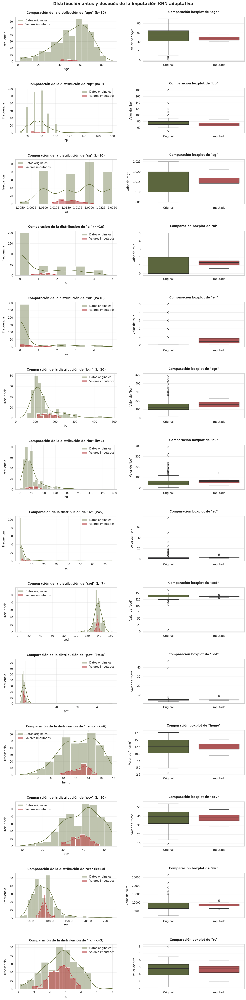

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import KNNImputer
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.base import BaseEstimator, TransformerMixin
from tqdm.auto import tqdm

class AdaptiveKNNImputer(BaseEstimator, TransformerMixin):
    """
    Implementación de KNNImputer adaptativo que encuentra el mejor valor k para cada columna.
    Utiliza validación cruzada para optimizar el parámetro k usando los patrones naturales
    de valores faltantes en los datos.

    Parámetros:
    -----------
    max_k : número máximo de vecinos a considerar.
    cv : número de pliegues para la validación cruzada.
    random_state : semilla aleatoria para reproducibilidad.
    verbose : si es True, muestra información sobre el proceso de optimización.
    plot : si es True, grafica la distribución antes y después de la imputación.
    """

    def __init__(self, max_k=10, cv=5, random_state=42, verbose=False, plot=True):
        self.max_k = max_k
        self.cv = cv
        self.random_state = random_state
        self.verbose = verbose
        self.plot = plot
        self.optimal_k_dict = {}
        self.imputers = {}
        self.cv_results = {}

    def fit(self, X, y=None):
        """
        Encuentra el valor óptimo de k para cada columna con valores faltantes.
        Utiliza los patrones naturales de valores faltantes para la validación.

        -----------
        Parámetros:
        -----------
        X : DataFrame con los valores faltantes a optimizar.
        y : no utilizado, presente por compatibilidad con la API de scikit-learn.

        --------
        Retorna:
        --------
        self : objeto
        """

        if not isinstance(X, pd.DataFrame):
            X = pd.DataFrame(X)

        # Seleccionar sólo columnas numéricas
        numerical_columns = X.select_dtypes(include=['number']).columns
        X_numerical = X[numerical_columns].copy()

        # Buscar columnas con valores faltantes
        self.cols_with_missing = [col for col in numerical_columns if X_numerical[col].isna().sum() > 0]

        if not self.cols_with_missing:
            if self.verbose:
                print("No se encontraron columnas con valores faltantes.")
            return self

        # Usar tqdm para mostrar una barra de progreso si verbose=True
        columns_iterator = tqdm(self.cols_with_missing) if self.verbose else self.cols_with_missing

        # Selección de K para cada columna con valores faltantes
        for column in columns_iterator:
            # Establecer descripción de la barra de progreso si está activada
            if self.verbose and isinstance(columns_iterator, tqdm):
                columns_iterator.set_description(f"Optimizando k para {column}")

            # Separar datos completos e incompletos para esta columna
            X_complete = X_numerical[X_numerical[column].notna()].copy()

            # Manejar caso con muy pocos datos completos
            if len(X_complete) < self.cv + 1:
                optimal_k = min(3, len(X_complete))
                self.optimal_k_dict[column] = optimal_k
                if self.verbose:
                    print(f"Columna {column} tiene muy pocos datos completos. Se utilizará k={optimal_k}.")
                continue

            # Optimizar k usando validación cruzada en los datos completos
            # Sin simular valores faltantes, sino usando el método de hold-out
            k_errors = []
            k_r2_scores = []

            for k in range(1, min(self.max_k + 1, len(X_complete))):
                cv_errors = []
                cv_r2_scores = []

                # Utilizamos KFold para validación cruzada
                kf = KFold(n_splits=self.cv, shuffle=True, random_state=self.random_state)

                for train_idx, val_idx in kf.split(X_complete):
                    # Dividir en entrenamiento y validación
                    X_train, X_val = X_complete.iloc[train_idx], X_complete.iloc[val_idx]

                    # Guardar valores reales para comparar después
                    val_true_values = X_val[column].copy()

                    # Crear set de validación con valores faltantes
                    X_val_missing = X_val.copy()
                    X_val_missing[column] = np.nan

                    # Combinar para entrenamiento e imputación
                    X_combined = pd.concat([X_train, X_val_missing])

                    # Imputar usando KNN con el valor k actual
                    imputer = KNNImputer(n_neighbors=k)
                    X_imputed = pd.DataFrame(
                        imputer.fit_transform(X_combined),
                        columns=X_combined.columns,
                        index=X_combined.index
                    )

                    # Extraer valores imputados
                    val_imputed_values = X_imputed.loc[X_val.index, column]

                    # Calcular métricas de error
                    error = mean_squared_error(val_true_values, val_imputed_values)
                    r2 = r2_score(val_true_values, val_imputed_values)

                    cv_errors.append(error)
                    cv_r2_scores.append(r2)

                # Promediar errores para este valor k
                k_errors.append(np.mean(cv_errors))
                k_r2_scores.append(np.mean(cv_r2_scores))

            # Seleccionar k óptimo (error más bajo)
            if k_errors:
                optimal_k = np.argmin(k_errors) + 1
                self.optimal_k_dict[column] = optimal_k

                # Guardar resultados de validación cruzada
                self.cv_results[column] = {
                    'mean_rmse': np.sqrt(k_errors[optimal_k-1]),
                    'std_rmse': np.std([np.sqrt(e) for e in cv_errors]) if cv_errors else 0,
                    'mean_r2': k_r2_scores[optimal_k-1],
                    'std_r2': np.std(cv_r2_scores) if cv_r2_scores else 0
                }

                # Crear y guardar el imputador con k óptimo para esta columna
                self.imputers[column] = KNNImputer(n_neighbors=optimal_k)

        return self

    def transform(self, X):
        """
        Aplica la imputación utilizando los valores k óptimos encontrados.

        -----------
        Parámetros:
        -----------
        X : DataFrame con los valores faltantes a imputar.

        --------
        Retorna:
        --------
        X_imputed : DataFrame con los valores imputados.
        """

        if not isinstance(X, pd.DataFrame):
            X = pd.DataFrame(X)

        # Seleccionar sólo columnas numéricas
        numerical_columns = X.select_dtypes(include=['number']).columns
        X_numerical = X[numerical_columns].copy()

        # Si no hay columnas con valores faltantes o no se entrenó el modelo
        if not hasattr(self, 'cols_with_missing') or not self.cols_with_missing:
            return X.copy()  # Retornar una copia para consistencia

        # Imputar cada columna por separado para mantener la integridad de los datos
        X_imputed = X_numerical.copy()

        # Guardar estadísticas antes/después de la imputación para cada columna
        self.imputation_stats = {}

        # Usar tqdm para mostrar una barra de progreso si verbose=True
        columns_iterator = tqdm(self.cols_with_missing) if self.verbose else self.cols_with_missing

        for column in columns_iterator:
            # Establecer descripción de la barra de progreso si está activada
            if self.verbose and isinstance(columns_iterator, tqdm):
                columns_iterator.set_description(f"Imputando {column}")

            if column in X_numerical.columns and X_numerical[column].isna().sum() > 0:
                # Guardar estadísticas antes de la imputación
                n_missing = X_numerical[column].isna().sum()
                original_data = X_numerical[column].dropna()

                if column in self.imputers:
                    # Clonar X_numerical para la imputación de esta columna
                    X_to_impute = X_numerical.copy()

                    # Imputar utilizando el imputador entrenado
                    X_col_imputed = pd.DataFrame(
                        self.imputers[column].fit_transform(X_to_impute),
                        columns=X_to_impute.columns,
                        index=X_to_impute.index
                    )

                    # Actualizar solo los valores faltantes de esta columna
                    missing_mask = X_imputed[column].isna()
                    X_imputed.loc[missing_mask, column] = X_col_imputed.loc[missing_mask, column]

                    # Guardar estadísticas después de la imputación
                    imputed_values = X_imputed.loc[missing_mask, column]

                    # Calcular el cambio porcentual en la media
                    if len(original_data) > 0:
                        percent_change = ((imputed_values.mean() - original_data.mean()) / original_data.mean()) * 100
                    else:
                        percent_change = np.nan

                    # Guardar todas las estadísticas
                    self.imputation_stats[column] = {
                        'missing_count': n_missing,
                        'missing_percent': n_missing / len(X) * 100,
                        'original_mean': original_data.mean() if len(original_data) > 0 else np.nan,
                        'original_median': original_data.median() if len(original_data) > 0 else np.nan,
                        'original_std': original_data.std() if len(original_data) > 0 else np.nan,
                        'imputed_mean': imputed_values.mean(),
                        'imputed_median': imputed_values.median(),
                        'imputed_std': imputed_values.std(),
                        'percent_change_mean': percent_change,
                        'imputed_range': (imputed_values.min(), imputed_values.max())
                    }

        # Crear un DataFrame final con todas las columnas originales
        result = X.copy()
        for col in X_imputed.columns:
            result[col] = X_imputed[col]

        # Mostrar resumen de imputación si se solicitó
        if self.verbose:
            self.print_summary()

        # Visualización si se solicitó
        if self.plot and hasattr(self, 'cols_with_missing') and self.cols_with_missing:
            self._plot_distributions(X, result)

        return result

    def fit_transform(self, X, y=None):
        """
        Ajusta el modelo y aplica la transformación.

        -----------
        Parámetros:
        -----------
        X : DataFrame con los valores faltantes a imputar.
        y : No utilizado, presente por compatibilidad con la API de scikit-learn.

        --------
        Retorna:
        --------
        dict: Diccionario con los datos imputados y metadatos.
        """
        self.fit(X)
        imputed_data = self.transform(X)

        # Crear un diccionario de resultados similar al formato de MICE
        result = {
            'imputed_data': imputed_data,
            'imputation_metadata': self.imputation_stats
        }

        # Añadir resultados de validación cruzada si existen
        if hasattr(self, 'cv_results') and self.cv_results:
            result['cv_results'] = self.cv_results

        return result

    def get_optimal_k(self):
        """
        Devuelve el diccionario con los valores k óptimos para cada columna.

        --------
        Retorna:
        --------
        optimal_k_dict : diccionario con los valores k óptimos para cada columna.
        """
        return self.optimal_k_dict

    def print_summary(self):
        """
        Imprime un resumen de la imputación realizada.
        """
        print(f"\n📊 Resumen de imputación para {len(self.cols_with_missing)} columnas con valores faltantes.")

        for column in self.cols_with_missing:
            if column in self.imputation_stats:
                stats = self.imputation_stats[column]

                print(f'\n🔹 COLUMNA "{column}":')
                print(f"   Valores faltantes: {stats['missing_count']} ({stats['missing_percent']:.1f}%)")

                if not np.isnan(stats['original_mean']):
                    print(f"   Datos originales: Media = {stats['original_mean']:.2f}, "
                          f"Mediana = {stats['original_median']:.2f}, "
                          f"Desviación típica = {stats['original_std']:.2f}")

                print(f"   Datos imputados: Media = {stats['imputed_mean']:.2f}, "
                      f"Mediana = {stats['imputed_median']:.2f}, "
                      f"Desviación típica = {stats['imputed_std']:.2f}")

                if not np.isnan(stats['percent_change_mean']):
                    print(f"   Cambio medio: {stats['percent_change_mean']:.1f}%")

                if column in self.cv_results:
                    print(f"   Resultados de la validación cruzada: "
                          f"RMSE = {self.cv_results[column]['mean_rmse']:.3f} ± {self.cv_results[column]['std_rmse']:.3f}, "
                          f"R² = {self.cv_results[column]['mean_r2']:.3f} ± {self.cv_results[column]['std_r2']:.3f}")

                print(f"   K óptimo: {self.optimal_k_dict.get(column, 'N/A')}")

    def _plot_distributions(self, X_original, X_imputed):
        """
        Visualiza la distribución de los datos antes y después de la imputación.

        -----------
        Parámetros:
        -----------
        X_original : DataFrame original con valores faltantes.
        X_imputed : DataFrame con valores imputados.
        """
        cols_to_plot = self.cols_with_missing
        n_cols = len(cols_to_plot)

        if n_cols == 0:
            return

        print("\n")

        # Crear figura con número de filas igual al número de columnas a graficar
        fig, axes = plt.subplots(n_cols, 2, figsize=(14, 4 * n_cols))
        fig.suptitle('Distribución antes y después de la imputación KNN adaptativa',
                     fontsize=16, fontweight='bold', y=1)

        # Asegurar que axes sea bidimensional incluso con una sola columna
        if n_cols == 1:
            axes = axes.reshape(1, 2)

        for idx, column in enumerate(cols_to_plot):
            # Obtener los ejes para esta columna
            ax1, ax2 = axes[idx]

            # Datos originales (sin imputación)
            original_data = X_original[column].dropna()

            # Crear máscara para identificar valores que fueron imputados
            missing_mask = X_original[column].isna()
            imputed_values = X_imputed.loc[missing_mask, column]

            # Crear un DataFrame para el boxplot
            combined = pd.DataFrame({
                'Original': original_data,
                'Imputado': imputed_values
            })

            # 1. Distribución original vs. distribución imputada
            sns.histplot(original_data, kde=True, ax=ax1,
                        color='#606c38', alpha=0.4, label='Datos originales')
            if len(imputed_values) > 0:
                sns.histplot(imputed_values, kde=True, ax=ax1,
                            color='#bc4749', alpha=0.6, label='Valores imputados')

            k_value = self.optimal_k_dict.get(column, "N/A")
            ax1.set_title(f'Comparación de la distribución de "{column}" (k={k_value})', pad=12, fontweight='bold')
            ax1.set_xlabel(column)
            ax1.set_ylabel('Frecuencia', labelpad=12)
            ax1.legend()

            # 2. Comparación de boxplot
            sns.boxplot(data=combined, ax=ax2, palette=['#606c38', '#bc4749'])
            ax2.set_title(f'Comparación boxplot de "{column}"', fontsize=12, pad=15, fontweight='bold')
            ax2.set_ylabel(f'Valor de "{column}"', labelpad=12)

        plt.tight_layout(h_pad=4.0, w_pad=3.0)
        plt.subplots_adjust(top=0.985)
        plt.show()


imputer = AdaptiveKNNImputer(max_k=10, cv=5, verbose=True)
KNN_result = imputer.fit_transform(cleaned_kidney_df)
imputed_df_KNN = KNN_result['imputed_data']
metadata_KNN = KNN_result['imputation_metadata']

In [ ]:
numeric_columns_KNN = imputed_df_KNN.select_dtypes(include=['number'])
numeric_columns_KNN.head(10)

,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo,pcv,wc,rc
id,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,121.00,36.00,1.20,139.00,4.26,15.40,44.00,"7,800.00",5.20
1,7.00,50.00,1.02,4.00,0.00,116.50,18.00,0.80,136.86,3.99,11.30,38.00,"6,000.00",5.40
2,62.00,80.00,1.01,2.00,3.00,423.00,53.00,1.80,133.86,4.53,9.60,31.00,"7,500.00",3.97
3,48.00,70.00,1.00,4.00,0.00,117.00,56.00,3.80,111.00,2.50,11.20,32.00,"6,700.00",3.90
4,51.00,80.00,1.01,2.00,0.00,106.00,26.00,1.40,139.29,4.03,11.60,35.00,"7,300.00",4.60
5,60.00,90.00,1.01,3.00,0.00,74.00,25.00,1.10,142.00,3.20,12.20,39.00,"7,800.00",4.40
6,68.00,70.00,1.01,0.00,0.00,100.00,54.00,24.00,104.00,4.00,12.40,36.00,"8,560.00",4.53
7,24.00,73.33,1.01,2.00,4.00,410.00,31.00,1.10,135.14,4.28,12.40,44.00,"6,900.00",5.00
8,52.00,100.00,1.01,3.00,0.00,138.00,60.00,1.90,135.29,4.82,10.80,33.00,"9,600.00",4.00


In [ ]:
numeric_columns_KNN.isna().sum()

,0
age,0
bp,0
sg,0
al,0
su,0
bgr,0
bu,0
sc,0
sod,0
pot,0


La última técnica que hemos decidido utilizar para imputar este tipo de variables es MICE (Multiple Imputation by Chained Equations), una estrategia iterativa que permite modelar cada variable con valores perdidos como una función de las demás. Esta es especialmente útil cuando hay múltiples variables con datos faltantes y relaciones complejas entre ellas.

MICE funciona imputando secuencialmente los valores ausentes de cada variable utilizando modelos de regresión, ajustados a partir del resto de variables como predictores. Este proceso se repite durante varias iteraciones, refinando las estimaciones en cada paso hasta lograr la convergencia.

Para implementar este método, incluyendo diagnóstico gráfico y evaluación mediante validación cruzada, hemos creado la función `impute_missing_values_mice`. Sus funcionalidades principales son las siguientes:
*   Permite elegir el estimador (por defecto, `BayesianRidge`, aunque se puede cambiar por modelos como `RandomForestRegressor`).
*   Escala el conjunto de datos con `StandardScaler`, reemplazando temporalmente los NaN por la media para evitar errores, y luego restaurándolos antes de la imputación. Esto se realiza para estabilizar el proceso y facilitar la convergencia del algoritmo.
*   Realiza imputaciones iterativas utilizando `IterativeImputer` de `Scikit-learn`. Este recorre las columnas numéricas, imputando una por una en un ciclo, y repite el proceso varias veces hasta que los valores imputados se estabilizan.
*   Permite visualizar gráficos comparativos entre las distribuciones originales y los valores imputados para cada variable con datos faltantes, mediante histogramas y diagramas de caja (boxplots).
*   Permite comprobar la calidad del proceso mediante validación cruzada: se simula la imputación en subconjuntos de datos con valores ocultos y se evalúan métricas como RMSE y R² para cada variable.
*   Muestra un resumen final para cada columna imputada, en el que se detalla:
    *   Cuántos valores fueron imputados.
    *   La media, mediana y desviación estándar de los datos originales e imputados.
    *   El cambio porcentual en la media.
    *   Los resultados de la validación cruzada, si se aplicó.


Realizando validación cruzada para evaluar la calidad de la imputación.


  0%|          | 0/14 [00:00<?, ?it/s]


📊 Resumen de imputación para 14 columnas con valores faltantes.

🔹 COLUMNA "age":
   Valores faltantes: 9 (2.2%)
   Datos originales: Media = 51.48, Mediana = 55.00, Desviación típica = 17.17
   Datos imputados: Media = 45.74, Mediana = 47.26, Desviación típica = 12.22
   Cambio medio: -11.2%
   Resultados de la validación cruzada: RMSE = 23.697 ± 1.481, R² = -0.930 ± 0.212

🔹 COLUMNA "bp":
   Valores faltantes: 12 (3.0%)
   Datos originales: Media = 76.47, Mediana = 80.00, Desviación típica = 13.68
   Datos imputados: Media = 73.98, Mediana = 76.00, Desviación típica = 13.70
   Cambio medio: -3.2%
   Resultados de la validación cruzada: RMSE = 18.880 ± 3.053, R² = -1.126 ± 0.388

🔹 COLUMNA "sg":
   Valores faltantes: 47 (11.8%)
   Datos originales: Media = 1.02, Mediana = 1.02, Desviación típica = 0.01
   Datos imputados: Media = 1.01, Mediana = 1.01, Desviación típica = 0.01
   Cambio medio: -0.3%
   Resultados de la validación cruzada: RMSE = 0.006 ± 0.001, R² = -0.142 ± 0.143

🔹 C

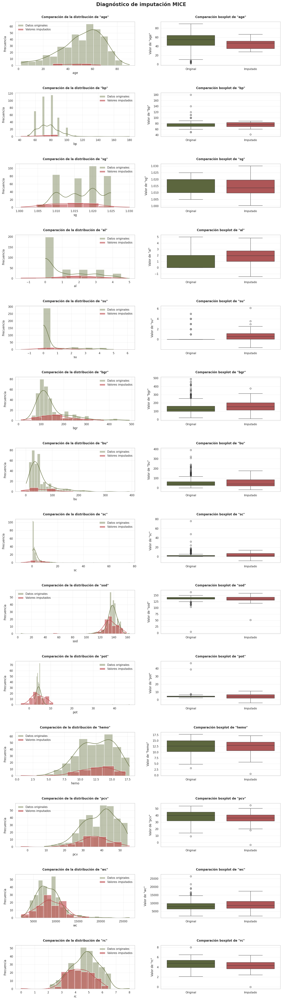

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import BayesianRidge
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import mean_squared_error, r2_score
import warnings
import logging
from tqdm.auto import tqdm

def impute_missing_values_mice(df, max_iterations=20, random_state=42, estimator=None,
                              diagnostic_plots=True, return_convergence=False,
                              cross_validation=False, n_splits=5, verbose=True):
    """
    Imputación MICE con visualización avanzada, diagnóstico y validación cruzada

    -----------
    Parametros:
    -----------
    df : DataFrame de entrada con valores faltantes.
    max_iterations : número máximo de iteraciones de imputación.
    random_state : semilla aleatoria para reproducibilidad.
    estimator : estimador personalizado (predeterminado: BayesianRidge).
    diagnostic_plots si se generan gráficos de diagnóstico.
    return_convergence : si se devuelve información de convergencia.
    cross_validation : si se realiza una validación cruzada para evaluar la precisión de la imputación.
    n_splits : número de divisiones para la validación cruzada.
    verbose : si se imprime la información de progreso.

    --------
    Devuelve:
    --------
    dict: contiene los resultados de imputación y los metadatos.
    """

    # Suprimir los mensajes de log de IterativeImputer
    logging.getLogger('sklearn.impute._iterative').setLevel(logging.ERROR)

    np.random.seed(random_state)

    # Validar el Dataframe de entrada
    if df is None or df.empty:
        raise ValueError("Input dataframe cannot be None or empty")

    # Seleccionar columnas numéricas para la imputación
    numerical_columns = df.select_dtypes(include=['number']).columns

    if len(numerical_columns) == 0:
        raise ValueError("No numerical columns found for imputation")

    X = df[numerical_columns].copy()

    # Comprobar columnas con todos los valores faltantes
    all_missing = X.columns[X.isna().all()].tolist()
    if all_missing:
        if verbose:
            print(f"Columnas con todos los valores faltantes: {all_missing}")
            print("Estas columnas se excluirán de la imputación.")
        X = X.drop(columns=all_missing)
        numerical_columns = X.columns.tolist()  # Convertimos a lista para mantener coherencia

    # Comprueba si faltan valores
    if not X.isna().any().any():
        if verbose:
            print("No se encontraron valores faltantes en las columnas numéricas. No se requiere imputación.")
        return {
            'imputed_data': X,
            'imputation_metadata': {},
            'message': 'No es necesaria ninguna imputación.'
        }

    imputation_metadata = {}
    convergence_data = {}

    # Preparar gráficos de diagnóstico si se solicita
    if diagnostic_plots:
        n_cols = len(numerical_columns)
        n_rows = sum(X[col].isna().any() for col in numerical_columns)

        if n_rows == 0:
            diagnostic_plots = False
        else:
            fig, axes = plt.subplots(n_rows, 2, figsize=(16, 4*n_rows))
            fig.suptitle('Diagnóstico de imputación MICE', fontsize=20, fontweight='bold', y=1)
            if n_rows == 1:
                axes = np.array([axes])
            plot_idx = 0

    # Estandarización para una mejor convergencia
    scaler = StandardScaler()
    # Manejar el caso donde algunas columnas podrían ser todas NaN
    X_mean_filled = X.copy()
    for col in X.columns:
        if X[col].isna().any():
            X_mean_filled[col] = X[col].fillna(X[col].mean() if not pd.isna(X[col].mean()) else 0)

    X_scaled = pd.DataFrame(
        scaler.fit_transform(X_mean_filled),
        columns=X.columns,
        index=X.index
    )

    # Restablecer los valores NaN después de escalar
    for col in X.columns:
        X_scaled.loc[X[col].isna(), col] = np.nan

    # Inicializar el imputador MICE con el estimador apropiado
    if estimator is None:
        estimator = BayesianRidge(max_iter=300)

    mice_imputer = IterativeImputer(
        estimator=estimator,
        max_iter=max_iterations,
        random_state=random_state,
        tol=1e-5,
        imputation_order='ascending',
        sample_posterior=True,
        verbose=0,  # Siempre usar 0 para evitar mensajes de "Completing matrix"
        skip_complete=True
    )

    # Seguimiento de la convergencia si se solicita
    if return_convergence:
        for col in numerical_columns:
            if X[col].isna().any():
                convergence_data[col] = {'iterations': [], 'rmse': []}

    # Realizar la imputación
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        X_imputed_scaled = mice_imputer.fit_transform(X_scaled)

    # Volver a la escala original
    X_imputed = pd.DataFrame(
        scaler.inverse_transform(X_imputed_scaled),
        columns=X.columns,
        index=X.index
    )

    # Validación cruzada para la evaluación de la calidad de la imputación si se solicita
    cv_results = {}
    if cross_validation and any(X[col].isna().sum() > 10 for col in X.columns):
        if verbose:
            print("\nRealizando validación cruzada para evaluar la calidad de la imputación.")

        # Usar tqdm para mostrar una barra de progreso si verbose=True, en lugar de mensajes por columna
        columns_to_validate = [col for col in X.columns if X[col].isna().sum() > 0 and len(X[col].dropna()) >= 20]
        columns_iterator = tqdm(columns_to_validate) if verbose else columns_to_validate

        for col in columns_iterator:
            # Establecer descripción de la barra de progreso si está activada
            if verbose and isinstance(columns_iterator, tqdm):
                columns_iterator.set_description(f"Validando {col}")

            # Realizar el CV sólo en columnas con suficientes valores no ausentes
            non_missing_idx = X[col].dropna().index
            original_values = X.loc[non_missing_idx, col].values

            cv_scores = {'rmse': [], 'r2': []}
            kf = KFold(n_splits=min(n_splits, len(non_missing_idx)//5), shuffle=True, random_state=random_state)

            for train_idx, test_idx in kf.split(non_missing_idx):
                # Crear una copia con valores perdidos introducidos artificialmente
                X_cv = X.copy()
                test_indices = non_missing_idx[test_idx]
                X_cv.loc[test_indices, col] = np.nan

                # Normalizar e imputar
                X_cv_mean_filled = X_cv.copy()
                for c in X_cv.columns:
                    if X_cv[c].isna().any():
                        X_cv_mean_filled[c] = X_cv[c].fillna(X_cv[c].mean() if not pd.isna(X_cv[c].mean()) else 0)

                X_cv_scaled = pd.DataFrame(
                    scaler.transform(X_cv_mean_filled),
                    columns=X_cv.columns,
                    index=X_cv.index
                )

                # Restablecer valores NaN tras el escalado
                for c in X_cv.columns:
                    X_cv_scaled.loc[X_cv[c].isna(), c] = np.nan

                # Usar siempre verbose=0 en el imputer para evitar mensajes
                X_cv_imputed_scaled = mice_imputer.transform(X_cv_scaled)
                X_cv_imputed = pd.DataFrame(
                    scaler.inverse_transform(X_cv_imputed_scaled),
                    columns=X_cv.columns,
                    index=X_cv.index
                )

                # Evaluar la imputación en el conjunto de pruebas
                true_values = X.loc[test_indices, col].values
                predicted_values = X_cv_imputed.loc[test_indices, col].values

                rmse = np.sqrt(mean_squared_error(true_values, predicted_values))
                r2 = r2_score(true_values, predicted_values)

                cv_scores['rmse'].append(rmse)
                cv_scores['r2'].append(r2)

            cv_results[col] = {
                'mean_rmse': np.mean(cv_scores['rmse']),
                'std_rmse': np.std(cv_scores['rmse']),
                'mean_r2': np.mean(cv_scores['r2']),
                'std_r2': np.std(cv_scores['r2'])
            }

    # Procesar los resultados de la imputación y generar diagnósticos
    missing_columns = [col for col in numerical_columns if X[col].isna().any()]
    if verbose:
        print(f"\n📊 Resumen de imputación para {len(missing_columns)} columnas con valores faltantes.")

    for idx, column in enumerate(numerical_columns):
        missing_mask = X[column].isna()
        n_missing = missing_mask.sum()

        if n_missing == 0:
            if verbose:
                print(f"No faltan valores en '{column}'. No es necesaria la imputación.")
            continue

        if len(X[column].dropna()) < 5:
            if verbose:
                print(f"Datos insuficientes en '{column}' para una imputación fiable. Los resultados pueden ser poco fiables.")

        # Almacenar metadatos de imputación
        imputed_values = X_imputed.loc[missing_mask, column]
        original_data = X[column].dropna()

        # Protección contra división por cero o datos vacíos
        percent_change = np.nan
        if not original_data.empty and original_data.mean() != 0:
            percent_change = (imputed_values.mean() - original_data.mean()) / original_data.mean() * 100

        imputation_metadata[column] = {
            'missing_count': n_missing,
            'missing_percent': n_missing/len(X) * 100,
            'imputed_mean': imputed_values.mean(),
            'imputed_median': imputed_values.median(),
            'imputed_std': imputed_values.std(),
            'imputed_range': (imputed_values.min(), imputed_values.max()),
            'original_mean': original_data.mean(),
            'original_std': original_data.std(),
            'percent_change_mean': percent_change
        }

        # Generar gráficos de diagnóstico si se solicita
        if diagnostic_plots and n_missing > 0:
            try:
                # 1. Distribución original vs. distribución imputada
                if not original_data.empty:
                    sns.histplot(original_data, kde=True, ax=axes[plot_idx, 0], color='#606c38', alpha=0.4, label='Datos originales')
                if len(imputed_values) > 0:
                    sns.histplot(imputed_values, kde=True, ax=axes[plot_idx, 0], color='#bc4749', alpha=0.6, label='Valores imputados')
                axes[plot_idx, 0].set_title(f'Comparación de la distribución de "{column}"', fontsize=12, pad=15, fontweight='bold')
                axes[plot_idx, 0].legend()
                axes[plot_idx, 0].set_ylabel('Frecuencia', labelpad=12)

                # 2. Comparación de boxplot
                data_to_plot = {}
                if not original_data.empty:
                    data_to_plot['Original'] = original_data
                data_to_plot['Imputado'] = imputed_values

                if data_to_plot:
                    combined = pd.DataFrame(data_to_plot)
                    sns.boxplot(data=combined, ax=axes[plot_idx, 1], palette=['#606c38', '#bc4749'])
                    axes[plot_idx, 1].set_title(f'Comparación boxplot de "{column}"', fontsize=12, pad=15, fontweight='bold')
                    axes[plot_idx, 1].set_ylabel(f'Valor de "{column}"', labelpad=12)

                plot_idx += 1
            except Exception as e:
                if verbose:
                    print(f"Gráficos de generación de errores para la columna '{column}': {str(e)}")

        if verbose:
            print(f'\n🔹 COLUMNA "{column}":')
            print(f"   Valores faltantes: {n_missing} ({n_missing/len(X):.1%})")
            if not original_data.empty:
                print(f"   Datos originales: Media = {original_data.mean():.2f}, Mediana = {original_data.median():.2f}, Desviación típica = {original_data.std():.2f}")
            print(f"   Datos imputados: Media = {imputed_values.mean():.2f}, Mediana = {imputed_values.median():.2f}, Desviación típica = {imputed_values.std():.2f}")
            if not pd.isna(percent_change):
                print(f"   Cambio medio: {percent_change:.1f}%")
            if column in cv_results:
                print(f"   Resultados de la validación cruzada: RMSE = {cv_results[column]['mean_rmse']:.3f} ± {cv_results[column]['std_rmse']:.3f}, R² = {cv_results[column]['mean_r2']:.3f} ± {cv_results[column]['std_r2']:.3f}")

    if diagnostic_plots and plot_idx > 0:
        try:
            print("\n")
            plt.tight_layout(h_pad=4.0, w_pad=3.0)
            plt.subplots_adjust(top=0.98)
            plt.show()
        except Exception as e:
            if verbose:
                print(f"Error en la visualización de gráficos: {str(e)}")

    # Para las columnas del dataframe original que se imputaron, las copiamos de nuevo
    result_df = df.copy()
    for col in numerical_columns:
        result_df[col] = X_imputed[col]

    # Preparamos el diccionario de devolución
    result = {
        'imputed_data': result_df,
        'imputation_metadata': imputation_metadata
    }

    if cross_validation and cv_results:
        result['cv_results'] = cv_results

    if return_convergence:
        result['convergence_data'] = convergence_data

    return result

MICE_result = impute_missing_values_mice(
     df=cleaned_kidney_df,
     max_iterations=15,
     diagnostic_plots=True,
     cross_validation=True,
     verbose=True
)

imputed_df_MICE = MICE_result['imputed_data']
metadata_MICE = MICE_result['imputation_metadata']

In [ ]:
numeric_columns_MICE = imputed_df_MICE.select_dtypes(include=['number'])
numeric_columns_MICE.head(10)

,age,bp,sg,al,su,bgr,bu,sc,sod,pot,hemo,pcv,wc,rc
id,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,121.00,36.00,1.20,147.09,9.19,15.40,44.00,"7,800.00",5.20
1,7.00,50.00,1.02,4.00,0.00,301.94,18.00,0.80,126.95,7.66,11.30,38.00,"6,000.00",5.02
2,62.00,80.00,1.01,2.00,3.00,423.00,53.00,1.80,128.82,1.49,9.60,31.00,"7,500.00",4.42
3,48.00,70.00,1.00,4.00,0.00,117.00,56.00,3.80,111.00,2.50,11.20,32.00,"6,700.00",3.90
4,51.00,80.00,1.01,2.00,0.00,106.00,26.00,1.40,131.93,0.39,11.60,35.00,"7,300.00",4.60
5,60.00,90.00,1.01,3.00,0.00,74.00,25.00,1.10,142.00,3.20,12.20,39.00,"7,800.00",4.40
6,68.00,70.00,1.01,0.00,0.00,100.00,54.00,24.00,104.00,4.00,12.40,36.00,"7,334.70",3.44
7,24.00,81.02,1.01,2.00,4.00,410.00,31.00,1.10,137.13,8.25,12.40,44.00,"6,900.00",5.00
8,52.00,100.00,1.01,3.00,0.00,138.00,60.00,1.90,135.53,3.03,10.80,33.00,"9,600.00",4.00


In [ ]:
numeric_columns_MICE.isna().sum()

,0
age,0
bp,0
sg,0
al,0
su,0
bgr,0
bu,0
sc,0
sod,0
pot,0


Para finalizar este apartado y obtener una comprensión más profunda sobre las técnicas de imputación utilizadas, hemos decidido realizar una comparación exhaustiva entre los distintos métodos aplicados.

El objetivo es evaluar, desde un punto de vista estadístico y visual, cómo se comporta cada técnica respecto a los datos originales. Para ello, hemos desarrollado la función `compare_imputation_with_stats`, que automatiza este análisis de manera estructurada, incorporando tanto pruebas estadísticas como métricas de validación cruzada, en caso de estar disponibles.

Esta función toma como entrada los dataframes resultantes de cada método de imputación, junto con el conjunto original antes del tratamiento de los valores perdidos, y genera una tabla que resume todas las métricas que veremos a continuación, facilitando la comparación directa entre los métodos. Las funcionalidades principales de la función son:

*   Seleccionar las variables numéricas con datos ausentes en el dataset original.
*   Recuperar los valores imputados por cada técnica y compararlos con los valores originales, calculando:
    *   Media y desviación estándar.
    *   Diferencias absolutas respecto a las estadísticas originales.
*   Realizar un conjunto de pruebas estadísticas:
    *   Kolmogorov-Smirnov (KS): evalúa si las distribuciones originales e imputadas provienen de la misma distribución.
    *   t-test: contrasta si las medias de los grupos originales e imputados son significativamente distintas.
    *   Shapiro-Wilk: analiza la normalidad de los datos, tanto originales como imputados.
*   Evaluar los resultados de validación cruzada, calculando la media y desviación estándar del RMSE y del R² para cada técnica y variable imputada.
*   Aplicar varios estilos a los distintos grupos de columnas (medias, desviaciones, tests, métricas) para resaltar los valores más relevantes en la tabla resultante. Esto facilita la interpretación de los resultados y la posterior toma de decisiones. Estas funciones de estilo son:
    *   `highlight_min_diff`: resalta las celdas con las diferencias más bajas en las columnas relacionadas con las diferencias.
    *   `highlight_min_rmse`: resalta las celdas con el valor más bajo de RMSE.
    *   `highlight_max_r2`: resalta las celdas con el valor más alto de R².
    *   `highlight_significant_pvalues`: resalta las celdas con valores p significativos (menores a 0,05).
    *   `highlight_min_var_diff`: resalta las celdas con las diferencias más bajas en la desviación estándar.
    *   `highlight_mean_mean_diff`: resalta específicamente la columna `Mean_mean_diff`, ya que su valor siempre será 0.
    *   `highlight_info_cells`: resalta las celdas que contienen un mensaje, tenemmos dos tipos:
        *   Gris claro para advertencias o mensajes informativos, como valores "insuficientes", "no válidos" o "no disponibles".
        *   Gris oscuro para errores explícitos, es decir, cuando la celda contiene la palabra "error".

In [ ]:
def compare_imputation_with_stats(knn_imputed, mice_imputed, mean_imputation_data, median_imputation_data, original_df, cv_results=None):
    """
    Comparar métodos de imputación con métricas estadísticas y visualizaciones

    -----------
    Parámetros:
    -----------
    knn_imputed: Dataframe con valores imputados por KNN.
    mice_imputed: Dataframe con valores imputados por MICE.
    mean_imputation_data: Dataframe con valores imputados por la media (de impute_with_strategy).
    median_imputation_data: Dataframe con valores imputados por la mediana (de impute_with_strategy).
    original_df: Dataframe original antes de la imputación.
    cv_results: resultados de validación cruzada para RMSE y R² (opcional).

    --------
    Devuelve:
    --------
    dict: contiene la comparación estadística y visualizaciones.
    """
    import numpy as np
    import pandas as pd
    from scipy import stats
    import warnings

    numerical_columns = original_df.select_dtypes(include=['number']).columns
    cols_with_missing = [col for col in numerical_columns if original_df[col].isna().sum() > 0]

    if not cols_with_missing:
        print("No columns with missing values found.")
        return {'stats_comparison': pd.DataFrame(), 'plots': {}}

    results = {
        'stats_comparison': pd.DataFrame(),
        'plots': {}
    }

    stats_data = []

    # Calcular estadísticas para cada columna
    for column in cols_with_missing:
        original_complete = original_df[column].dropna()
        missing_mask = original_df[column].isna()

        # Obtener valores imputados
        knn_values = knn_imputed.loc[missing_mask, column]
        mice_values = mice_imputed.loc[missing_mask, column]
        mean_values = mean_imputation_data.loc[missing_mask, column]
        median_values = median_imputation_data.loc[missing_mask, column]

        # Inicializar variables para métricas estadísticas con valores que indican el motivo del fallo
        # Usaremos strings especiales para indicar la razón del fallo
        ks_stat_original_knn = ks_pvalue_original_knn = "Información insuficiente"
        ks_stat_original_mice = ks_pvalue_original_mice = "Información insuficiente"
        ks_stat_original_mean = ks_pvalue_original_mean = "Información insuficiente"
        ks_stat_original_median = ks_pvalue_original_median = "Información insuficiente"

        t_stat_original_knn = t_pvalue_original_knn = "Información insuficiente"
        t_stat_original_mice = t_pvalue_original_mice = "Información insuficiente"
        t_stat_original_mean = t_pvalue_original_mean = "Información insuficiente"
        t_stat_original_median = t_pvalue_original_median = "Información insuficiente"

        shapiro_stat_original = shapiro_pvalue_original = "Información insuficiente"
        shapiro_stat_knn = shapiro_pvalue_knn = "Información insuficiente"
        shapiro_stat_mice = shapiro_pvalue_mice = "Información insuficiente"
        shapiro_stat_mean = shapiro_pvalue_mean = "Información insuficiente"
        shapiro_stat_median = shapiro_pvalue_median = "Información insuficiente"

        with np.errstate(all='ignore'):
            # Calcular KS test (original vs imputados) usando ks_2samp
            if len(original_complete) > 0 and len(original_complete) > 5:
                try:
                    # Verificar que las distribuciones no sean constantes antes de ejecutar KS test
                    if len(knn_values) > 5 and knn_values.nunique() > 1:
                        ks_stat_original_knn, ks_pvalue_original_knn = stats.ks_2samp(
                            original_complete, knn_values
                        )
                    else:
                        ks_stat_original_knn = "Datos insuficientes"
                        ks_pvalue_original_knn = "Datos insuficientes"

                    if len(mice_values) > 5 and mice_values.nunique() > 1:
                        ks_stat_original_mice, ks_pvalue_original_mice = stats.ks_2samp(
                            original_complete, mice_values
                        )
                    else:
                        ks_stat_original_mice = "Datos insuficientes"
                        ks_pvalue_original_mice = "Datos insuficientes"

                    if len(mean_values) > 5 and mean_values.nunique() > 1:
                        ks_stat_original_mean, ks_pvalue_original_mean = stats.ks_2samp(
                            original_complete, mean_values
                        )
                    else:
                        ks_stat_original_mean = "Datos insuficientes"
                        ks_pvalue_original_mean = "Datos insuficientes"

                    if len(median_values) > 5 and median_values.nunique() > 1:
                        ks_stat_original_median, ks_pvalue_original_median = stats.ks_2samp(
                            original_complete, median_values
                        )
                    else:
                        ks_stat_original_median = "Datos insuficientes"
                        ks_pvalue_original_median = "Datos insuficientes"

                except Exception as e:
                    error_msg = str(e)[:20] + "..." if len(str(e)) > 20 else str(e)
                    ks_stat_original_knn = ks_pvalue_original_knn = f"Error: {error_msg}"
                    ks_stat_original_mice = ks_pvalue_original_mice = f"Error: {error_msg}"
                    ks_stat_original_mean = ks_pvalue_original_mean = f"Error: {error_msg}"
                    ks_stat_original_median = ks_pvalue_original_median = f"Error: {error_msg}"

                # Calcular t-test (original vs imputados)
                try:
                    # Añadir condiciones para evitar problemas de precisión numérica
                    if (len(knn_values) > 1 and knn_values.std() > 1e-10 and
                        original_complete.std() > 1e-10):
                        t_stat_original_knn, t_pvalue_original_knn = stats.ttest_ind(
                            original_complete, knn_values, equal_var=False, nan_policy='omit'
                        )
                    else:
                        t_stat_original_knn = "Varianza insuficiente"
                        t_pvalue_original_knn = "Varianza insuficiente"

                    if (len(mice_values) > 1 and mice_values.std() > 1e-10 and
                        original_complete.std() > 1e-10):
                        t_stat_original_mice, t_pvalue_original_mice = stats.ttest_ind(
                            original_complete, mice_values, equal_var=False, nan_policy='omit'
                        )
                    else:
                        t_stat_original_mice = "Varianza insuficiente"
                        t_pvalue_original_mice = "Varianza insuficiente"

                    if (len(mean_values) > 1 and mean_values.std() > 1e-10 and
                        original_complete.std() > 1e-10):
                        t_stat_original_mean, t_pvalue_original_mean = stats.ttest_ind(
                            original_complete, mean_values, equal_var=False, nan_policy='omit'
                        )
                    else:
                        t_stat_original_mean = "Varianza insuficiente"
                        t_pvalue_original_mean = "Varianza insuficiente"

                    if (len(median_values) > 1 and median_values.std() > 1e-10 and
                        original_complete.std() > 1e-10):
                        t_stat_original_median, t_pvalue_original_median = stats.ttest_ind(
                            original_complete, median_values, equal_var=False, nan_policy='omit'
                        )
                    else:
                        t_stat_original_median = "Varianza insuficiente"
                        t_pvalue_original_median = "Varianza insuficiente"

                except Exception as e:
                    error_msg = str(e)[:20] + "..." if len(str(e)) > 20 else str(e)
                    t_stat_original_knn = t_pvalue_original_knn = f"Error: {error_msg}"
                    t_stat_original_mice = t_pvalue_original_mice = f"Error: {error_msg}"
                    t_stat_original_mean = t_pvalue_original_mean = f"Error: {error_msg}"
                    t_stat_original_median = t_pvalue_original_median = f"Error: {error_msg}"

                # Shapiro-Wilk test para normalidad
                try:
                    # Verificar que las distribuciones no sean constantes antes de Shapiro-Wilk
                    if (len(original_complete) <= 5000 and len(original_complete) >= 3 and
                        original_complete.min() != original_complete.max()):
                        with warnings.catch_warnings():
                            warnings.filterwarnings("ignore", category=UserWarning,
                                                  message="Input data has range zero")
                            shapiro_stat_original, shapiro_pvalue_original = stats.shapiro(original_complete)
                    else:
                        shapiro_stat_original = "Rango no válido"
                        shapiro_pvalue_original = "Rango no válido"

                    if (3 <= len(knn_values) <= 5000 and knn_values.min() != knn_values.max()):
                        with warnings.catch_warnings():
                            warnings.filterwarnings("ignore", category=UserWarning,
                                                  message="Input data has range zero")
                            shapiro_stat_knn, shapiro_pvalue_knn = stats.shapiro(knn_values)
                    else:
                        shapiro_stat_knn = "Rango no válido"
                        shapiro_pvalue_knn = "Rango no válido"

                    if (3 <= len(mice_values) <= 5000 and mice_values.min() != mice_values.max()):
                        with warnings.catch_warnings():
                            warnings.filterwarnings("ignore", category=UserWarning,
                                                  message="Input data has range zero")
                            shapiro_stat_mice, shapiro_pvalue_mice = stats.shapiro(mice_values)
                    else:
                        shapiro_stat_mice = "Rango no válido"
                        shapiro_pvalue_mice = "Rango no válido"

                    if (3 <= len(mean_values) <= 5000 and mean_values.min() != mean_values.max()):
                        with warnings.catch_warnings():
                            warnings.filterwarnings("ignore", category=UserWarning,
                                                  message="Input data has range zero")
                            shapiro_stat_mean, shapiro_pvalue_mean = stats.shapiro(mean_values)
                    else:
                        shapiro_stat_mean = "Rango no válido"
                        shapiro_pvalue_mean = "Rango no válido"

                    if (3 <= len(median_values) <= 5000 and median_values.min() != median_values.max()):
                        with warnings.catch_warnings():
                            warnings.filterwarnings("ignore", category=UserWarning,
                                                  message="Input data has range zero")
                            shapiro_stat_median, shapiro_pvalue_median = stats.shapiro(median_values)
                    else:
                        shapiro_stat_median = "Rango no válido"
                        shapiro_pvalue_median = "Rango no válido"

                except Exception as e:
                    error_msg = str(e)[:20] + "..." if len(str(e)) > 20 else str(e)
                    shapiro_stat_original = shapiro_pvalue_original = f"Error: {error_msg}"
                    shapiro_stat_knn = shapiro_pvalue_knn = f"Error: {error_msg}"
                    shapiro_stat_mice = shapiro_pvalue_mice = f"Error: {error_msg}"
                    shapiro_stat_mean = shapiro_pvalue_mean = f"Error: {error_msg}"
                    shapiro_stat_median = shapiro_pvalue_median = f"Error: {error_msg}"

        # Inicializar variables para RMSE y R²
        rmse_knn = rmse_std_knn = r2_knn = r2_std_knn = "No disponible"
        rmse_mice = rmse_std_mice = r2_mice = r2_std_mice = "No disponible"
        rmse_mean = rmse_std_mean = r2_mean = r2_std_mean = "No disponible"
        rmse_median = rmse_std_median = r2_median = r2_std_median = "No disponible"

        # Extraer datos de validación cruzada de otros métodos
        if cv_results is not None:
            # Para KNN
            if 'KNN' in cv_results:
                # Si el objeto KNN tiene cv_results como atributo
                if hasattr(knn_imputed, 'cv_results') and column in knn_imputed.cv_results:
                    knn_data = knn_imputed.cv_results[column]
                    if isinstance(knn_data, dict):
                        rmse_knn = knn_data.get('mean_rmse', "No disponible")
                        rmse_std_knn = knn_data.get('std_rmse', "No disponible")
                        r2_knn = knn_data.get('mean_r2', "No disponible")
                        r2_std_knn = knn_data.get('std_r2', "No disponible")

                # Si cv_results tiene la estructura anidada
                elif column in cv_results['KNN']:
                    knn_data = cv_results['KNN'][column]
                    if isinstance(knn_data, dict):
                        rmse_knn = knn_data.get('mean_rmse', "No disponible")
                        rmse_std_knn = knn_data.get('std_rmse', "No disponible")
                        r2_knn = knn_data.get('mean_r2', "No disponible")
                        r2_std_knn = knn_data.get('std_r2', "No disponible")

            # Para MICE
            if 'MICE' in cv_results:
                # Si el objeto KNN tiene cv_results como atributo
                if hasattr(mice_imputed, 'cv_results') and column in mice_imputed.cv_results:
                    mice_data = mice_imputed.cv_results[column]
                    if isinstance(mice_data, dict):
                        rmse_mice = mice_data.get('mean_rmse', "No disponible")
                        rmse_std_mice = mice_data.get('std_rmse', "No disponible")
                        r2_mice = mice_data.get('mean_r2', "No disponible")
                        r2_std_mice = mice_data.get('std_r2', "No disponible")

                # Si cv_results tiene la estructura anidada
                elif column in cv_results['MICE']:
                    mice_data = cv_results['MICE'][column]
                    if isinstance(mice_data, dict):
                        rmse_mice = mice_data.get('mean_rmse', "No disponible")
                        rmse_std_mice = mice_data.get('std_rmse', "No disponible")
                        r2_mice = mice_data.get('mean_r2', "No disponible")
                        r2_std_mice = mice_data.get('std_r2', "No disponible")

            # Para Mean
            if 'Mean' in cv_results and cv_results['Mean']:
                mean_data = None
                if column in cv_results['Mean']:
                    mean_data = cv_results['Mean'][column]

                if isinstance(mean_data, dict):
                    rmse_mean = mean_data.get('mean_rmse', "No disponible")
                    rmse_std_mean = mean_data.get('std_rmse', "No disponible")
                    r2_mean = mean_data.get('mean_r2', "No disponible")

            # Para Median
            if 'Median' in cv_results and cv_results['Median']:
                median_data = None
                if column in cv_results['Median']:
                    median_data = cv_results['Median'][column]

                if isinstance(median_data, dict):
                    rmse_median = median_data.get('mean_rmse', "No disponible")
                    rmse_std_median = median_data.get('std_rmse', "No disponible")
                    r2_median = median_data.get('mean_r2', "No disponible")
                    r2_std_median = median_data.get('std_r2', "No disponible")

        stats_data.append({
            'Variable': column,
            'N_imputed': len(knn_values),
            'Original_mean': original_complete.mean(),
            'KNN_mean': knn_values.mean(),
            'MICE_mean': mice_values.mean(),
            'Mean_mean': mean_values.mean(),
            'Median_mean': median_values.mean(),
            'KNN_mean_diff': abs(knn_values.mean() - original_complete.mean()),
            'MICE_mean_diff': abs(mice_values.mean() - original_complete.mean()),
            'Mean_mean_diff': abs(mean_values.mean() - original_complete.mean()),
            'Median_mean_diff': abs(median_values.mean() - original_complete.mean()),
            'Original_std': original_complete.std(),
            'KNN_std': knn_values.std(),
            'MICE_std': mice_values.std(),
            'Mean_std': mean_values.std(),
            'Median_std': median_values.std(),
            'Std_diff_KNN': abs(knn_values.std() - original_complete.std()),
            'Std_diff_MICE': abs(mice_values.std() - original_complete.std()),
            'Std_diff_Mean': abs(mean_values.std() - original_complete.std()),
            'Std_diff_Median': abs(median_values.std() - original_complete.std()),
            'KS_stat_Original_KNN': ks_stat_original_knn,
            'KS_stat_Original_MICE': ks_stat_original_mice,
            'KS_stat_Original_Mean': ks_stat_original_mean,
            'KS_stat_Original_Median': ks_stat_original_median,
            'KS_pvalue_Original_KNN': ks_pvalue_original_knn,
            'KS_pvalue_Original_MICE': ks_pvalue_original_mice,
            'KS_pvalue_Original_Mean': ks_pvalue_original_mean,
            'KS_pvalue_Original_Median': ks_pvalue_original_median,
            'Ttest_pvalue_Original_KNN': t_pvalue_original_knn,
            'Ttest_pvalue_Original_MICE': t_pvalue_original_mice,
            'Ttest_pvalue_Original_Mean': t_pvalue_original_mean,
            'Ttest_pvalue_Original_Median': t_pvalue_original_median,
            'Shapiro_stat_Original': shapiro_stat_original,
            'Shapiro_stat_KNN': shapiro_stat_knn,
            'Shapiro_stat_MICE': shapiro_stat_mice,
            'Shapiro_stat_Mean': shapiro_stat_mean,
            'Shapiro_stat_Median': shapiro_stat_median,
            'Shapiro_pvalue_KNN': shapiro_pvalue_knn,
            'Shapiro_pvalue_MICE': shapiro_pvalue_mice,
            'Shapiro_pvalue_Mean': shapiro_pvalue_mean,
            'Shapiro_pvalue_Median': shapiro_pvalue_median,
            'RMSE_KNN': rmse_knn,
            'RMSE_MICE': rmse_mice,
            'RMSE_Mean': rmse_mean,
            'RMSE_Median': rmse_median,
            'R²_KNN': r2_knn,
            'R²_MICE': r2_mice,
            'R²_Mean': r2_mean,
            'R²_Median': r2_median,
        })

    stats_df = pd.DataFrame(stats_data)
    stats_df.set_index('Variable', inplace=True)

    # Función para aplicar estilos múltiples
    def apply_styles(stats_df):
        # Definir los grupos de columnas
        column_groups = {
            'intro': ['Variable', 'N_imputed'],
            'mean': ['Original_mean', 'KNN_mean', 'MICE_mean', 'Mean_mean', 'Median_mean'],
            'mean_diff': ['KNN_mean_diff', 'MICE_mean_diff', 'Mean_mean_diff', 'Median_mean_diff'],
            'std': ['Original_std', 'KNN_std', 'MICE_std', 'Mean_std', 'Median_std'],
            'std_diff': ['Std_diff_KNN', 'Std_diff_MICE', 'Std_diff_Mean', 'Std_diff_Median'],
            'ks_test_stat': ['KS_stat_Original_KNN', 'KS_stat_Original_MICE', 'KS_stat_Original_Mean','KS_stat_Original_Median'],
            'ks_test_pvalue': ['KS_pvalue_Original_KNN', 'KS_pvalue_Original_MICE', 'KS_pvalue_Original_Mean', 'KS_pvalue_Original_Median'],
            't_test': ['Ttest_pvalue_Original_KNN', 'Ttest_pvalue_Original_MICE', 'Ttest_pvalue_Original_Mean', 'Ttest_pvalue_Original_Median'],
            'shapiro_test_stat': ['Shapiro_stat_Original', 'Shapiro_stat_KNN', 'Shapiro_stat_MICE', 'Shapiro_stat_Mean','Shapiro_stat_Median'],
            'shapiro_test_pvalue': ['Shapiro_pvalue_KNN', 'Shapiro_pvalue_MICE','Shapiro_pvalue_Mean', 'Shapiro_pvalue_Median'],
            'rmse': ['RMSE_KNN', 'RMSE_MICE', 'RMSE_Mean', 'RMSE_Median'],
            'r2': ['R²_KNN', 'R²_MICE', 'R²_Mean', 'R²_Median']
        }

        # 1. Resaltar las celdas con valores de diferencia más bajos
        def highlight_min_diff(row):
            diff_cols = ['KNN_mean_diff', 'MICE_mean_diff', 'Median_mean_diff']
            valid_vals = []

            for c in diff_cols:
                if c in row.index and not isinstance(row[c], str) and not pd.isna(row[c]):
                    valid_vals.append((c, row[c]))

            if not valid_vals:
                return [''] * len(row)

            min_col, min_val = min(valid_vals, key=lambda x: x[1])
            return ['background-color: #468faf' if c == min_col else '' for c in row.index]

        # 2. Resaltar las celdas con valores de RMSE más bajos
        def highlight_min_rmse(row):
            rmse_cols = ['RMSE_KNN', 'RMSE_MICE', 'RMSE_Mean', 'RMSE_Median']
            valid_vals = []

            for c in rmse_cols:
                if c in row.index and not isinstance(row[c], str) and not pd.isna(row[c]):
                    valid_vals.append((c, row[c]))

            if not valid_vals:
                return [''] * len(row)

            min_col, min_val = min(valid_vals, key=lambda x: x[1])
            return ['background-color: #6a994e' if c == min_col else '' for c in row.index]

        # 3. Resaltar las celdas con valores de R² más altos
        def highlight_max_r2(row):
            r2_cols = ['R²_KNN', 'R²_MICE', 'R²_Mean', 'R²_Median']
            valid_vals = []

            for c in r2_cols:
                if c in row.index and not isinstance(row[c], str) and not pd.isna(row[c]):
                    valid_vals.append((c, row[c]))

            if not valid_vals:
                return [''] * len(row)

            max_col, max_val = max(valid_vals, key=lambda x: x[1])
            return ['background-color: #f9a620' if c == max_col else '' for c in row.index]

        # 4. Resaltar valores p bajos (< 0.05) para las pruebas estadísticas
        def highlight_significant_pvalues(row):
            pvalue_cols = [c for c in row.index if 'pvalue' in c.lower()]
            result = []

            for c, v in row.items():
                if c in pvalue_cols and not isinstance(v, str) and not pd.isna(v) and 0 < v < 0.05:
                    result.append('background-color: #bc4749')
                else:
                    result.append('')

            return result

        # 5. Resaltar las celdas con valores de diferencia de desviación estándar más bajos
        def highlight_min_var_diff(row):
            var_diff_cols = ['Std_diff_KNN', 'Std_diff_MICE', 'Std_diff_Mean', 'Std_diff_Median']
            valid_vals = []

            for c in var_diff_cols:
                if c in row.index and not isinstance(row[c], str) and not pd.isna(row[c]):
                    valid_vals.append((c, row[c]))

            if not valid_vals:
                return [''] * len(row)

            min_col, min_val = min(valid_vals, key=lambda x: x[1])
            return ['background-color: #9d4edd' if c == min_col else '' for c in row.index]

        # 6. Resaltar específicamente la columna Mean_mean_diff
        def highlight_mean_mean_diff(s):
            is_mean_mean_diff = s.name == 'Mean_mean_diff'
            return ['background-color: #0077b6' if is_mean_mean_diff else '' for _ in s]

        # 7. Marcar celdas con mensajes de error y advertencia con un color de fondo
        def highlight_info_cells(df):
            info_background = 'background-color: #6c757d'
            error_background = 'background-color: #212529'

            # Inicializar matriz de estilos del mismo tamaño que el DataFrame
            styled = pd.DataFrame('', index=df.index, columns=df.columns)

            # Detectar mensajes de información y error en el DataFrame
            for i in df.index:
                for c in df.columns:
                    val = df.loc[i, c]
                    if isinstance(val, str):
                        if "insuficiente" in val.lower() or "no válido" in val.lower() or "no disponible" in val.lower():
                            styled.loc[i, c] = info_background
                        elif "error" in val.lower():
                            styled.loc[i, c] = error_background

            return styled

        # Aplicar separadores entre grupos de columnas
        def add_separators(df):
            # Encontrar las columnas de borde (última columna de cada grupo)
            border_columns = []
            for group_cols in column_groups.values():
                for col in group_cols:
                    if col in df.columns:
                        border_columns.append(col)
                        break

            # Aplicar borde izquierdo a las columnas de borde
            styles = []
            for col in border_columns:
                if col in df.columns:
                    styles.append({
                        'selector': f'td.col{list(df.columns).index(col)}',
                        'props': [('border-left', '3px solid #000000')]
                    })

            return styles

        # Aplicar los estilos en secuencia
        styled = stats_df.style.apply(highlight_min_diff, axis=1)
        styled = styled.apply(highlight_min_rmse, axis=1)
        styled = styled.apply(highlight_max_r2, axis=1)
        styled = styled.apply(highlight_significant_pvalues, axis=1)
        styled = styled.apply(highlight_min_var_diff, axis=1)
        styled = styled.apply(highlight_mean_mean_diff, axis=0)

        # Aplicar estilos a celdas con mensajes informativos
        info_styles = highlight_info_cells(stats_df)
        for i in info_styles.index:
            for c in info_styles.columns:
                if info_styles.loc[i, c]:
                    styled.set_properties(**{'background-color': info_styles.loc[i, c].replace('background-color: ', '')},
                                       subset=pd.IndexSlice[i, c])

        # Añadir separadores
        styled = styled.set_table_styles(add_separators(stats_df))

        return styled

    styled_df = apply_styles(stats_df)

    results['stats_comparison'] = stats_df
    results['styled_comparison'] = styled_df

    print("\n🔹 Comparación estadística de métodos de imputación:\n")
    try:
        from IPython.display import display
        display(styled_df)
    except (NameError, ImportError):
        print("Tabla de comparación estadística generada")
        print(stats_df)

    return results

def run_comparison_analysis(original_df, knn_imputed, mice_imputed, imputation_results, cv_results=None):
    """
    Ejecuta el análisis comparativo entre varios métodos de imputación

    -----------
    Parametros:
    -----------
    original_df : DataFrame original con valores faltantes
    knn_imputed : DataFrame con valores imputados por KNN
    mice_imputed : DataFrame con valores imputados por MICE
    imputation_results : resultados de las imputaciones por media y mediana
    cv_results : resultados de validación cruzada para RMSE y R² (opcional)

    --------
    Returns:
    --------
    dict: resultados del análisis comparativo
    """
    # Obtener los DataFrames de los resultados de imputación por media y mediana
    mean_imputation_data = imputation_results['mean_imputation']['imputed_data']
    median_imputation_data = imputation_results['median_imputation']['imputed_data']

    # Preparar CV results de manera más robusta
    prepared_cv_results = {
        'KNN': {},
        'MICE': {},
        'Mean': {},
        'Median': {}
    }

    # Extraer CV results de AdaptiveKNNImputer si está disponible
    if hasattr(knn_imputed, 'cv_results'):
        prepared_cv_results['KNN'] = knn_imputed.cv_results

    # Extraer resultados de MICE si están disponibles
    mice_cv_results = {}
    if hasattr(mice_imputed, 'cv_results'):
        mice_cv_results = mice_imputed.cv_results

    # O usar cv_results si se proporciona explícitamente
    if cv_results is not None:
        if 'KNN' in cv_results and cv_results['KNN']:
            # Sólo sobrescribir si no se ha obtenido de knn_imputed
            if not prepared_cv_results['KNN'] and cv_results['KNN']:
                prepared_cv_results['KNN'] = cv_results['KNN']

        if 'MICE' in cv_results and cv_results['MICE']:
            prepared_cv_results['MICE'] = cv_results['MICE']

        if 'Mean' in cv_results and cv_results['Mean']:
            prepared_cv_results['Mean'] = cv_results['Mean']

        if 'Median' in cv_results and cv_results['Median']:
            prepared_cv_results['Median'] = cv_results['Median']

    # Extraer resultados de imputación por media/mediana si están disponibles
    if 'cv_results' in imputation_results.get('mean_imputation', {}):
        prepared_cv_results['Mean'] = imputation_results['mean_imputation']['cv_results']

    if 'cv_results' in imputation_results.get('median_imputation', {}):
        prepared_cv_results['Median'] = imputation_results['median_imputation']['cv_results']

    # Ejecutar la comparación
    comparison_results = compare_imputation_with_stats(
        knn_imputed=knn_imputed,
        mice_imputed=mice_imputed,
        mean_imputation_data=mean_imputation_data,
        median_imputation_data=median_imputation_data,
        original_df=original_df,
        cv_results=prepared_cv_results
    )

    return comparison_results

def compare_all_methods(cleaned_kidney_df, numeric_columns_KNN, numeric_columns_MICE, imputation_results):
    """
    Función de nivel superior para ejecutar la comparación de todos los métodos.

    -----------
    Parámetros:
    -----------
    cleaned_kidney_df: DataFrame original con valores faltantes
    numeric_columns_KNN: DataFrame con valores imputados por KNN
    numeric_columns_MICE: DataFrame con valores imputados por MICE
    imputation_results: resultados de imputaciones por media/mediana

    --------
    Retorna:
    --------
    dict: resultados de la comparación
    """

    # Extraer resultados CV directamente de los objetos si es posible
    knn_cv_results = {}
    mice_cv_results = {}

    # Verificar si numeric_columns_KNN es un objeto AdaptiveKNNImputer o tiene cv_results
    if hasattr(numeric_columns_KNN, 'cv_results'):
        knn_cv_results = numeric_columns_KNN.cv_results
    elif isinstance(numeric_columns_KNN, dict) and 'cv_results' in numeric_columns_KNN:
        knn_cv_results = numeric_columns_KNN['cv_results']

    # Verificar si numeric_columns_MICE tiene cv_results
    if hasattr(numeric_columns_MICE, 'cv_results'):
        mice_cv_results = numeric_columns_MICE.cv_results
    elif isinstance(numeric_columns_MICE, dict) and 'mice_imputation' in numeric_columns_MICE:
        if 'cv_results' in numeric_columns_MICE['mice_imputation']:
            mice_cv_results = numeric_columns_MICE['mice_imputation']['cv_results']

    # Preparar el diccionario de resultados CV
    cv_results = {
        'KNN': knn_cv_results,
        'MICE': mice_cv_results,
        'Mean': imputation_results.get('mean_imputation', {}).get('cv_results', {}),
        'Median': imputation_results.get('median_imputation', {}).get('cv_results', {})
    }

    comparison_results = compare_imputation_with_stats(
        knn_imputed=numeric_columns_KNN,
        mice_imputed=numeric_columns_MICE,
        mean_imputation_data=imputation_results['mean_imputation']['imputed_data'],
        median_imputation_data=imputation_results['median_imputation']['imputed_data'],
        original_df=cleaned_kidney_df,
        cv_results=cv_results
    )

    return comparison_results

comparison_results = compare_imputation_with_stats(
    knn_imputed=imputed_df_KNN,
    mice_imputed=imputed_df_MICE,
    mean_imputation_data=imputation_results['mean_imputation']['imputed_data'],
    median_imputation_data=imputation_results['median_imputation']['imputed_data'],
    original_df=cleaned_kidney_df,
    cv_results={
        'KNN': KNN_result.get('cv_results', {}),
        'MICE': MICE_result.get('cv_results', {}),
        'Mean': imputation_results.get('mean_imputation', {}).get('cv_results', {}),
        'Median': imputation_results.get('median_imputation', {}).get('cv_results', {})
    }
)


🔹 Comparación estadística de métodos de imputación:



,N_imputed,Original_mean,KNN_mean,MICE_mean,Mean_mean,Median_mean,KNN_mean_diff,MICE_mean_diff,Mean_mean_diff,Median_mean_diff,Original_std,KNN_std,MICE_std,Mean_std,Median_std,Std_diff_KNN,Std_diff_MICE,Std_diff_Mean,Std_diff_Median,KS_stat_Original_KNN,KS_stat_Original_MICE,KS_stat_Original_Mean,KS_stat_Original_Median,KS_pvalue_Original_KNN,KS_pvalue_Original_MICE,KS_pvalue_Original_Mean,KS_pvalue_Original_Median,Ttest_pvalue_Original_KNN,Ttest_pvalue_Original_MICE,Ttest_pvalue_Original_Mean,Ttest_pvalue_Original_Median,Shapiro_stat_Original,Shapiro_stat_KNN,Shapiro_stat_MICE,Shapiro_stat_Mean,Shapiro_stat_Median,Shapiro_pvalue_KNN,Shapiro_pvalue_MICE,Shapiro_pvalue_Mean,Shapiro_pvalue_Median,RMSE_KNN,RMSE_MICE,RMSE_Mean,RMSE_Median,R²_KNN,R²_MICE,R²_Mean,R²_Median
Variable,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
age,9,51.483376,47.677778,45.738580,51.483376,55.000000,3.805598,5.744796,0.000000,3.516624,17.169714,5.620671,12.218582,0.000000,0.000000,11.549043,4.951132,17.169714,17.169714,0.445013,0.415743,Datos insuficientes,Datos insuficientes,0.041981,0.068739,Datos insuficientes,Datos insuficientes,0.090603,0.201993,Varianza insuficiente,Varianza insuficiente,0.963903,0.935005,0.948441,Rango no válido,Rango no válido,0.530408,0.672953,Rango no válido,Rango no válido,17.602910,23.697439,17.153426,17.412026,-0.064457,-0.929962,-0.007137,-0.038205
bp,12,76.469072,72.037037,73.984302,76.469072,80.000000,4.432035,2.484771,0.000000,3.530928,13.683637,6.797262,13.702347,0.000000,0.000000,6.886376,0.018709,13.683637,13.683637,0.348797,0.234536,Datos insuficientes,Datos insuficientes,0.090728,0.473686,Datos insuficientes,Datos insuficientes,0.051573,0.547977,Varianza insuficiente,Varianza insuficiente,0.868150,0.868984,0.901368,Rango no válido,Rango no válido,0.063441,0.165200,Rango no válido,Rango no válido,13.719210,18.879697,13.300309,14.192456,-0.050599,-1.126055,-0.010807,-0.169428
sg,47,1.017408,1.015628,1.014417,1.017408,1.020000,0.001780,0.002991,0.000000,0.002592,0.005717,0.002183,0.006340,0.000000,0.000000,0.003534,0.000623,0.005717,0.005717,0.508468,0.295702,Datos insuficientes,Datos insuficientes,0.000000,0.001027,Datos insuficientes,Datos insuficientes,0.000084,0.003266,Varianza insuficiente,Varianza insuficiente,0.881658,0.973739,0.989090,Rango no válido,Rango no válido,0.364932,0.935898,Rango no válido,Rango no válido,0.006049,0.006014,0.005737,0.006254,-0.156675,-0.142427,-0.038599,-0.238440
al,46,1.016949,1.317391,1.849715,1.016949,0.000000,0.300442,0.832766,0.000000,1.016949,1.352679,0.417029,1.472909,0.000000,0.000000,0.935650,0.120231,1.352679,1.352679,0.562147,0.453451,Datos insuficientes,Datos insuficientes,0.000000,0.000000,Datos insuficientes,Datos insuficientes,0.001726,0.000600,Varianza insuficiente,Varianza insuficiente,0.744764,0.971683,0.972151,Rango no válido,Rango no válido,0.319466,0.332205,Rango no válido,Rango no válido,1.273320,1.448156,1.351841,1.683916,0.089593,-0.175189,-0.017332,-0.574452
su,49,0.450142,0.481633,0.768425,0.450142,0.000000,0.031490,0.318283,0.000000,0.450142,1.099191,0.438118,1.295778,0.000000,0.000000,0.661073,0.196587,1.099191,1.099191,0.581313,0.581313,Datos insuficientes,Datos insuficientes,0.000000,0.000000,Datos insuficientes,Datos insuficientes,0.714072,0.106611,Varianza insuficiente,Varianza insuficiente,0.468080,0.906819,0.883822,Rango no válido,Rango no válido,0.000924,0.000170,Rango no válido,Rango no válido,0.967697,1.022610,1.081803,1.162496,0.217367,0.012868,-0.019806,-0.173134
bgr,44,148.036517,158.268182,165.461734,148.036517,121.000000,10.231665,17.425217,0.000000,27.036517,79.281714,33.772899,78.094328,0.000000,0.000000,45.508815,1.187386,79.281714,79.281714,0.404239,0.313075,Datos insuficientes,Datos insuficientes,0.000003,0.000659,Datos insuficientes,Datos insuficientes,0.123909,0.168984,Varianza insuficiente,Varianza insuficiente,0.767864,0.962727,0.974496,Rango no válido,Rango no válido,0.164464,0.431259,Rango no válido,Rango no válido,80.862407,

Para la imputación de variables numéricas se evaluaron cuatro enfoques: imputación por media, por mediana, mediante K-Nearest Neighbors (KNN) y utilizando el modelo de imputación iterativa MICE.

La comparación se realizó con base en múltiples métricas estadísticas: diferencias en media y desviación estándar, pruebas de hipótesis (t de Student, Kolmogorov-Smirnov, Shapiro-Wilk), y métricas de error como RMSE y R². A continuación, se presenta un análisis detallado por cada métrica:

1. Diferencia en medias: se calcularon las diferencias absolutas entre la media original y la media resultante tras la imputación con cada método. Esto permite evaluar qué tan bien cada técnica preserva el valor central original de la variable. Por ejemplo, en la variable "age":
    *   KNN tuvo una desviación media de 3.81 unidades respecto al valor original.
    *   MICE presentó una desviación algo mayor, de 5.74 unidades.
    *   El método de la media, por definición, no mostró desviación.
    *   La mediana imputada difirió en 3.51 unidades.

 Dependiendo de la variable las distribuciones de las diferencias cambian. Aun así observando la tabla, se sugiere que KNN suele preservar mejor la media original, aunque puede depender de la simetría de la distribución subyacente.

2. Diferencia en la desviación estándar: se comparó la desviación estándar antes y después de la imputación, y se calculó la diferencia para evaluar cómo cada método afecta la dispersión de los datos. En el caso de la variable "bp":
    *   La diferencia de la desviación estándar se redujo 6.89 unidades con KNN.
    *   Con MICE, prácticamente se mantuvo sin cambios (0.019).

 Este patrón se repitió en la mayoría de las variables, lo que sugiere que KNN tiende a subestimar la variabilidad, mientras que MICE logra conservarla de forma mucho más fiel.

3. Prueba de Kolmogorov-Smirnov (KS): se aplicó la prueba de KS para comparar la distribución completa de los datos originales vs. imputados. Por ejemplo, para la variable "sg":
    *   El estadístico KS fue de 0.51 con KNN.
    *   Mientras que con MICE fue de 0.29.

 En ambos casos, los valores p fueron inferiores a 0.01, indicando diferencias estadísticamente significativas con respecto a la distribución original. Sin embargo, los valores del estadístico en MICE apuntan a una mejor aproximación a la distribución original en comparación con KNN.

4. Prueba t de Student: se utilizó la prueba t para contrastar las medias de los datos imputados frente a los datos originales (sin valores perdidos). Por ejemplo, en la variable "bu":
    *   KNN presentó un p-valor de 0.54.
    *   MICE obtuvo un p-valor de 0.75.

 Ambos valores sugieren que no existe una diferencia estadísticamente significativa en las medias, aunque MICE mostró mayor consistencia en también otras variables.

5. Prueba de normalidad (Shapiro-Wilk): se evaluó si los datos imputados seguían una distribución normal, lo cual puede ser relevante en algunos modelos estadísticos. En el caso de la variable "sc":
    *   MICE obtuvo un estadístico de 0.725 y un p-valor cercano a 0, lo que indica una clara desviación de la normalidad.
    *   KNN mostró un estadístico de 0.978 y un p-valor 0.169, lo que sugiere una distribución más cercana a la normal.

 Este resultado evidencia que, si bien MICE preserva mejor la distribución original, no garantiza que los datos imputados sigan una distribución normal, lo cual es esperable en muchos conjuntos de datos reales.

6. Métricas de error: se calcularon el Error Cuadrático Medio (RMSE) y el coeficiente de determinación (R²) para estimar el ajuste entre los valores imputados y los verdaderos. Para la variable "sod":
    *   RMSE fue similar entre métodos, 10.27 para KNN y 9.8 para MICE.
    *   MICE alcanzó un R² de -0.71, mientras que para KNN fue de -0.014.

 MICE tiende a presentar valores de RMSE más bajos que KNN en la mayoría de las variables. Esto indica que, en términos absolutos, los errores de imputación de MICE son más pequeños. Sin embargo, KNN suele mostrar valores de R² más altos (o menos negativos), lo que sugiere retener mejor la tendencia general de los datos, capturando mejor la varianza de la variable original.

Algunas de las pruebas estadísticas no pudieron aplicarse en las imputaciones realizadas por media y mediana a causa de tener datos y varianza insuficiente, lo que limita la capacidad de evaluación de estos métodos en contextos reales.

Como conclusión podriamos decir que MICE demostró ser el método de imputación más robusto para variables numéricas, con mejores resultados en p-valores, preservación de la desviación estándar, y un ajuste global más estable frente a las otras técnicas. Aunque KNN puede ofrecer menor desviación en la media respecto a la media original, su tendencia a subestimar la dispersión y su bajo rendimiento en RMSE lo hacen menos confiable en general.




#### 3.2.2. Variables categóricas

Una vez completado el análisis de las variables numéricas, el siguiente paso consiste en abordar el estudio de las variables categóricas. Para mantener la coherencia metodológica, se seguirá una estructura similar a la empleada previamente. Como punto de partida, antes de aplicar cualquier técnica de imputación, se llevará a cabo un análisis exploratorio preliminar que permita identificar qué columnas categóricas presentan datos ausentes.

Con este objetivo, se implementa el siguiente fragmento de código, el cual genera un resumen detallado sobre la cantidad absoluta y el porcentaje relativo de valores faltantes en cada una de las columnas categóricas del conjunto de datos.

In [ ]:
# Obtener las columnas categóricas con valores NA
categorical_cols_with_na = cleaned_kidney_df.select_dtypes(include=['object']).columns[
    cleaned_kidney_df.select_dtypes(include=['object']).isna().any()
].tolist()

# Obtener el total de registros (filas) en el DataFrame
total_registros = len(cleaned_kidney_df)

# Calcular el número de valores NA por columna numérica
na_counts_cat = cleaned_kidney_df[categorical_cols_with_na].isna().sum()
na_percentages_cat = (na_counts_cat / total_registros) * 100

# Crear DataFrame de resumen
resumen_faltantes = pd.DataFrame({
    'Variable': categorical_cols_with_na,
    'Valores totales': total_registros,
    'Valores faltantes': [f"{val} ({pct:.2f}%)" for val, pct in zip(na_counts_cat, na_percentages_cat)],
    'Valores válidos': [f"{total_registros - val} ({(100 - pct):.2f}%)" for val, pct in zip(na_counts_cat, na_percentages_cat)]
})

print("🔹 Resumen completo de las variables categóricas:\n")

styled_table4 = resumen_faltantes.style.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})

styled_table4 = styled_table4.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

styled_table4

🔹 Resumen completo de las variables categóricas:



,Variable,Valores totales,Valores faltantes,Valores válidos
0,rbc,400,152 (38.00%),248 (62.00%)
1,pc,400,65 (16.25%),335 (83.75%)
2,pcc,400,4 (1.00%),396 (99.00%)
3,ba,400,4 (1.00%),396 (99.00%)
4,htn,400,2 (0.50%),398 (99.50%)
5,dm,400,2 (0.50%),398 (99.50%)
6,cad,400,2 (0.50%),398 (99.50%)
7,appet,400,1 (0.25%),399 (99.75%)
8,pe,400,1 (0.25%),399 (99.75%)
9,ane,400,1 (0.25%),399 (99.75%)


El primer método de imputación que implementaremos para este tipo de variables es la imputación por moda. Este enfoque se basa en reemplazar los valores ausentes por la categoría más frecuente (la moda) dentro de cada variable. La simplicidad de este método lo convierte en una opción común en etapas iniciales del análisis, especialmente cuando las distribuciones no presentan una gran dispersión o cuando la proporción de valores faltantes es baja.

Para operacionalizar esta técnica de manera sistemática, hemos desarrollado la clase `CategoryModeImputer`. Esta implementación busca no solo completar los datos faltantes, sino también ofrecer una evaluación rigurosa del impacto que tiene esta técnica y su fiabilidad. Esta clase incorpora funcionalidades avanzadas, tales como:
*   Identificación automática de columnas categóricas con valores faltantes.
*   Aplicación del imputador `SimpleImputer` de `scikit-learn` con estrategia `most_frequent`.
*   Validación cruzada para estimar la precisión del método. El proceso divide los datos no faltantes en `n_folds` (pliegues) y, en cada iteración, uno de los pliegues se usa como conjunto de validación, mientras que los otros se emplean para entrenar el modelo de imputación. Luego, se comparan los valores imputados con los valores originales en el conjunto de validación para calcular un puntaje de precisión.
*   Generación de un informe detallado por variable, que incluye:
    *   Proporción de datos faltantes.
    *   Valor de la moda utilizada para la imputación.
    *   Cambios en la distribución de frecuencias antes y después del tratamiento.
    *   Puntaje de validación cruzada y su interpretación cualitativa (excelente, buena, moderada o baja).
*   Visualización gráfica de la distribución original e imputada mediante gráficos circulares para facilitar la comparación.

La ejecución del pipeline completo se realiza a través de la función auxiliar `run_mode_imputation_pipeline`, que aplica la clase previamente definida sobre el conjunto de datos de entrada y devuelve el nuevo DataFrame con los valores imputados.


📊 INFORME DE IMPUTACIÓN POR MODA

🔹 COLUMNA "rbc":
  Valores faltantes: 152 (38.00%)
  Valor utilizado para imputación (moda): normal
  Calidad de imputación: Excelente (CV score: 0.81)
  Cambios en la distribución:
    normal:
      Original: 81.05%, Imputada: 88.25%
      Cambio: +7.20%
    abnormal:
      Original: 18.95%, Imputada: 11.75%
      Cambio: -7.20%

🔹 COLUMNA "pc":
  Valores faltantes: 65 (16.25%)
  Valor utilizado para imputación (moda): normal
  Calidad de imputación: Buena (CV score: 0.77)
  Cambios en la distribución:
    normal:
      Original: 77.31%, Imputada: 81.00%
      Cambio: +3.69%
    abnormal:
      Original: 22.69%, Imputada: 19.00%
      Cambio: -3.69%

🔹 COLUMNA "pcc":
  Valores faltantes: 4 (1.00%)
  Valor utilizado para imputación (moda): notpresent
  Calidad de imputación: Excelente (CV score: 0.89)
  Cambios en la distribución:
    present:
      Original: 10.61%, Imputada: 10.50%
      Cambio: -0.11%
    notpresent:
      Original: 89.39%, Imputad

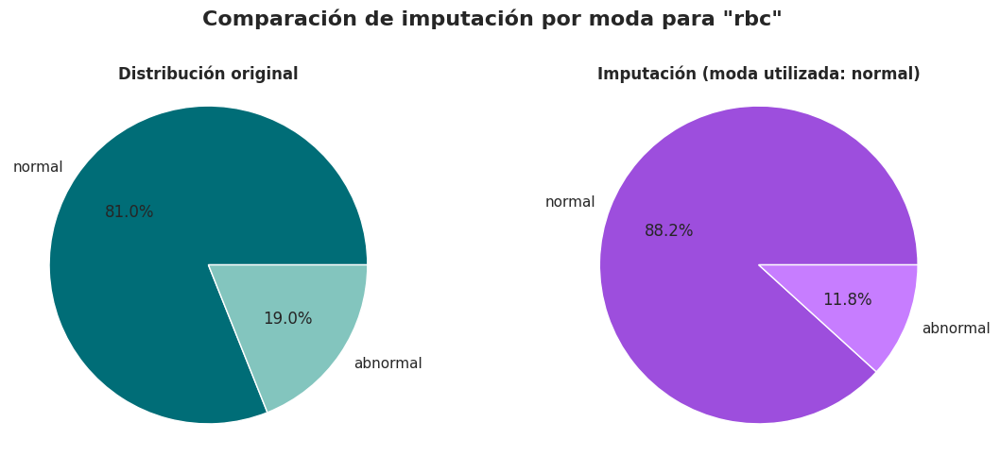

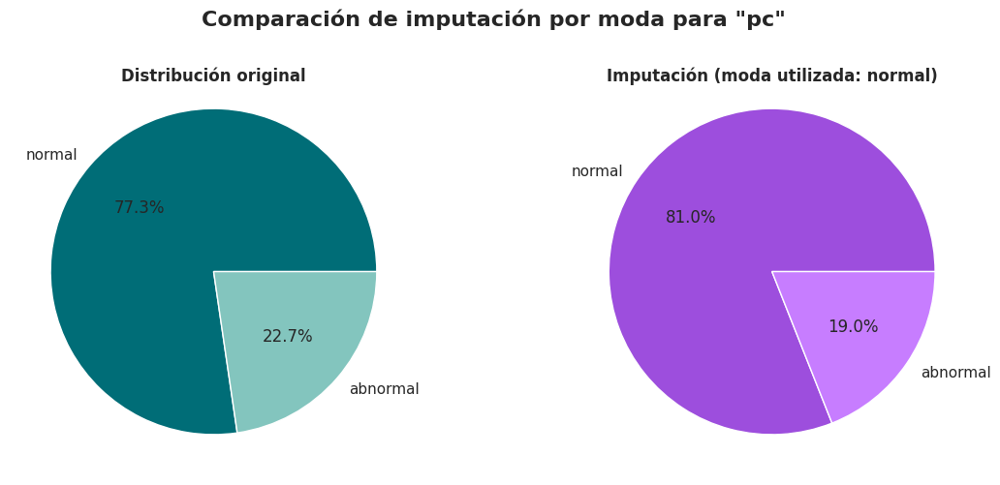

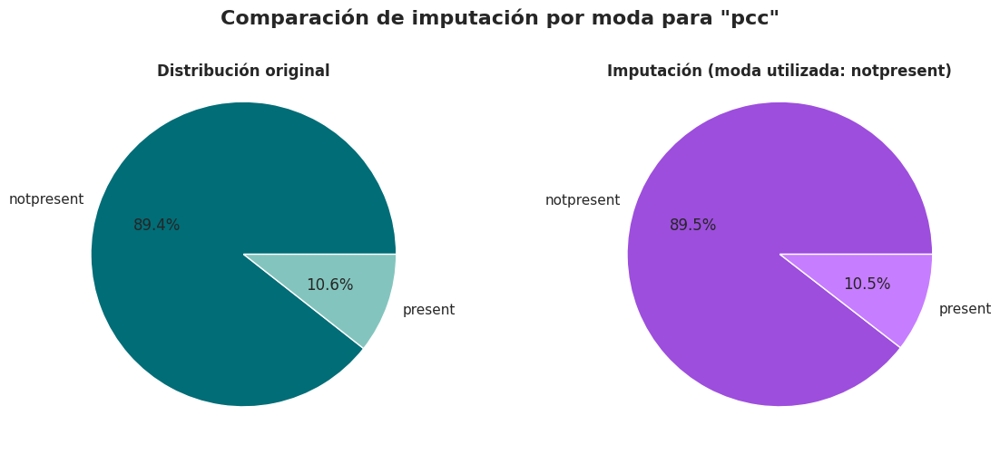

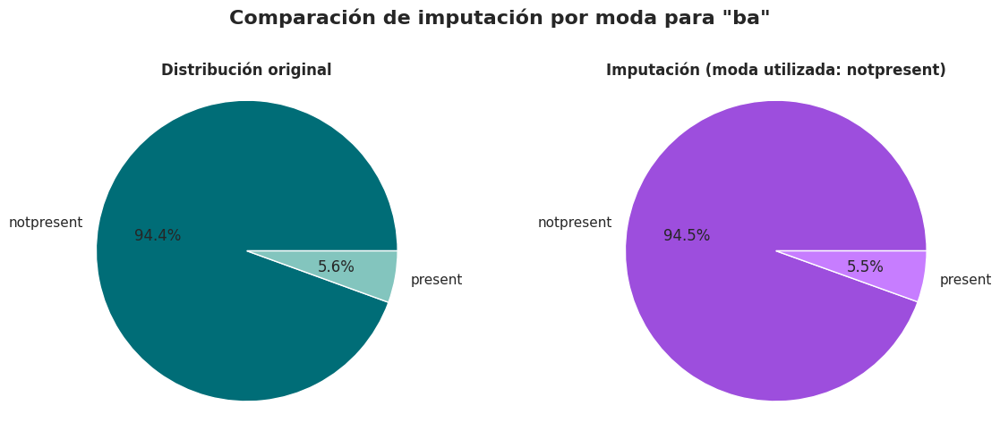

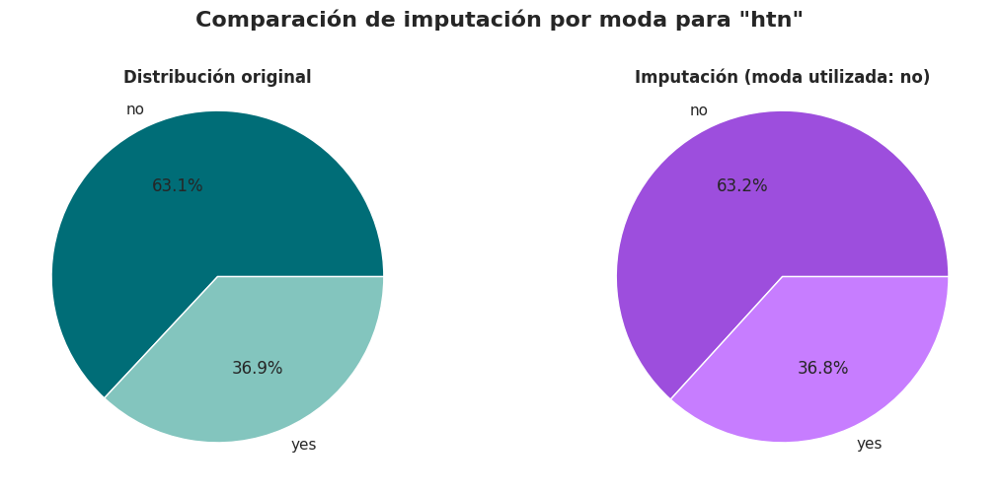

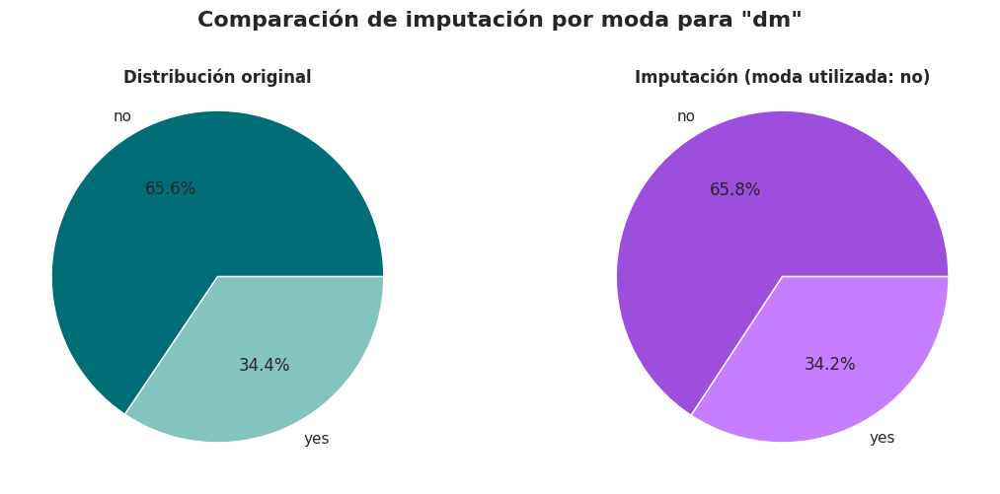

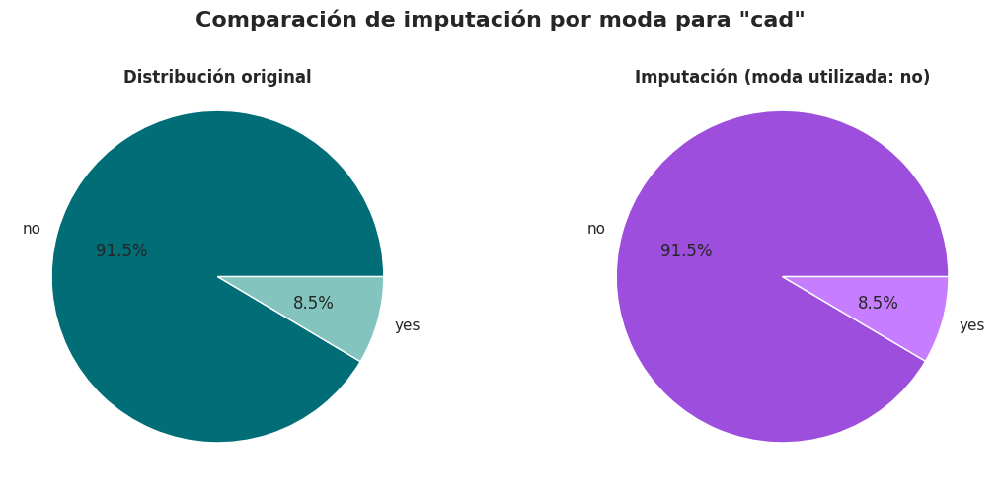

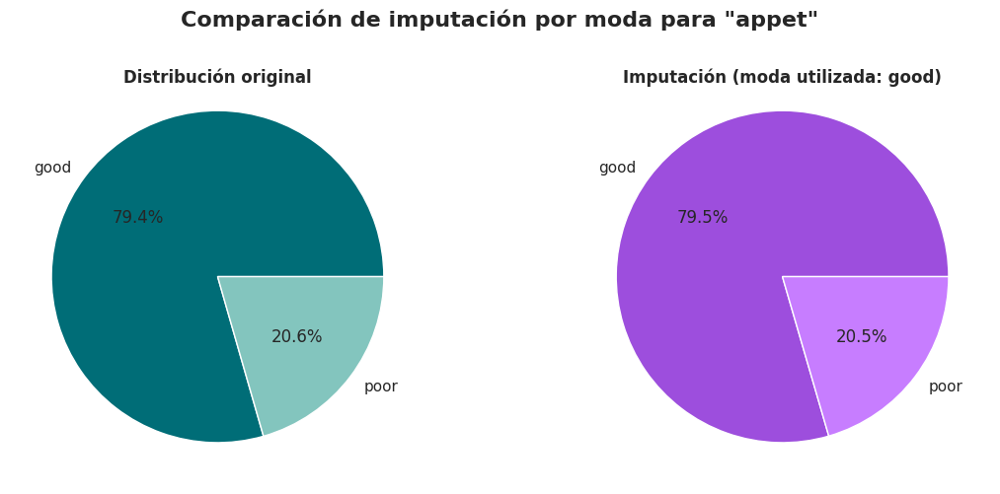

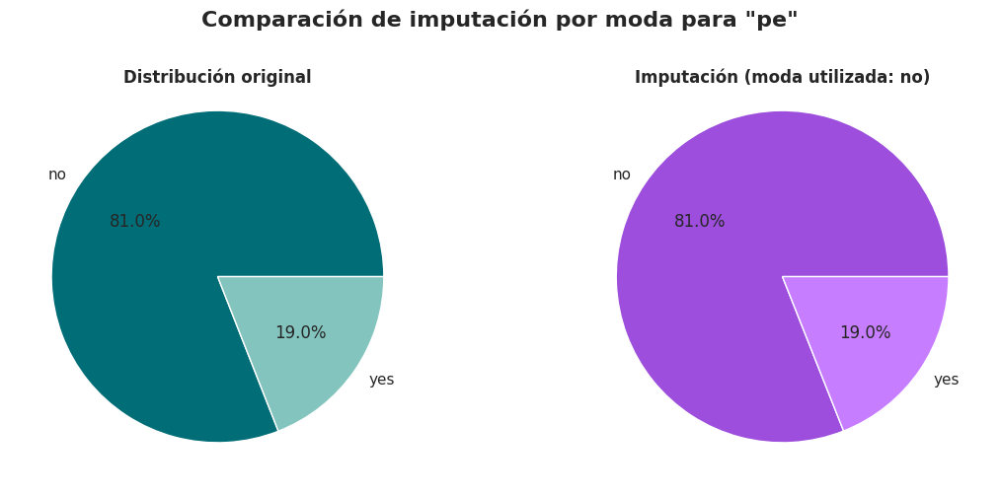

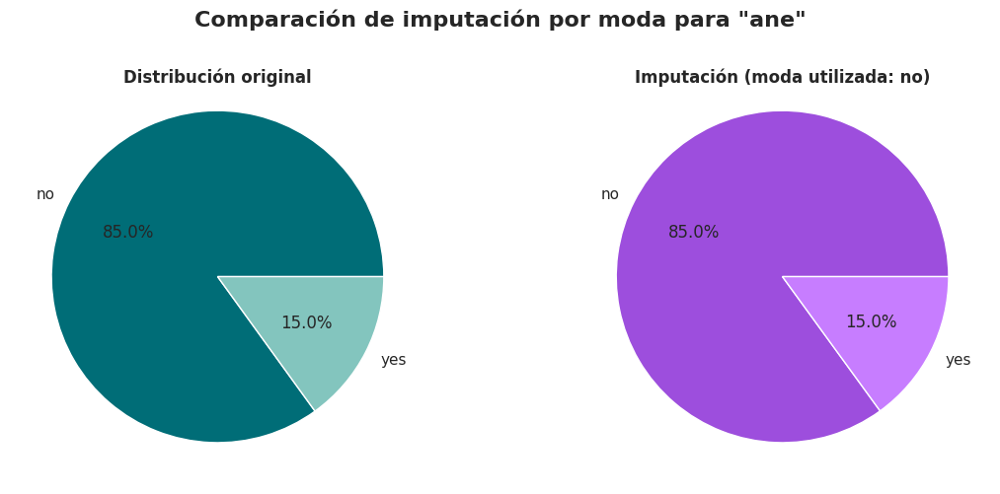

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer
from typing import List, Optional, Dict, Any
from sklearn.metrics import accuracy_score

class CategoryModeImputer:
    """
    Imputación categórica utilizando SimpleImputer con estrategia de moda.
    Incluye validación cruzada, visualización de resultados y reportes de imputación.
    """

    def __init__(
        self,
        verbose: bool = True,
        random_state: int = 42
    ):
        """
        Inicializa el imputador con los parámetros especificados.

        -----------
        Parámetros:
        -----------
        verbose : indica si se deben imprimir reportes detallados de imputación
        random_state : semilla aleatoria para reproducibilidad
        """

        self.verbose = verbose
        self.random_state = random_state
        self.imputation_report = {}
        self.cv_scores = {}

    def impute(
        self,
        df: pd.DataFrame,
        columns: Optional[List[str]] = None,
        plot: bool = True,
        cv_folds: int = 5
    ) -> pd.DataFrame:
        """
        Imputa valores faltantes en columnas categóricas usando la moda.

        Parámetros:
        -----------
        df : dataframe de entrada
        columns : columnas categóricas específicas a imputar (si es None, se usan todas las categóricas)
        plot : indica si se deben mostrar gráficos de los resultados
        cv_folds : número de folds para validación cruzada

        --------
        Devuelve:
        --------
        pd.DataFrame: Dataframe con valores imputados
        """

        # Identificar columnas categóricas
        cat_cols = df.select_dtypes(include=['object', 'category']).columns
        if columns is not None:
            cat_cols = [col for col in columns if col in cat_cols]

        # Encontrar columnas con valores faltantes
        missing_cols = [col for col in cat_cols if df[col].isna().any()]

        if not missing_cols:
            if self.verbose:
                print("No hay valores faltantes en columnas categóricas")
            return df.copy()

        # Crear una copia del dataframe original
        result_df = df.copy()

        # Almacenar distribuciones originales
        original_dists = {col: df[col].value_counts(dropna=False) for col in missing_cols}

        # Crear el imputador SimpleImputer con estrategia 'most_frequent' (moda)
        imputer = SimpleImputer(strategy='most_frequent')

        # Imputar cada columna por separado
        for col in missing_cols:
            # Guardar valores originales para análisis posterior
            original_series = df[col].copy()

            # Ejecutar validación cruzada utilizando los valores faltantes reales del dataset
            cv_score = self._cross_validate_imputation(df, col, cv_folds)
            self.cv_scores[col] = cv_score

            # Aplicar imputación - FIX: Reshape the results to 1D array
            col_values = df[[col]].values
            imputed_values = imputer.fit_transform(col_values)

            # Actualizar dataframe con valores imputados
            # FIX: Convert 2D array to 1D array before assignment
            result_df[col] = imputed_values.flatten()

            # Generar reporte para esta columna
            self.imputation_report[col] = self._generate_column_report(
                original_series,
                result_df[col],
                original_dists[col],
                cv_score
            )

        # Mostrar reporte si verbose es True
        if self.verbose:
            self._print_comprehensive_report()

        # Mostrar gráficos si plot es True
        if plot and missing_cols:
            self._plot_distributions(df, result_df, missing_cols)

        return result_df

    def _cross_validate_imputation(self, df: pd.DataFrame, col: str, n_folds: int) -> float:
        """
        Realiza validación cruzada para medir la calidad de la imputación.
        Implementa una verdadera validación cruzada de n_folds sobre los datos no faltantes
        para evaluar la precisión de la imputación.

        --------
        Devuelve:
        --------
        float: Puntuación media de precisión en la validación cruzada
        """
        # Identificar índices sin valores faltantes en esta columna
        non_missing_idx = df[~df[col].isna()].index.tolist()

        if len(non_missing_idx) < n_folds:  # Necesitamos suficientes datos para n_folds
            if self.verbose:
                print(f"Advertencia: No hay suficientes datos no faltantes para {n_folds} folds en la columna {col}")
            if len(non_missing_idx) == 0:
                return 0.0  # No hay datos para validar
            n_folds = max(2, len(non_missing_idx) // 2)  # Ajustar n_folds si hay pocos datos

        # Aplicar la semilla aleatoria para reproducibilidad
        np.random.seed(self.random_state)
        np.random.shuffle(non_missing_idx)

        # Dividir en n_folds aproximadamente iguales
        fold_size = len(non_missing_idx) // n_folds
        folds = [non_missing_idx[i*fold_size:(i+1)*fold_size] for i in range(n_folds)]
        # Asegurarse de que el último fold contiene todos los elementos restantes
        folds[-1].extend(non_missing_idx[n_folds*fold_size:])

        scores = []

        # Para cada fold
        for i in range(n_folds):
            # Usar el fold actual como conjunto de validación
            validation_idx = folds[i]

            # Los índices restantes son para entrenamiento
            train_idx = []
            for j in range(n_folds):
                if j != i:
                    train_idx.extend(folds[j])

            # Guardar valores reales para comparar después
            validation_values = df.loc[validation_idx, col].values

            # Crear un dataframe temporal con los valores de validación marcados como faltantes
            temp_df = df.copy()
            temp_df.loc[validation_idx, col] = np.nan

            # Ajustar el imputador con los datos de entrenamiento
            imputer = SimpleImputer(strategy='most_frequent')
            imputer.fit(temp_df.loc[train_idx, [col]])

            # Imputar los valores "faltantes" (realmente valores de validación)
            imputed_values = imputer.transform(temp_df.loc[validation_idx, [col]]).flatten()

            # Calcular precisión para este fold
            fold_score = accuracy_score(validation_values, imputed_values)
            scores.append(fold_score)

        # Calcular y devolver la media de las puntuaciones
        if scores:
            return np.mean(scores)
        else:
            # Si no pudimos calcular scores, estimamos la calidad basándonos en
            # qué tan dominante es la moda
            value_counts = df[col].value_counts(normalize=True)
            if not value_counts.empty:
                mode_probability = value_counts.iloc[0]  # Probabilidad de la moda
                return mode_probability  # Mayor probabilidad = mayor confianza
            else:
                return 0.0

    def _interpret_cv_score(self, score: float) -> str:
        """Interpretar la puntuación de validación cruzada."""

        if score >= 0.8:
            return "Excelente"
        elif score >= 0.6:
            return "Buena"
        elif score >= 0.4:
            return "Moderada"
        else:
            return "Baja"

    def _generate_column_report(
        self,
        original_series: pd.Series,
        imputed_series: pd.Series,
        original_dist: pd.Series,
        cv_score: float
    ) -> Dict[str, Any]:
        """
        Genera un reporte detallado para una columna.
        """

        # Calcular valores faltantes
        original_missing = original_series.isna().sum()
        missing_percentage = original_missing / len(original_series) * 100

        # Distribución original vs imputada
        orig_dist = original_series.value_counts(dropna=True, normalize=True)
        imputed_dist = imputed_series.value_counts(normalize=True)

        # Cambio en la distribución
        dist_change = {}
        for category in set(orig_dist.index) | set(imputed_dist.index):
            orig_pct = orig_dist.get(category, 0) * 100
            imputed_pct = imputed_dist.get(category, 0) * 100
            dist_change[category] = {
                'original_pct': orig_pct,
                'imputed_pct': imputed_pct,
                'change': imputed_pct - orig_pct
            }

        # Valor de la moda usada para imputación
        mode_value = original_series.mode()[0] if not original_series.dropna().empty else None

        # Interpretar la puntuación de validación cruzada
        cv_quality = self._interpret_cv_score(cv_score)

        return {
            'missing_values': original_missing,
            'missing_percentage': missing_percentage,
            'distribution_change': dist_change,
            'mode_value': mode_value,
            'cv_score': cv_score,
            'cv_quality': cv_quality
        }

    def _plot_distributions(
        self,
        original_df: pd.DataFrame,
        imputed_df: pd.DataFrame,
        columns: List[str]
    ):
        """Grafica las distribuciones original e imputada en gráficas separadas para cada variable."""

        n_cols = len(columns)
        if n_cols == 0:
            return

        # Crear una figura separada para cada columna
        print("\n")
        for col in columns:
            plt.figure(figsize=(12, 5))

            # Crear dos subplots en la misma figura
            plt.subplot(1, 2, 1)

            # Distribución original
            orig_series = original_df[col].dropna()
            if not orig_series.empty:
                orig_counts = orig_series.value_counts()
                orig_labels = orig_counts.index
                orig_percentages = orig_counts / len(orig_series) * 100

                plt.pie(
                    orig_percentages,
                    labels=orig_labels,
                    autopct='%1.1f%%',
                    colors=["#006d77", "#83c5be"]
                )
                plt.title(f'Distribución original', fontweight='bold', y=0.95)
            else:
                plt.text(0.5, 0.5, "No hay datos no faltantes",
                         ha='center', va='center', fontsize=12)
                plt.title(f'Original: {col} (Sin datos)', fontweight='bold', y=0.95)

            # Distribución imputada
            plt.subplot(1, 2, 2)
            imputed_counts = imputed_df[col].value_counts()
            imputed_labels = imputed_counts.index
            imputed_percentages = imputed_counts / len(imputed_df) * 100

            plt.pie(
                imputed_percentages,
                labels=imputed_labels,
                autopct='%1.1f%%',
                colors=["#9d4edd", "#c77dff"]
            )

            mode_value = self.imputation_report[col]['mode_value']
            plt.title(f'Imputación (moda utilizada: {mode_value})', fontweight='bold', y=0.95)

            # Título principal para esta variable
            cv_quality = self.imputation_report[col]['cv_quality']
            cv_score = self.imputation_report[col]['cv_score']
            plt.suptitle(
                f'Comparación de imputación por moda para "{col}"',
                fontsize=16, fontweight='bold', y=1
            )

            plt.tight_layout()
            plt.show()
            print("\n")

    def _print_comprehensive_report(self):
        """Imprime un reporte completo de imputación."""
        print("\n" + "="*50)
        print("📊 INFORME DE IMPUTACIÓN POR MODA")
        print("="*50)

        for col, report in self.imputation_report.items():
            print(f'\n🔹 COLUMNA "{col}":')
            print(f"  Valores faltantes: {report['missing_values']} ({report['missing_percentage']:.2f}%)")
            print(f"  Valor utilizado para imputación (moda): {report['mode_value']}")
            print(f"  Calidad de imputación: {report['cv_quality']} (CV score: {report['cv_score']:.2f})")

            print("  Cambios en la distribución:")
            for category, change in report['distribution_change'].items():
                print(f"    {category}:")
                print(f"      Original: {change['original_pct']:.2f}%, Imputada: {change['imputed_pct']:.2f}%")
                print(f"      Cambio: {change['change']:+.2f}%")

def run_mode_imputation_pipeline(df, categorical_columns=None, cv_folds=5):
    """
    Ejecuta el pipeline completo de imputación por moda para columnas categóricas

    -----------
    Parámetros:
    -----------
    df : Dataframe de entrada con valores faltantes
    categorical_columns : columnas categóricas específicas a imputar (si es None, se usan todas)
    cv_folds : número de folds para validación cruzada

    --------
    Devuelve:
    --------
    pd.DataFrame: Dataframe con valores imputados
    """

    # Crear y ejecutar imputador
    mode_imputer = CategoryModeImputer(verbose=True)
    imputed_df = mode_imputer.impute(df, columns=categorical_columns, cv_folds=cv_folds)

    return imputed_df

df_mode_cat = run_mode_imputation_pipeline(cleaned_kidney_df, cv_folds=5)

Siguiendo el mismo enfoque adoptado para las variables numéricas, al concluir la aplicación de cada método de imputación, llevaremos a cabo una verificación del proceso para evaluar la efectividad de cada estrategia en las variables categóricas.

El objetivo principal de esta verificación es garantizar que los valores faltantes (NaN) hayan sido completamente eliminados de las columnas categóricas. Esta evaluación permitirá confirmar si las técnicas implementadas han logrado su propósito de manera adecuada, asegurando la integridad y coherencia del conjunto de datos imputado.

In [ ]:
categoric_columns_mode = df_mode_cat.select_dtypes(include=['object'])
categoric_columns_mode.head(10)

,rbc,pc,pcc,ba,htn,dm,cad,appet,pe,ane,classification
id,,,,,,,,,,,
0,normal,normal,notpresent,notpresent,yes,yes,no,good,no,no,ckd
1,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
2,normal,normal,notpresent,notpresent,no,yes,no,poor,no,yes,ckd
3,normal,abnormal,present,notpresent,yes,no,no,poor,yes,yes,ckd
4,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
5,normal,normal,notpresent,notpresent,yes,yes,no,good,yes,no,ckd
6,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
7,normal,abnormal,notpresent,notpresent,no,yes,no,good,yes,no,ckd
8,normal,abnormal,present,notpresent,yes,yes,no,good,no,yes,ckd


In [ ]:
categoric_columns_mode.isna().sum()

,0
rbc,0
pc,0
pcc,0
ba,0
htn,0
dm,0
cad,0
appet,0
pe,0
ane,0


Además utilizaremos unos métodos con un enfoque más sofisticado que tengan en cuenta tanto la estructura de los datos como la posible correlación entre variables. Por eso, los dos siguientes métodos que utilizaremos para imputar valores faltantes en variables categóricas se basan en:
*   Imputación por K vecinos más cercanos (KNN): este método se apoya en la idea de que las observaciones similares probablemente tengan categorías similares.
*   Imputación Iterativa con clasificadores: inspirada en la técnica de MICE, esta estrategia utiliza un modelo predictivo para estimar los valores faltantes basándose en las demás variables.

Ambos métodos los hemos integrado en una clase personalizada denominada `CategoricalImputer`, la cual no sólo permite imputar los datos, sino también:
*   Seleccionar el mejor valor de k de manera automática (si se usa KNN).
*   Evaluar la calidad de la imputación mediante validación cruzada.
*   Generar un informe detallado del impacto de la imputación realizada en la distribución de categorías. Para cada columna imputada muestra:
    *   El número y porcentaje de valores faltantes.
    *   La calidad de imputación medida por validación cruzada.
    *   Cómo cambió la distribución de categorías antes y después de la imputación.
    *   Además, para la imputación por KNN, se muestra el valor adaptativo de k utilizado.
*   Imprimir los resultados generados por `compare_imputation_results` en un formato sencillo de comprender y explicativo:
    *   Incluye interpretaciones automáticas según los valores de Chi-cuadrado y su valor-p, información mutua (MI) y entropía.
    *   Muestra si hay evidencia estadística de diferencias entre métodos o si son similares en sus resultados de imputación.
*   Generar dos tipos de visualizaciones para comparar visualmente los métodos:
    *   Gráficos de torta (pie charts) para observar la distribución original (sin NaNs), la distribución tras imputación por KNN y la distribución tras imputación iterativa.
    *   Gráfico de barras comparativas (si los valores imputados difieren), para ver qué categorías fueron imputadas por cada método.



📚 INFORME DE IMPUTACIÓN POR EL MÉTODO KNN
Valor k adaptativo: 1

🔹 COLUMNA "rbc":
  Valores faltantes: 152 (38.00%)
  Calidad de imputación: Baja (Score CV: 0.3989)
  Cambios en la distribución:
    normal:
      Original: 81.05%, Imputada: 60.75%
      Cambio: -20.30%
    abnormal:
      Original: 18.95%, Imputada: 39.25%
      Cambio: +20.30%

🔹 COLUMNA "pc":
  Valores faltantes: 65 (16.25%)
  Calidad de imputación: Moderada (Score CV: 0.5485)
  Cambios en la distribución:
    normal:
      Original: 77.31%, Imputada: 73.25%
      Cambio: -4.06%
    abnormal:
      Original: 22.69%, Imputada: 26.75%
      Cambio: +4.06%

🔹 COLUMNA "pcc":
  Valores faltantes: 4 (1.00%)
  Calidad de imputación: Excelente (Score CV: 0.8678)
  Cambios en la distribución:
    present:
      Original: 10.61%, Imputada: 10.50%
      Cambio: -0.11%
    notpresent:
      Original: 89.39%, Imputada: 89.50%
      Cambio: +0.11%

🔹 COLUMNA "ba":
  Valores faltantes: 4 (1.00%)
  Calidad de imputación: Excelente 

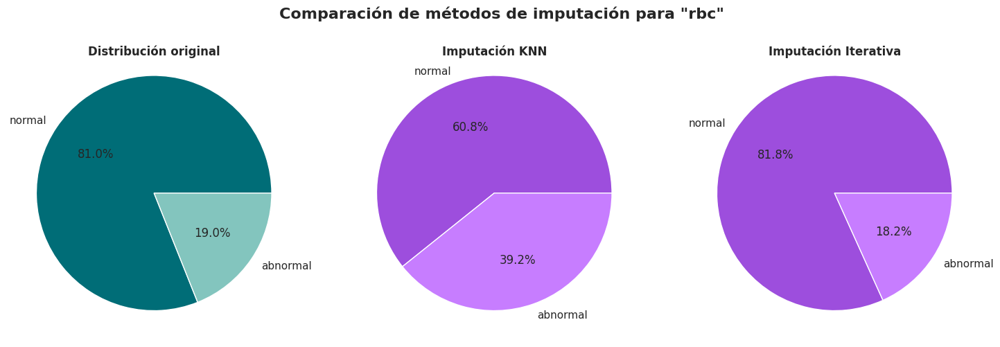

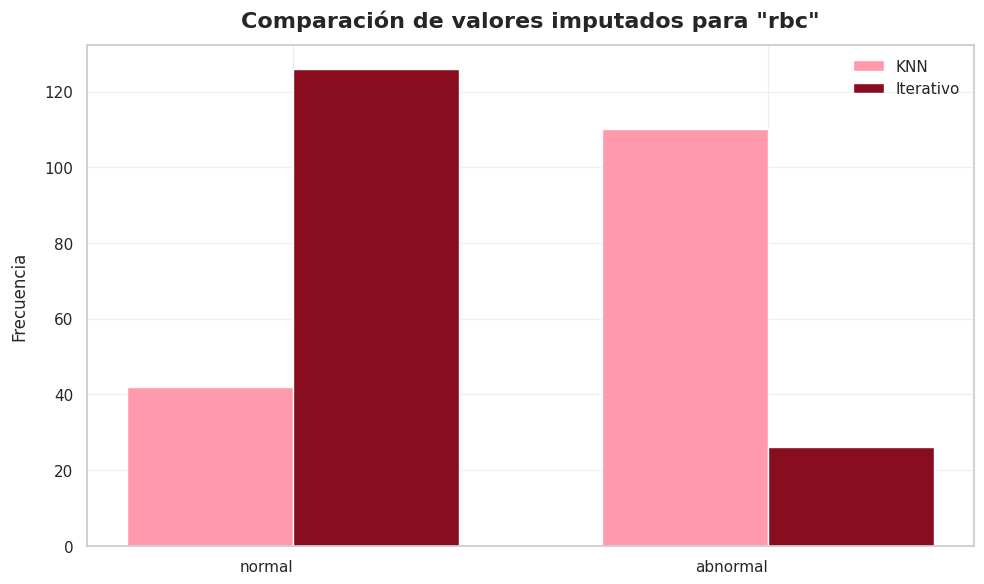

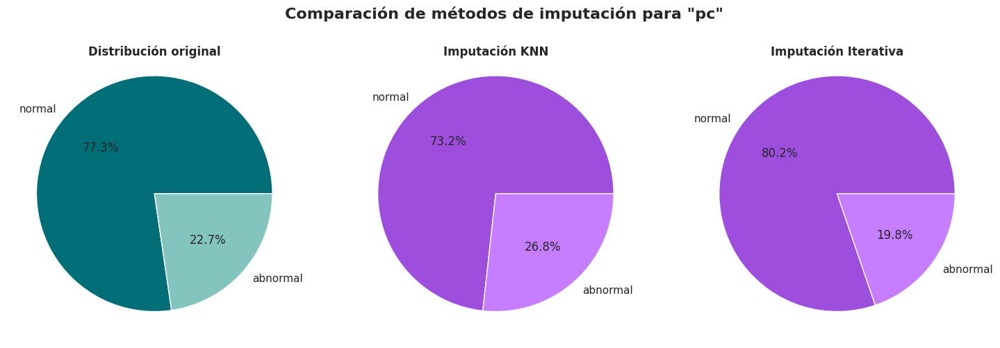

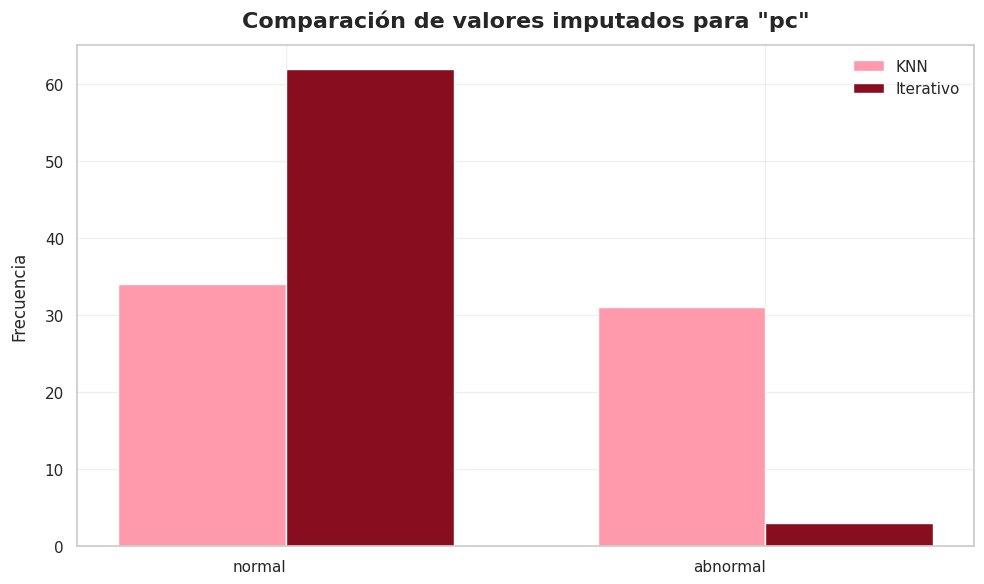

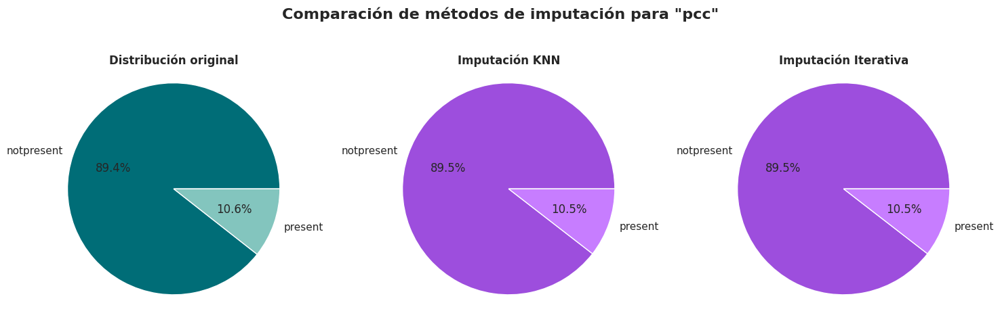

...

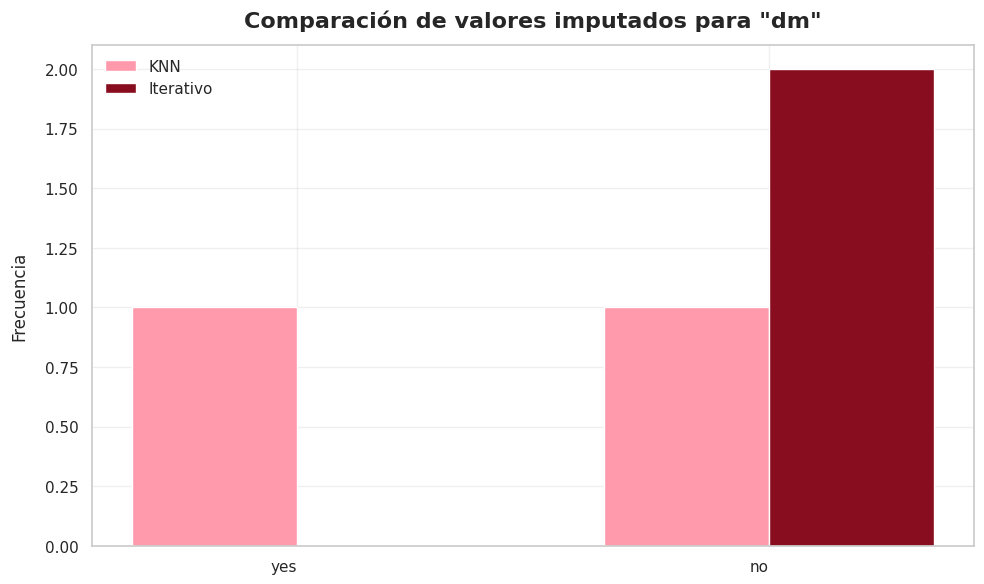

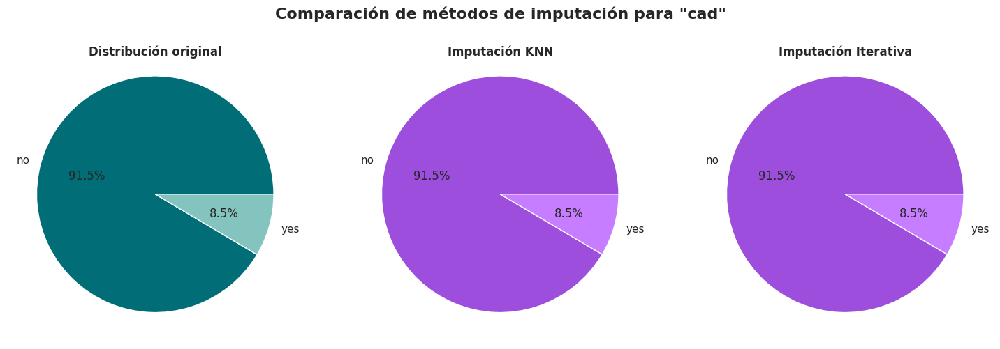

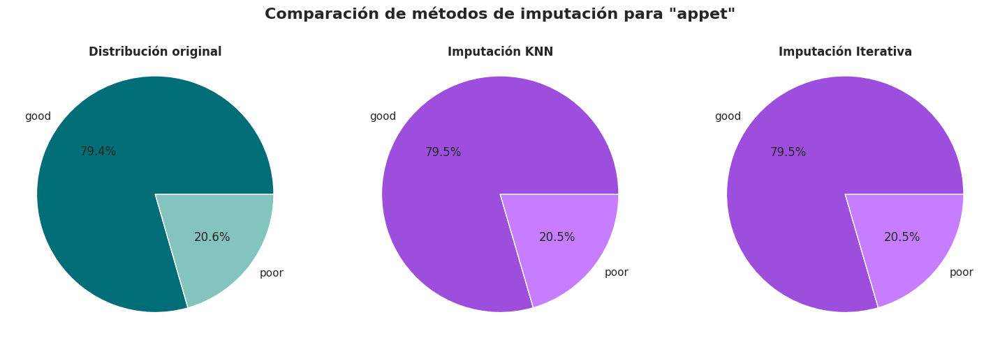

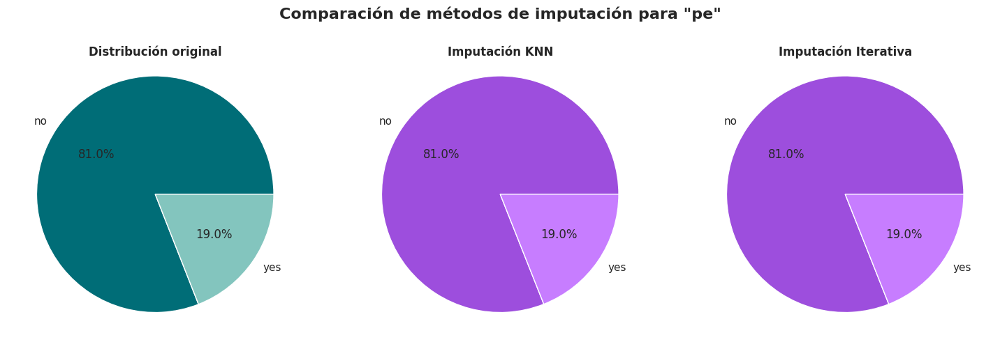

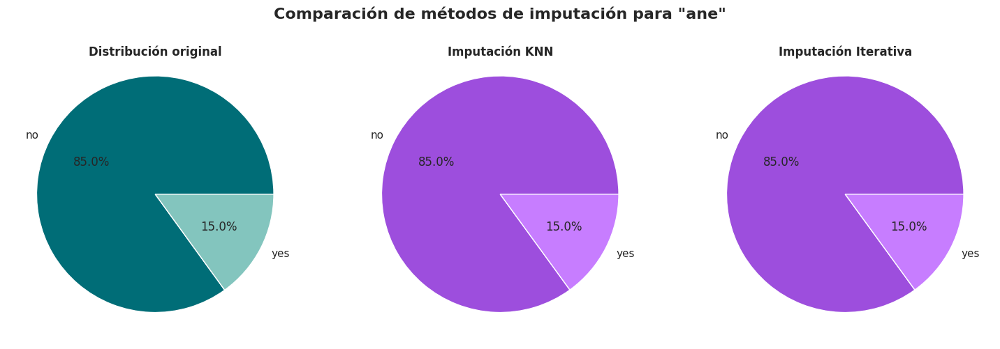

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from typing import List, Union, Optional, Dict, Any, Tuple
from sklearn.preprocessing import OrdinalEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, KNNImputer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, KFold
from sklearn.neighbors import NearestNeighbors
from scipy import stats
from sklearn.metrics import mutual_info_score, accuracy_score

class CategoricalImputer:
    """
    Imputación categórica avanzada con selección k adaptativa, validación cruzada
    y visualización integral.
    """

    def __init__(
        self,
        method: str = 'iterative',
        random_state: int = 42,
        verbose: bool = True,
        max_k: int = 10,
        n_estimators: int = 50,
        cv_folds: int = 5
    ):
        """
        Inicializar el imputador con los parámetros especificados.

        -----------
        Parámetros:
        -----------
        method : método de imputación. Opciones:
            - 'knn': imputación K-Vecinos Más Cercanos (K-Nearest Neighbors).
            - 'iterative': imputación múltiple mediante ecuaciones encadenadas.
        random_state : semilla aleatoria para reproducibilidad.
        verbose : si se imprimen informes detallados de imputación.
        max_k : número máximo de vecinos a considerar para la selección adaptativa de k.
        n_estimators : número de estimadores para RandomForestClassifier.
        cv_folds : número de pliegues para la validación cruzada.
        """

        self.method = method
        self.random_state = random_state
        self.verbose = verbose
        self.max_k = max_k
        self.n_estimators = n_estimators
        self.cv_folds = cv_folds
        self.adaptive_k = None
        self._validate_method()

        # Almacenar los resultados de imputación para su posterior análisis
        self.imputation_report = {}
        self.cv_results = {}
        self.encoder = None

    def _validate_method(self):
        """Validar el método de imputación."""

        valid_methods = ['knn', 'iterative']
        if self.method not in valid_methods:
            raise ValueError(
                f"El método debe ser uno de {valid_methods}. "
                f"Recibido: {self.method}"
            )

    def _find_optimal_k(self, X: np.ndarray, y: np.ndarray) -> int:
        """
        Encuentra de forma adaptativa el número óptimo de vecinos utilizando la validación cruzada.

        -----------
        Parámetros:
        -----------
        X : datos de entrada para la selección k.
        y : variable objetivo para la selección supervisada.

        --------
        Devuelve:
        --------
        int: número óptimo de vecinos.
        """

        if X.shape[0] <= self.max_k:
            return max(3, X.shape[0] // 2)

        best_k = 1
        best_score = float('-inf')
        kf = KFold(n_splits=min(self.cv_folds, X.shape[0]), shuffle=True, random_state=self.random_state)

        # Si tenemos una variable objetivo, utilizamos la selección k supervisada
        if y is not None and len(np.unique(y)) > 1:
            for k in range(1, min(self.max_k + 1, X.shape[0])):
                scores = []
                for train_idx, test_idx in kf.split(X):
                    X_train, X_test = X[train_idx], X[test_idx]
                    y_train, y_test = y[train_idx], y[test_idx]

                    # Omitir si no hay suficientes muestras en una clase
                    if len(np.unique(y_train)) < 2:
                        continue

                    try:
                        # Utiliza RandomForestClassifier con k como max_features
                        clf = RandomForestClassifier(
                            n_estimators=self.n_estimators,
                            max_features=min(k, X.shape[1]),
                            random_state=self.random_state
                        )
                        clf.fit(X_train, y_train)
                        score = clf.score(X_test, y_test)
                        scores.append(score)
                    except Exception as e:
                        if self.verbose:
                            print(f"Error en CV para k={k}: {str(e)}")
                        continue

                if scores:
                    avg_score = np.mean(scores)
                    if avg_score > best_score:
                        best_score = avg_score
                        best_k = k
        else:
            # Selección k no supervisada basada en distancias vecinas
            for k in range(1, min(self.max_k + 1, X.shape[0])):
                try:
                    # Crear un modelo de NearestNeighbors
                    nn = NearestNeighbors(n_neighbors=k)
                    nn.fit(X)

                    # Calcula la distancia promedio a los vecinos k más cercanos
                    distances, _ = nn.kneighbors(X)
                    avg_distance = np.mean(distances[:, -1])

                    # Utiliza la distancia promedio negativa como indicador de la calidad de imputación
                    score = -avg_distance

                    if score > best_score:
                        best_score = score
                        best_k = k
                except Exception as e:
                    if self.verbose:
                        print(f"Error en selección de k={k}: {str(e)}")
                    continue

        return best_k

    def _perform_cross_validation(self, df: pd.DataFrame, target_cols: List[str]) -> Dict[str, Any]:
        """
        Realizar validación cruzada para la evaluación de la calidad de la imputación.

        -----------
        Parámetros:
        -----------
        df : Dataframe de entrada.
        target_cols : columnas que se utilizarán como objetivos en la validación cruzada.

        --------
        Devuelve:
        --------
        Dict[str, Any]: resultados de la validación cruzada.
        """

        results = {}

        # Obtener columnas con valores faltantes
        cat_cols = df.select_dtypes(include=['object', 'category']).columns
        missing_cols = [col for col in cat_cols if df[col].isna().any()]

        if not missing_cols:
            return results

        # Para cada columna con valores faltantes, realiza una CV utilizando otras
        # columnas como características
        for col in missing_cols:
            # Omitir si no hay suficientes valores no faltantes
            if df[col].notna().sum() < self.cv_folds:
                results[col] = {"cv_score": np.nan, "imputation_quality": "Datos insuficientes"}
                continue

            # Seleccionar filas donde no falte esta columna
            train_mask = df[col].notna()
            train_df = df[train_mask].copy()

            # Seleccionar características (otras columnas categóricas + columnas objetivo)
            features = [c for c in cat_cols if c != col and c in df.columns]
            features.extend([c for c in target_cols if c != col and c in df.columns])

            # Omitir si no hay caracteristicas disponibles
            if not features:
                results[col] = {"cv_score": np.nan, "imputation_quality": "No hay caracteristicas disponibles"}
                continue

            try:
                # Codificar características y objetivos
                X_encoder = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)
                y_encoder = OrdinalEncoder()

                X = X_encoder.fit_transform(train_df[features])
                y = y_encoder.fit_transform(train_df[[col]])

                # Realizar validación cruzada
                if self.method == 'knn':
                    if self.adaptive_k is None:
                        self.adaptive_k = self._find_optimal_k(X, y.ravel())
                    imputer = KNNImputer(n_neighbors=self.adaptive_k)
                else:
                    estimator = RandomForestClassifier(
                        n_estimators=self.n_estimators,
                        random_state=self.random_state
                    )
                    imputer = IterativeImputer(
                        estimator=estimator,
                        max_iter=20,
                        random_state=self.random_state
                    )

                # Definir la estrategia de validación cruzada
                kf = KFold(n_splits=min(self.cv_folds, sum(train_mask)),
                          shuffle=True, random_state=self.random_state)

                # Realizar manualmente CV para evaluar la calidad de la imputación
                cv_scores = []
                for train_idx, test_idx in kf.split(X):
                    X_train, X_test = X[train_idx], X[test_idx]
                    y_train, y_test = y[train_idx], y[test_idx]

                    # Crear una máscara de valores originales en el conjunto de pruebas
                    mask = np.random.rand(len(y_test)) < 0.3

                    if sum(mask) > 0:  # Sólo si tenemos valores que imputar
                        # Crear una copia con valores enmascarados
                        X_test_masked = X_test.copy()

                        # Ajuste del imputador a los datos de entrenamiento
                        if self.method == 'knn':
                            combined = np.hstack((X_train, y_train))
                            imputer.fit(combined)

                            # Preparar datos de prueba para la imputación
                            X_test_with_target = np.hstack((X_test, y_test))
                            X_test_masked_with_target = X_test_with_target.copy()
                            X_test_masked_with_target[mask, -1] = np.nan

                            # Imputar valores faltantes
                            imputed = imputer.transform(X_test_masked_with_target)
                            imputed_y = imputed[mask, -1]

                            # Comparar con los valores originales
                            original_y = y_test[mask].ravel()
                        else:
                            # Para imputador iterativo, entrene un clasificador
                            clf = RandomForestClassifier(
                                n_estimators=self.n_estimators,
                                random_state=self.random_state
                            )
                            clf.fit(X_train, y_train.ravel())

                            # Predecir valores faltantes
                            imputed_y = clf.predict(X_test[mask])
                            original_y = y_test[mask].ravel()

                        # Calcular la precisión
                        original_y_rounded = np.round(original_y).astype(int)
                        imputed_y_rounded = np.round(imputed_y).astype(int)
                        score = accuracy_score(original_y_rounded, imputed_y_rounded)
                        cv_scores.append(score)

                # Calcular la puntuación media del CV
                if cv_scores:
                    avg_score = np.mean(cv_scores)
                    results[col] = {
                        "cv_score": avg_score,
                        "imputation_quality": self._interpret_cv_score(avg_score)
                    }
                else:
                    results[col] = {"cv_score": np.nan, "imputation_quality": "CV failed"}

            except Exception as e:
                results[col] = {"cv_score": np.nan, "imputation_quality": f"Error: {str(e)}"}

        return results

    def _interpret_cv_score(self, score: float) -> str:
        """Interpretar la puntuación de validación cruzada."""

        if score >= 0.8:
            return "Excelente"
        elif score >= 0.6:
            return "Buena"
        elif score >= 0.4:
            return "Moderada"
        else:
            return "Baja"

    def impute(
        self,
        df: pd.DataFrame,
        columns: Optional[List[str]] = None,
        target_cols: Optional[List[str]] = None,
        plot: bool = True
    ) -> pd.DataFrame:
        """
        Imputar valores faltantes en columnas categóricas.

        -----------
        Parámetros:
        -----------
        df : Dataframe de entrada.
        columns : columnas categóricas específicas para imputar (si None, se utilizan todas las columnas categóricas)
        target_cols : columnas adicionales para usar como objetivos en la validación cruzada.
        plot : si se deben graficar los resultados de imputación.

        --------
        Devuelve:
        --------
        pd.DataFrame: Dataframe con valores imputados.
        """

        # Identificar columnas categóricas
        cat_cols = df.select_dtypes(include=['object', 'category']).columns
        if columns is not None:
            cat_cols = [col for col in columns if col in cat_cols]

        # Buscar columnas con valores faltantes
        missing_cols = [col for col in cat_cols if df[col].isna().any()]

        if not missing_cols:
            if self.verbose:
                print("No faltan valores en las columnas categóricas")
            return df

        df_cat = df[cat_cols].copy()

        # Almacenar distribuciones originales
        original_dists = {col: df_cat[col].value_counts(dropna=False) for col in missing_cols}

        # Establecer columnas de destino predeterminadas si no se proporcionan
        if target_cols is None:
            target_cols = list(df.select_dtypes(include=['number']).columns)

        # Realizar validación cruzada para la evaluación de la calidad
        self.cv_results = self._perform_cross_validation(df, target_cols)

        # Preparar diccionario de resultados de imputación
        self.imputation_report = {}

        # Crea un codificador una vez y lo reutiliza
        self.encoder = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)

        # Manejo separado para cada columna con valores faltantes
        imputed_cols = {}
        for col in missing_cols:
            # Omitir si no faltan valores
            if not df[col].isna().any():
                imputed_cols[col] = df[col]
                continue

            # Seleccionar características (otras columnas)
            features = [c for c in cat_cols if c != col]
            # Agrega columnas de objetivos numéricos si están disponibles
            features.extend([c for c in target_cols if c != col and c in df.columns])

            # Omitir si no hay funciones disponibles
            if not features:
                imputed_cols[col] = df[col]
                continue

            try:
                # Separar los datos completos de los incompletos
                complete_mask = df[col].notna()
                incomplete_mask = df[col].isna()

                # Si no hay suficientes datos completos, utilice la imputación modal
                if sum(complete_mask) < 5:
                    mode_value = df[col].mode()[0] if not df[col].dropna().empty else None
                    imputed_col = df[col].copy()
                    imputed_col.fillna(mode_value, inplace=True)
                    imputed_cols[col] = imputed_col
                    continue

                # Funciones de codificación
                X_all = self.encoder.fit_transform(df[features])

                if self.method == 'knn':
                    # Para KNN, primero necesitamos encontrar el k óptimo
                    if self.adaptive_k is None:
                        y_complete = self.encoder.fit_transform(df.loc[complete_mask, [col]])
                        X_complete = X_all[complete_mask]
                        self.adaptive_k = self._find_optimal_k(X_complete, y_complete.ravel())

                    # Utiliza la imputación KNN
                    imputer = KNNImputer(n_neighbors=self.adaptive_k)

                    # Codifica la columna de destino cuando esté disponible
                    y_encoder = OrdinalEncoder()
                    y_values = df[col].copy().astype('object')  # Convertir a objeto para una codificación consistente
                    encoded_y = np.full(len(df), np.nan)
                    encoded_y[complete_mask] = y_encoder.fit_transform(df.loc[complete_mask, [col]]).ravel()

                    # Combinar características y objetivos para la imputación KNN
                    combined = np.column_stack((X_all, encoded_y))

                    # Imputar los datos combinados
                    imputed_combined = imputer.fit_transform(combined)

                    # Extraer valores objetivo imputados
                    imputed_y = imputed_combined[:, -1]

                    # Volver a las categorías originales
                    imputed_categories = y_encoder.inverse_transform(imputed_y.reshape(-1, 1)).ravel()

                    # Crear la columna imputada
                    imputed_col = pd.Series(imputed_categories, index=df.index)

                else:  # método iterativo
                    # Para la imputación iterativa, entrena un clasificador
                    clf = RandomForestClassifier(
                        n_estimators=self.n_estimators,
                        random_state=self.random_state
                    )

                    # Codifica la columna de destino para el entrenamiento
                    y_encoder = OrdinalEncoder()
                    y_train = y_encoder.fit_transform(df.loc[complete_mask, [col]]).ravel()

                    # Entrena con datos completos
                    clf.fit(X_all[complete_mask], y_train)

                    # Predecir valores faltantes
                    predicted_encoded = clf.predict(X_all[incomplete_mask])

                    # Convertir las predicciones de nuevo a las categorías originales
                    predicted_categories = y_encoder.inverse_transform(
                        predicted_encoded.reshape(-1, 1)).ravel()

                    # Crear la columna imputada
                    imputed_col = df[col].copy()
                    imputed_col.iloc[incomplete_mask] = predicted_categories

                imputed_cols[col] = imputed_col

                # Generar informe de columnas
                self.imputation_report[col] = self._generate_column_report(
                    df[col],
                    imputed_col,
                    original_dists[col]
                )

            except Exception as e:
                if self.verbose:
                    print(f"Error al imputar la columna {col}: {str(e)}")

        # Crear una copia del marco de datos y actualizar las columnas imputadas
        result_df = df.copy()
        for col, imputed_col in imputed_cols.items():
            result_df[col] = imputed_col

        # Primero imprime el informe completo antes de trazar
        if self.verbose:
            self._print_comprehensive_report()

        # Luego grafica si se te solicita
        if plot and missing_cols:
            self._plot_distributions(df, result_df, missing_cols)

        # Devolver sólo las columnas imputadas
        return result_df[missing_cols]

    def _generate_column_report(
        self,
        original_series: pd.Series,
        imputed_series: pd.Series,
        original_dist: pd.Series
    ) -> Dict[str, Any]:
        """
        Generar informe detallado para una sola columna.
        """

        # Calcular valores faltantes
        original_missing = original_series.isna().sum()
        missing_percentage = original_missing / len(original_series) * 100

        # Distribución original vs. distribución imputada
        orig_dist = original_series.value_counts(dropna=True, normalize=True)
        imputed_dist = imputed_series.value_counts(normalize=True)

        # Cambio de distribución
        dist_change = {}
        for category in set(orig_dist.index) | set(imputed_dist.index):
            orig_pct = orig_dist.get(category, 0) * 100
            imputed_pct = imputed_dist.get(category, 0) * 100
            dist_change[category] = {
                'original_pct': orig_pct,
                'imputed_pct': imputed_pct,
                'change': imputed_pct - orig_pct
            }

        # Obtener calidad de validación cruzada si está disponible
        cv_quality = "No evaluada"
        cv_score = np.nan
        if self.cv_results and original_series.name in self.cv_results:
            cv_result = self.cv_results[original_series.name]
            cv_quality = cv_result.get("imputation_quality", "No evaluada")
            cv_score = cv_result.get("cv_score", np.nan)

        return {
            'missing_values': original_missing,
            'missing_percentage': missing_percentage,
            'distribution_change': dist_change,
            'cv_quality': cv_quality,
            'cv_score': cv_score
        }

    def _plot_distributions(
        self,
        original_df: pd.DataFrame,
        imputed_df: pd.DataFrame,
        columns: List[str]
    ):
        """Grafica las distribuciones original e imputada."""

        n_cols = len(columns)
        if n_cols == 0:
            return

        fig, axes = plt.subplots(n_cols, 2, figsize=(12, 4*n_cols))

        # Asegurar de que los ejes sean siempre una matriz 2D
        if n_cols == 1:
            axes = np.array([axes]).reshape(1, 2)

        fig.suptitle(
            f'Comparación de imputación categórica por el método ({self.method})',
            fontsize=16, fontweight='bold', y=1.02)

        for idx, col in enumerate(columns):
            # Distribución original
            orig_series = original_df[col].dropna()  # Solo valores no faltantes
            if not orig_series.empty:
                orig_counts = orig_series.value_counts()
                orig_labels = orig_counts.index
                orig_percentages = orig_counts / len(orig_series) * 100

                axes[idx, 0].pie(
                    orig_percentages,
                    labels=orig_labels,
                    autopct='%1.1f%%',
                    colors=plt.cm.Pastel1.colors
                )
                axes[idx, 0].set_title(f'Original: {col}')
            else:
                axes[idx, 0].text(0.5, 0.5, "No hay datos no faltantes",
                                ha='center', va='center', fontsize=12)
                axes[idx, 0].set_title(f'Original: {col} (Sin datos)')

            # Distribución imputada
            imputed_counts = imputed_df[col].value_counts()
            imputed_labels = imputed_counts.index
            imputed_percentages = imputed_counts / len(imputed_df) * 100

            axes[idx, 1].pie(
                imputed_percentages,
                labels=imputed_labels,
                autopct='%1.1f%%',
                colors=plt.cm.Pastel2.colors
            )
            cv_quality = "No evaluada"
            if col in self.cv_results:
                cv_quality = self.cv_results[col].get("imputation_quality", "No evaluada")
            axes[idx, 1].set_title(f'Imputado: {col} (Calidad: {cv_quality})')

        plt.tight_layout()
        plt.subplots_adjust(top=0.95, hspace=0.4)
        plt.show()

    def _print_comprehensive_report(self):
        """Imprime un informe de imputación completo."""

        print("\n" + "="*50)
        print(f"📚 INFORME DE IMPUTACIÓN POR EL MÉTODO {self.method.upper()}")
        print("="*50)

        if self.method == 'knn':
            print(f"Valor k adaptativo: {self.adaptive_k}")

        for col, report in self.imputation_report.items():
            print(f'\n🔹 COLUMNA "{col}":')
            print(f"  Valores faltantes: {report['missing_values']} ({report['missing_percentage']:.2f}%)")
            print(f"  Calidad de imputación: {report['cv_quality']} (Score CV: {report['cv_score']:.4f})")

            print("  Cambios en la distribución:")
            for category, change in report['distribution_change'].items():
                print(f"    {category}:")
                print(f"      Original: {change['original_pct']:.2f}%, Imputada: {change['imputed_pct']:.2f}%")
                print(f"      Cambio: {change['change']:+.2f}%")

    @staticmethod
    def compare_imputation_results(
        original_df: pd.DataFrame,
        knn_imputed_df: pd.DataFrame,
        iterative_imputed_df: pd.DataFrame
    ) -> Dict[str, Any]:
        """
        Compara resultados de KNN y métodos de imputación iterativos.
        """

        categorical_columns = original_df.select_dtypes(include=['object', 'category']).columns
        comparison_results = {}

        for col in categorical_columns:
            # Omitir si la columna no tiene valores faltantes
            if not original_df[col].isna().any():
                continue

            missing_mask = original_df[col].isna()
            knn_imputed_values = knn_imputed_df.loc[missing_mask, col]
            iter_imputed_values = iterative_imputed_df.loc[missing_mask, col]

            # Calcular métricas de acuerdo
            total_imputed = len(knn_imputed_values)
            if total_imputed > 0:
                agreement_count = sum(knn_imputed_values == iter_imputed_values)
                agreement_percentage = agreement_count / total_imputed * 100
            else:
                agreement_count = 0
                agreement_percentage = np.nan

            # Cálculo de entropía en conjuntos de datos completos
            def calculate_entropy(series):
                if len(series) == 0:
                    return np.nan
                freq = series.value_counts(normalize=True)
                if len(freq) == 0:
                    return np.nan
                return -np.sum(freq * np.log2(freq + 1e-10))

            # Calcular la entropía en distribuciones completas
            knn_entropy = calculate_entropy(knn_imputed_df[col])
            iter_entropy = calculate_entropy(iterative_imputed_df[col])

            try:
                # Crear tabla de contingencia de distribuciones completas
                categories = list(set(knn_imputed_df[col].unique()) | set(iterative_imputed_df[col].unique()))
                knn_dist = knn_imputed_df[col].value_counts().reindex(categories, fill_value=0)
                iter_dist = iterative_imputed_df[col].value_counts().reindex(categories, fill_value=0)

                # Prueba de chi-cuadrado en distribuciones completas
                contingency = np.array([knn_dist.values, iter_dist.values])
                chi2_stat, chi2_p = stats.chi2_contingency(contingency)[:2]
            except (ValueError, np.linalg.LinAlgError):
                chi2_stat, chi2_p = np.nan, np.nan

            try:
                # Convertir a códigos categóricos
                knn_encoded = pd.Categorical(knn_imputed_df[col]).codes
                iter_encoded = pd.Categorical(iterative_imputed_df[col]).codes

                # Calcular información mutua sobre distribuciones completas
                mi_score = mutual_info_score(knn_encoded, iter_encoded)

                # Normalizar la información mutua
                max_entropy = max(calculate_entropy(knn_imputed_df[col]),
                                  calculate_entropy(iterative_imputed_df[col]))

                if max_entropy > 0:
                    mi_score_normalized = mi_score / max_entropy
                else:
                    mi_score_normalized = mi_score
            except Exception:
                mi_score = np.nan
                mi_score_normalized = np.nan

            comparison_results[col] = {
                'chi2_statistic': chi2_stat,
                'chi2_p_value': chi2_p,
                'mutual_information': mi_score,
                'mutual_information_normalized': mi_score_normalized,
                'agreement_percentage': agreement_percentage,
                'knn_entropy': knn_entropy,
                'iterative_entropy': iter_entropy,
                'imputed_count': total_imputed
            }

        return comparison_results

    @staticmethod
    def print_imputation_comparison(comparison_results: Dict[str, Any]):
        """
        Imprime un informe comparativo completo.
        """

        print("\n" + "="*50)
        print("📋 COMPARACIÓN DE MÉTODOS DE IMPUTACIÓN")
        print("="*50)

        if not comparison_results:
            print("No hay columnas con valores faltantes para comparar.")
            return

        # Resultados detallados
        for col, results in comparison_results.items():
            print(f'\n🔹 COLUMNA "{col}":')
            print(f"  Total de valores imputados: {results['imputed_count']}")

            if not np.isnan(results['agreement_percentage']):
                print(f"  Porcentaje de concordancia: {results['agreement_percentage']:.2f}%")
            else:
                print("  Porcentaje de concordancia: no disponible")

            if not np.isnan(results['chi2_statistic']):
                print(f"  Estadístico Chi-cuadrado: {results['chi2_statistic']:.4f}")
                print(f"  Valor-p Chi-cuadrado: {results['chi2_p_value']:.4f}")

                if results['chi2_p_value'] < 0.05:
                    print("      🔍 Interpretación: las distribuciones son significativamente diferentes")
                else:
                    print("      🔍 Interpretación: no hay evidencia de diferencias significativas entre métodos")
            else:
                print("  Estadístico Chi-cuadrado: no disponible")

            if not np.isnan(results['mutual_information']):
                print(f"  Información mutua: {results['mutual_information']:.4f}")
                if 'mutual_information_normalized' in results and not np.isnan(results['mutual_information_normalized']):
                    print(f"  Información mutua normalizada: {results['mutual_information_normalized']:.4f}")

                    if results['mutual_information_normalized'] > 0.7:
                        print("      🔍 Interpretación: alta similitud entre métodos")
                    elif results['mutual_information_normalized'] > 0.3:
                        print("      🔍 Interpretación: similitud moderada entre métodos")
                    else:
                        print("      🔍 Interpretación: baja similitud entre métodos")
            else:
                print("  Información Mutua: No disponible")

            if not np.isnan(results['knn_entropy']) and not np.isnan(results['iterative_entropy']):
                print(f"  Entropía KNN (dataset completo): {results['knn_entropy']:.4f}")
                print(f"  Entropía Iterativa (dataset completo): {results['iterative_entropy']:.4f}")

                entropy_diff = abs(results['knn_entropy'] - results['iterative_entropy'])
                if entropy_diff < 0.1:
                    print("      🔍 Interpretación: distribuciones muy similares")
                elif entropy_diff < 0.5:
                    print("      🔍 Interpretación: distribuciones moderadamente similares")
                else:
                    print("      🔍 Interpretación: distribuciones con diferencias notables")
            else:
                print("  Análisis de entropía: no disponible")

    def visualize_comparison(
        self,
        original_df: pd.DataFrame,
        knn_imputed_df: pd.DataFrame,
        iterative_imputed_df: pd.DataFrame
    ):
        """
        Visualiza la comparación entre los métodos de imputación KNN e iterativa.

        -----------
        Parámetros:
        -----------
        original_df : Dataframe original con valores faltantes.
        knn_imputed_df : Dataframe con imputación KNN.
        iterative_imputed_df : Dataframe con imputación iterativa.
        """

        print("\n" + "="*68)
        print("📊 GRÁFICOS COMPARATIVOS DE LOS DIFERENTES MÉTODOS DE IMPUTACIÓN")
        print("="*68)

        categorical_columns = original_df.select_dtypes(include=['object', 'category']).columns
        missing_cols = [col for col in categorical_columns if original_df[col].isna().any()]

        if not missing_cols:
            print("No hay columnas categóricas con valores faltantes para visualizar.")
            return

        # Comparación de gráficos para cada columna con valores faltantes
        print("\n")
        for col in missing_cols:
            fig, axes = plt.subplots(1, 3, figsize=(15, 5))
            fig.suptitle(f'Comparación de métodos de imputación para "{col}"', fontsize=16, fontweight='bold', y=1)

            # Distribución original (sin valores faltantes)
            orig_series = original_df[col].dropna()
            if not orig_series.empty:
                orig_counts = orig_series.value_counts()
                axes[0].pie(
                    orig_counts.values,
                    labels=orig_counts.index,
                    autopct='%1.1f%%',
                    colors=["#006d77", "#83c5be"]
                )
                axes[0].set_title('Distribución original', fontweight='bold', y=0.95)
            else:
                axes[0].text(0.5, 0.5, "No hay datos no faltantes",
                           ha='center', va='center', fontsize=12)
                axes[0].set_title('Distribución original (sin datos)', fontweight='bold', y=0.95)

            # Distribución imputada de KNN
            knn_counts = knn_imputed_df[col].value_counts()
            axes[1].pie(
                knn_counts.values,
                labels=knn_counts.index,
                autopct='%1.1f%%',
                colors=["#9d4edd", "#c77dff"]
            )
            axes[1].set_title('Imputación KNN', fontweight='bold', y=0.95)

            # Distribución imputada iterativa
            iter_counts = iterative_imputed_df[col].value_counts()
            axes[2].pie(
                iter_counts.values,
                labels=iter_counts.index,
                autopct='%1.1f%%',
                colors=["#9d4edd", "#c77dff"]
            )
            axes[2].set_title('Imputación Iterativa', fontweight='bold', y=0.95)

            plt.tight_layout()
            plt.show()

            # Gráfico de barras para comparar únicamente valores imputados
            missing_mask = original_df[col].isna()
            print("\n")

            if sum(missing_mask) > 0:
                knn_imputed_values = knn_imputed_df.loc[missing_mask, col]
                iter_imputed_values = iterative_imputed_df.loc[missing_mask, col]

                # Comprobar si los valores son diferentes
                if not (knn_imputed_values == iter_imputed_values).all():
                    # Obtener categorías combinadas
                    all_categories = list(set(knn_imputed_values.unique()) | set(iter_imputed_values.unique()))

                    # Contar ocurrencias
                    knn_counts = knn_imputed_values.value_counts().reindex(all_categories, fill_value=0)
                    iter_counts = iter_imputed_values.value_counts().reindex(all_categories, fill_value=0)

                    # Trazar un gráfico de barras en paralelo
                    fig, ax = plt.subplots(figsize=(10, 6))
                    x = np.arange(len(all_categories))
                    width = 0.35

                    ax.bar(x - width/2, knn_counts, width, label='KNN', color='#ff99ac')
                    ax.bar(x + width/2, iter_counts, width, label='Iterativo', color='#880d1e')

                    ax.set_xticks(x)
                    ax.set_xticklabels([str(c) for c in all_categories], ha='right')
                    ax.legend()

                    ax.set_title(f'Comparación de valores imputados para "{col}"', fontsize=16, fontweight='bold', y=1.02)
                    ax.set_ylabel('Frecuencia', labelpad=12)

                    plt.tight_layout()
                    plt.show()
                    print("\n")

                # Análisis de acuerdos
                agreement_count = sum(knn_imputed_values == iter_imputed_values)
                total_imputed = len(knn_imputed_values)
                agreement_pct = agreement_count / total_imputed * 100

    def run_full_pipeline(
        self,
        df: pd.DataFrame,
        categorical_columns: Optional[List[str]] = None,
        target_columns: Optional[List[str]] = None,
        compare_methods: bool = True
    ) -> Tuple[pd.DataFrame, pd.DataFrame]:
        """
        Ejecuta el proceso de imputación completo con ambos métodos y comparación.

        -----------
        Parámetros:
        -----------
        df : Dataframe de entrada con valores faltantes.
        categorical_columns : columnas categóricas específicas para imputar (si None, se utilizan todas las columnas categóricas).
        target_columns : columnas para usar como características adicionales y para la validación cruzada.
        compare_methods : si se ejecutan y comparan métodos KNN e iterativos.

        --------
        Devuelve:
        --------
        Tuple[pd.DataFrame, pd.DataFrame]: Dataframes con KNN e imputación iterativa.
        """

        # Establecer columnas de destino predeterminadas si no se proporcionan
        if target_columns is None:
            target_columns = list(df.select_dtypes(include=['number']).columns)

        # 1. Ejecutar imputación KNN
        knn_imputer = CategoricalImputer(method='knn', verbose=True)
        knn_imputed = df.copy()
        knn_cols = knn_imputer.impute(
            knn_imputed,
            columns=categorical_columns,
            target_cols=target_columns,
            plot=False
        )
        for col in knn_cols.columns:
            knn_imputed[col] = knn_cols[col]

        # 2. Ejecute la imputación iterativa si se solicita
        if compare_methods:
            iter_imputer = CategoricalImputer(method='iterative', verbose=True)
            iter_imputed = df.copy()
            iter_cols = iter_imputer.impute(
                iter_imputed,
                columns=categorical_columns,
                target_cols=target_columns,
                plot=False
            )
            for col in iter_cols.columns:
                iter_imputed[col] = iter_cols[col]

            # 3. Comparar resultados
            comparison_results = self.compare_imputation_results(
                df, knn_imputed, iter_imputed
            )
            self.print_imputation_comparison(comparison_results)

            # 4. Visualizar la comparación
            self.visualize_comparison(df, knn_imputed, iter_imputed)

            return knn_imputed, iter_imputed
        else:
            print("\n Comparación de métodos no solicitada, omitiendo...")
            return knn_imputed, None


imputer = CategoricalImputer()
df_knn_cat, df_iter_cat = imputer.run_full_pipeline(cleaned_kidney_df)

In [ ]:
categoric_columns_KNN = df_knn_cat.select_dtypes(include=['object'])
categoric_columns_KNN.head(10)

,rbc,pc,pcc,ba,htn,dm,cad,appet,pe,ane,classification
id,,,,,,,,,,,
0,abnormal,normal,notpresent,notpresent,yes,yes,no,good,no,no,ckd
1,abnormal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
2,normal,normal,notpresent,notpresent,no,yes,no,poor,no,yes,ckd
3,normal,abnormal,present,notpresent,yes,no,no,poor,yes,yes,ckd
4,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
5,abnormal,abnormal,notpresent,notpresent,yes,yes,no,good,yes,no,ckd
6,abnormal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
7,normal,abnormal,notpresent,notpresent,no,yes,no,good,yes,no,ckd
8,normal,abnormal,present,notpresent,yes,yes,no,good,no,yes,ckd


In [ ]:
categoric_columns_KNN.isna().sum()

,0
rbc,0
pc,0
pcc,0
ba,0
htn,0
dm,0
cad,0
appet,0
pe,0
ane,0


In [ ]:
categoric_columns_iter = df_iter_cat.select_dtypes(include=['object'])
categoric_columns_iter.head(10)

,rbc,pc,pcc,ba,htn,dm,cad,appet,pe,ane,classification
id,,,,,,,,,,,
0,normal,normal,notpresent,notpresent,yes,yes,no,good,no,no,ckd
1,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
2,normal,normal,notpresent,notpresent,no,yes,no,poor,no,yes,ckd
3,normal,abnormal,present,notpresent,yes,no,no,poor,yes,yes,ckd
4,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
5,normal,normal,notpresent,notpresent,yes,yes,no,good,yes,no,ckd
6,normal,normal,notpresent,notpresent,no,no,no,good,no,no,ckd
7,normal,abnormal,notpresent,notpresent,no,yes,no,good,yes,no,ckd
8,normal,abnormal,present,notpresent,yes,yes,no,good,no,yes,ckd


In [ ]:
categoric_columns_iter.isna().sum()

,0
rbc,0
pc,0
pcc,0
ba,0
htn,0
dm,0
cad,0
appet,0
pe,0
ane,0


Nuestro objetivo es elegir un buen método de imputación para así evitar sesgar los análisis posteriores. Es por eso, que en el siguiente código hemos desarrollamos un análisis comparativo entre las tres técnicas de imputación utilizadas para los valores categóricos.

Para evaluar cuál de estas técnicas conserva mejor las propiedades estadísticas de las variables originales, hemos empleado métricas como:
*   Proporciones de la categoría modal.
*   Diferencia absoluta en proporciones.
*   Valor p del test Chi-cuadrado.
*   Entropía y diferencia de entropía.

Todos estos resultados los hemos presentado de forma clara en una tabla comparativa estilizada, que facilita la interpretación visual y permite identificar rápidamente el método que más se asemeja a la distribución original de los datos. Además, para facilitar la tarea hemos utilizado la siguiente lógica visual:
*   Se resaltan en azul las menores diferencias en proporciones modales.
*   Se resaltan en amarillo los mayores p valores de chi-cuadrado, lo cual indica que las distribuciones original e imputada son similares
*   Se resaltan en verde las menores diferencias de entropía (mejor ajuste en diversidad).
*   Se resaltan en rojo los valores p significativos (< 0.05), indicando diferencias estadísticamente significativas entre imputados y originales.

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats
from scipy.stats import entropy
from IPython.display import display

def compare_imputation_with_stats(mode_imputed, knn_imputed, iter_imputed, original_df):
    """
    Comparar métodos de imputación con métricas estadísticas y visualizaciones

    -----------
    Parámetros:
    -----------
    mode_imputed: Dataframe con valores imputados por moda.
    knn_imputed: Dataframe con valores imputados por KNN.
    iter_imputed: Dataframe con valores imputados por iterativa.
    original_df: Dataframe original antes de la imputación.

    --------
    Devuelve:
    --------
    dict: contiene la comparación estadística y visualizaciones.
    """

    categorical_columns = original_df.select_dtypes(include=['object']).columns
    cat_cols_with_missing = [col for col in categorical_columns if original_df[col].isna().sum() > 0]

    if not cat_cols_with_missing:
        print("No se encontraron columnas con valores faltantes.")
        return {'stats_comparison': pd.DataFrame(), 'plots': {}}

    results = {
        'stats_comparison': pd.DataFrame(),
        'plots': {}
    }

    stats_data = []

    # Función para calcular entropía de manera segura
    def safe_entropy(dist):
        """Calcular la entropía de forma segura, gestionando casos extremos."""

        # Asegurar de que la distribución sume 1 y eliminar los ceros
        if not isinstance(dist, np.ndarray):
            dist = np.array(dist)
        # Filtrar ceros para evitar problemas de registro (0)
        dist = dist[dist > 0]
        # Normalizar si no está ya normalizado
        if np.sum(dist) != 1.0:
            dist = dist / np.sum(dist)
        # Calcular la entropía
        return -np.sum(dist * np.log2(dist))

    # Calcular estadísticas para cada columna categórica
    for column in cat_cols_with_missing:
        original_complete = original_df[column].dropna()
        missing_mask = original_df[column].isna()

        # Extraer valores imputados (solo los que reemplazaron valores nulos)
        mode_values = mode_imputed.loc[missing_mask, column]
        knn_values = knn_imputed.loc[missing_mask, column]
        iter_values = iter_imputed.loc[missing_mask, column]

        # Calcular moda y su proporción en los datos originales completos
        if len(original_complete) > 0:
            original_value_counts = original_complete.value_counts(normalize=True)
            original_mode = original_complete.mode()[0]
            original_mode_prop = original_value_counts.get(original_mode, 0)
        else:
            original_mode = None
            original_mode_prop = 0

        # Calcular las proporciones de la categoría modal original en los valores imputados
        # Para imputación por moda
        if not mode_values.empty and original_mode is not None:
            # Contar cuántos valores imputados son iguales a la moda original
            matches = (mode_values == original_mode).sum()
            # Calcular la proporción
            mode_mode_prop = matches / len(mode_values) if len(mode_values) > 0 else 0
        else:
            mode_mode_prop = 0

        # Para imputación por KNN
        if not knn_values.empty and original_mode is not None:
            # Contar cuántos valores imputados son iguales a la moda original
            matches = (knn_values == original_mode).sum()
            # Calcular la proporción
            knn_mode_prop = matches / len(knn_values) if len(knn_values) > 0 else 0
        else:
            knn_mode_prop = 0

        # Para imputación iterativa
        if not iter_values.empty and original_mode is not None:
            # Contar cuántos valores imputados son iguales a la moda original
            matches = (iter_values == original_mode).sum()
            # Calcular la proporción
            iter_mode_prop = matches / len(iter_values) if len(iter_values) > 0 else 0
        else:
            iter_mode_prop = 0

        # Calculamos la diferencia absoluta entre las proporciones de la moda
        # entre los datos originales y los imputados
        mode_diff = abs(mode_mode_prop - original_mode_prop)
        knn_diff = abs(knn_mode_prop - original_mode_prop)
        iter_diff = abs(iter_mode_prop - original_mode_prop)

        # Obtener distribuciones completas para test chi-cuadrado y cálculo de entropía
        # Primero obtenemos todos los valores únicos en todas las versiones del dataset
        all_categories = sorted(list(set().union(
            set(original_df[column].dropna().unique()),
            set(mode_imputed[column].unique()),
            set(knn_imputed[column].unique()),
            set(iter_imputed[column].unique())
        )))

        # Calculamos las distribuciones de frecuencias normalizadas para los datos originales sin NA
        if len(original_complete) > 0:
            original_counts = original_complete.value_counts(normalize=True)
            original_counts_reindexed = original_counts.reindex(all_categories, fill_value=0)
        else:
            original_counts_reindexed = pd.Series(0, index=all_categories)

        # Distribuciones completas de todos los datasets (incluyendo valores imputados)
        mode_full_counts = mode_imputed[column].value_counts(normalize=True).reindex(all_categories, fill_value=0)
        knn_full_counts = knn_imputed[column].value_counts(normalize=True).reindex(all_categories, fill_value=0)
        iter_full_counts = iter_imputed[column].value_counts(normalize=True).reindex(all_categories, fill_value=0)

        # Distribuciones solo de los valores imputados (para el test chi-cuadrado)
        if not mode_values.empty:
            mode_counts = mode_values.value_counts(normalize=True).reindex(all_categories, fill_value=0)
        else:
            mode_counts = pd.Series(0, index=all_categories)

        if not knn_values.empty:
            knn_counts = knn_values.value_counts(normalize=True).reindex(all_categories, fill_value=0)
        else:
            knn_counts = pd.Series(0, index=all_categories)

        if not iter_values.empty:
            iter_counts = iter_values.value_counts(normalize=True).reindex(all_categories, fill_value=0)
        else:
            iter_counts = pd.Series(0, index=all_categories)

        # Calcular chi-cuadrado solo si hay suficientes datos (comparando distribuciones de valores imputados)
        chi_pval_mode = chi_pval_knn = chi_pval_iter = np.nan

        if len(mode_values) > 0 and len(original_complete) > 0:
            try:
                # Verificar que las distribuciones no estén completamente vacías
                if sum(mode_counts.values) > 0 and sum(original_counts_reindexed.values) > 0:
                    _, chi_pval_mode = stats.chisquare(
                        f_obs=mode_counts.values,
                        f_exp=original_counts_reindexed.values
                    )

                if sum(knn_counts.values) > 0 and sum(original_counts_reindexed.values) > 0:
                    _, chi_pval_knn = stats.chisquare(
                        f_obs=knn_counts.values,
                        f_exp=original_counts_reindexed.values
                    )

                if sum(iter_counts.values) > 0 and sum(original_counts_reindexed.values) > 0:
                    _, chi_pval_iter = stats.chisquare(
                        f_obs=iter_counts.values,
                        f_exp=original_counts_reindexed.values
                    )
            except Exception as e:
                print(f"Error al calcular chi-cuadrado para {column}: {e}")

        # Calcular entropía usando la función segura para el dataset completo en cada caso
        original_entropy = np.nan
        mode_entropy = np.nan
        knn_entropy = np.nan
        iter_entropy = np.nan

        # Entropía de los datos originales (sin NaN)
        if len(original_complete) > 0 and sum(original_counts_reindexed.values) > 0:
            original_entropy = safe_entropy(original_counts_reindexed.values)

        # Entropía de los datasets completos con imputación
        if sum(mode_full_counts.values) > 0:
            mode_entropy = safe_entropy(mode_full_counts.values)

        if sum(knn_full_counts.values) > 0:
            knn_entropy = safe_entropy(knn_full_counts.values)

        if sum(iter_full_counts.values) > 0:
            iter_entropy = safe_entropy(iter_full_counts.values)

        # Calcular diferencia de entropía respecto a los datos originales
        mode_entropy_diff = abs(mode_entropy - original_entropy) if not np.isnan(mode_entropy) and not np.isnan(original_entropy) else np.nan
        knn_entropy_diff = abs(knn_entropy - original_entropy) if not np.isnan(knn_entropy) and not np.isnan(original_entropy) else np.nan
        iter_entropy_diff = abs(iter_entropy - original_entropy) if not np.isnan(iter_entropy) and not np.isnan(original_entropy) else np.nan

        # Guardar resultados para esta columna
        stats_data.append({
            'Variable': column,
            'N_imputed': missing_mask.sum(),
            'Original_mode': original_mode,
            'Original_mode_prop': round(original_mode_prop, 4),
            'Mode_mode_prop': round(mode_mode_prop, 4),
            'KNN_mode_prop': round(knn_mode_prop, 4),
            'Iter_mode_prop': round(iter_mode_prop, 4),
            'Mode_diff': round(mode_diff, 4),
            'KNN_diff': round(knn_diff, 4),
            'Iter_diff': round(iter_diff, 4),
            'Chi_pvalue_Mode': chi_pval_mode,
            'Chi_pvalue_KNN': chi_pval_knn,
            'Chi_pvalue_Iter': chi_pval_iter,
            'Original_entropy': round(original_entropy, 4) if not np.isnan(original_entropy) else np.nan,
            'Mode_entropy': round(mode_entropy, 4) if not np.isnan(mode_entropy) else np.nan,
            'KNN_entropy': round(knn_entropy, 4) if not np.isnan(knn_entropy) else np.nan,
            'Iter_entropy': round(iter_entropy, 4) if not np.isnan(iter_entropy) else np.nan,
            'Mode_entropy_diff': round(mode_entropy_diff, 4) if not np.isnan(mode_entropy_diff) else np.nan,
            'KNN_entropy_diff': round(knn_entropy_diff, 4) if not np.isnan(knn_entropy_diff) else np.nan,
            'Iter_entropy_diff': round(iter_entropy_diff, 4) if not np.isnan(iter_entropy_diff) else np.nan
        })

    # Crear DataFrame con resultados estadísticos
    stats_df = pd.DataFrame(stats_data)
    stats_df.set_index('Variable', inplace=True)

    # Función para aplicar estilos a la tabla
    def apply_styles(stats_df):
        # Definir los grupos de columnas
        column_groups = {
            'intro': ['N_imputed'],
            'moda': ['Original_mode'],
            'mode_prop': ['Original_mode_prop', 'Mode_mode_prop', 'KNN_mode_prop', 'Iter_mode_prop'],
            'diff': ['Mode_diff', 'KNN_diff', 'Iter_diff'],
            'chi_pvalue': ['Chi_pvalue_Mode', 'Chi_pvalue_KNN', 'Chi_pvalue_Iter'],
            'entropy': ['Original_entropy', 'Mode_entropy', 'KNN_entropy', 'Iter_entropy'],
            'entropy_diff': ['Mode_entropy_diff', 'KNN_entropy_diff', 'Iter_entropy_diff']
        }

        # 1. Resaltar las celdas con valores de diferencia más bajos (mejor ajuste)
        def highlight_min_diff(row):
            diff_cols = ['Mode_diff', 'KNN_diff', 'Iter_diff']
            entropy_diff_cols = ['Mode_entropy_diff', 'KNN_entropy_diff', 'Iter_entropy_diff']

            styles = [''] * len(row)

            # Para las diferencias de proporciones de moda
            valid_diff_values = row[diff_cols].dropna()
            if len(valid_diff_values) > 0:
                min_diff_val = valid_diff_values.min()
                for i, (col, val) in enumerate(row.items()):
                    if col in diff_cols and val == min_diff_val:
                        styles[i] = 'background-color: #468faf'

            # Para las diferencias de entropía
            valid_entropy_diff_values = row[entropy_diff_cols].dropna()
            if len(valid_entropy_diff_values) > 0:
                min_entropy_diff_val = valid_entropy_diff_values.min()
                for i, (col, val) in enumerate(row.items()):
                    if col in entropy_diff_cols and val == min_entropy_diff_val:
                        styles[i] = 'background-color: #90a955'

            return styles

        # 2. Resaltar valores p bajos (< 0.05) para las pruebas estadísticas
        def highlight_significant_pvalues(row):
            styles = [''] * len(row)
            pvalue_cols = ['Chi_pvalue_Mode', 'Chi_pvalue_KNN', 'Chi_pvalue_Iter']

            for i, (col, val) in enumerate(row.items()):
                if col in pvalue_cols and not pd.isna(val) and val < 0.05:
                    styles[i] = 'background-color: #bc4749'

            return styles

        # 3. Resaltar las celdas con valor más alto para las pruebas estadísticas
        def highlight_max_pvalues(row):
            styles = [''] * len(row)
            pvalue_cols = ['Chi_pvalue_Mode', 'Chi_pvalue_KNN', 'Chi_pvalue_Iter']

            valid_pvalue_values = row[pvalue_cols].dropna()
            if len(valid_pvalue_values) > 0:
                max_pvalue = valid_pvalue_values.max()
                for i, (col, val) in enumerate(row.items()):
                    if col in pvalue_cols and val == max_pvalue:
                        styles[i] = 'background-color: #f9a620'

            return styles

        # Crear estilos de borde para separar grupos de columnas
        border_styles = []

        # Determinar las primeras columnas de cada grupo para aplicar bordes
        for group_name, group_cols in column_groups.items():
            matched_cols = [col for col in group_cols if col in stats_df.columns]
            if matched_cols:
                first_col = matched_cols[0]
                col_idx = list(stats_df.columns).index(first_col)
                # +2 porque nth-child es 1-indexed y necesitamos considerar el índice
                border_styles.append({
                    'selector': f'td:nth-child({col_idx + 2})',
                    'props': [('border-left', '2px solid #000')]
                })

        # Aplicar todos los estilos
        styled = stats_df.style

        # Aplicar formato a valores numéricos
        format_dict = {
            'Original_mode_prop': '{:.2%}',
            'Mode_mode_prop': '{:.2%}',
            'KNN_mode_prop': '{:.2%}',
            'Iter_mode_prop': '{:.2%}',
            'Mode_diff': '{:.2%}',
            'KNN_diff': '{:.2%}',
            'Iter_diff': '{:.2%}',
            'Chi_pvalue_Mode': '{:.4f}',
            'Chi_pvalue_KNN': '{:.4f}',
            'Chi_pvalue_Iter': '{:.4f}',
            'Original_entropy': '{:.4f}',
            'Mode_entropy': '{:.4f}',
            'KNN_entropy': '{:.4f}',
            'Iter_entropy': '{:.4f}',
            'Mode_entropy_diff': '{:.4f}',
            'KNN_entropy_diff': '{:.4f}',
            'Iter_entropy_diff': '{:.4f}'
        }
        styled = styled.format(format_dict, na_rep="N/A")

        # Aplicar resaltado
        styled = styled.apply(highlight_min_diff, axis=1)
        styled = styled.apply(highlight_significant_pvalues, axis=1)
        styled = styled.apply(highlight_max_pvalues, axis=1)

        # Aplicar bordes de separación
        styled = styled.set_table_styles(border_styles)

        return styled

    styled_df = apply_styles(stats_df)

    results['stats_comparison'] = stats_df
    results['styled_comparison'] = styled_df

    print("\n🔹 Comparación estadística de métodos de imputación:\n")
    display(styled_df)

    return results


def run_comparison_analysis(original_df, mode_imputed, knn_imputed, iter_imputed):
    """
    Ejecuta el análisis comparativo entre varios métodos de imputación

    -----------
    Parámetros:
    -----------
    original_df : DataFrame original con valores faltantes.
    mode_imputed : DataFrame con valores imputados por moda.
    knn_imputed : DataFrame con valores imputados por KNN.
    iter_imputed : DataFrame con valores imputados por iterativa.

    --------
    Devuelve:
    --------
    dict: resultados del análisis comparativo
    """

    # Ejecutar la comparación
    comparison_results = compare_imputation_with_stats(
        mode_imputed=mode_imputed,
        knn_imputed=knn_imputed,
        iter_imputed=iter_imputed,
        original_df=original_df
    )

    return comparison_results

comparison_results = run_comparison_analysis(
     original_df=cleaned_kidney_df,
     mode_imputed=categoric_columns_mode,
     knn_imputed=categoric_columns_KNN,
     iter_imputed=categoric_columns_iter
)


🔹 Comparación estadística de métodos de imputación:



,N_imputed,Original_mode,Original_mode_prop,Mode_mode_prop,KNN_mode_prop,Iter_mode_prop,Mode_diff,KNN_diff,Iter_diff,Chi_pvalue_Mode,Chi_pvalue_KNN,Chi_pvalue_Iter,Original_entropy,Mode_entropy,KNN_entropy,Iter_entropy,Mode_entropy_diff,KNN_entropy_diff,Iter_entropy_diff
Variable,,,,,,,,,,,,,,,,,,,
rbc,152,normal,81.05%,100.00%,27.63%,82.89%,18.95%,53.42%,1.85%,0.6287,0.1729,0.9624,0.7005,0.5221,0.9664,0.6855,0.1783,0.2659,0.0149
pc,65,normal,77.31%,100.00%,52.31%,95.38%,22.69%,25.01%,18.07%,0.5880,0.5505,0.6661,0.7725,0.7015,0.8379,0.7169,0.0710,0.0653,0.0556
pcc,4,notpresent,89.39%,100.00%,100.00%,100.00%,10.61%,10.61%,10.61%,0.7305,0.7305,0.7305,0.4879,0.4846,0.4846,0.4846,0.0033,0.0033,0.0033
ba,4,notpresent,94.44%,100.00%,100.00%,100.00%,5.56%,5.56%,5.56%,0.8084,0.8084,0.8084,0.3095,0.3073,0.3073,0.3073,0.0023,0.0023,0.0023
htn,2,no,63.07%,100.00%,100.00%,100.00%,36.93%,36.93%,36.93%,0.4441,0.4441,0.4441,0.9502,0.9487,0.9487,0.9487,0.0014,0.0014,0.0014
dm,2,no,65.58%,100.00%,50.00%,100.00%,34.42%,15.58%,34.42%,0.4688,0.7430,0.4688,0.9288,0.9272,0.9295,0.9272,0.0016,0.0007,0.0016
cad,2,no,91.46%,100.00%,100.00%,100.00%,8.54%,8.54%,8.54%,0.7599,0.7599,0.7599,0.4210,0.4196,0.4196,0.4196,0.0015,0.0015,0.0015
appet,1,good,79.45%,100.00%,100.00%,100.00%,20.55%,20.55%,20.55%,0.6110,0.6110,0.6110,0.7328,0.7318,0.7318,0.7318,0.0010,0.0010,0.0010
pe,1,no,80.95%,100.00%,100.00%,100.00%,19.05%,19.05%,19.05%,0.6276,0.6276,0.6276,0.7025,0.7015,0.7015,0.7015,0.0010,0.0010,0.0010


Para la imputación de variables categóricas se evaluaron tres enfoques: imputación por moda (`Mode`), imputación mediante vecinos más cercanos (K-Nearest Neighbors, `KNN`) e imputación iterativa (`IterativeImputer`).

Como hemos mencionado anteriormente, la evaluación comparativa se basó en varias métricas estadísticas, entre ellas:
*   La proporción de la categoría más frecuente antes y después de la imputación.
*   La entropía, como medida de diversidad de la variable.
*   El valor p de la prueba de chi-cuadrado, que compara la distribución original de categorías con la distribución obtenida tras la imputación.

En general, el método `IterativeImputer` ofreció un mejor equilibrio entre conservar la distribución original de las categorías y preservar la diversidad interna de cada variable. A diferencia de la imputación por moda, que tiende a sobrerrepresentar la categoría dominante y reduce significativamente la variabilidad, o de KNN, que en algunas variables, alteró notablemente la distribución original. Además, la imputación iterativa mostró un desempeño más consistente, con diferencias mínimas tanto en la proporción de la moda como en la entropía, y p valores más altos en chi-cuadrado.

Por ejemplo, en la variable "rbc", el método iterativo mantuvo la proporción original de la categoría más frecuente con una diferencia mínima de apenas 1.85%, mientras que KNN redujo drásticamente dicha frecuencia de 81.05% a 27.63%. Asimismo, la entropía resultante con `Iterative` fue casi idéntica a la original (0.6855 vs. 0.7005), lo que sugiere que no se perdió diversidad categórica durante la imputación.

Debido a estos resultados, se decidió utilizar imputación iterativa como método general para las variables categóricas, ya que permite una mayor fidelidad estadística a las distribuciones originales y minimiza el sesgo hacia cualquier categoría específica.

### 3.3. Resultado de la limpieza

Una vez analizados los diferentes métodos de imputación aplicados a las variables categóricas y numéricas, y tras comparar sus resultados mediante diversas métricas estadísticas, integramos los valores imputados en una nueva versión del conjunto de datos, que será utilizada para los análisis posteriores.

Tal como se mencionó anteriormente, optamos por utilizar la imputación iterativa en ambos tipos de variables. Para las variables numéricas, se empleó el método MICE y para las variables categóricas, se utilizó también una imputación iterativa (`IterativeImputer`).

In [ ]:
imputed_kidney_df = cleaned_kidney_df.copy()

for col in df_iter_cat.columns:
  if col in imputed_kidney_df.columns:
    imputed_kidney_df[col] = df_iter_cat[col]


for col in numeric_columns_MICE.columns:
    if col in imputed_kidney_df.columns:
        imputed_kidney_df[col] =numeric_columns_MICE[col]

A continuación, verificamos visualmente que todas las columnas del conjunto de datos final se encuentren correctamente imputadas. Para ello, generamos un mapa de calor que muestra los valores faltantes antes y después del proceso de imputación. En este gráfico, los valores presentes se muestran en azul, mientras que los valores ausentes aparecen en amarillo.

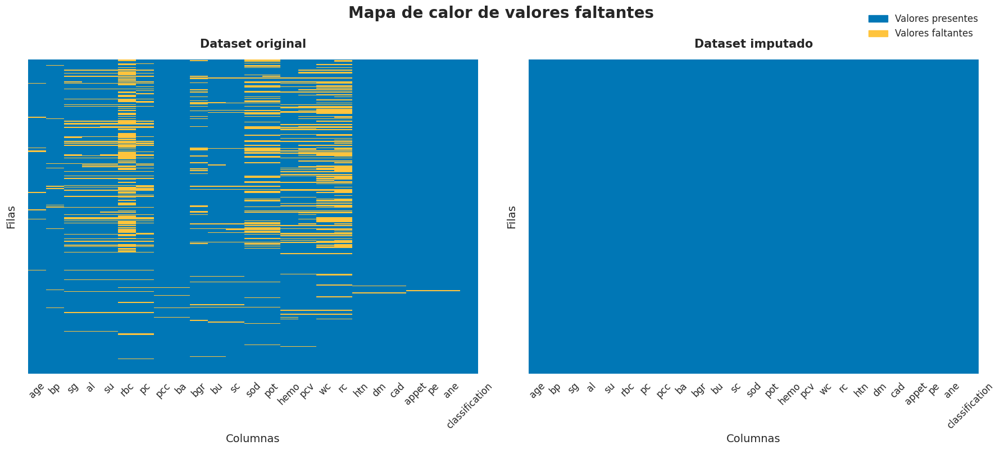

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

sns.set(style="whitegrid")

paleta_colores = ['#0077b6', '#ffc43d']

fig, axes = plt.subplots(1, 2, figsize=(18, 8))
fig.suptitle('Mapa de calor de valores faltantes', fontsize=20, fontweight='bold', y=1)
legend_labels = [Patch(color='#0077b6', label='Valores presentes'), Patch(color='#ffc43d', label='Valores faltantes')]

axes[0] = sns.heatmap(cleaned_kidney_df.isnull(), cmap=paleta_colores, cbar=False, xticklabels=True, yticklabels=False, ax=axes[0])
axes[0].set_title('Dataset original', fontsize=15, pad=15, fontweight='bold')
axes[0].set_xlabel('Columnas', fontsize=14)
axes[0].set_ylabel('Filas', fontsize=14, labelpad=15)
plt.setp(axes[0].get_xticklabels(), fontsize=12, rotation=45)

axes[1] = sns.heatmap(imputed_kidney_df.isnull(), cmap=paleta_colores, cbar=False, xticklabels=True, yticklabels=False, ax=axes[1])
axes[1].set_title('Dataset imputado', fontsize=15, pad=15, fontweight='bold')
axes[1].set_xlabel('Columnas', fontsize=14)
axes[1].set_ylabel('Filas', fontsize=14, labelpad=15)
plt.setp(axes[1].get_xticklabels(), fontsize=12, rotation=45)

fig.legend(handles=legend_labels, bbox_to_anchor=(0.98, 1), loc='upper right', fontsize=12)

plt.tight_layout()
plt.subplots_adjust(top=0.88)
plt.show()

### 3.4. Análisis de la variable objetivo en el dataset imputado

Antes de aplicar cualquier modelo de regresión, es fundamental analizar la variable objetivo en el dataset imputado, para comprender su distribución, posibles sesgos introducidos por la imputación y su relevancia clínica. En nuestro caso, la variable objetivo asignada es "bu", que corresponde a los niveles de urea en sangre.

La urea es un producto de desecho generado a partir del metabolismo de las proteínas, y se elimina normalmente por los riñones. Por ello, niveles elevados de urea en sangre son un indicador clave de disfunción renal, particularmente en enfermedades renales crónicas.
*   En personas sanas, los valores normales de urea suelen situarse entre 1.8 y 7.1 mmol/L (~5 a 20 mg/dL). <a href="https://www.ncbi.nlm.nih.gov/books/NBK305/" target="_blank"> Referencia: NCBI - Clinical Methods: The History, Physical, and Laboratory Examinations</a></p>
*   Valores por encima de 50.0 mmol/L (~140 mg/dL) suelen observarse en pacientes con insuficiencia renal terminal, lo que indica un deterioro grave de la función renal. <a href="https://acutecaretesting.org/en/articles/urea-and-the-clinical-value-of-measuring-blood-urea-concentration" target="_blank"> Referencia: acutecaretesting.org</a></p>

* En pacientes con enfermedad renal crónica, los niveles séricos de urea aumentan progresivamente según el deterioro de la función renal, con valores normales entre 10 y 40 mg/dl, elevaciones leves por encima de 40 mg/dl en estadios iniciales, y cifras superiores a 100 mg/dl en estadios avanzados <a href="http://www.scielo.org.pe/scielo.php?script=sci_arttext&pid=S1018-130X2021000400216" target="_blank"> Referencia: Ramírez-Soto MC, et al. Relación entre el índice urémico y la función renal en pacientes con enfermedad renal crónica.</a></p>

Por tanto, "bu" no solo es un excelente biomarcador de severidad clínica, sino que su predicción precisa podría ser clave para la detección temprana, monitorización de progresión y estratificación de riesgo en pacientes con compromiso renal

Nuestro análisis comenzará estudiando las estadísticas básicas de esta variable en el dataset imputado. Para ello utilizaremos el siguiente código, que nos permitirá:
*   Identificar valores extremos o outliers.
*   Evaluar la media y la mediana como posibles indicadores del sesgo.
*   Verificar la amplitud y dispersión de los valores (máximo, mínimo, desviación estándar).
*   Observar si tras la imputación persisten patrones consistentes.

In [ ]:
print('🔹 Estadísticas descriptivas de "bu":')
print(imputed_kidney_df['bu'].describe())

🔹 Estadísticas descriptivas de "bu":
count   400.00
mean     57.25
std      50.33
min     -18.26
25%      27.00
50%      42.00
75%      66.25
max     391.00
Name: bu, dtype: float64


A continuación, se lleva a cabo un análisis univariable exhaustivo, similar al desarrollado previamente en el apartado 2.5.4, con los siguientes objetivos específicos:
*   Cuantificar las principales medidas de tendencia central y dispersión: media, mediana, moda, varianza, desviación estándar, rango e IQR.
*   Evaluar la forma de la distribución a través de estadísticas de asimetría (skewness) y curtosis (kurtosis).
*   Identificar posibles valores atípicos mediante el método del rango intercuartílico (IQR).
*   Visualizar gráficamente la distribución con histogramas, gráficos de densidad y boxplots para facilitar la interpretación visual de patrones.


📊 Análisis estadístico para "bu" en el dataset imputado:

🔹 Medidas de tendencia central:
   • Media: 57.252
   • Mediana: 42.000
   • Moda: 46.000
🔹 Medidas de dispersión:
   • Desviación estándar: 50.327
   • Varianza: 2532.830
   • Rango: 409.257
   • Rango intercuartílico (IQR): 39.250
🔹 Valores extremos:
   • Mínimo: -18.257
   • Máximo: 391.000
   • Primer cuartil (Q1): 27.000
   • Tercer cuartil (Q3): 66.250
🔹 Forma de la distribución:
   • Asimetría: 2.556 (positiva)
   • Curtosis: 8.936 (leptocúrtica)



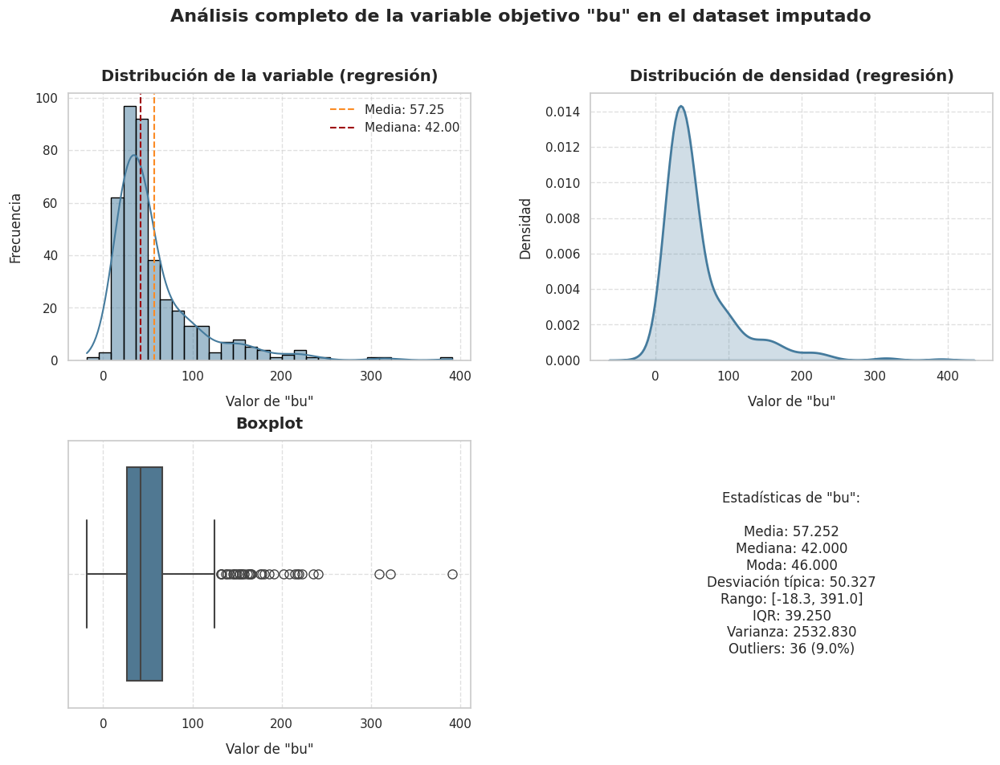

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

media_new = imputed_kidney_df["bu"].mean()
mediana_new = imputed_kidney_df["bu"].median()
moda_new = imputed_kidney_df["bu"].mode()[0]
desviacion_tipica_new = imputed_kidney_df["bu"].std()
var_new = imputed_kidney_df["bu"].var()
min_val_new = imputed_kidney_df["bu"].min()
max_val_new = imputed_kidney_df["bu"].max()
rango_new = max_val_new - min_val_new
iqr_new = imputed_kidney_df["bu"].quantile(0.75) - imputed_kidney_df["bu"].quantile(0.25)
varianza_new = imputed_kidney_df["bu"].var()
asimetria_new = stats.skew(imputed_kidney_df["bu"].dropna())
curtosis_new = stats.kurtosis(imputed_kidney_df["bu"].dropna())
q1_new = imputed_kidney_df["bu"].quantile(0.25)
q3_new = imputed_kidney_df["bu"].quantile(0.75)

# Mostrar las medidas
print(f'''
📊 Análisis estadístico para "bu" en el dataset imputado:\n
🔹 Medidas de tendencia central:
   • Media: {media_new:.3f}
   • Mediana: {mediana_new:.3f}
   • Moda: {moda_new:.3f}
🔹 Medidas de dispersión:
   • Desviación estándar: {desviacion_tipica_new:.3f}
   • Varianza: {var_new:.3f}
   • Rango: {rango_new:.3f}
   • Rango intercuartílico (IQR): {iqr_new:.3f}
🔹 Valores extremos:
   • Mínimo: {min_val_new:.3f}
   • Máximo: {max_val_new:.3f}
   • Primer cuartil (Q1): {q1_new:.3f}
   • Tercer cuartil (Q3): {q3_new:.3f}
🔹 Forma de la distribución:
   • Asimetría: {asimetria_new:.3f} ({'positiva' if asimetria_new > 0 else 'negativa' if asimetria_new < 0 else 'simétrica'})
   • Curtosis: {curtosis_new:.3f} ({'leptocúrtica' if curtosis_new > 0 else 'platicúrtica' if curtosis_new < 0 else 'mesocúrtica'})
''')

lower_bound_new = q1_new - 1.5 * iqr_new
upper_bound_new = q3_new + 1.5 * iqr_new
outliers_new = imputed_kidney_df[(imputed_kidney_df["bu"] < lower_bound_new) | (imputed_kidney_df["bu"] > upper_bound_new)]["bu"]

fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.tight_layout(pad=6.0)
plt.subplots_adjust(hspace=0.3)

# Histograma de la variable 'bu'
sns.histplot(imputed_kidney_df['bu'], kde=True, color='#457b9d', bins=30, edgecolor='black', ax=axes[0, 0])
axes[0, 0].axvline(media_new, color='#fb8b24', linestyle='--', linewidth=1.5, label=f"Media: {media_new:.2f}")
axes[0, 0].axvline(mediana_new, color='#9d0208', linestyle='--', linewidth=1.5, label=f"Mediana: {mediana_new:.2f}")
axes[0, 0].legend(loc='upper right')
axes[0, 0].set_title('Distribución de la variable (regresión)', fontsize=14, pad=11, fontweight='bold')
axes[0, 0].set_xlabel('Valor de "bu"', fontsize=12, labelpad=11)
axes[0, 0].set_ylabel('Frecuencia', fontsize=12, labelpad=11)
axes[0, 0].grid(True, linestyle='--', alpha=0.6)

# Gráfico de Densidad (KDE)
sns.kdeplot(imputed_kidney_df['bu'], fill=True, color='#457b9d', linewidth=2, ax=axes[0, 1])
axes[0, 1].set_title('Distribución de densidad (regresión)', fontsize=14, pad=11, fontweight='bold')
axes[0, 1].set_xlabel('Valor de "bu"', fontsize=12, labelpad=11)
axes[0, 1].set_ylabel('Densidad', fontsize=12, labelpad=11)
axes[0, 1].grid(True, linestyle='--', alpha=0.6)

# Boxplot para identificar valores atípicos
sns.boxplot(x=imputed_kidney_df['bu'], color='#457b9d', fliersize=8, linewidth=1.5, ax=axes[1, 0])
axes[1, 0].set_title('Boxplot', fontsize=14, pad=11, fontweight='bold')
axes[1, 0].set_xlabel('Valor de "bu"', fontsize=12, labelpad=11)
axes[1, 0].grid(True, linestyle='--', alpha=0.6)

# Histograma con valores descriptivos
axes[1, 1].text(0.5, 0.5, f"""
Estadísticas de "bu":\n
Media: {media_new:.3f}
Mediana: {mediana_new:.3f}
Moda: {moda_new:.3f}
Desviación típica: {desviacion_tipica_new:.3f}
Rango: [{min_val_new:.1f}, {max_val_new:.1f}]
IQR: {iqr_new:.3f}
Varianza: {varianza_new:.3f}
Outliers: {len(outliers_new)} ({(len(outliers_new) / len(cleaned_kidney_df)) * 100:.1f}%)
""", horizontalalignment='center', verticalalignment='center', fontsize=12)
axes[1, 1].axis('off')  # Apagar los ejes ya que es solo texto

plt.suptitle(f'Análisis completo de la variable objetivo "bu" en el dataset imputado', fontsize=16, fontweight='bold', y=1)
plt.show()

Al examinar los resultados del análisis estadístico de la variable "bu" en el dataset imputado, se observa que el rango total de los valores (409.197) es considerablemente amplio en comparación con el rango intercuartílico (IQR), que asciende a solo 39.250. Esta diferencia sugiere la presencia de valores extremos o atípicos (ouliers) que se encuentran muy alejados del núcleo central de la distribución y que, por tanto, pueden estar influyendo de manera significativa en las medidas de tendencia central y dispersión, como la media y la varianza.

En cuanto a la asimetría (skewness), se ha obtenido un valor de 2.556, lo que indica una asimetría positiva pronunciada. Este tipo de distribución está sesgada hacia la derecha, lo que implica que existe una cola alargada en el extremo superior de los valores de "bu". En términos prácticos, esto significa que, aunque la mayoría de los pacientes presentan valores moderados de urea, existe un subconjunto con concentraciones anormalmente elevadas, probablemente reflejo de condiciones clínicas graves como insuficiencia renal avanzada.

Asimismo, el valor de curtosis es de 8.936, lo que clasifica la distribución como leptocúrtica. Esta característica describe una distribución más picuda y con colas más largas que una distribución normal. Es decir, hay una mayor concentración de valores cerca de la mediana, pero también una mayor probabilidad de observar valores extremos en ambos extremos de la distribución.

En conjunto, estos indicadores estadísticos describen una distribución con fuerte sesgo a la derecha y con propensión a valores extremos, lo cual es coherente con la naturaleza clínica de la variable "bu", ya que en poblaciones clínicas, es esperable encontrar casos con niveles elevados de urea debido a patologías renales severas.

### 3.5.  Análisis multivariable de valores atípicos en variables numéricas

Tras haber identificado la presencia de posibles valores atípicos en la variable objetivo "bu" y su considerable impacto en las estadísticas descriptivas, hemos considerado esencial extender este análisis al conjunto completo de variables numéricas del dataset imputado. Este enfoque nos permitirá comprender la distribución general de los datos, detectar variables potencialmente afectadas por outliers y, en consecuencia, facilitar decisiones más fundamentadas en la etapa de modelado.

En el código, se ha llevado a cabo un análisis exploratorio univariable de cada columna numérica, haciendo especial énfasis en la detección y cuantificación de valores atípicos, distinguiendo entre:
*   Outliers leves: aquellos que se encuentran fuera del rango intercuartílico (IQR) ampliado en 1.5 veces.
*   Outliers extremos: aquellos que exceden 3 veces el IQR respecto a los cuartiles primero (Q1) y tercero (Q3).

Además, también hemos calculado para cada variable los siguientes indicadores:
*   Los límites inferior y superior para la detección de outliers leves y extremos.
*   El número y porcentaje de observaciones atípicas (leves y extremas).

Finalmente, hemos generado visualizaciones detalladas utilizando boxplots personalizados, sobre los cuales se han superpuesto los puntos individuales de cada observación, codificados por color según su categoría:
*   Normal: azul.
*   Outlier leve: naranja.
*   Outlier extremo: rojo.

Esta representación gráfica facilita una interpretación inmediata del grado de afectación de cada variable.

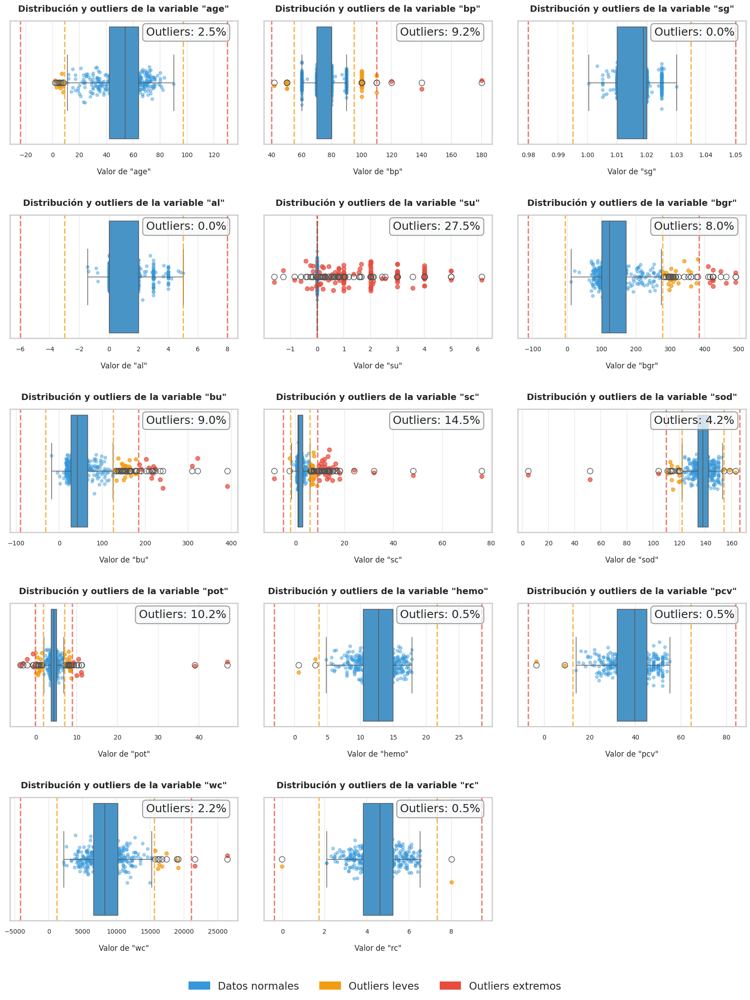

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tabulate import tabulate
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as mpatches

# Configurar el estilo general para todas las visualizaciones
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_context("talk")
plt.rcParams['font.family'] = 'DejaVu Sans'
plt.rcParams['axes.titleweight'] = 'bold'
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10

# Definir una paleta de colores personalizada para los gráficos
colors = {
    'normal': '#3498db',          # Azul para datos normales
    'outlier_mild': '#f39c12',    # Naranja para outliers leves
    'outlier_extreme': '#e74c3c', # Rojo para outliers extremos
    'background': '#f8f9fa',      # Fondo claro
    'grid': '#dee2e6',            # Líneas de cuadrícula suaves
    'text': '#2c3e50',            # Texto oscuro
    'highlight': '#2ecc71'        # Verde para destacados
}

# Seleccionar columnas numéricas
numeric_columns = imputed_kidney_df.select_dtypes(include=['number']).columns
outlier_summary = []

# Verificar si hay valores NA y asegurarnos de que los datos estén limpios
imputed_kidney_df_clean = imputed_kidney_df.copy()

# Calcular estadísticas de outliers sin usar máscaras
for column in numeric_columns:
    # Convertir a array NumPy estándar para evitar problemas con máscaras
    data = imputed_kidney_df_clean[column].to_numpy()

    # Usar numpy directamente para calcular cuartiles
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1

    # Límites para outliers leves (1.5*IQR)
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Límites para outliers extremos (3*IQR)
    lower_extreme = Q1 - 3 * IQR
    upper_extreme = Q3 + 3 * IQR

    # Conteos de outliers
    outliers_mild = imputed_kidney_df_clean[(imputed_kidney_df_clean[column] < lower_bound) &
                                    (imputed_kidney_df_clean[column] >= lower_extreme) |
                                    (imputed_kidney_df_clean[column] > upper_bound) &
                                    (imputed_kidney_df_clean[column] <= upper_extreme)]

    outliers_extreme = imputed_kidney_df_clean[(imputed_kidney_df_clean[column] < lower_extreme) |
                                        (imputed_kidney_df_clean[column] > upper_extreme)]

    total_outliers = len(outliers_mild) + len(outliers_extreme)

    # Calcular porcentajes
    outlier_percent = (total_outliers / len(imputed_kidney_df_clean)) * 100
    outlier_mild_percent = (len(outliers_mild) / len(imputed_kidney_df_clean)) * 100
    outlier_extreme_percent = (len(outliers_extreme) / len(imputed_kidney_df_clean)) * 100

    # Guardamos todos los valores para el resumen
    outlier_summary.append({
        "Variable": column,
        "Q1": Q1,
        "Q3": Q3,
        "IQR": IQR,
        "Límite inferior (outliers leves)": lower_bound,
        "Límite superior (outliers leves)": upper_bound,
        "Outliers leves": len(outliers_mild),
        "Outliers extremos": len(outliers_extreme),
        "Total outliers": total_outliers,
        "% Outliers leves": round(outlier_mild_percent, 2),
        "% Outliers extremos": round(outlier_extreme_percent, 2),
        "% Total outliers": round(outlier_percent, 2)
    })

# Crear DataFrame y ordenar por porcentaje total de outliers
outlier_df = pd.DataFrame(outlier_summary)

# Visualización por variable: crear boxplots individuales con puntos de datos coloreados según si son outliers
num_plots = len(numeric_columns)
num_cols = 3
num_rows = (num_plots + num_cols - 1) // num_cols  # Redondeo hacia arriba

plt.figure(figsize=(18, num_rows * 5))
plt.subplots_adjust(hspace=0.8, wspace=0.5)

for i, column in enumerate(outlier_df['Variable']):
    plt.subplot(num_rows, num_cols, i+1)

    # Obtener datos y calcular límites
    data = imputed_kidney_df_clean[column].to_numpy()  # Convertir a numpy array regular
    Q1 = outlier_df.loc[outlier_df['Variable'] == column, 'Q1'].values[0]
    Q3 = outlier_df.loc[outlier_df['Variable'] == column, 'Q3'].values[0]
    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    lower_extreme = Q1 - 3 * IQR
    upper_extreme = Q3 + 3 * IQR

    # Crear boxplot con seaborn (que maneja mejor los outliers)
    sns.boxplot(x=data, color=colors['normal'], width=0.3)

    # Superponer stripplot coloreando los puntos según tipo de outlier
    normal_idx = np.where((data >= lower_bound) & (data <= upper_bound))[0]
    mild_idx = np.where(((data < lower_bound) & (data >= lower_extreme)) |
                         ((data > upper_bound) & (data <= upper_extreme)))[0]
    extreme_idx = np.where((data < lower_extreme) | (data > upper_extreme))[0]

    # Jitter para mejor visualización
    jitter = 0.02
    if len(normal_idx) > 0:
        plt.scatter(data[normal_idx], np.random.normal(0, jitter, size=len(normal_idx)),
                   color=colors['normal'], alpha=0.4, s=20)
    if len(mild_idx) > 0:
        plt.scatter(data[mild_idx], np.random.normal(0, jitter, size=len(mild_idx)),
                   color=colors['outlier_mild'], alpha=0.7, s=30)
    if len(extreme_idx) > 0:
        plt.scatter(data[extreme_idx], np.random.normal(0, jitter, size=len(extreme_idx)),
                   color=colors['outlier_extreme'], alpha=0.7, s=40)

    # Añadir líneas para los límites
    plt.axvline(x=lower_bound, color=colors['outlier_mild'], linestyle='--', alpha=0.7)
    plt.axvline(x=upper_bound, color=colors['outlier_mild'], linestyle='--', alpha=0.7)
    plt.axvline(x=lower_extreme, color=colors['outlier_extreme'], linestyle='--', alpha=0.7)
    plt.axvline(x=upper_extreme, color=colors['outlier_extreme'], linestyle='--', alpha=0.7)

    # Añadir título y etiquetas
    plt.title(f'Distribución y outliers de la variable "{column}"', pad=15, fontweight='bold')
    plt.xlabel(f'Valor de "{column}"', labelpad=15)
    plt.ylabel('')

    # Añadir información sobre outliers
    outlier_info = outlier_df[outlier_df['Variable'] == column]
    total_pct = outlier_info['% Total outliers'].values[0]
    plt.annotate(f'Outliers: {total_pct:.1f}%', xy=(0.95, 0.95), xycoords='axes fraction',
                ha='right', va='top', bbox=dict(boxstyle="round,pad=0.3",
                fc=colors['background'], ec="gray", alpha=0.8))

# Añadir leyenda general
normal_patch = mpatches.Patch(color=colors['normal'], label='Datos normales')
mild_patch = mpatches.Patch(color=colors['outlier_mild'], label='Outliers leves')
extreme_patch = mpatches.Patch(color=colors['outlier_extreme'], label='Outliers extremos')
plt.figlegend(handles=[normal_patch, mild_patch, extreme_patch],
              loc='center', ncol=3, bbox_to_anchor=(0.5, 0.05))

plt.tight_layout(pad=3.0, h_pad=2.0, w_pad=2.0, rect=[0, 0.05, 1, 0.95])
plt.show()

Con el fin de facilitar la interpretación de los resultados obtenidos en el análisis de outliers, se ha optado por presentar un resumen tabular con las métricas más relevantes para cada variable numérica. La tabla que que genera el código incluye:
*   El número total de outliers por variable.
*   El porcentaje que representan estos valores respecto al total de observaciones.
*   El porcentaje de outliers leves y extremos por separado.
*   Los límites superior e inferior considerados para identificar los valores atípicos.

Esta presentación estructurada permite identificar de forma rápida las variables más afectadas por valores atípicos, lo que es crucial para la toma de decisiones en etapas posteriores.

Además, hemos decidido proporcionar una interpretación visual y conceptual que resume cómo se clasifican los outliers, y qué criterios se deben considerar para identificar variables que requieran un tratamiento especial.

In [ ]:
from IPython.display import HTML, display

# Seleccionar solo las columnas más relevantes para la tabla
table_columns = ['Variable', 'Total outliers', '% Total outliers', '% Outliers leves', '% Outliers extremos',
                'Límite inferior (outliers leves)', 'Límite superior (outliers leves)']
table_data = outlier_df[table_columns]

print("🔹 Resumen de valores atípicos (outliers) por variable:\n")

# Aplicar estilos a la tabla
styled_table5 = table_data.style.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})

styled_table5 = styled_table5.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

# Mostrar la tabla estilizada
display(styled_table5)

interpretation_html = """
<div style="background-color: #f8f9fa; border-left: 6px solid #457b9d; margin: 15px 0; padding: 15px;">
    <h3 style="color: #457b9d; margin-top: 0;">📊 Interpretación de outliers</h3>
    <ul style="list-style-type: none; padding-left: 10px;">
        <li style="margin-bottom: 8px;">
            <span style="color: #f39c12; font-weight: bold;">▪️ Outliers leves:</span>
            <span style="color: #000000;">valores fuera del rango [Q1-1.5*IQR, Q3+1.5*IQR].</span>
        </li>
        <li style="margin-bottom: 8px;">
            <span style="color: #e74c3c; font-weight: bold;">▪️ Outliers extremos:</span>
            <span style="color: #000000;">valores fuera del rango [Q1-3*IQR, Q3+3*IQR].</span>
        </li>
        <li style="margin-bottom: 8px;">
            <span style="color: #1d3557; font-weight: bold;">▪️ Criterio de atención:</span>
            <span style="color: #000000;">variables con más del 10% de outliers pueden requerir tratamiento especial antes del modelado.</span>
        </li>
    </ul>
</div>
"""

display(HTML(interpretation_html))

🔹 Resumen de valores atípicos (outliers) por variable:



,Variable,Total outliers,% Total outliers,% Outliers leves,% Outliers extremos,Límite inferior (outliers leves),Límite superior (outliers leves)
0,age,10,2.500000,2.500000,0.000000,9.000000,97.000000
1,bp,37,9.250000,8.500000,0.750000,55.000000,95.000000
2,sg,0,0.000000,0.000000,0.000000,0.995000,1.035000
3,al,0,0.000000,0.000000,0.000000,-3.000000,5.000000
4,su,110,27.500000,0.000000,27.500000,0.000000,0.000000
5,bgr,32,8.000000,5.500000,2.500000,-6.500000,277.500000
6,bu,36,9.000000,5.750000,3.250000,-31.875000,125.125000
7,sc,58,14.500000,6.750000,7.750000,-2.100000,5.900000
8,sod,17,4.250000,3.500000,0.750000,122.000000,154.000000
9,pot,41,10.250000,7.250000,3.000000,1.750000,6.950000


#### 3.5.1. Análisis clínico de outliers

La detección de valores atípicos (outliers) no solo debe abordarse desde un punto de vista estadístico, sino también desde una perspectiva clínica. Es fundamental evaluar si estos valores extremos son errores, condiciones fisiológicas raras, o reflejan casos clínicos válidos pero poco frecuentes. A continuación se analiza la relevancia clínica de los principales outliers detectados en el conjunto de datos sobre enfermedad renal crónica (ERC):

**Variables con la mayoria de outliers leves:**

1. Edad ("age"):
    *   Observación clínica: aunque la ERC es más común en adultos mayores, también puede presentarse en niños debido a enfermedades congénitas, síndromes hereditarios o malformaciones del tracto urinario. Estos casos pediátricos son clínicamente relevantes pero poco frecuentes. <a href="https://www.niddk.nih.gov/health-information/kidney-disease/children" target="_blank">Referencia: NIH - Pediatric Chronic Kidney Disease </a></p>
    *   Efecto sobre el modelo: la inclusión de pacientes pediátricos puede introducir patrones diferentes en los datos, alterando las predicciones y reduciendo la generalización del modelo entrenado para adultos.
    *   Posible solución: realizar un análisis comparativo del modelo con y sin los datos de pacientes menores de edad, para determinar si deben excluirse o tratarse de forma diferenciada.

2. Presión arterial ("bp"):
    *   Observación clínica: se identificaron valores atípicos por encima de 160 mmHg, correspondientes a hipertensión severa. <a href="https://www.kidney.org/kidney-topics/what-high-blood-pressure" target="_blank">Referencia: National Kidney Foundation – Hypertension and Kidneys</a></p>
    *   Efecto sobre el modelo: estos casos pueden causar que el modelo sobreestime la hipertensión como predictor, perdiendo sensibilidad para otras variables relevantes.
    *   Posible solución: aplicar Winsorization para limitar la influencia de casos extremos sin eliminar información crítica.

3. Glucosa en sangre aleatoria ("brg"):
    *   Observación clínica: se han identificado valores superiores a 300–400 mg/dL, lo que sugiere casos severos de hiperglucemia o diabetes no controlada. <a href="https://medlineplus.gov/lab-tests/blood-glucose-test/" target="_blank">Referencia: MedlinePlus - Blood Glucose Test</a></p>
    *   Efecto sobre el modelo: estos valores pueden sesgar el modelo hacia pacientes con diabetes tipo 2 avanzada, una comorbilidad común en la ERC, pero no necesariamente representativa de todos los casos.
    *   Posible solución: aplicar una transformación logarítmica puede reducir el impacto de estos valores extremos sin eliminarlos, preservando así su valor clínico.

4. Niveles de sodio ("sod"):
    *   Observación clínica: se han identificado valores superiores a 150 mEq/L, lo que sugiere hipernatremia, potencialmente vinculada a deshidratación, diuréticos o disfunción renal. <a href="https://www.akdh.org/article/S1548-5595(15)00165-2/fulltext" target="_blank">Referencia: Advances in Chronic Kidney Disease - Sodium and Volume Disorders in Advanced Chronic Kidney Disease</a></p>
    *   Efecto sobre el modelo: estos valores pueden hacer que el modelo se vuelva excesivamente sensible a alteraciones electrolíticas no frecuentes.
    *   Posible solución: aplicar técnicas de Winsorization o analizar la distribución por percentiles para limitar el impacto de valores extremos sin suprimir datos clínicamente válidos.

5. Niveles de potasio ("pot"):
    *   Observación clínica: se han registrado valores superiores a 10 mEq/L, lo cual se considera un estado de hiperpotasemia grave, común en etapas avanzadas de insuficiencia renal. <a href="https://www.kidneyfund.org/living-kidney-disease/health-problems-caused-kidney-disease/high-potassium-hyperkalemia-causes-prevention-and-treatment" target="_blank">Referencia: National Kidney Foundation – High Potassium (Hyperkalemia)</a></p>
    *   Efecto sobre el modelo: estos valores extremos pueden introducir ruido si el modelo los interpreta como parte del rango normal, aunque en realidad indican alto riesgo de complicaciones cardiovasculares.
    *   Posible solución: aplicar técnicas de Winsorization para limitar el impacto de los valores extremos manteniendo su presencia en el conjunto de datos.

6. Niveles de hemoglobina ("hemo"):
    *   Observación clínica: se reportaron valores por debajo de 5 g/dL, indicativos de anemia severa, condición frecuente en pacientes con ERC avanzada. <a href="https://emedicine.medscape.com/article/1389854-overview" target="_blank">Referencia: Medscape – Anemia of Chronic Disease and Kidney Failure</a></p>
    *   Efecto sobre el modelo: estos valores bajos pueden sesgar el modelo si no se representan adecuadamente como un estado clínico.
    *   Posible solución: en lugar de transformación estadística, reclasificar los valores en categorías como "bajo", "normal" y "alto", de acuerdo con rangos clínicos estandarizados, para facilitar la interpretación clínica y mejorar la robustez del modelo.

7. Volumen celular empaquetado ("pvc"):
    *   Observación clínica: se han detectado valores por debajo de 20%, lo cual indica un volumen celular empaquetado (hematocrito) reducido. Valores bajos en el porcentaje de glóbulos rojos en la sangre pueden ser indicativos de anemia, que es común en pacientes con enfermedad renal crónica debido a la disminución en la producción de eritropoyetina. <a href="https://www.labtestsonline.es/tests/hematocrito" target="_blank">Referencia: SeMedLab - Hematocrito.</a></p>
    *   Efecto sobre el modelo: si estos valores extremos son poco frecuentes (como es nuestro caso), pueden introducir desequilibrios en modelos sensibles a los rangos numéricos.
    *   Posible solución: aplicar transformaciones o normalización robusta para suavizar el efecto de estos extremos.

8. Recuento de glóbulos blancos ("wc"):
    *   Observación clínica: elevaciones significativas del conteo leucocitario pueden estar asociadas con procesos inflamatorios o infecciosos frecuentes en pacientes con ERC. <a href="https://www.researchgate.net/publication/318354798_Low_white_blood_cell_count_is_independently_associated_with_chronic_kidney_disease_progression_in_the_elderly_The_CKD-ROUTE_study" target="_blank">Referencia: Low white blood cell count is independently associated with chronic kidney disease progression in the elderly: The CKD-ROUTE study.</a></p>
    *   Efecto sobre el modelo: outliers muy elevados pueden sesgar el modelo hacia la identificación de infecciones como factor predominante, afectando la precisión general.
    *   Posible solución: utilizar una transformación logarítmica para suavizar la influencia de estos valores sin eliminarlos, preservando su importancia clínica.

9. Recuento de glóbulos rojos ("rc"):
    *   Observación clínica: valores superiores a 7–8 millones/mm³ pueden ser indicativos de policitemia secundaria o errores de laboratorio. <a href="https://www.kidney.org/kidney-topics/anemia-and-chronic-kidney-disease" target="_blank">Referencia: National Kidney Foundation – Anemia and CKD</a></p>
    *   Efecto sobre el modelo: dado que la anemia es una complicación frecuente en ERC, estos valores podrían interferir en la detección correcta de su presencia.
    *   Posible solución: aplicar Winsorization o considerar umbrales clínicos para categorizar los datos y mitigar la distorsión.

10. Urea en sangre ("bu"):
    *   Observación clínica:  Se han detectado valores extremos de urea significativamente superiores al rango habitual y como se mencionó en el punto 4.1, la urea en sangre es una variable objetivo crítica en el diagnóstico y seguimiento de la enfermedad renal crónica (ERC).
    *   Efecto sobre el modelo: estos valores extremos pueden distorsionar los modelos predictivos, especialmente si no están adecuadamente tratados. Esto podría llevar a sobreajustar el modelo hacia casos muy severos que no representan la mayoría de la población.
    *   Posible solución: aplicar técnicas como Winsorization o cut-off clínico.

**Variables con la mayoria de outliers extremos:**

1. Niveles de azúcar en orina ("su"):
    *   Observación clínica: en el conjunto de datos, se identifican valores distintos de 0. En condiciones normales, la orina no contiene glucosa detectable. La presencia de más de 0.25 mg/L de glucosa en la orina se considera glucosuria. Una de las causas es una posible disfunción en la reabsorción renal de glucosa, lo que podría estar relacionado con alteraciones en la función renal. <a href="https://my.clevelandclinic.org/health/diseases/glycosuria" target="_blank">Referencia: Cleveland clinic - Glycosuria</a></p>
    *   Efecto en el modelo: valores mayores pueden desbalancear la distribución e inducir al modelo a sobreestimar la importancia de la glucosuria.
    *   Posible solución: en lugar de transformación estadística, convertir la variable a categótica o binaria, para facilitar la interpretación clínica y mejorar la robustez del modelo.

2. Creatinina sérica ("sc"):
    *   Observación clínica: valores elevados de creatinina sérica (>10 mg/dL) pueden indicar insuficiencia renal aguda o ERC terminal. Son esperables en contextos clínicos severos. <a href="https://www.kidneyfund.org/all-about-kidneys/tests/serum-creatinine-test" target="_blank">Referencia: National Kidney Foundation – Serum Creatinine Test</a></p>
    *   Efecto sobre el modelo: dado que la creatinina es un biomarcador clave para el diagnóstico de ERC, estos valores pueden dominar el comportamiento del modelo si no se gestionan adecuadamente.
    *   Posible solución: considerar el uso de técnicas como Winsorization o recorte de percentiles superiores, en lugar de eliminar los datos. Esto preserva la información mientras se reduce la distorsión estadística.

### 3.6. Tratamiento de outliers

En esta primera etapa, realizaremos el tratamiento de outliers detectados previamente mediante la técnica de recorte por límites clínicamente informados. Además, corregiremos valores inválidos como aquellos menores a 0, que no son fisiológicamente posibles para la mayoría de las variables.

El enfoque seguido no es meramente estadístico, sino basado en la evidencia clínica descrita en el anterior apartado, con el objetivo de preservar la validez médica de los datos sin introducir sesgos innecesarios en el modelo.

In [ ]:
import numpy as np
import pandas as pd
from scipy.stats.mstats import winsorize

# Función para censurar variables con límites
def cap_var(df, variables_limits):
    """
    Censura los valores de columnas específicas en un DataFrame, de acuerdo con límites
    definidos por el usuario (mínimos y/o máximos).

    -----------
    Parámetros:
    -----------
    - df: DataFrame original.
    - variables_limits: diccionario con pares 'variable': (min, max).

    ---------
    Devuelve:
    ---------
    - df_capped: nuevo DataFrame con valores censurados.
    """

    df_capped = df.copy()  # Crear una copia para no modificar el original
    for var, limits in variables_limits.items():
        lower, upper = limits
        capped_col = df[var].copy()
        if lower is not None:
            capped_col = capped_col.clip(lower=lower)
        if upper is not None:
            capped_col = capped_col.clip(upper=upper)
        df_capped[var] = capped_col
    return df_capped

variables_a_censurar = {
    'bu': (0, 250),
    'sod': (100, None),
    'sc': (0, 20),
    'pot': (0, 15),
    'wc': (0, 20000),
    'bgr': (0, 400),
    'al': (0, None),
    'pcv': (0, None),
    'su': (0, None)
}

# Asignar el resultado de cap_var al dataframe
imputed_kidney_df = cap_var(imputed_kidney_df, variables_a_censurar)

# Mostrar los primeros 10 registros
imputed_kidney_df.head(10)

,age,bp,sg,al,su,rbc,pc,pcc,ba,bgr,...,pcv,wc,rc,htn,dm,cad,appet,pe,ane,classification
id,,,,,,,,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,normal,normal,notpresent,notpresent,121.00,...,44.00,"7,800.00",5.20,yes,yes,no,good,no,no,ckd
1,7.00,50.00,1.02,4.00,0.00,normal,normal,notpresent,notpresent,301.94,...,38.00,"6,000.00",5.02,no,no,no,good,no,no,ckd
2,62.00,80.00,1.01,2.00,3.00,normal,normal,notpresent,notpresent,400.00,...,31.00,"7,500.00",4.42,no,yes,no,poor,no,yes,ckd
3,48.00,70.00,1.00,4.00,0.00,normal,abnormal,present,notpresent,117.00,...,32.00,"6,700.00",3.90,yes,no,no,poor,yes,yes,ckd
4,51.00,80.00,1.01,2.00,0.00,normal,normal,notpresent,notpresent,106.00,...,35.00,"7,300.00",4.60,no,no,no,good,no,no,ckd
5,60.00,90.00,1.01,3.00,0.00,normal,normal,notpresent,notpresent,74.00,...,39.00,"7,800.00",4.40,yes,yes,no,good,yes,no,ckd
6,68.00,70.00,1.01,0.00,0.00,normal,normal,notpresent,notpresent,100.00,...,36.00,"7,334.70",3.44,no,no,no,good,no,no,ckd
7,24.00,81.02,1.01,2.00,4.00,normal,abnormal,notpresent,notpresent,400.00,...,44.00,"6,900.00",5.00,no,yes,no,good,yes,no,ckd
8,52.00,100.00,1.01,3.00,0.00,normal,abnormal,present,notpresent,138.00,...,33.00,"9,600.00",4.00,yes,yes,no,good,no,yes,ckd


#### 3.6.1 Evaluación asimetría, distribución, etc.

Después de aplicar los límites para censurar valores atípicos extremos, es esencial examinar cómo se distribuyen ahora la variables numéricas con mayor cantidad de outliers. Esto nos permitirá validar si el recorte ha logrado reducir sesgos severos y, en particular, si persiste asimetría, que podría requerir una transformación mateática para mejorar la normalidad de las variables.

El código que tenemos a continuación, genera gráficos combinados para cada variable, en los que aparecen: histograma con densidad, boxplot, gráfico Q-Q, diagrama de violín y un cuadro con estadísticas descriptivas completas.

Este análisis nos ayuda a cuantificar varios parámetros, entre los cuales se incluyen:
*   Medidas de tendencia central y dispersión.
*   Coeficiente de variación (CV) para entender la variabilidad relativa.
*   Grado de asimetría e interpretación cualitativa.
*   Resultado del test de Shapiro-Wilk para evaluar la normalidad de la distribución.

Finalmente, generamos una tabla resumen con los indicadores clave para todas las variables de interés, lo que facilita su comparación y posterior toma de decisiones.



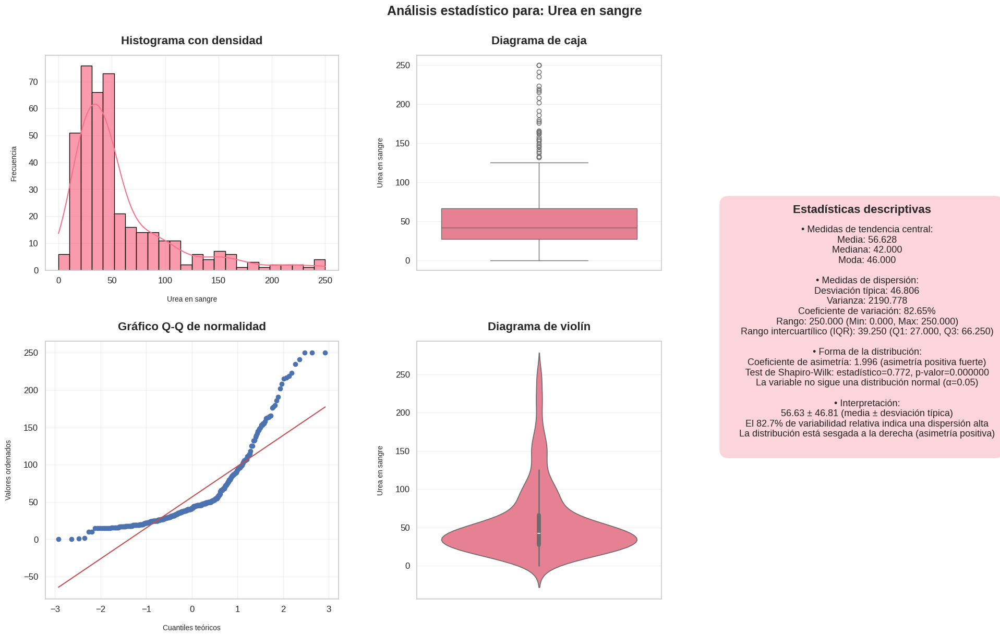

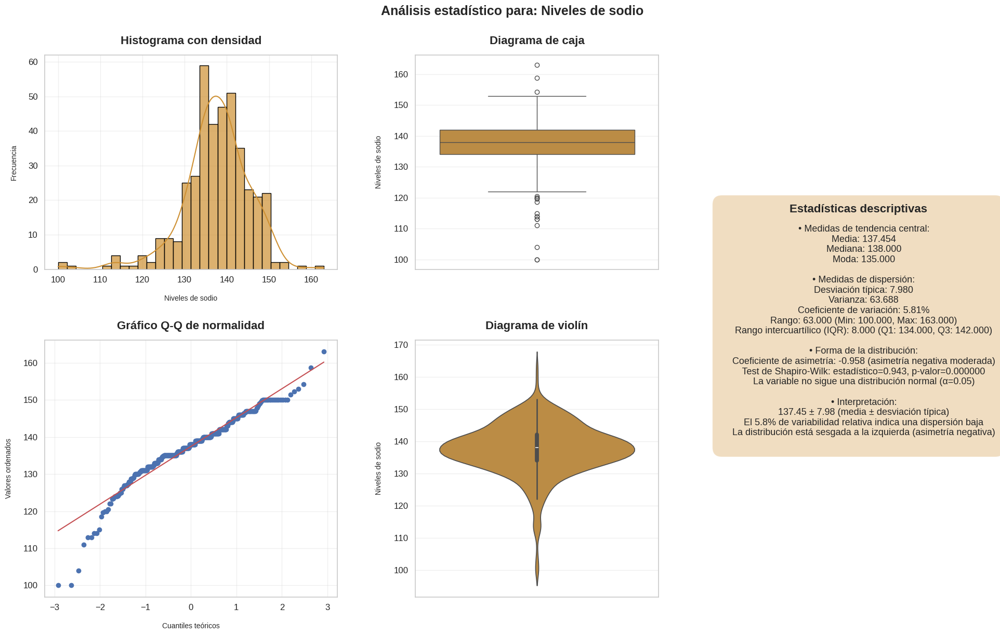

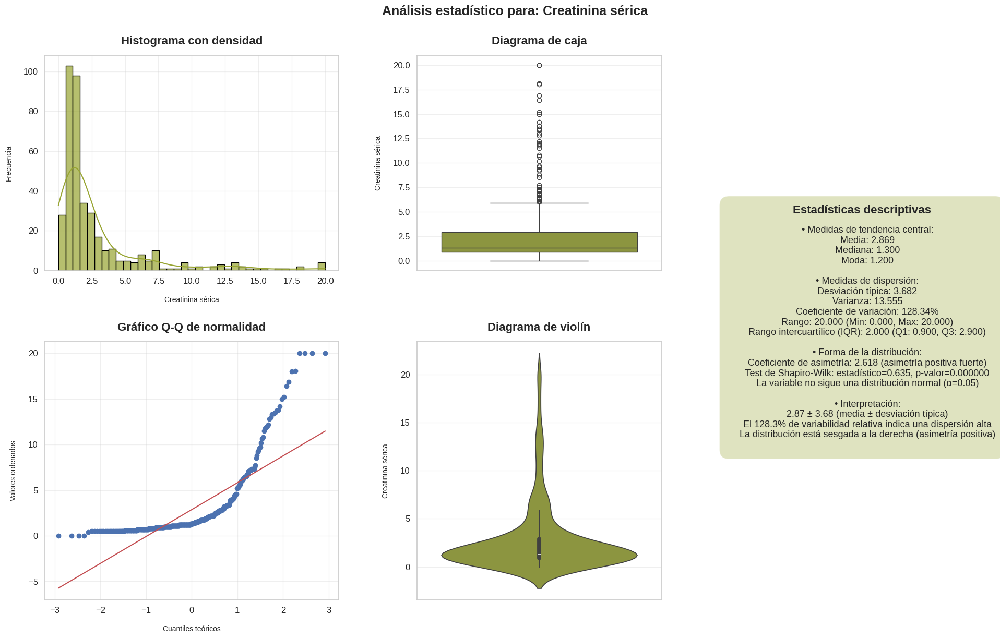

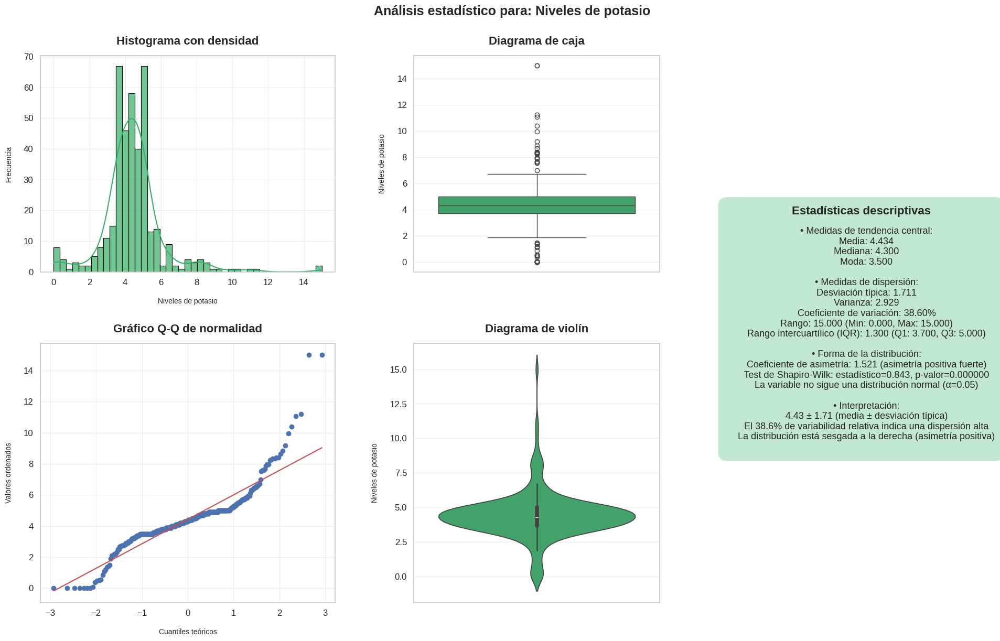

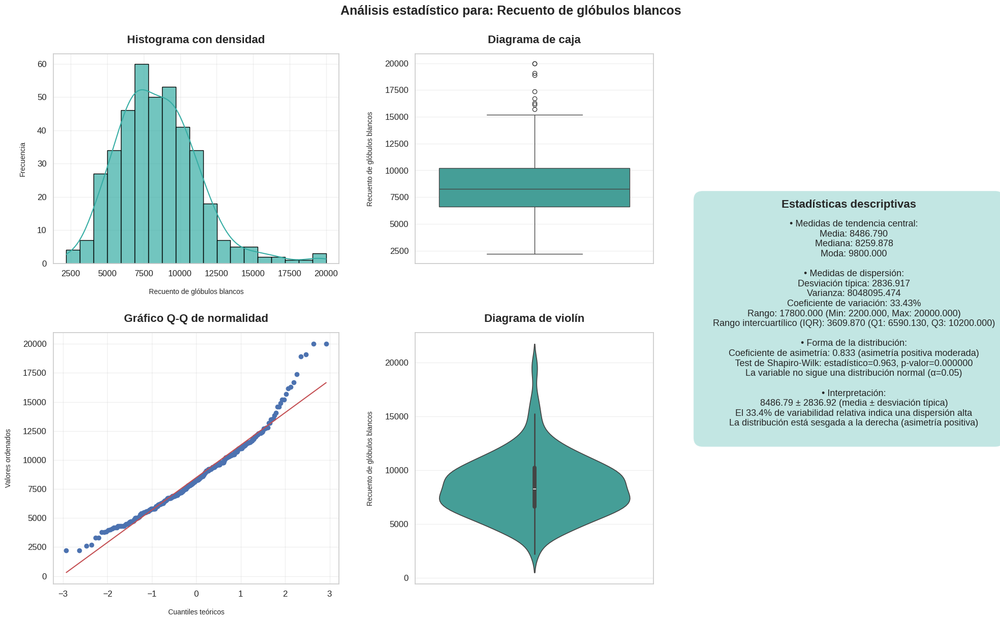

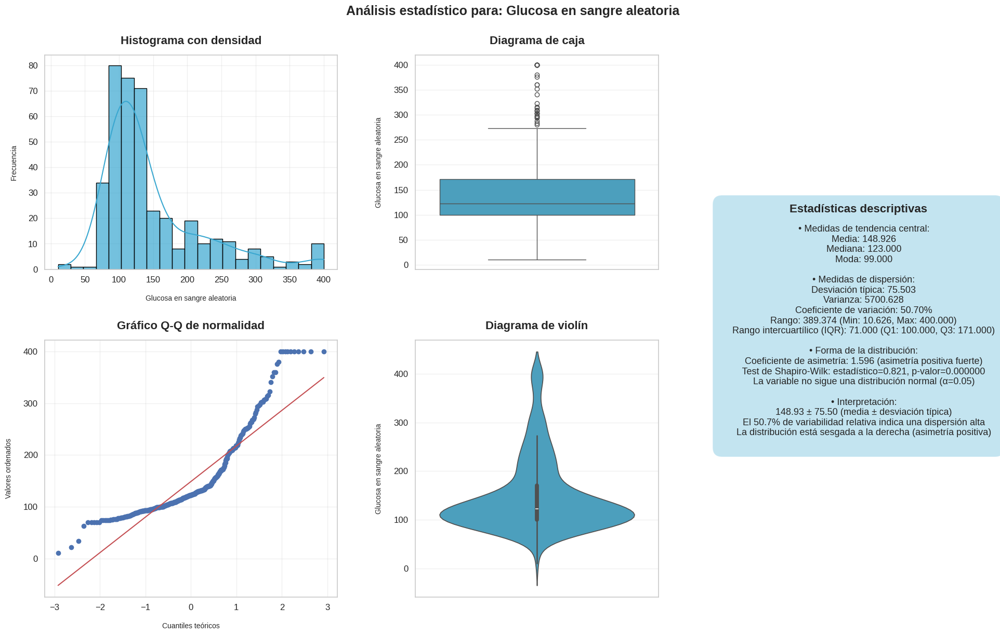

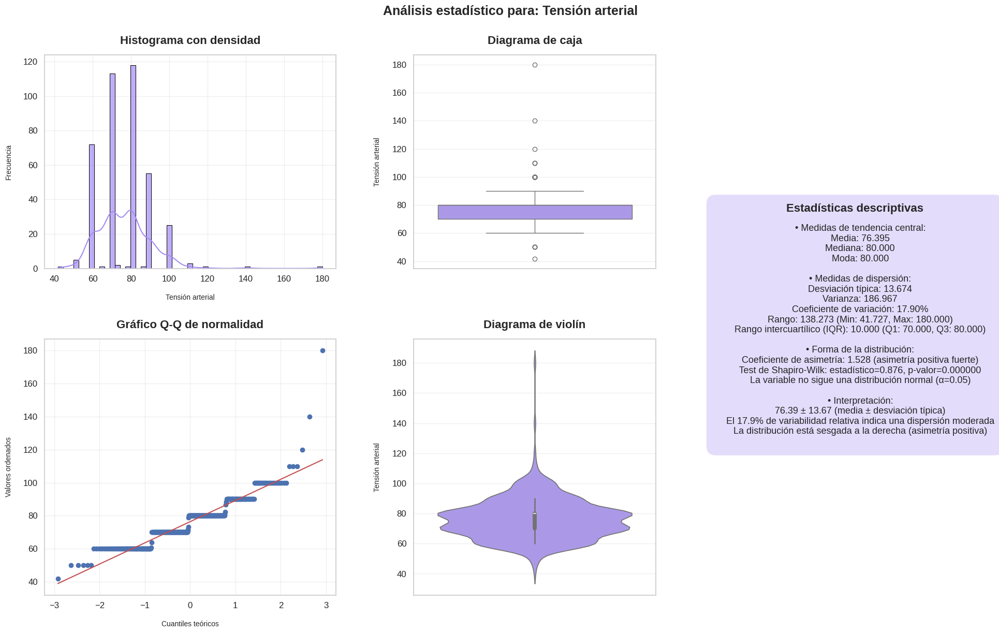

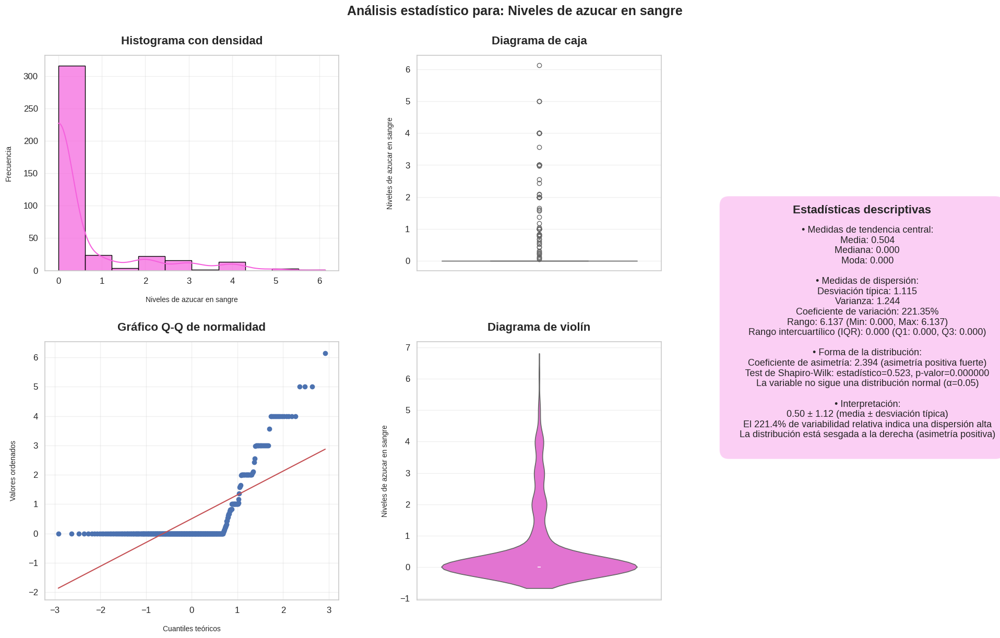



🔹 Resumen de estadísticas para todas las variables:



,Variable,Media,Mediana,Desv. Típica,CV (%),Asimetría,P-valor Shapiro,Normal
0,Urea en sangre,56.628,42.000,46.806,82.655,1.996,0.000,False
1,Niveles de sodio,137.454,138.000,7.980,5.806,-0.958,0.000,False
2,Creatinina sérica,2.869,1.300,3.682,128.342,2.618,0.000,False
3,Niveles de potasio,4.434,4.300,1.711,38.597,1.521,0.000,False
4,Recuento de glóbulos blancos,8486.790,8259.878,2836.917,33.427,0.833,0.000,False
5,Glucosa en sangre aleatoria,148.926,123.000,75.503,50.698,1.596,0.000,False
6,Tensión arterial,76.395,80.000,13.674,17.899,1.528,0.000,False
7,Niveles de azucar en sangre,0.504,0.000,1.115,221.351,2.394,0.000,False



Tiempo de ejecución: 10.36 segundos


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import skew, shapiro, probplot
import matplotlib.gridspec as gridspec
import time
import matplotlib.font_manager as fm

# Medir tiempo de ejecución
start_time = time.time()

# Lista de variables para analizar
variables = ['bu', 'sod', 'sc', 'pot', 'wc', 'bgr', 'bp', 'su']

# Diccionario para nombres completos de variables
variable_names = {
    'bu': 'Urea en sangre',
    'sod': 'Niveles de sodio',
    'sc': 'Creatinina sérica',
    'pot': 'Niveles de potasio',
    'wc': 'Recuento de glóbulos blancos',
    'bgr': 'Glucosa en sangre aleatoria',
    'bp': 'Tensión arterial',
    'su': 'Niveles de azucar en sangre'
}

# Paleta de colores para los gráficos
palette = sns.color_palette("husl", len(variables))
colors = dict(zip(variables, palette))

# Función para interpretar la asimetría
def interpret_skewness(skew_value):
    if skew_value < -1:
        return "asimetría negativa fuerte"
    elif -1 <= skew_value < -0.5:
        return "asimetría negativa moderada"
    elif -0.5 <= skew_value < 0:
        return "asimetría negativa leve"
    elif 0 <= skew_value < 0.5:
        return "asimetría positiva leve"
    elif 0.5 <= skew_value < 1:
        return "asimetría positiva moderada"
    else:
        return "asimetría positiva fuerte"

# Calcular todas las estadísticas
def calculate_statistics(df, variables):
    all_stats = {}

    # Calcular estadísticas para todas las variables de una vez
    describe_df = df[variables].describe()
    quantiles = df[variables].quantile([0.25, 0.75])
    modes = df[variables].mode().iloc[0]
    variances = df[variables].var()
    skewness = df[variables].apply(skew)

    for variable in variables:
        var_stats = {}

        # Estadísticas básicas (ya calculadas en describe)
        var_stats['media'] = describe_df.loc['mean', variable]
        var_stats['desv_tipica'] = describe_df.loc['std', variable]
        var_stats['min'] = describe_df.loc['min', variable]
        var_stats['max'] = describe_df.loc['max', variable]
        var_stats['mediana'] = describe_df.loc['50%', variable]

        # Otras estadísticas
        var_stats['moda'] = modes[variable]
        var_stats['q1'] = quantiles.loc[0.25, variable]
        var_stats['q3'] = quantiles.loc[0.75, variable]
        var_stats['rango'] = var_stats['max'] - var_stats['min']
        var_stats['iqr'] = var_stats['q3'] - var_stats['q1']
        var_stats['varianza'] = variances[variable]
        var_stats['cv'] = (var_stats['desv_tipica'] / var_stats['media']) * 100 if var_stats['media'] != 0 else float('inf')
        var_stats['asimetria'] = skewness[variable]

        # Test de normalidad (esto no se puede vectorizar fácilmente)
        var_stats['shapiro_stat'], var_stats['shapiro_p'] = shapiro(df[variable])
        var_stats['normal'] = var_stats['shapiro_p'] > 0.05

        all_stats[variable] = var_stats

    return all_stats

# Calcular todas las estadísticas
all_stats = calculate_statistics(imputed_kidney_df, variables)

# Configurar estilo general
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_context("notebook", font_scale=1.1)

# Crear un informe para cada variable
for i, variable in enumerate(variables):
    var_stats = all_stats[variable]
    var_name = variable_names.get(variable, variable)

    # Crear figura con layout optimizado
    fig = plt.figure(figsize=(20, 12))
    gs = gridspec.GridSpec(2, 3, width_ratios=[1.2, 1, 1], height_ratios=[1, 1.2], wspace=0.3, hspace=0.3,
                           left=0.05, right=0.95, bottom=0.05, top=0.92)

    # Título principal
    plt.suptitle(f'Análisis estadístico para: {var_name}', fontsize=18, fontweight='bold', y=1)

    # 1. Histograma con KDE (más eficiente con bins='auto')
    ax1 = plt.subplot(gs[0, 0])
    sns.histplot(imputed_kidney_df[variable], kde=True, color=colors[variable],
                 bins='auto', edgecolor='black', alpha=0.7, ax=ax1)
    ax1.set_title('Histograma con densidad', fontsize=16, fontweight='bold', pad=15)
    ax1.set_xlabel(var_name, fontsize=10, labelpad=15)
    ax1.set_ylabel('Frecuencia', fontsize=10, labelpad=15)

    # 2. Boxplot
    ax2 = plt.subplot(gs[0, 1])
    sns.boxplot(y=imputed_kidney_df[variable], color=colors[variable], ax=ax2)
    ax2.set_title('Diagrama de caja', fontsize=16, fontweight='bold', pad=15)
    ax2.set_ylabel(var_name, fontsize=10, labelpad=15)

    # 3. Q-Q Plot
    ax3 = plt.subplot(gs[1, 0])
    probplot(imputed_kidney_df[variable], dist="norm", plot=ax3)
    ax3.set_title('Gráfico Q-Q de normalidad', fontsize=16, fontweight='bold', pad=15)
    ax3.set_xlabel('Cuantiles teóricos', fontsize=10, labelpad=15)
    ax3.set_ylabel('Valores ordenados', fontsize=10, labelpad=15)

    # 4. Violin plot
    ax4 = plt.subplot(gs[1, 1])
    sns.violinplot(y=imputed_kidney_df[variable], color=colors[variable], ax=ax4)
    ax4.set_title('Diagrama de violín', fontsize=16, fontweight='bold', pad=15)
    ax4.set_ylabel(var_name, fontsize=10, labelpad=15)

    # 5. Estadísticas descriptivas
    ax5 = plt.subplot(gs[:, 2])
    ax5.axis('off')

    # Preparar texto con estadísticas e interpretaciones
    skew_interpretation = interpret_skewness(var_stats['asimetria'])
    normal_text = "sigue" if var_stats['normal'] else "no sigue"

    # Cuadro de texto con estadísticas
    stats_text = f"""

    • Medidas de tendencia central:
    Media: {var_stats['media']:.3f}
    Mediana: {var_stats['mediana']:.3f}
    Moda: {var_stats['moda']:.3f}

    • Medidas de dispersión:
    Desviación típica: {var_stats['desv_tipica']:.3f}
    Varianza: {var_stats['varianza']:.3f}
    Coeficiente de variación: {var_stats['cv']:.2f}%
    Rango: {var_stats['rango']:.3f} (Min: {var_stats['min']:.3f}, Max: {var_stats['max']:.3f})
    Rango intercuartílico (IQR): {var_stats['iqr']:.3f} (Q1: {var_stats['q1']:.3f}, Q3: {var_stats['q3']:.3f})

    • Forma de la distribución:
    Coeficiente de asimetría: {var_stats['asimetria']:.3f} ({skew_interpretation})
    Test de Shapiro-Wilk: estadístico={var_stats['shapiro_stat']:.3f}, p-valor={var_stats['shapiro_p']:.6f}
    La variable {normal_text} una distribución normal (α=0.05)

    • Interpretación:
    {var_stats['media']:.2f} ± {var_stats['desv_tipica']:.2f} (media ± desviación típica)
    El {var_stats['cv']:.1f}% de variabilidad relativa indica una dispersión {"alta" if var_stats['cv'] > 30 else "moderada" if var_stats['cv'] > 15 else "baja"}
    La distribución está {"sesgada a la derecha (asimetría positiva)" if var_stats['asimetria'] > 0 else "sesgada a la izquierda (asimetría negativa)" if var_stats['asimetria'] < 0 else "aproximadamente simétrica"}
    """

    # Colocar el texto en el centro del área disponible
    ax5.text(0.5, 0.5, stats_text, transform=ax5.transAxes,
             fontsize=13, verticalalignment='center', horizontalalignment='center',
             bbox=dict(boxstyle='round,pad=1', facecolor=colors[variable], alpha=0.3))

    ax5.text(0.5, 0.71, 'Estadísticas descriptivas', fontsize=16, fontweight='bold',
             horizontalalignment='center', transform=ax5.transAxes)

    fig.subplots_adjust()
    plt.show()
    print("\n")


# Crear una tabla resumen con todas las estadísticas
summary_data = {
    'Variable': [variable_names.get(var, var) for var in variables],
    'Media': [all_stats[var]['media'] for var in variables],
    'Mediana': [all_stats[var]['mediana'] for var in variables],
    'Desv. Típica': [all_stats[var]['desv_tipica'] for var in variables],
    'CV (%)': [all_stats[var]['cv'] for var in variables],
    'Asimetría': [all_stats[var]['asimetria'] for var in variables],
    'P-valor Shapiro': [all_stats[var]['shapiro_p'] for var in variables],
    'Normal': [all_stats[var]['normal'] for var in variables]
}

summary_df = pd.DataFrame(summary_data)
print("🔹 Resumen de estadísticas para todas las variables:\n")
summary_df_styled = summary_df.style.format({
    'Media': '{:.3f}',
    'Mediana': '{:.3f}',
    'Desv. Típica': '{:.3f}',
    'CV (%)': '{:.3f}',
    'Asimetría': '{:.3f}',
    'P-valor Shapiro': '{:.3f}'
})

# Aplicar estilos a la tabla
styled_table6 = summary_df_styled.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})

styled_table6 = styled_table6.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

# Mostrar la tabla estilizada
display(styled_table6)

# Medir y mostrar tiempo de ejecución
execution_time = time.time() - start_time
print(f"\nTiempo de ejecución: {execution_time:.2f} segundos")

#### 3.6.2 Valoración de aplicación de transformaciones

Después de analizar el comportamiento de las variables tras aplicar límites clínicamente para censurar valores extremos, el siguiente paso consiste en evaluar y corregir la asimetría (skewness) de aquellas distribuciones que aun presentan sesgo, en nuestro caso, principalmente positivo.

Este sesgo puede afectar negativamente a modelos estadísticos, especialmente aquellos que asumen normalidad o simetría en las variables. Por este motivo, el siguiente paso en nuestro análisis es aplicar distintas transformaciones matemáticas con el objetivo de reducir dicha asimetría y acercar las variables a una distribución más simétrica o normal para así mejorar tanto la validez estadística como el rendimiento predictivo de los modelos.

En total, hemos aplicado cuatro tipos de transformaciones distintas a cada variable numérica del dataset. Cada una está pensada para aplicarse en situaciones específicas según la forma y características de la variable.:

1. Transformación logarítmica: aplica la función `log(1 + x)` sobre cada valor de la variable. Esta forma específica permite incluir también valores iguales a cero, evitando errores matemáticos. Al comprimir valores grandes más que los pequeños, el resultado tiende a redistribuir los datos de manera más simétrica y reducir el impacto de valores atípicos altos. Típicamente se utiliza en:
    *   Variables con gran sesgo hacia la derecha (asimetría positiva).
    *   Datos con una gran dispersión y valores extremos.
    *   Cuando los valores son estrictamente positivos o pueden ser desplazados artificialmente para serlo.

2. Transformación por raíz cuadrada: como su nombre indica, aplicar una raíz cuadrada a una variable (`sqrt(x)`). Esta es una forma menos agresiva que la logarítmica de comprimir los valores altos. A diferencia del logaritmo, la raíz cuadrada es menos sensible a valores extremos, por lo que es adecuada en situaciones donde se desea mejorar la simetría sin modificar demasiado la estructura original de los datos. Comúnmente se emplea en:
    *   Variables de conteo (frecuencias, recuentos de células, etc.).
    *   Datos positivos con sesgo moderado (asimetría no excesiva).
    *   Situaciones donde se busca un compromiso entre estabilizar la varianza y preservar la interpretabilidad.

3. Winsorización: es una técnica de recorte o censura suave que reemplaza los valores más extremos de una distribución por un límite definido. En este caso, se reemplazan los valores por debajo del percentil 1 y por encima del percentil 99 por dichos percentiles respectivos. A diferencia de las transformaciones anteriores, no cambia la escala ni la forma general de los datos, sino que mitiga el impacto de los outliers extremos sin eliminarlos. Es útil cuando:
    *   Se tiene alta sensibilidad a outliers.
    *   No se quiere transformar la escala original.
    *   El sesgo es causado por valores atípicos y no por la forma global de la distribución.

4. Transformación Yeo-Johnson: internamente, aplica una transformación paramétrica que busca encontrar una lambda óptima (parámetro de forma) que maximice la normalidad de la variable transformada. La transformación Yeo-Johnson se define por tramos, dependiendo del signo del valor de entrada x:

 Para cualquier valor real x∈R, y un parámetro de transformación λ∈R:

$$T(x,\lambda )=\left\{\begin{matrix}
\frac{[(x+1)^{\lambda}-1]}{\lambda},  &  x\geq 0,\lambda\neq 0\\
\log(x+1),  &  x\geq 0,\lambda= 0\\
-\frac{[(-x+1)^{(2-\lambda)}-1]}{2-\lambda}, &  x<0,\lambda\neq 2\\
-\log(-x+1), &  x<0,\lambda= 2\\
\end{matrix}\right.$$

Para tener una mejor idea de su funcionamiento, a continuación tenermos una interpretación de lo que sucede con distintos valores de lambda:
*   λ > 1: expande valores grandes, aplana los pequeños.
*   λ < 1: comprime valores grandes, amplía los pequeños.
*   λ = 1: transformación lineal (sin cambios).
*   λ = 0: se convierte en una transformación logarítmica.
*   λ = 2: aplica logaritmo sobre valores negativos (invirtiendo el eje).

Esta técnica es muy poderosa cuando se trabaja con múltiples tipos de sesgo, ya que puede corregir tanto asimetrías positivas como negativas. Normalmente, se recomendada para:
*   Variables con mezcla de valores negativos, ceros y positivos.
*   Distribuciones muy alejadas de la normalidad.

Finalmente, para poder conseguir esto, hemos creado la función `compare_transformations(DataFrame)`, cuyo objetivo es automatizar el proceso de transformación de variables numéricas, calcular la asimetría antes y después de aplicar cada transformación, y ofrecer un resumen visual para comparar cuál técnica fue más eficaz para cada variable.

Además, hemos decidido aplicar un estilo visual que resalta la transformación más efectiva para cada variable (la que logra menor asimetría en valor absoluto) en color azul.

In [ ]:
df = imputed_kidney_df

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import mstats, skew
from sklearn.preprocessing import PowerTransformer
import matplotlib.pyplot as plt

def compare_transformations(DataFrame):
    # Crear una copia del DataFrame para no modificar el original
    df_copy = DataFrame.copy()

    # Seleccionar columnas numéricas
    numeric_columns = df_copy.select_dtypes(include=['number']).columns
    skew_data = []

    for var in numeric_columns:
        # Guardamos la asimetría antes de la transformación
        skewness_before = skew(df_copy[var].dropna())

        # 1. Transformación logarítmica (manejo de skewness positivo)
        # Creamos una copia para la transformación logarítmica
        log_data = df_copy[var].copy()
        # Reemplazamos valores negativos con la mediana
        median_value = log_data[log_data > 0].median() if any(log_data > 0) else 1
        log_data = log_data.map(lambda x: median_value if x <= 0 else x)
        # Aplicamos la transformación
        log_transformed = np.log1p(log_data)
        # Guardamos la asimetría después de la transformación
        skewness_after_log = skew(log_transformed.dropna())

        # 2. Transformación raíz cuadrada (manejo de variables sesgadas)
        # Creamos una copia para la transformación sqrt
        sqrt_data = df_copy[var].copy()
        # Reemplazamos valores negativos con la mediana
        sqrt_data = sqrt_data.map(lambda x: median_value if x < 0 else x)
        # Aplicamos la transformación
        sqrt_transformed = np.sqrt(sqrt_data)
        # Guardamos la asimetría después de la transformación
        skewness_after_sqrt = skew(sqrt_transformed.dropna())

        # 3. Winsorización (1% en ambos extremos)
        # Creamos una copia para la transformación de winsorización
        win_data = df_copy[var].dropna().values  # Necesitamos un array para winsorize
        if len(win_data) > 0:  # Verificamos que no esté vacío
            # Aplicamos la transformación
            win_transformed = mstats.winsorize(win_data, limits=[0.01, 0.01])
            # Guardamos la asimetría después de la transformación
            skewness_after_win = skew(win_transformed)
        else:
            skewness_after_win = np.nan

        # 4. Yeo-Johnson (manejo de skewness negativos)
        # Creamos una copia para la transformación Yeo-Johnson
        yeo_data = df_copy[var].copy().to_frame()
        # Rellenamos NaNs con la mediana
        yeo_data = yeo_data.fillna(yeo_data.median())

        # Verificamos que tengamos datos suficientes
        if yeo_data.shape[0] > 0 and not yeo_data.isna().all().all():
            # Aplicamos la transformación
            pt = PowerTransformer(method='yeo-johnson')
            try:
                yeo_transformed = pt.fit_transform(yeo_data).flatten()
                # Guardamos la asimetría después de la transformación
                skewness_after_yeo = skew(yeo_transformed)
            except:
                skewness_after_yeo = np.nan
        else:
            skewness_after_yeo = np.nan

        # Guardar resultados para cada columna
        skew_data.append({
                'Variable': var,
                'Asimetría antes': skewness_before,
                'Asimetría log': skewness_after_log,
                'Asimetría sqrt': skewness_after_sqrt,
                'Asimetría Winsorización': skewness_after_win,
                'Asimetría Yeo-Johnson': skewness_after_yeo
        })

        # Guardamos las transformaciones en la copia del DataFrame
        # Solo si deseamos mantener las transformaciones
        df_copy[f'log_{var}'] = log_transformed
        df_copy[f'sqrt_{var}'] = sqrt_transformed
        if len(win_data) > 0:
            # Necesitamos convertir win_transformed de nuevo a Series con los mismos índices
            win_series = pd.Series(win_transformed, index=df_copy[var].dropna().index)
            df_copy.loc[win_series.index, f'win_{var}'] = win_series
        if 'yeo_transformed' in locals() and not pd.isna(skewness_after_yeo):
            df_copy.loc[yeo_data.index, f'yeo_{var}'] = yeo_transformed

    # Crear DataFrame con resultados de la asimetria
    skew_df = pd.DataFrame(skew_data)
    skew_df.set_index('Variable', inplace=True)

    # Función para aplicar estilos a la tabla
    def apply_styles(skew_df):
        # Resaltar las celdas con valores más cercanos a cero (menor asimetría en valor absoluto)
        def highlight_min_abs(row):
            min_cols = ['Asimetría log', 'Asimetría sqrt', 'Asimetría Winsorización', 'Asimetría Yeo-Johnson']
            valid_values = row[min_cols].dropna()

            if len(valid_values) > 0:
                # Calculamos el valor absoluto y encontramos el mínimo
                abs_values = valid_values.abs()
                min_abs_val = abs_values.min()
                # Identificamos qué columna tiene el valor mínimo absoluto
                min_abs_col = abs_values[abs_values == min_abs_val].index[0]

                return ['background-color: #468faf' if (col == min_abs_col) else '' for col, v in row.items()]
            else:
                return ['' for _ in row.items()]

        # Aplicar formato a valores numéricos
        styled = skew_df.style.format({
            'Asimetría antes': '{:.4f}',
            'Asimetría log': '{:.4f}',
            'Asimetría sqrt': '{:.4f}',
            'Asimetría Winsorización': '{:.4f}',
            'Asimetría Yeo-Johnson': '{:.4f}'
        })

        # Aplicar resaltado de mínimos en valor absoluto
        styled = styled.apply(highlight_min_abs, axis=1)

        return styled

    styled_df_skew = apply_styles(skew_df)

    print("\n🔹 Resumen de las asimetrías para todas las variables:\n")
    from IPython.display import display
    display(styled_df_skew)

    # Verificación de NaNs en el DataFrame transformado
    print("\n🔹 Total NaNs en el DataFrame:", df_copy.isna().sum().sum())
    print("\n🔹 NaNs por columna:\n", df_copy.isna().sum())

    return df_copy, styled_df_skew

df_transformado, tabla_asimetria = compare_transformations(df)


🔹 Resumen de las asimetrías para todas las variables:



,Asimetría antes,Asimetría log,Asimetría sqrt,Asimetría Winsorización,Asimetría Yeo-Johnson
Variable,,,,,
age,-0.6488,-2.4244,-1.3539,-0.6629,-0.2212
bp,1.5283,0.3403,0.8325,0.3846,-0.0241
sg,-0.1663,-0.1705,-0.1705,-0.1485,-0.0341
al,0.8571,-0.0659,0.3431,0.8154,0.2538
su,2.3943,-1.1988,1.6730,2.2019,1.2887
bgr,1.5956,0.1022,1.0448,1.6427,-0.0156
bu,1.9960,0.1224,1.0767,1.9523,0.0531
sc,2.6178,1.2710,1.6200,2.5054,0.1518
sod,-0.9577,-1.3807,-1.1636,-0.6900,0.1046



🔹 Total NaNs en el DataFrame: 0

🔹 NaNs por columna:
 age        0
bp         0
sg         0
al         0
su         0
          ..
yeo_wc     0
log_rc     0
sqrt_rc    0
win_rc     0
yeo_rc     0
Length: 81, dtype: int64


Después de observar los resultados de la tabla de asimetría, podemos apreciar que la gran mayoría de las variables presentan una reducción significativa en su asimetría tras aplicar la transformación de Yeo-Johnson. Esto se debe a que esta transformación ajusta de forma flexible tanto datos positivos como negativos, adaptándose a la estructura de cada variable.

Sin embargo, no siempre es la mejor opción cuando la variable ya está cerca de una distribución normal o cuando el sesgo no es muy fuerte ya que esta transformación están diseñadas para corregir asimetrías notables y esto puede tener efectos contraproducentes:
*   Distorsión innecesaria de la forma original.
*   Pérdida de información relativa.
*   Reducción del poder explicativo.
*   Complejidad adicional.

Por eso, es importante evaluar la necesidad de la transformación caso por caso. Si la asimetría original es baja, muchas veces no es necesario aplicar ninguna transformación, ya que esa variable puede considerarse suficientemente normal para propósitos prácticos.

A continuación, analizamos las nuevas distribuciones de las variables transformadas, tanto de forma visual como estadística, con el objetivo de comprobar si las transformaciones lograron acercar las distribuciones a una forma más simétrica y parecida a la normal. Este paso es crucial para validar la efectividad de la transformación y guiar el preprocesamiento de datos en futuros modelos.



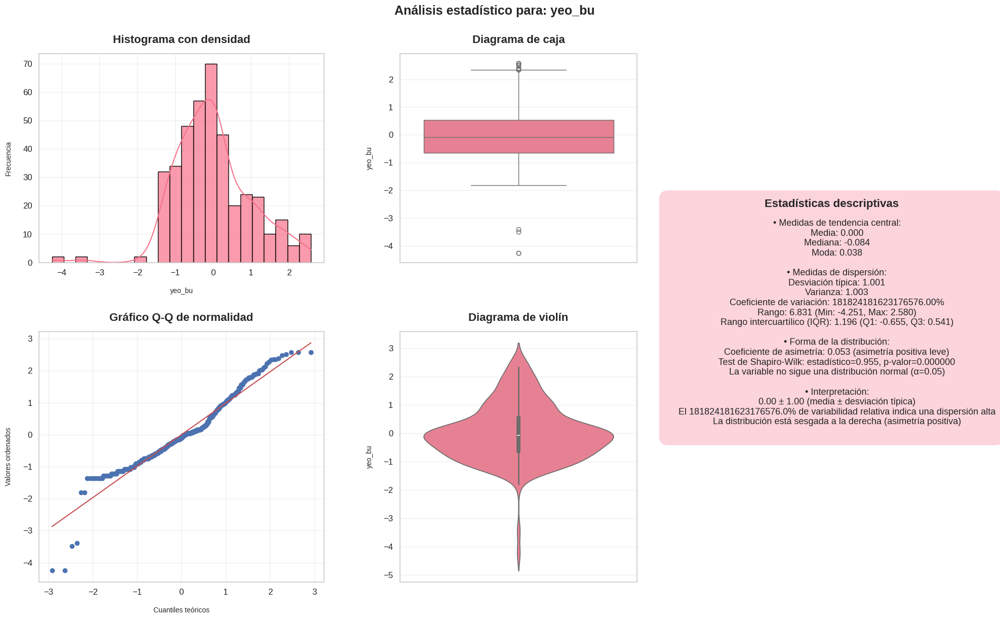

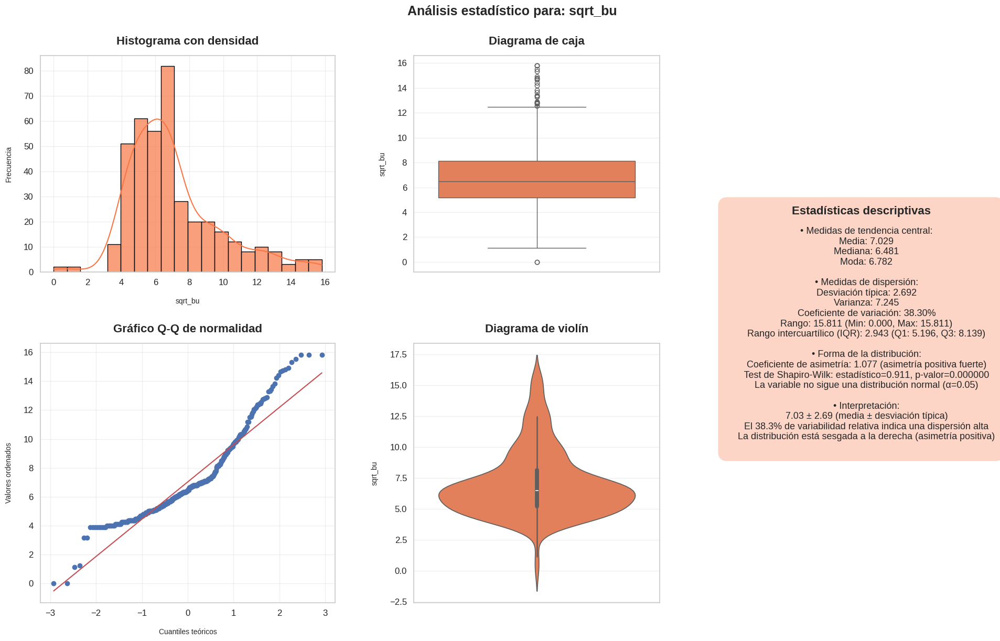

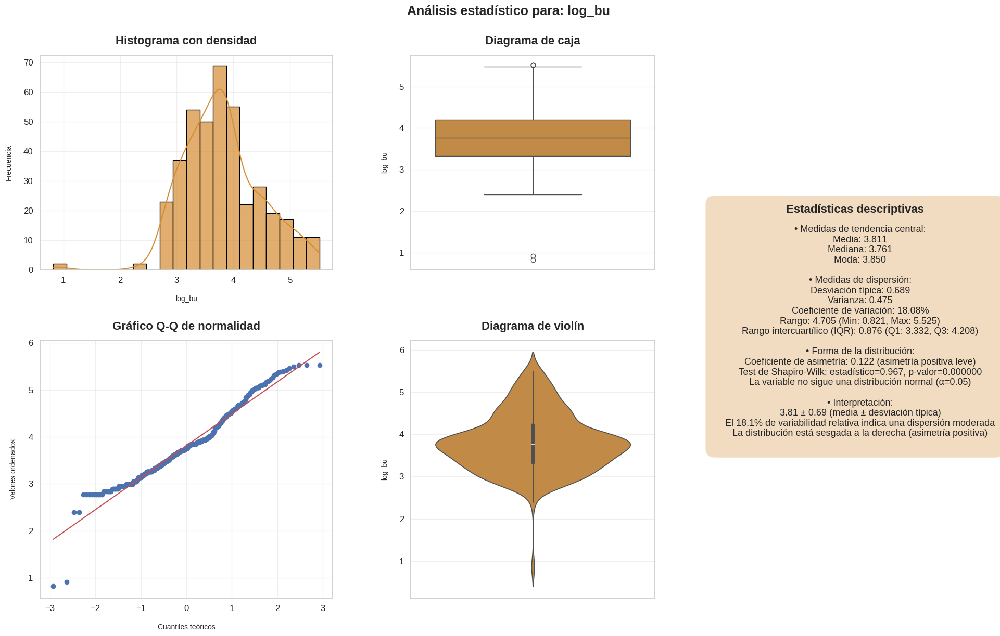

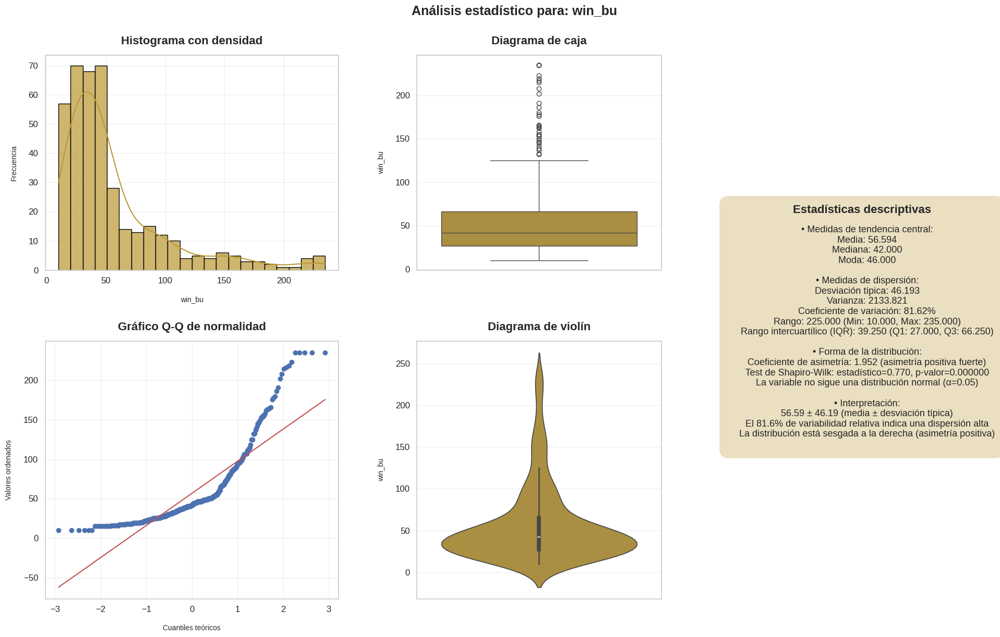

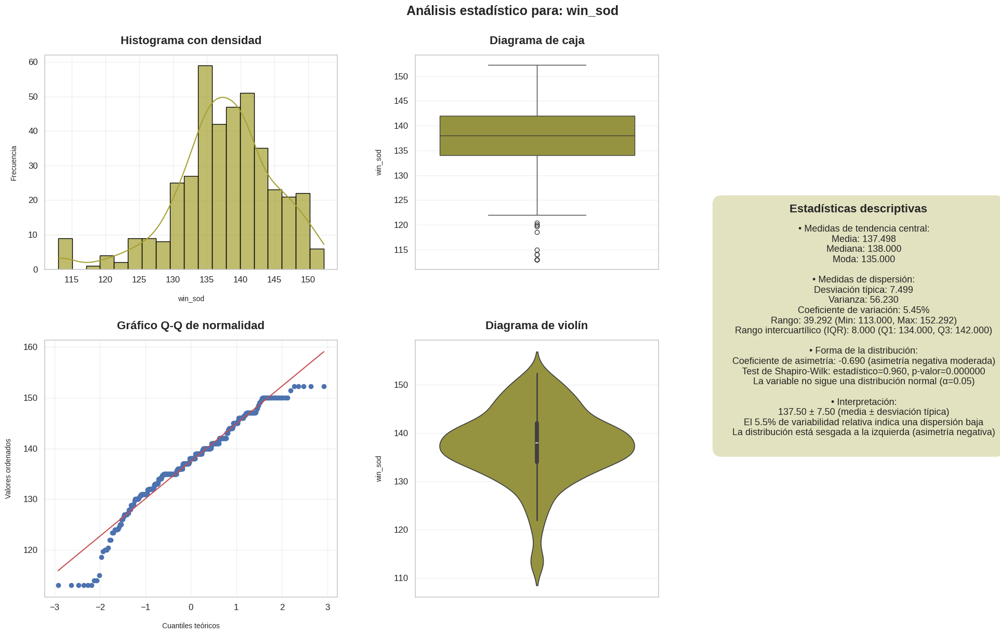

...

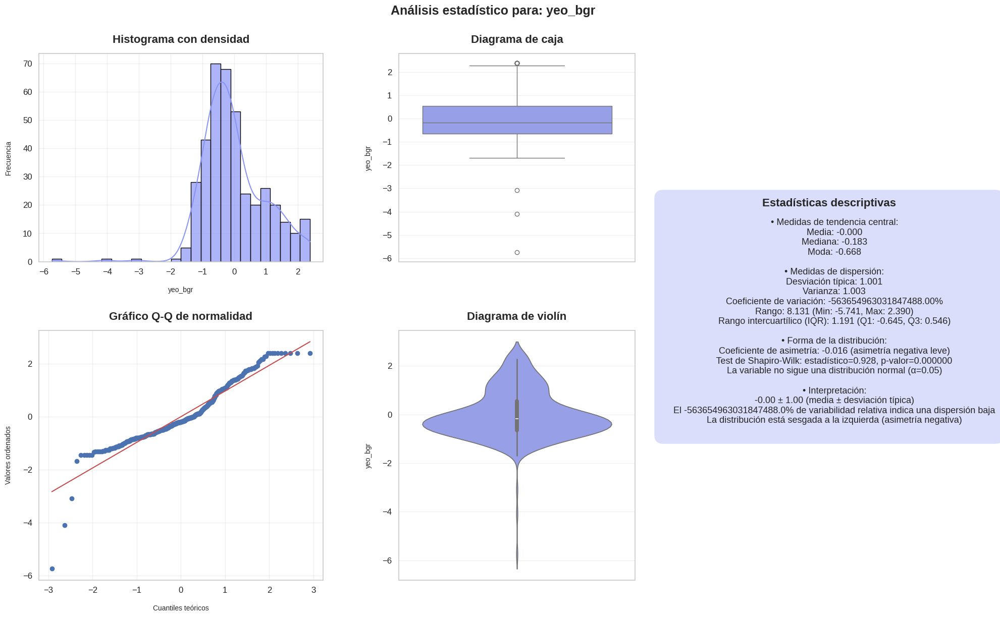

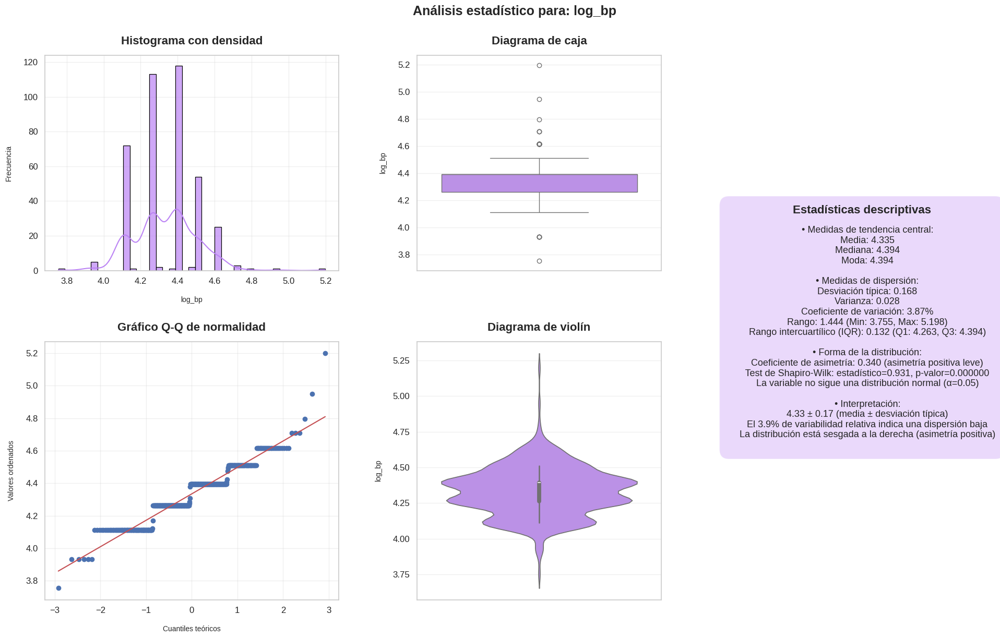

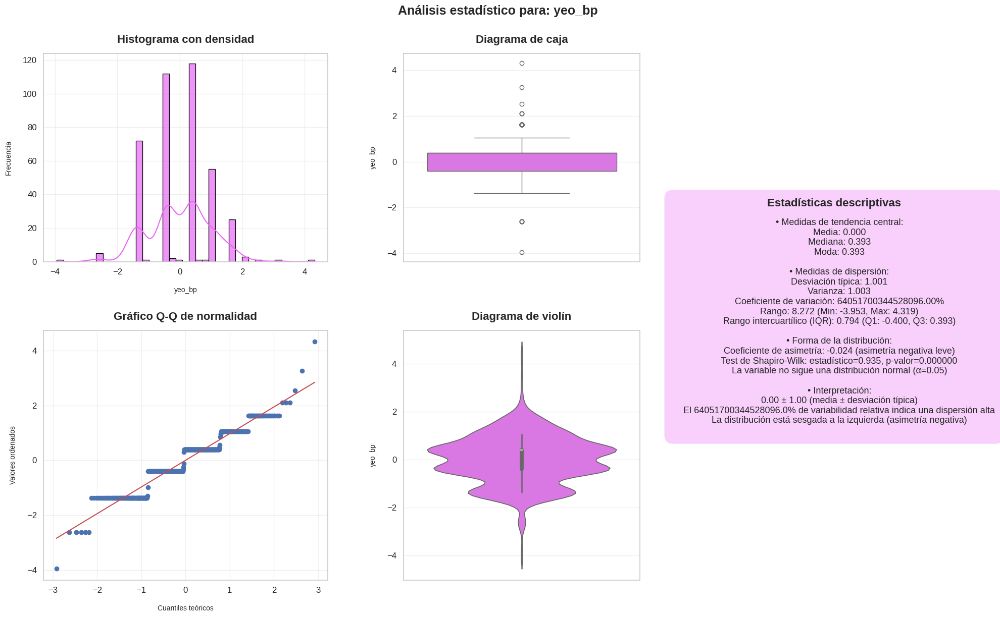

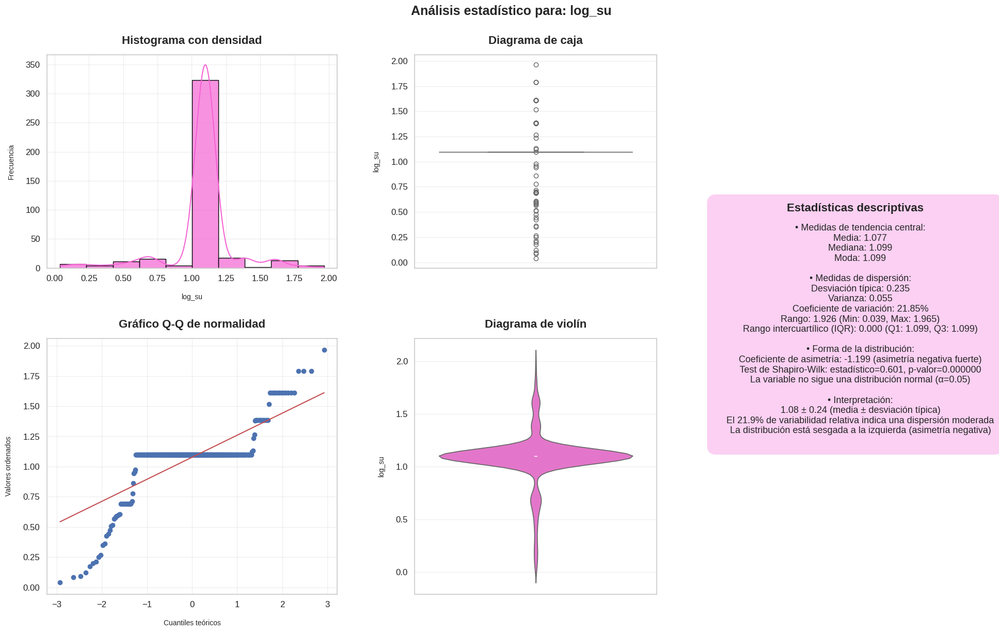

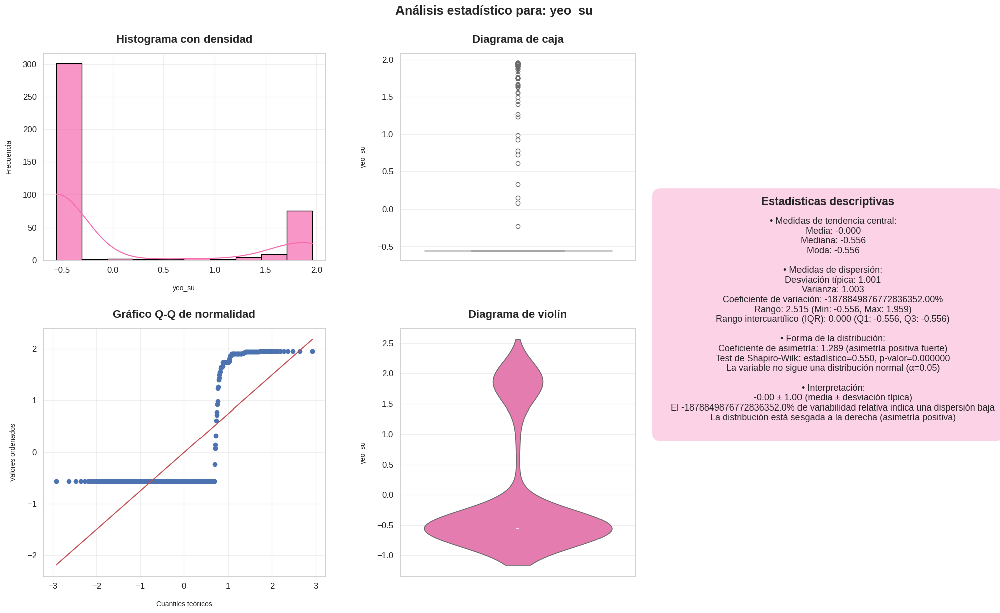



🔹 Resumen de estadísticas para todas las variables:



,Variable,Media,Mediana,Desv. Típica,CV (%),Asimetría,P-valor Shapiro,Normal
0,yeo_bu,0.000,-0.084,1.001,181824181623176576.000,0.053,0.000,False
1,sqrt_bu,7.029,6.481,2.692,38.295,1.077,0.000,False
2,log_bu,3.811,3.761,0.689,18.077,0.122,0.000,False
3,win_bu,56.594,42.000,46.193,81.623,1.952,0.000,False
4,win_sod,137.498,138.000,7.499,5.454,-0.690,0.000,False
5,yeo_sod,0.000,-0.021,1.001,140913740757961792.000,0.105,0.000,False
6,log_sc,1.099,0.833,0.636,57.903,1.271,0.000,False
7,yeo_sc,-0.000,-0.246,1.001,-2818274815159233024.000,0.152,0.000,False
8,win_pot,4.407,4.300,1.581,35.877,0.638,0.000,False
9,yeo_pot,-0.000,-0.026,1.001,-2049654411024897280.000,0.352,0.000,False



Tiempo de ejecución: 17.03 segundos


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import skew, shapiro, probplot
import matplotlib.gridspec as gridspec
import time

# Medir tiempo de ejecución
start_time = time.time()

# Lista de variables para analizar
variables = ['yeo_bu', 'sqrt_bu', 'log_bu', 'win_bu', 'win_sod', 'yeo_sod', 'log_sc', 'yeo_sc', 'win_pot', 'yeo_pot', 'sqrt_wc', 'yeo_wc', 'log_bgr', 'yeo_bgr', 'log_bp', 'yeo_bp', 'log_su', 'yeo_su']

# Diccionario para nombres completos de variables
variable_names = {
    'bu': 'Urea en sangre',
    'sod': 'Niveles de sodio',
    'sc': 'Creatinina sérica',
    'pot': 'Niveles de potasio',
    'wc': 'Recuento de glóbulos blancos',
    'bgr': 'Glucosa en sangre aleatoria',
    'bp': 'Tensión arterial',
    'su': 'Niveles de azucar en sangre'
}

# Paleta de colores para los gráficos
palette = sns.color_palette("husl", len(variables))
colors = dict(zip(variables, palette))

# Calcular todas las estadísticas
stats = calculate_statistics(df_transformado, variables)

# Configurar estilo general
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_context("notebook", font_scale=1.1)

# Crear un informe para cada variable
for i, variable in enumerate(variables):
    var_stats = stats[variable]
    var_name = variable_names.get(variable, variable)

    # Crear figura con layout optimizado
    fig = plt.figure(figsize=(20, 12))
    gs = gridspec.GridSpec(2, 3, width_ratios=[1.2, 1, 1], height_ratios=[1, 1.2], wspace=0.3, hspace=0.3,
                           left=0.05, right=0.95, bottom=0.05, top=0.92)

    # Título principal
    plt.suptitle(f'Análisis estadístico para: {var_name}', fontsize=18, fontweight='bold', y=1)

    # 1. Histograma con KDE
    ax1 = plt.subplot(gs[0, 0])
    sns.histplot(df_transformado[variable], kde=True, color=colors[variable],
                 bins='auto', edgecolor='black', alpha=0.7, ax=ax1)
    ax1.set_title('Histograma con densidad', fontsize=16, fontweight='bold', pad=15)
    ax1.set_xlabel(var_name, fontsize=10, labelpad=15)
    ax1.set_ylabel('Frecuencia', fontsize=10, labelpad=15)

    # 2. Boxplot
    ax2 = plt.subplot(gs[0, 1])
    sns.boxplot(y=df_transformado[variable], color=colors[variable], ax=ax2)
    ax2.set_title('Diagrama de caja', fontsize=16, fontweight='bold', pad=15)
    ax2.set_ylabel(var_name, fontsize=10, labelpad=15)

    # 3. Q-Q Plot
    ax3 = plt.subplot(gs[1, 0])
    probplot(df_transformado[variable], dist="norm", plot=ax3)
    ax3.set_title('Gráfico Q-Q de normalidad', fontsize=16, fontweight='bold', pad=15)
    ax3.set_xlabel('Cuantiles teóricos', fontsize=10, labelpad=15)
    ax3.set_ylabel('Valores ordenados', fontsize=10, labelpad=15)

    # 4. Violin plot
    ax4 = plt.subplot(gs[1, 1])
    sns.violinplot(y=df_transformado[variable], color=colors[variable], ax=ax4)
    ax4.set_title('Diagrama de violín', fontsize=16, fontweight='bold', pad=15)
    ax4.set_ylabel(var_name, fontsize=10, labelpad=15)

    # 5. Estadísticas descriptivas
    ax5 = plt.subplot(gs[:, 2])
    ax5.axis('off')

    # Preparar texto con estadísticas e interpretaciones
    skew_interp = interpret_skewness(var_stats['asimetria'])
    normal_text = "sigue" if var_stats['normal'] else "no sigue"

    # Cuadro de texto con estadísticas
    stats_text = f"""

    • Medidas de tendencia central:
    Media: {var_stats['media']:.3f}
    Mediana: {var_stats['mediana']:.3f}
    Moda: {var_stats['moda']:.3f}

    • Medidas de dispersión:
    Desviación típica: {var_stats['desv_tipica']:.3f}
    Varianza: {var_stats['varianza']:.3f}
    Coeficiente de variación: {var_stats['cv']:.2f}%
    Rango: {var_stats['rango']:.3f} (Min: {var_stats['min']:.3f}, Max: {var_stats['max']:.3f})
    Rango intercuartílico (IQR): {var_stats['iqr']:.3f} (Q1: {var_stats['q1']:.3f}, Q3: {var_stats['q3']:.3f})

    • Forma de la distribución:
    Coeficiente de asimetría: {var_stats['asimetria']:.3f} ({skew_interp})
    Test de Shapiro-Wilk: estadístico={var_stats['shapiro_stat']:.3f}, p-valor={var_stats['shapiro_p']:.6f}
    La variable {normal_text} una distribución normal (α=0.05)

    • Interpretación:
    {var_stats['media']:.2f} ± {var_stats['desv_tipica']:.2f} (media ± desviación típica)
    El {var_stats['cv']:.1f}% de variabilidad relativa indica una dispersión {"alta" if var_stats['cv'] > 30 else "moderada" if var_stats['cv'] > 15 else "baja"}
    La distribución está {"sesgada a la derecha (asimetría positiva)" if var_stats['asimetria'] > 0 else "sesgada a la izquierda (asimetría negativa)" if var_stats['asimetria'] < 0 else "aproximadamente simétrica"}
    """

    # Colocar el texto en el centro del área disponible
    ax5.text(0.5, 0.5, stats_text, transform=ax5.transAxes,
             fontsize=13, verticalalignment='center', horizontalalignment='center',
             bbox=dict(boxstyle='round,pad=1', facecolor=colors[variable], alpha=0.3))

    ax5.text(0.5, 0.71, 'Estadísticas descriptivas', fontsize=16, fontweight='bold',
             horizontalalignment='center', transform=ax5.transAxes)

    fig.subplots_adjust()
    plt.show()
    print("\n")


# Crear una tabla resumen con todas las estadísticas
summary_skew_data = {
    'Variable': [variable_names.get(var, var) for var in variables],
    'Media': [stats[var]['media'] for var in variables],
    'Mediana': [stats[var]['mediana'] for var in variables],
    'Desv. Típica': [stats[var]['desv_tipica'] for var in variables],
    'CV (%)': [stats[var]['cv'] for var in variables],
    'Asimetría': [stats[var]['asimetria'] for var in variables],
    'P-valor Shapiro': [stats[var]['shapiro_p'] for var in variables],
    'Normal': [stats[var]['normal'] for var in variables]
}

summary_skew_df = pd.DataFrame(summary_skew_data)
print("🔹 Resumen de estadísticas para todas las variables:\n")
summary_skew_df_styled = summary_skew_df.style.format({
    'Media': '{:.3f}',
    'Mediana': '{:.3f}',
    'Desv. Típica': '{:.3f}',
    'CV (%)': '{:.3f}',
    'Asimetría': '{:.3f}',
    'P-valor Shapiro': '{:.3f}'
})

# Aplicar estilos a la tabla
styled_table7 = summary_skew_df_styled.set_properties(**{
    'text-align': 'center',
    'border': '1px solid #000000',
    'background-color': '#ffffff',
    'color': '#000000',
})

styled_table7 = styled_table7.set_table_styles([
    {'selector': 'th', 'props': [
      ('background-color', '#457b9d'),
      ('color', 'white'),
      ('font-weight', 'bold'),
      ('text-align', 'center'),
      ('padding', '10px'),
      ('border', '1px solid #000000')
    ]},
])

# Mostrar la tabla estilizada
display(styled_table7)

# Medir y mostrar tiempo de ejecución
execution_time_skew = time.time() - start_time
print(f"\nTiempo de ejecución: {execution_time_skew:.2f} segundos")

Gracias al análisis visual y numérico de las variables transformadas podemos observar que, aunque una transformación pueda parecer la más adecuada en función de la mejora en la asimetría (skewness), no necesariamente es la mejor opción desde una perspectiva estadística o de interpretación del modelo.

Para ejemplificarlo, vamos a realizar una evaluación exhaustiva de las diferentes transformaciones aplicadas a nuestra variable objetivo "bu":

1. Distribución original (`bu`): presenta una distribución positivamente sesgada (asimetría hacia la derecha), lo que es común en variables biomédicas como niveles de urea, donde existen valores máximos atípicamente altos debido a condiciones clínicas severas, como la insuficiencia renal.

2. Transformación logarítmica (`log_bu`): reduce la amplitud de los valores altos y comprime la escala hacia los valores inferiores, lo cual disminuye notablemente el sesgo positivo.
    *   Visualmente, la distribución aparece más simétrica, pero ha generado una asimetría inversa (ligeramente negativa).
    *   Este efecto inverso afectó negativamente la distribución de los residuos, generando heterocedasticidad en los modelos.

3. Raíz cuadrada (`sqrt_bu`): suaviza los valores extremos (reduce el sesgo) sin comprimir excesivamente la distribución, ofreciendo un equilibrio óptimo.
    *   Reduce la influencia de valores atípicos extremos sin alterar drásticamente los valores originales.
    *   La distribución resultante es más simétrica, con colas menos pesadas y valores extremos suavizados, pero no eliminados.
    *   El gráfico Q-Q muestra una alineación razonablemente buena, y el boxplot refleja una reducción efectiva de los valores atípicos sin necesidad de truncamiento.
    *   No se introducen valores negativos ni se altera la interpretación clínica de los datos.

4. Winsorización (`win_bu`): esta transformación no logra mejorar la simetría de manera sino que incluso la aumenta.
    *   Se observa que los valores extremos han sido recortados artificialmente, lo que resulta en una distribución más compacta pero menos representativa de la variabilidad real.
    *   El boxplot muestra una reducción de los valores atípicos, pero esta simplificación conlleva la pérdida de información clínica potencialmente relevante.

5. Transformación Yeo-Johnson (`yeo_bu`): fue la más eficaz reduciendo la asimetría, logrando una curva visualmente más simétrica y con mejor alineación en el gráfico Q-Q.
    *   Sin embargo, introduce valores negativos en el resultado transformado, lo que puede ser problemático desde el punto de vista clínico, ya que la urea en sangre no puede ser negativa ni tener un significado en ese rango.
    *   Además, mostró una dispersión anormalmente alta, lo cual puede amplificar la varianza de los errores y afectar la estabilidad del modelo.
    *   Si bien la normalidad se mejora estadísticamente, pierde sentido práctico e interpretativo, comprometiendo la utilidad de esta transformación.

En resumen, aunque los indicadores de asimetría son un buen punto de partida, la elección de la mejor transformación debe basarse en un enfoque integral, considerando tanto el ajuste estadístico como la interpretación clínica y el impacto en el modelo. En este caso, la transformación por raíz cuadrada fue la que ofreció el mejor compromiso entre simplicidad, interpretabilidad y mejora estadística.

Observando los diferentes resultados del resto de variables, podemos concluir que aunque la transformación Yeo-Johnson ha demostrado ser una de las más eficaces a la hora de corregir la asimetría de las variables, genera valores negativos en los registros.

Este comportamiento es problemático en nuestro caso, ya que:
*   Desde el punto de vista biológico, no es posible tener una concentración negativa/volumen/etc., ya que se tratan de medidas que por definición deben ser igual o mayor a cero, y su aparición en valores negativos carece de sentido clínico.
*   La introducción de estos valores compromete la interpretación de los resultados y puede inducir errores si se utilizan en análisis posteriores o si se comunican sin un contexto estadístico claro.
*   Puede afectar el rendimiento del modelo predictivo, ya que algunos algoritmos pueden verse influenciados por la aparición de valores fuera del rango esperado.

# 4. Modelos de regresión

### 4.1. Codificación de variables categóricas

Después de haber trabajado en profundidad con las variables numéricas, ahora nos enfocamos en las variables categóricas, que también deben estar adecuadamente representadas para ser utilizadas en nuestro modelo de regresión.

Los modelos estadísticos tradicionales, como la regresión lineal, no pueden trabajar directamente con variables categóricas expresadas como texto o etiquetas. Por ello, es necesario codificarlas numéricamente. Una de las técnicas más utilizadas es la codificación mediante variables ficticias o dummies, que convierte cada categoría en una nueva columna binaria (0 o 1), indicando la presencia o ausencia de esa categoría en cada observación.

En este paso, realizaremos dos versiones de codificación one-hot para nuestras variables categóricas:
*   Una versión que mantiene todas las categorías.
*   Otra versión que elimina una categoría por variable para evitar colinealidad perfecta (trampa de las variables ficticias). Esto ocurre porque, cuando una variable categórica tiene k categorías y generamos k columnas dummy, se introduce una relación lineal perfecta entre ellas: una columna se puede reconstruir a partir de las demás, lo que viola los supuestos de independencia lineal del modelo.

El segundo enfoque comienza generando dummies para todas las categorías (usando `drop_first=False`), y luego elimina manualmente la última categoría alfabéticamente de cada variable categórica.

Aunque podríamos haber utilizado directamente `pd.get_dummies(..., drop_first=True)` para evitar esta colinealidad, hemos optado por hacerlo manualmente por las siguientes razones:
*   Nos da más control sobre qué categoría eliminar como referencia. En este caso queríamos preservar la variable `classification_ckd`
*   Evitamos posibles errores en el orden interno de las categorías cuando no están correctamente organizadas.
*   Nos permite inspeccionar los nombres completos de las dummies antes de eliminarlas, lo que puede ser útil para tener documentación.

Además, hemos decidido eliminar las variables transformadas mediante la técnica de Yeo-Johnson, ya que introducían valores negativos en variables cuyo dominio natural es estrictamente positivo.

Esto resulta problemático ya que modelar con transformaciones que introducen valores fuera del rango esperado puede distorsionar la distribución real de los datos, dificultar la interpretación clínica y afectar la calidad de los modelos predictivos.

Así que hemos priorizado conservar las otras transformaciones ya que respetan la naturaleza positiva de las variables y, al mismo tiempo, contribuyen a mejorar la simetría y a reducir la influencia de valores atípicos.

In [ ]:
import pandas as pd
import numpy as np

# Separar columnas numéricas y categóricas
numeric_cols_re = df_transformado.select_dtypes(include=[np.number]).columns.tolist()
numeric_cols_re.remove('bu')

# Eliminar columnas transformadas con Yeo-Johnson (ya que contienen valores negativos y no nos interesan)
yeo_cols = [col for col in numeric_cols_re if col.startswith('yeo_')]
for col in yeo_cols:
    if col in numeric_cols_re:
        numeric_cols_re.remove(col)

categorical_cols_re = df_transformado.select_dtypes(include=['object', 'category']).columns.tolist()

# 1. Versión con todo dummies
dummies_all = pd.get_dummies(df_transformado[categorical_cols_re], drop_first=False)
combined_kidney_df_all = pd.concat([
    df_transformado[numeric_cols_re],
    dummies_all,
    df_transformado[['bu']]
], axis=1)

# 2. Versión que elimina la última categoría alfabéticamente
dummies_drop_last = pd.get_dummies(df_transformado[categorical_cols_re], drop_first=False)

# Eliminar la última categoría alfabéticamente para cada columna categórica
dummies_drop_last.drop(
    columns=[f"{col}_{sorted(df_transformado[col].dropna().unique())[-1]}" for col in categorical_cols_re],
    inplace=True
)

combined_kidney_df = pd.concat([
    df_transformado[numeric_cols_re],
    dummies_drop_last,
    df_transformado[['bu']]
], axis=1)

### 4.2. Análisis de correlación con la variable objetivo

Tras completar la transformación de las variables numéricas y la codificación de las variables categóricas mediante one-hot encoding, estamos en condiciones de realizar un análisis más exhaustivo de las relaciones lineales entre todas las variables del conjunto de datos.

Para ello, lo primero que hemos decidido es emplear un mapa de calor (`heatmap`) de la matriz de correlaciones, que permite visualizar de forma intuitiva la intensidad y dirección de las relaciones lineales entre pares de variables. Dicha matriz nos sirve para identificar:
*   Qué variables presentan una mayor o menor correlación lineal con la variable objetivo "bu" (urea en sangre).
*   Posibles relaciones colineales entre predictores, que podrían influir en el rendimiento de los modelos de regresión.
*   Variables redundantes o poco informativas desde la perspectiva del modelado.

Asimismo, eliminamos columnas de variables repetidas después de realizar las transformaciones.

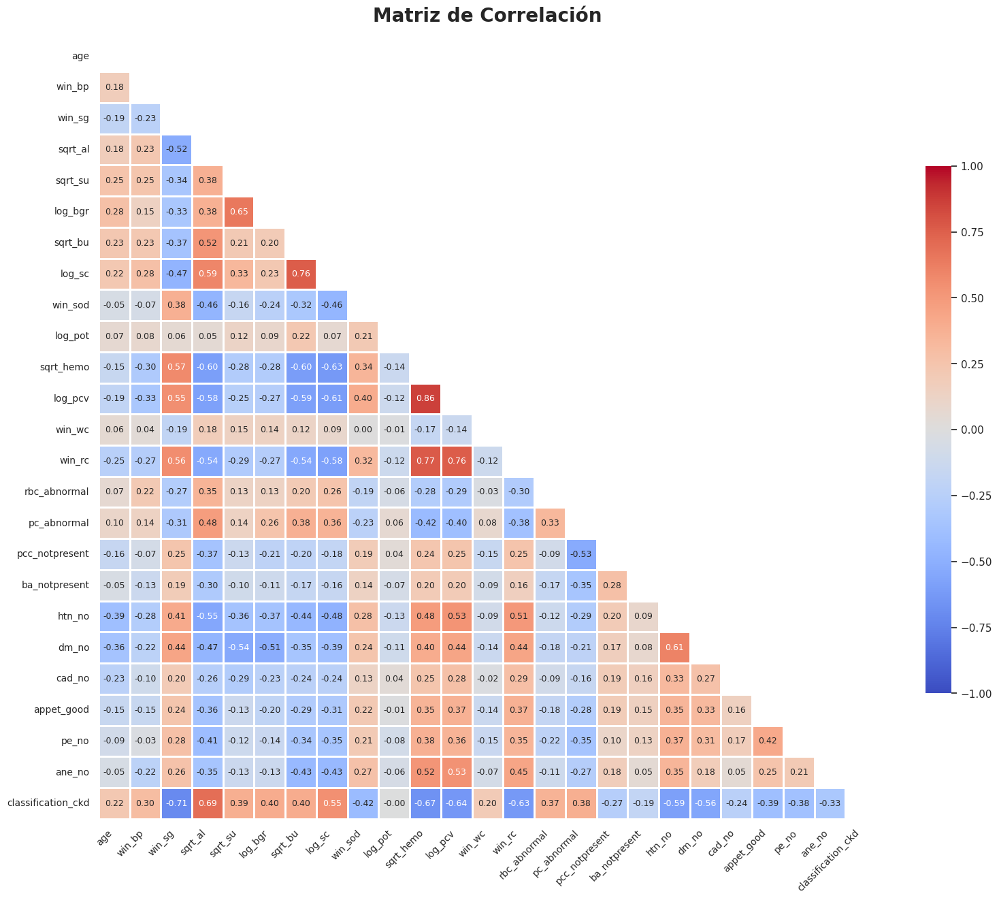

In [ ]:
# Eliminar columnas innecesarias
columnas_a_eliminar = ['log_bu', 'bu', 'win_bu', 'sqrt_sc', 'win_sc', 'sc', 'win_pcv', 'pcv', 'sqrt_pcv',
                       'hemo', 'win_hemo','log_hemo', 'log_rc', 'sqrt_rc', 'rc', 'al', 'win_al', 'log_sg', 'sqrt_sg',
                       'sg','log_age', 'win_age', 'sqrt_age', 'sod', 'sqrt_sod', 'su', 'win_su', 'log_sod', 'sqrt_sod',
                       'pot','win_pot','sqrt_pot','sqrt_bp', 'bp', 'log_al','win_bgr', 'wc', 'sqrt_wc', 'log_wc',
                       'bgr','sqrt_bgr', 'log_bp','log_su']

df_filtrado_1 = combined_kidney_df.drop(columns=columnas_a_eliminar, errors='ignore')

# Matriz de correlación
corr_matrix = df_filtrado_1.corr()

# Crear máscara para mostrar solo una mitad
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.set(style="white")

# Crear gráfico
plt.figure(figsize=(16, 14))
sns.heatmap(corr_matrix,
            mask=mask,
            cmap='coolwarm',
            vmax=1.0, vmin=-1.0,
            center=0,
            square=True,
            linewidths=0.8,
            cbar_kws={"shrink": .6},
            annot=True, fmt=".2f", annot_kws={"size": 9})

plt.title('Matriz de Correlación', fontsize=20, fontweight='bold', pad=20)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(rotation=0, fontsize=10)
plt.tight_layout()
plt.show()

Después de haber representado visualmente la matriz de correlaciones con un `heatmap`, hemos decidido complementar el análisis con una visión más enfocada y numérica de las relaciones entre la variable objetivo con la transformación deseada (`sqrt_bu`) y el resto de características del conjunto de datos.

Dicha transformación fue seleccionada previamente como la más adecuada para representar los niveles de urea en sangre debido a su comportamiento más estable, normalizado y menos influenciado por valores extremos.

Centrarnos en las correlaciones con la varible:
*   Nos permite detectar relaciones lineales fuertes, tanto positivas como negativas, con otras variables.
*   Sirve como criterio inicial para la selección de variables para nuestro modelo de regresión.
*   Nos ayuda a filtrar variables irrelevantes o redundantes que no aportan valor predictivo.
*   Es útil para entender el comportamiento clínico de la urea en sangre respecto a otras características del paciente.

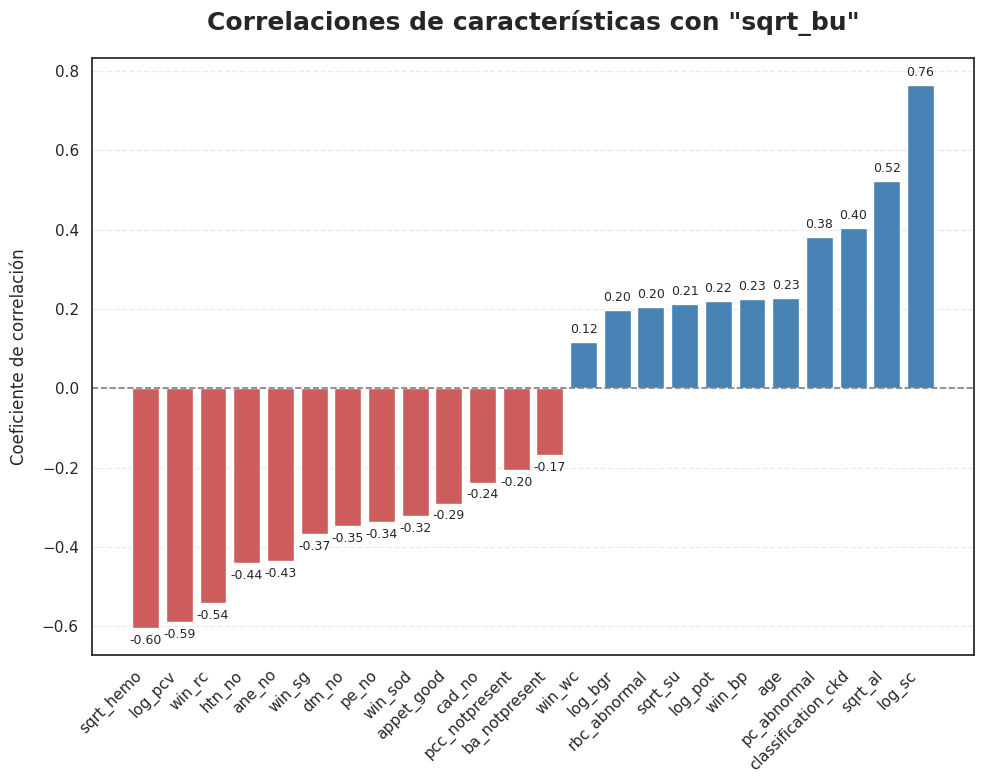


🔹 Top 15 características más correlacionadas con "sqrt_bu":
log_sc: 0.7647
sqrt_hemo: -0.6030
log_pcv: -0.5898
win_rc: -0.5415
sqrt_al: 0.5223
htn_no: -0.4397
ane_no: -0.4347
classification_ckd: 0.4045
pc_abnormal: 0.3812
win_sg: -0.3667
dm_no: -0.3480
pe_no: -0.3363
win_sod: -0.3229
appet_good: -0.2904
cad_no: -0.2374


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Eliminar variables redundantes y autocorrelaciones
columnas_excluir = ['sqrt_bu', 'log_bu', 'bu', 'win_bu', 'sqrt_sc', 'win_sc', 'sc', 'win_pcv', 'pcv', 'sqrt_pcv',
                    'hemo', 'win_hemo','log_hemo', 'log_rc', 'sqrt_rc', 'rc', 'al', 'win_al', 'log_sg', 'sqrt_sg',
                    'sg','log_age', 'win_age', 'sqrt_age', 'sod', 'sqrt_sod', 'su', 'win_su', 'log_sod', 'sqrt_sod',
                    'pot','win_pot','sqrt_pot','sqrt_bp', 'bp', 'log_al','win_bgr', 'wc', 'sqrt_wc', 'log_wc',
                    'bgr','sqrt_bgr', 'log_bp', 'log_su']

bu_correlations = corr_matrix['sqrt_bu'].drop(labels=columnas_excluir, errors='ignore').sort_values()

# Crear paleta de colores según signo
colors = bu_correlations.apply(lambda x: 'steelblue' if x > 0 else 'indianred')

# Plot
plt.figure(figsize=(10, 8))
bars = plt.bar(bu_correlations.index, bu_correlations.values, color=colors)

# Añadir etiquetas de valor
for bar in bars:
    height = bar.get_height()
    if abs(height) > 0.05:
        plt.text(bar.get_x() + bar.get_width()/2, height + 0.015*np.sign(height),
                 f'{height:.2f}', ha='center', va='bottom' if height > 0 else 'top', fontsize=9)

plt.title('Correlaciones de características con "sqrt_bu"', fontsize=18, fontweight='bold', pad=20)
plt.axhline(0, color='gray', linewidth=1.2, linestyle='--')
plt.ylabel('Coeficiente de correlación', labelpad=10)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.4)
plt.show()

# Mostrar correlaciones absolutas más fuertes
abs_correlations = bu_correlations.abs().sort_values(ascending=False)
top_10_correlated = abs_correlations.head(15)

print('\n🔹 Top 15 características más correlacionadas con "sqrt_bu":')
for feature, corr_value in zip(top_10_correlated.index, bu_correlations[top_10_correlated.index]):
    print(f"{feature}: {corr_value:.4f}")


### 4.3. Codificación final de variables categóricas booleanas

Una vez finalizado el proceso de transformación de variables numéricas y la creación de variables categóricas mediante codificación one-hot, es fundamental asegurarnos de que todas las variables del dataset estén correctamente representadas en un formato numérico compatible.

En esta sección, nos centraremos en detectar y transformar automáticamente aquellas variables categóricas o booleanas que, aunque ya estén en formato de texto o bool, representan valores lógicos (`'True'/'False'`, `True/False`) y que pueden ser fácilmente codificados como valores binarios.

Mapeamos 0 como `False` y 1 como `True`. Esta transformación:
*   Reduce el riesgo de errores durante la modelización.
*   Asegura que todas las variables puedan ser interpretadas numéricamente.
*   Mantiene la información de las variables lógicas de manera compacta y eficiente.

In [ ]:
def encode_categorical_variables(df):
    df_encoded = df.copy()
    # Convierte todas las cadenas booleanas o "Verdadero"/"Falso" a 0/1
    for col in df_encoded.select_dtypes(include=['object', 'bool', 'category']).columns:
        unique_vals = df_encoded[col].dropna().unique()
        if set(unique_vals).issubset({'True', 'False', True, False}):
            df_encoded[col] = df_encoded[col].astype(str).map({'False': 0, 'True': 1})
    return df_encoded

encoded_kidney_df = encode_categorical_variables(combined_kidney_df)

Para asegurarnos de que la codificación ha sido exitosa y que no se ha perdido información, vamos a realizar una serie de exploraciones básicas.

Lo primero que haremos es hacer una vista preliminar del DataFrame, esto nos permite:
*   Confirmar que las nuevas columnas booleanas ahora contienen exclusivamente valores 0 y 1.
*   Observar si los nombres de las variables se han mantenido correctamente.
*   Detectar rápidamente posibles errores de codificación.

In [ ]:
encoded_kidney_df.head(10)

,age,bp,sg,al,su,bgr,sc,sod,pot,hemo,...,pcc_notpresent,ba_notpresent,htn_no,dm_no,cad_no,appet_good,pe_no,ane_no,classification_ckd,bu
id,,,,,,,,,,,,,,,,,,,,,
0,48.00,80.00,1.02,1.00,0.00,121.00,1.20,147.09,9.19,15.40,...,1,1,0,0,1,1,1,1,1,36.00
1,7.00,50.00,1.02,4.00,0.00,301.94,0.80,126.95,7.66,11.30,...,1,1,1,1,1,1,1,1,1,18.00
2,62.00,80.00,1.01,2.00,3.00,400.00,1.80,128.82,1.49,9.60,...,1,1,1,0,1,0,1,0,1,53.00
3,48.00,70.00,1.00,4.00,0.00,117.00,3.80,111.00,2.50,11.20,...,0,1,0,1,1,0,0,0,1,56.00
4,51.00,80.00,1.01,2.00,0.00,106.00,1.40,131.93,0.39,11.60,...,1,1,1,1,1,1,1,1,1,26.00
5,60.00,90.00,1.01,3.00,0.00,74.00,1.10,142.00,3.20,12.20,...,1,1,0,0,1,1,0,1,1,25.00
6,68.00,70.00,1.01,0.00,0.00,100.00,20.00,104.00,4.00,12.40,...,1,1,1,1,1,1,1,1,1,54.00
7,24.00,81.02,1.01,2.00,4.00,400.00,1.10,137.13,8.25,12.40,...,1,1,1,0,1,1,0,1,1,31.00
8,52.00,100.00,1.01,3.00,0.00,138.00,1.90,135.53,3.03,10.80,...,0,1,0,0,1,1,1,0,1,60.00


Seguidamente observaremos sus estadísticas generales, que nos aporta información esencial como:
*   Número de valores no nulos por variable.
*   El rango de valores (min, max) en cada columna.
*   La media, desviación estándar y cuartiles, que nos ayudan a identificar columnas con poca variabilidad o valores extremos.

In [ ]:
encoded_kidney_df.describe()

,age,bp,sg,al,su,bgr,sc,sod,pot,hemo,...,pcc_notpresent,ba_notpresent,htn_no,dm_no,cad_no,appet_good,pe_no,ane_no,classification_ckd,bu
count,400.00,400.00,400.00,400.00,400.00,400.00,400.00,400.00,400.00,400.00,...,400.00,400.00,400.00,400.00,400.00,400.00,400.00,400.00,400.00,400.00
mean,51.35,76.39,1.02,1.13,0.50,148.93,2.87,137.45,4.43,12.52,...,0.90,0.94,0.63,0.66,0.92,0.80,0.81,0.85,0.62,56.63
std,17.08,13.67,0.01,1.37,1.12,75.50,3.68,7.98,1.71,2.92,...,0.31,0.23,0.48,0.48,0.28,0.40,0.39,0.36,0.48,46.81
min,2.00,41.73,1.00,0.00,0.00,10.63,0.00,100.00,0.00,0.59,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,42.00,70.00,1.01,0.00,0.00,100.00,0.90,134.00,3.70,10.40,...,1.00,1.00,0.00,0.00,1.00,1.00,1.00,1.00,0.00,27.00
50%,54.00,80.00,1.02,0.00,0.00,123.00,1.30,138.00,4.30,12.70,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,42.00
75%,64.00,80.00,1.02,2.00,0.00,171.00,2.90,142.00,5.00,14.90,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,66.25
max,90.00,180.00,1.03,5.00,6.14,400.00,20.00,163.00,15.00,17.80,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,250.00


Finalmente, lo que haremos es trabajar con una de las variables categóricas más importantes del conjunto de datos, `classification_ckd`. Esta columna representa la presencia o ausencia de enfermedad renal crónica (Chronic Kidney Disease, CKD).

El siguiente código nos permite observar si la variable se encuentra correctamente representada en formato binario (0 y 1), sin errores de codificación.

In [ ]:
encoded_kidney_df['classification_ckd']

,classification_ckd
id,
0,1
1,1
2,1
3,1
4,1
...,...
395,0
396,0
397,0


#### Relación entre variable target `sqrt_bu` y la variable categórica `classifcation_ckd`

Para profundizar en la relación entre los niveles de urea en sangre y la presencia de enfermedad renal crónica (ERC), hemos decido relaizar un análisis visual utilizando la versión transformada de la variable objetivo (`sqrt_bu`).

A continuación, se representa la distribución de `sqrt_bu` para dos grupos de pacientes: aquellos con diagnóstico de ERC (`classification_ckd = 1`) y aquellos sin la enfermedad (`classification_ckd = 0`). Esta visualización permite evaluar si existen diferencias significativas en los niveles de urea entre ambos grupos.

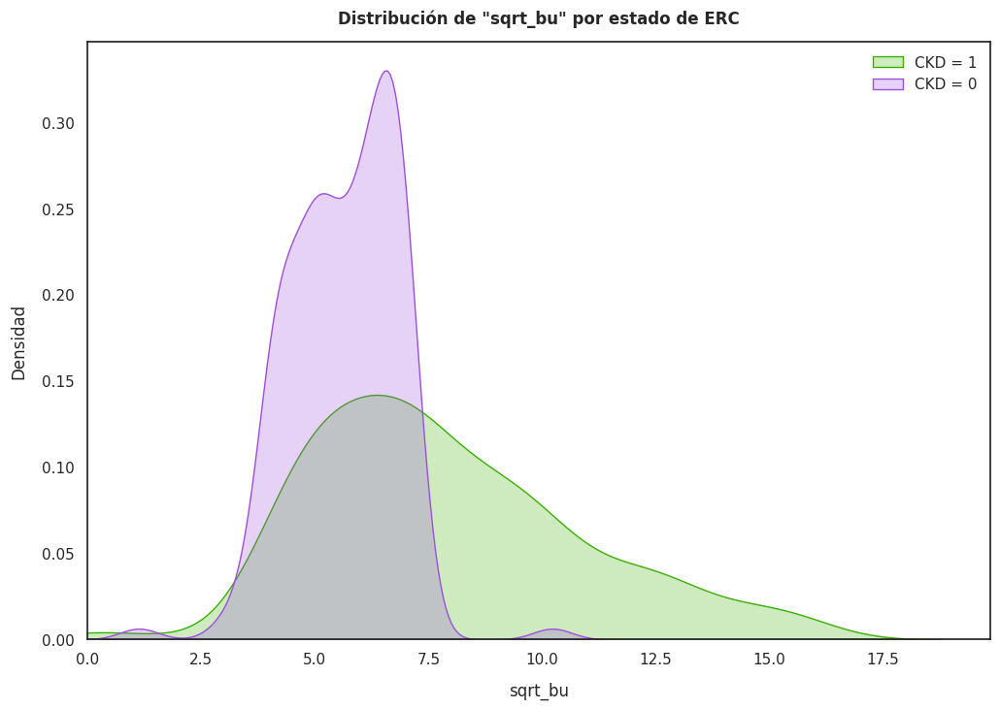

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.kdeplot(encoded_kidney_df[encoded_kidney_df['classification_ckd'] == 1]['sqrt_bu'], label='CKD = 1', fill=True,  color='#38b000')
sns.kdeplot(encoded_kidney_df[encoded_kidney_df['classification_ckd'] == 0]['sqrt_bu'], label='CKD = 0', fill=True,  color='#9d4edd')

plt.xlabel('sqrt_bu',labelpad=11)
plt.ylabel('Densidad', labelpad=11)
plt.title('Distribución de "sqrt_bu" por estado de ERC', pad=14)
plt.legend()
plt.xlim(0)
plt.show()


Alguna observaciones clave del gráfico que hemos obtenido son:
*   Desplazamiento de las distribuciones: la distribución correspondiente al grupo sin ERC (CKD = 0) se concentra principalmente en valores de `sqrt_bu` entre aproximadamente 4.5 y 8, con un claro pico alrededor de 6.5. En contraste, la distribución de pacientes con ERC (CKD = 1) está desplazada hacia la derecha, mostrando una mayor dispersión y una cola alargada que se extiende hasta valores cercanos a 18. Esto indica niveles significativamente más elevados de urea transformada en este grupo.
*   Superposición parcial: aunque existe una zona de superposición entre ambas curvas (principalmente entre valores de `sqrt_bu` de 5 a 8), el grupo con ERC tiende a presentar valores más elevados de manera consistente, lo que sugiere una clara diferencia entre los dos grupos.
*   Simetría y forma: la distribución del grupo sin ERC parece relativamente simétrica, mientras que la del grupo con ERC presenta una asimetría positiva marcada (cola derecha), lo que es coherente con los casos clínicos de insuficiencia renal, donde los niveles de urea pueden aumentar considerablemente.

Este análisis confirma que la variable `sqrt_bu` posee un alto valor discriminativo en relación con el diagnóstico de ERC. Sin embargo, la presencia de pacientes enfermos en todo el espectro de valores refuerza la necesidad de utilizar este biomarcador en combinación con otros indicadores para una evaluación más precisa.

## 5. Regresión linear


### 5.1. Análisis de regresión con variables numéricas

Como primer acercamiento al modelado predictivo, hemos optado por construir un modelo de regresión lineal simple empleando exclusivamente variables numéricas transformadas como predictores. Esta elección responde a varios objetivos:
*   Evaluar la relación lineal directa entre las variables cuantitativas y la variable dependiente (`sqrt_bu`), sin añadir la complejidad del tratamiento de variables categóricas.
*   Establecer una línea base de rendimiento que permita comparar modelos más complejos en fases posteriores del análisis.
*   Explorar el comportamiento del modelo desde el punto de vista estadístico: coeficientes, residuos, distribución de errores, normalidad, entre otros.

Para la preparación del modelo hemos seleccionaron un conjunto de predictores numéricos transformados, los cuales habían mostrado correlación significativa con la variable objetivo en los análisis anteriores. Hemos elegido `sqrt_bu` como variable objetivo y divido los datos en conjunto de entrenamiento (80%) y prueba (20%).

El modelo fue entrenado usando `LinearRegression` de `Scikit-Learn`, y además se utilizó `statsmodels` para evaluar la significación estadística de los coeficientes.

El análisis posterior al entrenamiento incluyó una evaluación exhaustiva a través de diversos gráficos y métricas:
*   Gráfico de valores reales vs. predichos, para evaluar visualmente el ajuste del modelo.
*   Distribución de los residuales, para analizar su simetría y cercanía a una distribución normal.
*   Gráfico de residuales vs. predichos, que permite identificar patrones que podrían indicar relaciones no lineales no capturadas por el modelo.
*   Q-Q Plot, que evalúa si los errores se distribuyen de forma aproximadamente normal.
*   Gráfico de coeficientes, que muestra la influencia (positiva o negativa) de cada predictor en la variable objetivo.
*   Relación entre residuales y las dos variables más influyentes, que ayuda a detectar efectos no lineales o heterocedasticidad.
*   Tabla resumen de métricas, que incluye:
    *   Error cuadrático medio (MSE).
    *   Raíz del error cuadrático medio (RMSE).
    *   Coeficiente de determinación R².
    *   Tamaño de muestra de prueba.

Los predictores han sido seleccionados en función de su nivel de correlación con la variable objetivo `sqrt_bu`, así como por tener un valor de p menor a 0.05

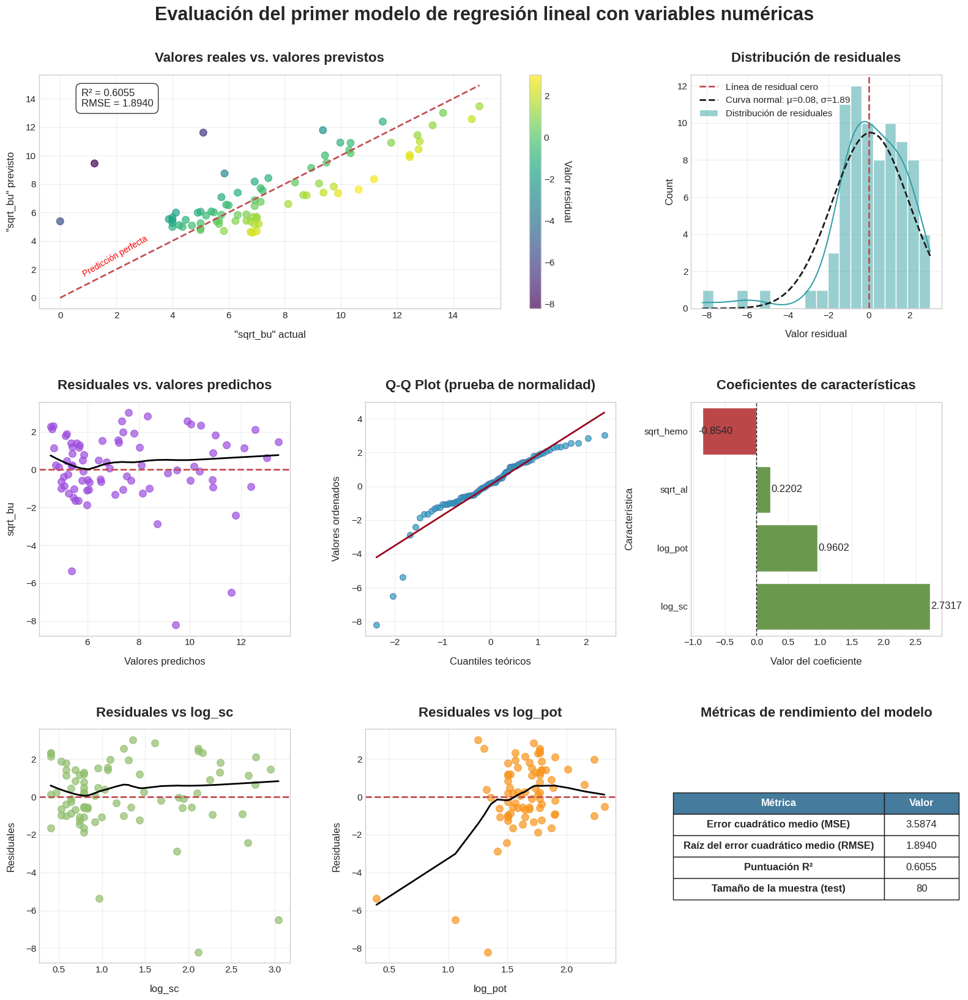

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import statsmodels.api as sm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec
from scipy import stats

numeric_predictors = ['log_sc',  'sqrt_al', 'log_pot', 'sqrt_hemo']


df_model = encoded_kidney_df.copy()
X = df_model[numeric_predictors]
y = df_model["sqrt_bu"]

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Entrenar el modelo de regresión lineal
model = LinearRegression()
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)
y_train_pred = model.predict(X_train)

# Evaluar el modelo
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Coeficientes del modelo
coefficients = pd.DataFrame({
    'Feature': X.columns,
    'Coefficient': model.coef_
})
coefficients = coefficients.sort_values('Coefficient', ascending=False)

# Significación estadística con statsmodels
X_train_sm = sm.add_constant(X_train)
sm_model = sm.OLS(y_train, X_train_sm).fit()

# Calcular residuos
residuals = y_test - y_pred
residuals_train = y_train - y_train_pred

# Establecer el estilo para todos los gráficos
plt.style.use('seaborn-v0_8-whitegrid')

# Create figure with GridSpec for control over subplot layout
fig = plt.figure(figsize=(16, 16))
gs = GridSpec(3, 3)

# 1. Plot real vs. predicha
ax1 = plt.subplot(gs[0, :2])
scatter = ax1.scatter(y_test, y_pred, alpha=0.7, c=residuals, cmap='viridis', s=70)
min_val = min(y_test.min(), y_pred.min())
max_val = max(y_test.max(), y_pred.max())
ax1.plot([min_val, max_val], [min_val, max_val], 'r--', linewidth=2)
ax1.set_xlabel('"sqrt_bu" actual', fontsize=12, labelpad=12)
ax1.set_ylabel('"sqrt_bu" previsto', fontsize=12, labelpad=12)
ax1.set_title('Valores reales vs. valores previstos', fontsize=16, fontweight='bold', pad=15)

# Agregar etiqueta de línea de predicción perfecta
ax1.text(min_val + 0.05 * (max_val - min_val),
         min_val + 0.1 * (max_val - min_val),
         'Predicción perfecta',
         color='red', fontsize=10, rotation=30)

# Añadir anotación R² con borde negro
ax1.text(min_val + 0.05 * (max_val - min_val),
         min_val + 0.9 * (max_val - min_val),
         f'R² = {r2:.4f}\nRMSE = {rmse:.4f}',
         bbox=dict(facecolor='white', alpha=0.8, boxstyle='round,pad=0.5', edgecolor='black'),
         fontsize=12)

# Agregar barra de colores para mostrar la magnitud residual
cbar = plt.colorbar(scatter, ax=ax1)
cbar.set_label('Valor residual', rotation=270, labelpad=20)

# 2. Distribución de residuales
ax2 = plt.subplot(gs[0, 2])
sns.histplot(residuals, kde=True, color='#34a0a4', ax=ax2, bins=20, label='Distribución de residuales')
ax2.axvline(x=0, color='r', linestyle='--', linewidth=2, label='Línea de residual cero')

# Añadir curva de ajuste normal
x = np.linspace(min(residuals), max(residuals), 100)
mu, std = stats.norm.fit(residuals)
p = stats.norm.pdf(x, mu, std)
ax2.plot(x, p * (len(residuals) * (max(residuals) - min(residuals)) / 20),
         'k--', linewidth=2, label=f'Curva normal: μ={mu:.2f}, σ={std:.2f}')

ax2.set_title('Distribución de residuales', fontsize=16, fontweight='bold', pad=15)
ax2.set_xlabel('Valor residual', fontsize=12, labelpad=12)
ax2.legend(loc='upper left', fontsize=11)

# 3. Residuales vs predichos
ax3 = plt.subplot(gs[1, 0])
ax3.scatter(y_pred, residuals, alpha=0.7, color='#9d4edd', s=70)
ax3.axhline(y=0, color='r', linestyle='--', linewidth=2)
ax3.set_xlabel('Valores predichos', fontsize=12, labelpad=12)
ax3.set_ylabel('Residuales', fontsize=12, labelpad=12)
ax3.set_title('Residuales vs. valores predichos', fontsize=16, fontweight='bold', pad=15)

# Agregar una línea de tendencia suavizada para detectar patrones
sns.regplot(x=y_pred, y=residuals, scatter=False,
            lowess=True, line_kws={'color': 'black', 'lw': 2}, ax=ax3)

# 4. Q-Q Plot
ax4 = plt.subplot(gs[1, 1])
qq = stats.probplot(residuals, dist="norm", plot=ax4)
ax4.set_title('Q-Q Plot (prueba de normalidad)', fontsize=16, fontweight='bold', pad=15)
ax4.get_lines()[0].set_markerfacecolor('#219ebc')
ax4.get_lines()[0].set_markersize(7)
ax4.get_lines()[0].set_alpha(0.7)
ax4.get_lines()[1].set_color('#9a031e')
ax4.get_lines()[1].set_linewidth(2)
ax4.set_xlabel('Cuantiles teóricos', fontsize=12, labelpad=12)
ax4.set_ylabel('Valores ordenados', fontsize=12, labelpad=12)

# 5. Gráfico de coeficientes
ax5 = plt.subplot(gs[1, 2])
df_plot = coefficients.sort_values('Coefficient')

feature_colors = ['#bc4749' if x < 0 else '#6a994e' for x in df_plot['Coefficient']]

coef_plot = sns.barplot(
    x='Coefficient',
    y='Feature',
    data=df_plot,
    ax=ax5
)

for i, bar in enumerate(coef_plot.patches):
    bar.set_facecolor('#bc4749' if df_plot['Coefficient'].iloc[i] < 0 else '#6a994e')

ax5.axvline(x=0, color='k', linestyle='--', linewidth=1)
ax5.set_title('Coeficientes de características', fontsize=16, fontweight='bold', pad=15)
ax5.set_xlabel('Valor del coeficiente', fontsize=12, labelpad=12)
ax5.set_ylabel('Característica', fontsize=12, labelpad=12)

# Agregar valores de coeficientes como texto
for i, v in enumerate(df_plot['Coefficient']):
    ax5.text(v + 0.01 if v >= 0 else v - 0.06, i, f"{v:.4f}", va='center')

# 6. Gráficos de residuales frente a características
top_features = coefficients.sort_values('Coefficient', ascending=False)['Feature'].iloc[:2].tolist()

colors = ['#90be6d', '#f8961e']

for i, feature in enumerate(top_features):
    ax = plt.subplot(gs[2, i])
    ax.scatter(X_test[feature], residuals, alpha=0.7, color=colors[i], s=70)
    ax.axhline(y=0, color='r', linestyle='--', linewidth=2)
    sns.regplot(x=X_test[feature], y=residuals, scatter=False,
                lowess=True, line_kws={'color': 'black', 'lw': 2}, ax=ax)

    ax.set_xlabel(feature, fontsize=12, labelpad=12)
    ax.set_ylabel('Residuales', fontsize=12, labelpad=12)
    ax.set_title(f'Residuales vs {feature}', fontsize=16, fontweight='bold', pad=15)

# 7. Métricas de rendimiento del modelo en una tabla
ax7 = plt.subplot(gs[2, 2])
ax7.axis('off')  # Apagar el eje

# Crear una tabla con métricas de rendimiento del modelo
cell_text = [
    ['Error cuadrático medio (MSE)', f"{mse:.4f}"],
    ['Raíz del error cuadrático medio (RMSE)', f"{rmse:.4f}"],
    ['Puntuación R²', f"{r2:.4f}"],
    ['Tamaño de la muestra (test)', f"{len(y_test)}"]
]

table = ax7.table(
    cellText=cell_text,
    colLabels=['Métrica', 'Valor'],
    loc='center',
    cellLoc='center',
    colWidths=[0.7, 0.25]
)

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 2)
for key, cell in table.get_celld().items():
    if key[0] == 0:  # Fila de encabezado
        cell.set_facecolor('#457b9d')
        cell.set_text_props(color='white', fontweight='bold')
    elif key[1] == 0:  # Primera columna
        cell.set_text_props(fontweight='semibold')

ax7.set_title('Métricas de rendimiento del modelo', fontsize=16, fontweight='bold', pad=15)

# Ajustes finales de diseño
plt.tight_layout()
plt.subplots_adjust(top=0.95, wspace=0.3, hspace=0.4)
fig.suptitle('Evaluación del primer modelo de regresión lineal con variables numéricas', fontsize=22, fontweight='bold', y=1.02)

plt.show()

A continuación, analizaremos en detalle el comportamiento del modelo y sus salidas gráficas, con el fin de evaluar la calidad del ajuste y validar los supuestos de regresión:

1. Relación entre valores reales y predichos: el gráfico de "Valores reales vs. predichos" nos permite visualizar el grado de ajuste del modelo. Cada punto representa una observación del conjunto de prueba, donde el eje X indica el valor real de la variable objetivo (`sqrt_bu`) y el eje Y su valor predicho por el modelo.
    *   La línea punteada diagonal representa el escenario de predicción perfecta, es decir, donde predicción = valor real.
    *   Los puntos están coloreados según el valor de su residuo (error), lo que proporciona una dimensión adicional sobre la magnitud del error en cada predicción.
    *   El coeficiente de determinación R² = 0.6055: indica que aproximadamente el 60.55% de la variabilidad en la variable dependiente (`sqrt_bu`) se explica por el modelo. Es una puntuación intermedia, lo que sugiere un ajuste moderado.
    *   El RMSE = 1.894 indica que, en promedio, las predicciones del modelo se desvían alrededor de 1.89 unidades del valor real (en escala de raíz cuadrada de urea en sangre).

 Esto sugiere un desempeño razonable para un modelo lineal simple, aunque hay margen de mejora al incorporar no linealidades o nuevas variables.

2. Distribución de los residuos: el histograma de residuos muestra cómo se distribuyen los errores cometidos por el modelo.
    *   La distribución está centrada en torno a cero, lo cual es deseable en modelos de regresión, ya que sugiere que no hay sesgo sistemático en las predicciones.
    *   La forma del histograma es aproximadamente normal, aunque con una leve asimetría hacia la izquierda.
    *   Se ha superpuesto una curva de densidad estimada junto a una curva de distribución normal teórica (ajustada al residuo), lo que permite comparar visualmente la normalidad.

 El comportamiento observado respalda en gran medida el supuesto de normalidad de los errores, aunque las pequeñas desviaciones podrían indicar la necesidad de ajustes en futuros modelos.

3. Residuos vs. valores predichos: este gráfico ayuda a evaluar la homocedasticidad, es decir, que la varianza de los errores sea constante en todo el rango de predicciones.
    *   Idealmente, los puntos deberían distribuirse de forma aleatoria y uniforme alrededor de la línea horizontal en cero. En nuestro caso, la mayoría de los residuos se agrupan en torno a cero, lo cual es positivo.
    *   Sin embargo, se aprecian ciertos patrones de dispersión y una leve variación en la amplitud de los errores a lo largo del eje horizontal. Esto podría indicar:
          *   Algún tipo de no linealidad que no está siendo capturada por el modelo.
          *   Presencia de valores atípicos que afectan la homogeneidad del error.

    Una posible mejora en este aspecto sería introducir transformaciones adicionales o modelos más flexibles.

4. Q-Q Plot (prueba de normalidad de residuos): permite comparar la distribución empírica de los residuos con la distribución normal teórica. Si los errores siguen una distribución normal, los puntos deberían alinearse sobre la línea roja diagonal.
    *   En general, los residuos del modelo se ajustan bien a esta línea, lo que refuerza el supuesto de normalidad.
    *   No obstante, se observan leves desviaciones en los extremos (colas), lo que podría indicar cierta presencia de valores extremos (outliers) o que los residuos no siguen exactamente una normal.

Como complemento al análisis gráfico, hemos implementado un Modelo de Regresión Lineal por Mínimos Cuadrados Ordinarios (OLS) utilizando la librería `statsmodels`. Esta metodología permite no solo estimar los coeficientes del modelo, sino también realizar un análisis estadístico más profundo de cada variable predictora.

Este tipo de modelo es especialmente útil como modelo base o de referencia, ya que nos proporciona métricas clave como:
*   Errores estándar de los coeficientes.
*   Valores p para evaluar la significancia estadística.
*   Intervalos de confianza para cada parámetro.
*   Métricas globales del modelo como el R² ajustado, el estadístico F y diversas pruebas de normalidad y homocedasticidad de residuos.

Además, su interpretación clara facilita la comprensión de las relaciones entre las variables, lo cual es esencial antes de introducir modelos más complejos o no lineales.

Utilizamos el siguiente código para generar el resumen estadístico completo del modelo, el cual incluirá una tabla detallada con:
*   Los coeficientes estimados para cada variable (incluyendo la constante).
*   Su error estándar asociado.
*   El estadístico t y su p-valor correspondiente, que permiten identificar qué variables tienen un efecto significativo sobre `sqrt_bu`.

In [ ]:
print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:                sqrt_bu   R-squared:                       0.636
Model:                            OLS   Adj. R-squared:                  0.631
Method:                 Least Squares   F-statistic:                     137.5
Date:                Sun, 20 Apr 2025   Prob (F-statistic):           8.27e-68
Time:                        09:53:16   Log-Likelihood:                -596.54
No. Observations:                 320   AIC:                             1203.
Df Residuals:                     315   BIC:                             1222.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          5.2482      1.294      4.054      0.0

El siguiente paso en nuestro análisis fue ajustar un modelo de regresión lineal mediante Mínimos Cuadrados Ordinarios (OLS) con el objetivo de explicar la variable dependiente `sqrt_bu`, a partir de un conjunto de cuatro variables predictoras. El modelo se entrenó sobre una muestra de 320 observaciones.

**Estadísticas globales del modelo:**

*   R² = 0.636: el modelo logra explicar aproximadamente el 63.6% de la variabilidad observada en la variable dependiente. Este valor indica un ajuste moderadamente bueno, adecuado para un modelo lineal con pocas variables.
*   R² ajustado = 0.631: al corregir por el número de predictores, este valor cercano al R² original confirma que las variables incluidas aportan valor real y no se produce sobreajuste.
*   F-statistic = 137.5 (p < 0.001): la prueba F indica que el modelo en su conjunto es estadísticamente significativo, lo cual respalda la relevancia global de los predictores seleccionados.
*   AIC = 1203 y BIC = 1222: estas métricas de penalización por complejidad permiten comparar modelos entre sí. En este caso, los valores relativamente bajos sugieren una buena relación entre ajuste y simplicidad.

**Coeficientes e interpretación de predictores:**

De los 4 predictores evaluados, algunos mostraron una asociación estadísticamente significativa con `sqrt_bu`, mientras que otros no lograron superar los umbrales clásicos de significancia (p < 0.05):

*   `log_sc` (logaritmo de creatinina sérica):
    *   Coeficiente: 2.7317
    *   p < 0.001
    *   Es el predictor más relevante del modelo, con un fuerte impacto positivo. Una unidad de aumento en `log_sc` se asocia, en promedio, con un incremento de 2.73 unidades en `sqrt_bu`, manteniendo las demás variables constantes.
*   `sqrt_al` (raíz cuadrada de albúmina):
    *   Coeficiente: 0.2202
    *   p = 0.145
    *   Aunque el coeficiente es positivo, no alcanza significancia estadística. No obstante, su inclusión puede justificarse por razones clínicas o por su relevancia en modelos alternativos.
*   `log_pot` (logaritmo de potasio):
    *   Coeficiente: 0.9602
    *   p = 0.001
    *   Estadísticamente significativo, sugiere una relación positiva entre el nivel de potasio y la urea en sangre, posiblemente debido a alteraciones renales que afectan el equilibrio electrolítico.
*   `sqrt_hemo` (raíz cuadrada de hemoglobina):
    *   Coeficiente: -0.8540
    *   p = 0.002
    *   Presenta una asociación negativa significativa. Este resultado sugiere que niveles más altos de hemoglobina tienden a estar asociados con valores más bajos de `sqrt_bu`, lo que resulta clínicamente coherente si se considera que pacientes con disfunción renal suelen tener anemia.

**Diagnóstico de los residuos:**

El diagnóstico de residuos permite evaluar la validez de los supuestos del modelo lineal (normalidad, homocedasticidad e independencia).

1. Normalidad:
    *   Omnibus test (p < 0.001) y Jarque-Bera = 117.3 (p < 0.00001): ambas pruebas indican que los residuos no siguen una distribución normal.
    *   Skew = -0.524: señala una ligera asimetría negativa.
    *   Kurtosis = 5.775: indica colas más pesadas de lo esperado (leptocurtosis), posiblemente relacionadas con la presencia de outliers.

2. Independencia de errores:
    *   Durbin-Watson = 1.958: muy cercano a 2, lo que sugiere ausencia de autocorrelación en los errores.

3. Multicolinealidad:
    *   Condition Number = 64.1: aunque no excesivamente alto, es un valor a vigilar, ya que podría indicar cierta correlación entre las variables predictoras.

**Conclusión general:**

Este modelo OLS proporciona una base sólida para entender la relación entre ciertos indicadores clínicos y los niveles de urea en sangre. En particular:
*   Ofrece una capacidad explicativa razonable (R² = 0.636).
*   Identifica `log_sc` como el factor predictivo más influyente.
*   Otros predictores, como `log_potv` y `sqrt_hemo`, también resultan relevantes y estadísticamente significativos.
*   Pese a ciertos desvíos en la normalidad de los residuos, el modelo cumple con la mayoría de los supuestos de la regresión lineal.

### 5.2. Modelo de regresión lineal múltiple con variables categóricas

En esta sección nos centraremos en análisis se centra en implementar un modelo de regresión lineal múltiple, utilizando variables tanto numéricas como categóricas.

Nuestro objetivo es evaluar la capacidad predictiva de un conjunto seleccionado de variables clínicas sobre los valores de urea, proporcionando interpretabilidad, verificación de supuestos estadísticos, y métricas de rendimiento que permitan validar la utilidad del modelo en la práctica clínica.

La variables numéricas se han escogido en base a los resultados obtenidos con la previa exploración, la qual incluye:
*   Análisis de correlación entre predictores.
*   Cálculo del Factor de Inflación de la Varianza (VIF).
*   Significancia estadística (valores p) dentro de un modelo preliminar.

Además de las variables numéricas depuradas, esta vez integraremos al modelo diversas variables categóricas binarias, previamente codificadas como 0 o 1, que capturan la presencia o ausencia de ciertas condiciones clínicas relevantes.

Utilizando el siguinete código, una vez entrenado el modelo con `sklearn`, se procede a:
*   Calcular métricas clave de rendimiento: MSE, RMSE, MAE, R².
*   Visualizar la calidad del ajuste mediante gráficos:
    *   Real vs. Predicho.
    *   Distribución y comportamiento de los residuales.
    *   Q-Q Plot para verificar normalidad de errores.
    *   Importancia de los coeficientes.
*   Analizar la relación entre las características más influyentes y la variable objetivo mediante gráficos individuales.

También realizamos un segundo ajuste con `statsmodels`, que proporciona un resumen estadístico detallado del modelo (coeficientes, errores estándar, intervalos de confianza y p-valores).

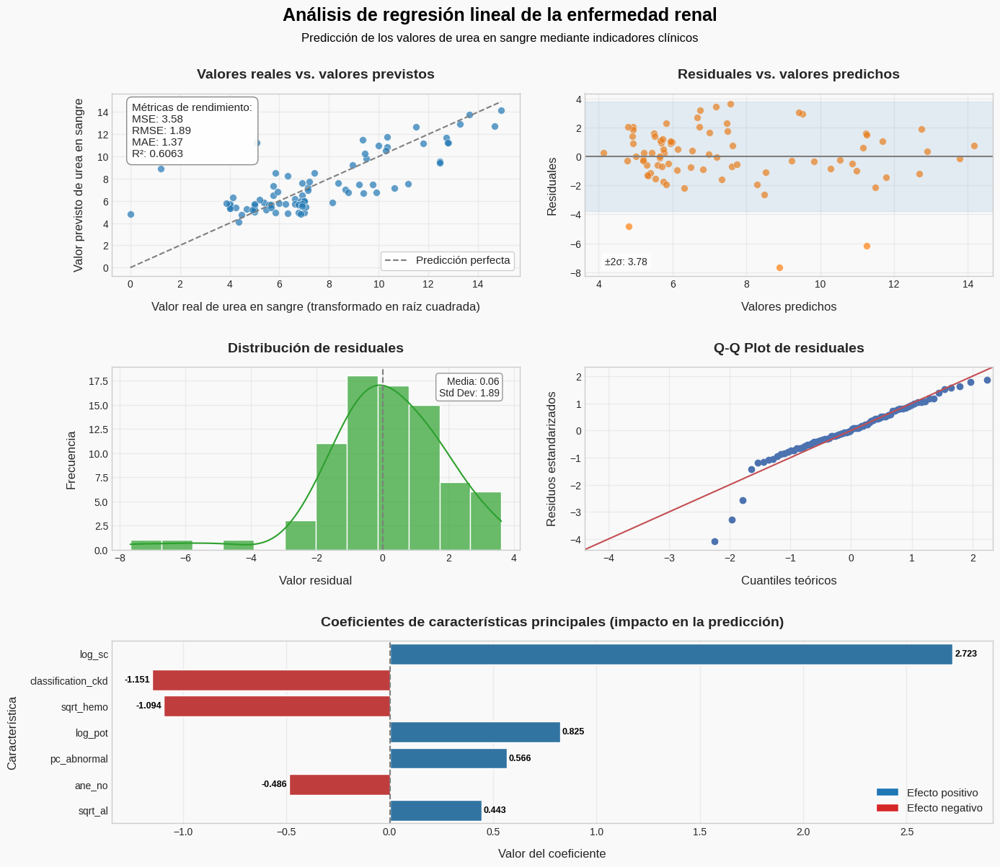

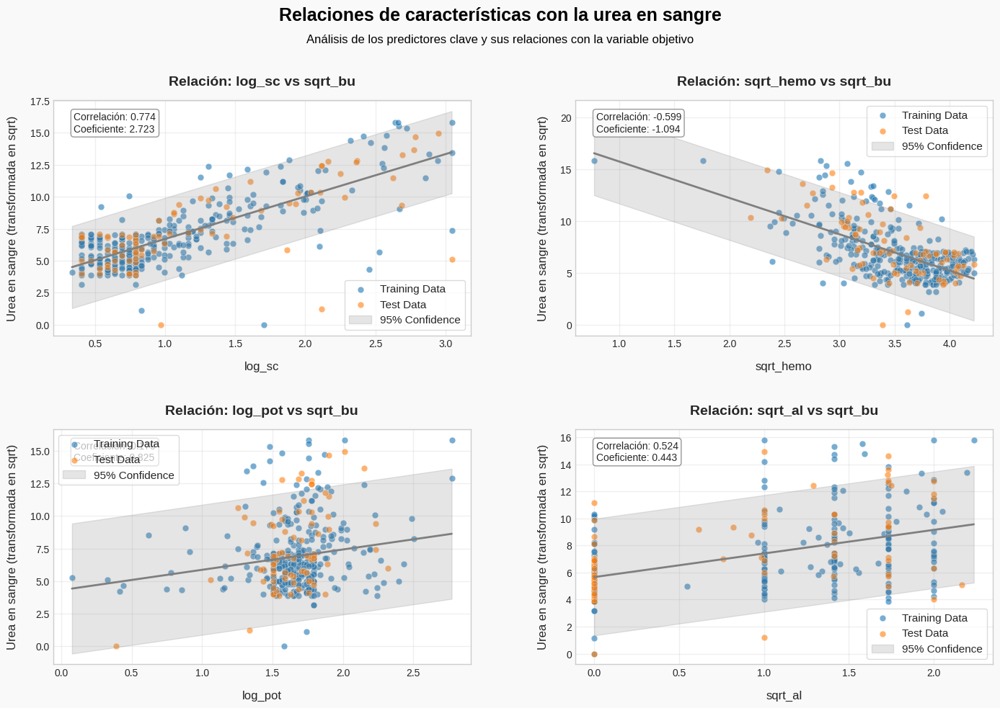

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Dividir datos y manejar variables categóricas
train_df, test_df = train_test_split(encoded_kidney_df, test_size=0.2, random_state=42)

# Definir predictores
numeric_predictors_2 = ['log_sc',  'sqrt_al', 'log_pot', 'sqrt_hemo']
categorical_predictors_2 = ['ane_no',  'pc_abnormal',  'classification_ckd']

# Combine todos los predictores para sklearn
X_cols = numeric_predictors_2 + categorical_predictors_2

# Preparar datos para el modelo de sklearn
X_train = train_df[X_cols]
y_train= train_df['sqrt_bu']
X_test = test_df[X_cols]
y_test = test_df['sqrt_bu']

# Entrenar el modelo de regresión lineal
model = LinearRegression()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# Calcular residuales
residuals = y_test- y_pred

# Calcular diversas métricas de rendimiento
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Configura un estilo visual consistente con una paleta de colores
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.size': 11,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'figure.figsize': (12, 8),
    'figure.dpi': 100,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Definir una paleta de colores cohesiva
colors = {
    'primary': '#1f77b4',
    'secondary': '#ff7f0e',
    'tertiary': '#2ca02c',
    'negative': '#d62728',
    'neutral': '#7f7f7f',
    'background': '#f9f9f9',
    'grid': '#e0e0e0'
}

# Crear un panel con un aspecto limpio
fig = plt.figure(figsize=(14, 12), facecolor=colors['background'])
fig.suptitle('Análisis de regresión lineal de la enfermedad renal',
             fontsize=18, fontweight='bold', y=1, color='#000000')

# Añadir un subtítulo ligero con contexto adicional
plt.figtext(0.5, 0.96, 'Predicción de los valores de urea en sangre mediante indicadores clínicos',
            ha='center', fontsize=12, color='#000000')

# Crear una especificación de cuadrícula personalizada para un mejor diseño
gs = fig.add_gridspec(3, 6)

# Panel 1: Gráfico real vs. predicho
ax1 = fig.add_subplot(gs[0, :3])
ax1.set_facecolor(colors['background'])
scatter = ax1.scatter(y_test, y_pred, alpha=0.7, s=50,
                     c=colors['primary'], edgecolor='white', linewidth=0.5)
ax1.plot([min(y_test.min(), y_pred.min()), max(y_test.max(), y_pred.max())],
         [min(y_test.min(), y_pred.min()), max(y_test.max(), y_pred.max())],
         '--', color=colors['neutral'], linewidth=1.5, label='Predicción perfecta')
ax1.set_xlabel('Valor real de urea en sangre (transformado en raíz cuadrada)', labelpad=12)
ax1.set_ylabel('Valor previsto de urea en sangre', labelpad=12)
ax1.set_title('Valores reales vs. valores previstos', pad=15, fontweight='bold')
ax1.legend(frameon=True, framealpha=0.9, loc='lower right')

# Cree un cuadro de texto con métricas del modelo
metrics_text = f"Métricas de rendimiento:\nMSE: {mse:.2f}\nRMSE: {rmse:.2f}\nMAE: {mae:.2f}\nR²: {r2:.4f}"
props = dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9, edgecolor=colors['neutral'])
ax1.text(0.05, 0.95, metrics_text, transform=ax1.transAxes, fontsize=11,
         verticalalignment='top', bbox=props)

# Panel 2: Residuales vs. Valores Predichos
ax2 = fig.add_subplot(gs[0, 3:])
ax2.set_facecolor(colors['background'])
ax2.scatter(y_pred, residuals, alpha=0.7, s=50,
           c=colors['secondary'], edgecolor='white', linewidth=0.5)
ax2.axhline(y=0, color=colors['neutral'], linestyle='-', linewidth=1.5)
ax2.set_xlabel('Valores predichos', labelpad=12)
ax2.set_ylabel('Residuales', labelpad=12)
ax2.set_title('Residuales vs. valores predichos', pad=15, fontweight='bold')

# Agregar una banda horizontal para mostrar la varianza residual
std_resid = np.std(residuals)
ax2.axhspan(-2*std_resid, 2*std_resid, alpha=0.1, color=colors['primary'])
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8)
ax2.text(0.05, 0.05, f"±2σ: {2*std_resid:.2f}", transform=ax2.transAxes, fontsize=10,
         verticalalignment='bottom', bbox=props)

# Panel 3: Distribución de residuales
ax3 = fig.add_subplot(gs[1, :3])
ax3.set_facecolor(colors['background'])
sns.histplot(residuals, kde=True, ax=ax3, color=colors['tertiary'], alpha=0.7)
ax3.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax3.set_xlabel('Valor residual', labelpad=12)
ax3.set_ylabel('Frecuencia', labelpad=12)
ax3.set_title('Distribución de residuales', pad=15, fontweight='bold')

# Añadir anotaciones sobre la distribución
mean_resid = np.mean(residuals)
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor=colors['neutral'])
ax3.text(0.95, 0.95, f"Media: {mean_resid:.2f}\nStd Dev: {std_resid:.2f}",
         transform=ax3.transAxes, fontsize=10,
         horizontalalignment='right', verticalalignment='top', bbox=props)

# Panel 4: Q-Q Plot
ax4 = fig.add_subplot(gs[1, 3:])
ax4.set_facecolor(colors['background'])
sm.qqplot(residuals, line='45', fit=True, ax=ax4)
ax4.set_xlabel('Cuantiles teóricos', labelpad=12)
ax4.set_ylabel('Residuos estandarizados', labelpad=12)
for item in ax4.get_children():
    if isinstance(item, plt.Line2D):
        if item.get_linestyle() == 'none':
            item.set_color(colors['primary'])
            item.set_alpha(0.7)
            item.set_markeredgecolor('white')
            item.set_markeredgewidth(0.5)
            item.set_markersize(5)

ax4.set_title('Q-Q Plot de residuales', pad=15, fontweight='bold')
ax4.grid(True, alpha=0.3)

# Panel 5: Importancia de las características (coeficientes)
ax5 = fig.add_subplot(gs[2, :])
ax5.set_facecolor(colors['background'])

# Calcular la importancia de las características
coefficients = pd.DataFrame({
    'Feature': X_train.columns,
    'Coefficient': model.coef_
})
coefficients['Abs_Coefficient'] = coefficients['Coefficient'].abs()
coefficients = coefficients.sort_values('Abs_Coefficient', ascending=False)
top_features = coefficients.head(12)  # Mostrar las top 12 características

# Crear un gráfico de barras de importancia de características
bar_colors = [colors['primary'] if c > 0 else colors['negative'] for c in top_features['Coefficient']]
barplot = sns.barplot(x='Coefficient', y='Feature', data=top_features, hue='Feature',
                      palette=dict(zip(top_features['Feature'], bar_colors)),
                      legend=False, ax=ax5)
ax5.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax5.set_title('Coeficientes de características principales (impacto en la predicción)', pad=15, fontweight='bold')
ax5.set_xlabel('Valor del coeficiente', labelpad=12)
ax5.set_ylabel('Característica', labelpad=12)

# Agregar etiquetas de valores a las barras
for i, p in enumerate(barplot.patches):
    width = p.get_width()
    offset = 0.01 * (abs(width) / width) if width != 0 else 0
    x_pos = width + offset
    text_color = 'black'
    ax5.text(x_pos, p.get_y() + p.get_height()/2,
             f'{width:.3f}', ha='left' if width > 0 else 'right',
             va='center', color=text_color, fontweight='bold', fontsize=9)

# Añadir una leyenda que explique los colores de los coeficientes
from matplotlib.patches import Patch
legend_elements = [
    Patch(facecolor=colors['primary'], label='Efecto positivo'),
    Patch(facecolor=colors['negative'], label='Efecto negativo')
]
ax5.legend(handles=legend_elements, loc='lower right')

# Ajustar el diseño
plt.tight_layout()
plt.subplots_adjust(top=0.9, hspace=0.5, wspace=0.7)
plt.show()

print("\n")

# Crear un panel
plt.figure(figsize=(14, 10), facecolor=colors['background'])
plt.suptitle('Relaciones de características con la urea en sangre', fontsize=18, fontweight='bold', color='#000000')
plt.figtext(0.5, 0.93, 'Análisis de los predictores clave y sus relaciones con la variable objetivo',
            ha='center', fontsize=12, color='#000000')

numeric_features = [f for f in coefficients['Feature'] if f in numeric_predictors_2]
top_numeric = numeric_features[:min(4, len(numeric_features))]

# Crear subparcelas para cada característica numérica importante
for i, feature in enumerate(top_numeric):
    plt.subplot(2, 2, i+1)
    plt.grid(True, alpha=0.3)

    plt.scatter(X_train[feature], y_train, alpha=0.6, s=40,
                c=colors['primary'], label='Training Data', edgecolor='white', linewidth=0.5)
    plt.scatter(X_test[feature], y_test, alpha=0.6, s=40,
                c=colors['secondary'], label='Test Data', edgecolor='white', linewidth=0.5)

    try:
        # Crear un modelo lineal simple para esta característica
        slope, intercept = np.polyfit(X_train[feature], y_train, 1)
        x_range = np.linspace(X_train[feature].min(), X_train[feature].max(), 100)
        y_pred_line = slope * x_range + intercept

        # Trazar la línea de tendencia
        plt.plot(x_range, y_pred_line, '-', color=colors['neutral'], linewidth=2)

        # Agregar intervalo de confianza
        residuals = y_train - (slope * X_train[feature] + intercept)
        std_error = np.std(residuals)
        plt.fill_between(x_range, y_pred_line - 1.96*std_error, y_pred_line + 1.96*std_error,
                         alpha=0.2, color=colors['neutral'], label='95% Confidence')

        # Añadir coeficiente de correlación
        corr = np.corrcoef(X_train[feature], y_train)[0, 1]
        # Obtener el valor del coeficiente para esta característica
        coef_value = coefficients.loc[coefficients['Feature'] == feature, 'Coefficient'].values[0]

        # Agregar un cuadro de texto con estadísticas
        stats_text = f"Correlación: {corr:.3f}\nCoeficiente: {coef_value:.3f}"
        props = dict(boxstyle="round,pad=0.3", fc="white", alpha=0.8, ec=colors['neutral'])
        plt.annotate(stats_text, xy=(0.05, 0.95), xycoords='axes fraction',
                    fontsize=10, bbox=props, verticalalignment='top')

    except Exception as e:
        print(f"Error al crear la línea de tendencia para {feature}: {e}")

    feature_label_map = {
        'log_sc': 'log_sc',
        'log_pcv': 'log_pcv',
        'win_sg': 'win_sg',
        'sqrt_al': 'sqrt_al',
        'pot': 'pot',
        'win_sod': 'win_sod',
        'age': 'age'
    }

    feature_label = feature_label_map.get(feature, feature)
    plt.xlabel(feature_label, labelpad=12)
    plt.ylabel('Urea en sangre (transformada en sqrt)', labelpad=12)
    plt.title(f'Relación: {feature_label} vs sqrt_bu', pad=15, fontweight='bold')
    plt.legend(frameon=True, framealpha=0.7)

plt.tight_layout()
plt.subplots_adjust(top=0.85, hspace=0.4, wspace=0.25)
plt.show()

Una vez entrenado el modelo de regresión lineal múltiple que incluye tanto variables numéricas como categóricas codificadas, el siguiente paso es evaluar su rendimiento y analizar la contribución individual de las variables predictoras. Para ello, se calcularon diversas métricas de error y se extrajo la lista de las características más influyentes en la predicción de la variable objetivo.

El bloque de código a continuación imprime un resumen cuantitativo del rendimiento del modelo e información sobre los coeficientes:

In [ ]:
print("\n🔹 Resumen del rendimiento del modelo:")
print(f"Error cuadrático medio (MSE): {mse:.4f}")
print(f"Raíz del error cuadrático medio: {rmse:.4f}")
print(f"Error absoluto medio: {mae:.4f}")
print(f"Puntuación R²: {r2:.4f}")
print(f"R² ajustado: {1 - (1-r2)*(len(y_train)-1)/(len(y_train)-len(X_train.columns)-1):.4f}")

print("\n🔹 Top 10 características por importancia:")
print(coefficients.head(10).to_string(index=False))


🔹 Resumen del rendimiento del modelo:
Error cuadrático medio (MSE): 3.5806
Raíz del error cuadrático medio: 1.8922
Error absoluto medio: 1.3732
Puntuación R²: 0.6063
R² ajustado: 0.5974

🔹 Top 10 características por importancia:
           Feature  Coefficient  Abs_Coefficient
            log_sc         2.72             2.72
classification_ckd        -1.15             1.15
         sqrt_hemo        -1.09             1.09
           log_pot         0.82             0.82
       pc_abnormal         0.57             0.57
            ane_no        -0.49             0.49
           sqrt_al         0.44             0.44


Para obtener un análisis estadístico más detallado y comprensible del modelo de regresión, hemos empleado la librería `statsmodels` mediante su interfaz basada en fórmulas. Esta API permite trabajar directamente con variables categóricas en su formato original, sin necesidad de codificarlas manualmente, ya que internamente realiza el tratamiento adecuado (por ejemplo, one-hot encoding).

En el siguiente bloque de código, se construye una fórmula de regresión que incluye tanto predictores numéricos como categóricos. Posteriormente, se ajusta un modelo OLS (mínimos cuadrados ordinarios) sobre el conjunto de entrenamiento, y se imprime un resumen completo.

In [ ]:
formula = 'sqrt_bu ~ ' + ' + '.join(numeric_predictors_2 + categorical_predictors_2)
sm_model = smf.ols(formula=formula, data=train_df).fit()
print("\n")
print("🔹 Resumen estadístico detallado:")
print("="*78)
print(sm_model.summary())



🔹 Resumen estadístico detallado:
                            OLS Regression Results                            
Dep. Variable:                sqrt_bu   R-squared:                       0.665
Model:                            OLS   Adj. R-squared:                  0.657
Method:                 Least Squares   F-statistic:                     88.31
Date:                Sun, 20 Apr 2025   Prob (F-statistic):           3.34e-70
Time:                        09:53:18   Log-Likelihood:                -583.36
No. Observations:                 320   AIC:                             1183.
Df Residuals:                     312   BIC:                             1213.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
I

Una vez ajustado el modelo de regresión lineal múltiple utilizando tanto variables numéricas como categóricas originales, procedemos a evaluar su rendimiento y la relevancia de los predictores incluidos.

**Rendimiento del modelo:**

El modelo logra explicar el 66.5% de la varianza observada en la variable dependiente sqrt_bu (R² = 0.665), mientras que el R² ajustado se sitúa en 0.657, lo que confirma una buena capacidad explicativa incluso tras penalizar por el número de predictores. Estas cifras representan un ajuste moderadamente sólido, especialmente en el contexto de datos clínicos, donde es habitual encontrar cierta variabilidad no explicada debido a la complejidad de los factores fisiopatológicos.

Además, el valor de la estadística F (88.31 con p < 0.001) indica que el conjunto de predictores incluidos en el modelo tiene un efecto global estadísticamente significativo sobre la variable objetivo.

**Relevancia e interpretación de las variables predictoras:**

Entre los siete predictores incluidos, destacan los siguientes por su significancia estadística y magnitud de efecto:
*   `log_sc` (coef. = 2.7232, p < 0.001): es el predictor más relevante y con mayor impacto positivo. Su interpretación sugiere que un aumento en los niveles de creatinina sérica está asociado con un aumento en `sqrt_bu`, lo cual es coherente con el deterioro de la función renal.
*   `sqrt_al` (coef. = 0.4430, p = 0.010): muestra una relación positiva significativa. Una mayor excreción de albúmina se asocia con niveles más altos de `sqrt_bu`, lo cual concuerda con el patrón de daño renal.
*   `log_pot` (coef. = 0.8247, p = 0.005): también muestra un efecto positivo y significativo. Esto sugiere que niveles más altos de potasio en sangre podrían estar relacionados con disfunción renal, reflejada en un aumento de `sqrt_bu`.
*   `sqrt_hemo` (coef. = -1.0944, p < 0.001): tiene un efecto negativo significativo. Es decir, niveles más bajos de hemoglobina (potencialmente indicativos de anemia por enfermedad renal crónica) se asocian con valores más altos de urea en sangre.
*   `pc_abnormal` (coef. = 0.5661, p = 0.022): sugiere que la presencia de anomalías en el sedimento urinario se asocia con un aumento de `sqrt_bu`, lo cual es clínicamente coherente.
*   `classification_ckd` (coef. = -1.1508, p < 0.001): este coeficiente negativo, aunque significativo, resulta contraintuitivo. Indica que, manteniendo el resto de variables constantes, los pacientes sin diagnóstico formal de ERC tienden a tener valores más altos de `sqrt_bu`. Esto podría deberse a factores como diagnósticos tardíos, presencia de enfermedad aguda, deshidratación u otros procesos no clasificados clínicamente como ERC pero que impactan la urea en sangre.
*   `ane_no` (coef. = -0.4857, p = 0.084): su efecto es negativo, pero no estadísticamente significativo.

**Consideraciones técnicas:**

Las pruebas de normalidad de residuos (Omnibus y Jarque-Bera, con p < 0.001) sugieren que los errores no se distribuyen normalmente, y la kurtosis elevada (5.511) señala colas pesadas, lo cual podría deberse a outliers o a una distribución sesgada de la variable objetivo.

### 5.3. Análisis de multicolinealidad

En esta sección, realizamos un análisis exhaustivo de multicolinealidad entre las variables independientes del modelo de regresión lineal. La multicolinealidad se refiere a una fuerte correlación entre predictores (dos o más), lo que puede afectar negativamente la estabilidad de las estimaciones, inflar los errores estándar de los coeficientes y dificultar la interpretación del modelo.

Para detectar y evaluar este problema, hemos aplicado dos enfoques complementarios:
*   Factor de Inflación de la Varianza (VIF): cuantifica cuánto se incrementa la varianza de un coeficiente debido a la colinealidad con otros predictores.
*   Matriz de correlación: permite identificar relaciones lineales fuertes (en nuestro caso, r > 0.7) entre pares de variables.

🔹 Fórmula: sqrt_bu ~ C(ane_no) + C(pc_abnormal) + C(classification_ckd) + log_sc + sqrt_al + log_pot + sqrt_hemo



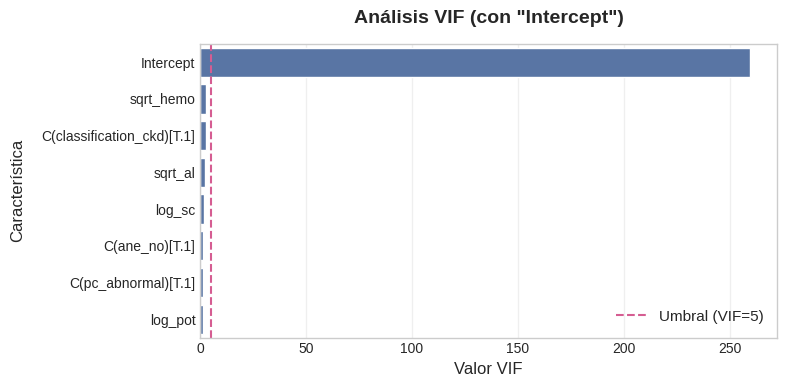

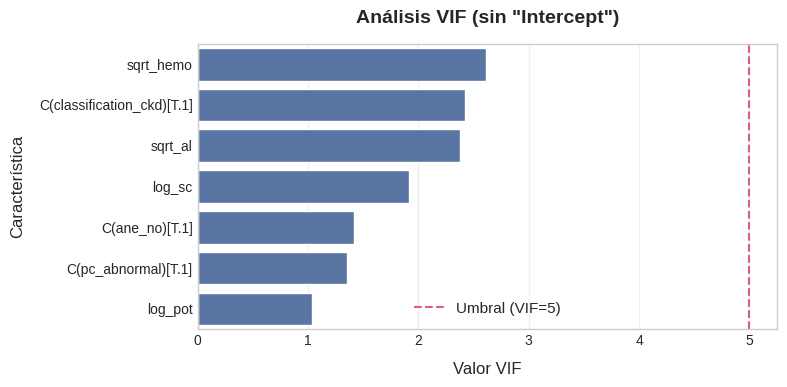


🔹 Resultados del análisis VIF:
                      Feature    VIF
0                   Intercept 259.47
7                   sqrt_hemo   2.62
3  C(classification_ckd)[T.1]   2.42
5                     sqrt_al   2.38
4                      log_sc   1.92
1              C(ane_no)[T.1]   1.41
2         C(pc_abnormal)[T.1]   1.35
6                     log_pot   1.04

🔹 Características con alto VIF (>5):
- Intercept: 259.47

🔹 No hay pares de características con correlación > 0.7


In [ ]:
import pandas as pd
import numpy as np
from statsmodels.stats.outliers_influence import variance_inflation_factor
import matplotlib.pyplot as plt
import seaborn as sns
from patsy import dmatrices
import warnings

def calculate_vif(X):
    """
    Calcular el factor de inflación de varianza para cada característica en un marco de datos.

    -----------
    Parámetros:
    -----------
    X : matriz de diseño que contiene variables independientes.

    --------
    Devuelve:
    --------
    DataFrame con características y sus valores VIF correspondientes, ordenados en orden descendente.
    """

    vif_data = pd.DataFrame()
    vif_data["Feature"] = X.columns

    # Manejar posibles problemas numéricos al calcular el VIF
    vif_values = []
    for i in range(X.shape[1]):
        try:
            vif = variance_inflation_factor(X.values, i)
            # Comprueba si VIF es extremadamente grande o infinito
            if np.isinf(vif) or vif > 1e10:
                vif_values.append(float('inf'))
                warnings.warn(f"Se detectó multicolinealidad extrema para la característica '{X.columns[i]}'")
            else:
                vif_values.append(vif)
        except Exception as e:
            warnings.warn(f"No se pudo calcular el VIF para la característica '{X.columns[i]}': {str(e)}")
            vif_values.append(np.nan)

    vif_data["VIF"] = vif_values
    return vif_data.sort_values("VIF", ascending=False)

def analyze_multicollinearity(df, target, numeric_features, categorical_features, vif_threshold=5, corr_threshold=0.7,
                             plot=True):
    """
    Analiza la multicolinealidad en un conjunto de datos utilizando VIF y análisis de correlación.

    -----------
    Parámetros:
    -----------
    df : conjunto de datos que contiene todas las características.
    target : nombre de la variable de destino.
    numeric_features : lista de nombres de características numéricas.
    categorical_features : lista de nombres de características categóricas
    vif_threshold : umbral para determinar valores altos de VIF (default=5).
    corr_threshold : umbral para determinar una alta correlación entre características(default=0.7).
    plot : si se deben mostrar gráficos de valores VIF (default=True).

    --------
    Devuelve:
    --------
    Diccionario que contiene datos VIF, matriz de diseño, características con alto VIF y pares altamente correlacionados.
    """

    # Comprobar si existen características en el marco de datos
    valid_numeric = [col for col in numeric_features if col in df.columns]
    valid_categorical = [col for col in categorical_features if col in df.columns]

    if not valid_numeric + valid_categorical:
        raise ValueError("No valid features found in the dataframe")

    # Crear fórmula para patsy
    formula_parts = ([f"C({cat})" for cat in valid_categorical] + valid_numeric)
    formula = f"{target} ~ " + " + ".join(formula_parts)
    print(f"🔹 Fórmula: {formula}\n")

    # Intente crear matrices de diseño con patsy
    try:
        y, X = dmatrices(formula, data=df, return_type='dataframe')
        vif_data = calculate_vif(X)
    except Exception as e:
        print(f"Error con la fórmula de Patsy: {e}")
        print("Volviendo al cálculo directo de VIF utilizando sólo características numéricas...")
        if not valid_numeric:
            raise ValueError("Se necesita al menos una característica numérica válida para el cálculo directo de VIF.")
        X = df[valid_numeric].copy()
        vif_data = calculate_vif(X)

    # Encuentra características problemáticas
    high_vif_features = vif_data[vif_data["VIF"] > vif_threshold]["Feature"].tolist()

    # Análisis de correlación
    corr_matrix = X.corr().abs()
    upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    highly_correlated = [(col1, col2, corr_matrix.loc[col1, col2])
                         for col1 in upper_tri.index
                         for col2 in upper_tri.columns
                         if upper_tri.loc[col1, col2] > corr_threshold]

    # Visualizar si se solicita
    if plot:
        # Gráfico VIF con intersección (si está presente)
        has_intercept = "Intercept" in vif_data["Feature"].values

        if has_intercept:
            plt.figure(figsize=(8, 4))
            data_to_plot = vif_data.head(20) if len(vif_data) > 20 else vif_data
            sns.barplot(x="VIF", y="Feature", data=data_to_plot)
            plt.axvline(x=vif_threshold, color='#d55d92', linestyle='--', label=f'Umbral (VIF={vif_threshold})')
            plt.title('Análisis VIF (con "Intercept")', fontweight='bold', fontsize=14, pad=15)
            plt.xlabel('Valor VIF', fontsize=12)
            plt.ylabel('Característica', fontsize=12, labelpad=12)
            plt.legend()
            plt.tight_layout()
            plt.show()

            print("\n")

            # Gráfico VIF sin intersección
            vif_data_no_intercept = vif_data[vif_data["Feature"] != "Intercept"]
            plt.figure(figsize=(8, 4))
            data_to_plot = vif_data_no_intercept.head(20) if len(vif_data_no_intercept) > 20 else vif_data_no_intercept
            sns.barplot(x="VIF", y="Feature", data=data_to_plot)
            plt.axvline(x=vif_threshold, color='#d55d92', linestyle='--', label=f'Umbral (VIF={vif_threshold})')
            plt.title('Análisis VIF (sin "Intercept")', fontweight='bold', fontsize=14, pad=15)
            plt.xlabel('Valor VIF', fontsize=12, labelpad=10)
            plt.ylabel('Característica', fontsize=12, labelpad=10)
            plt.legend()
            plt.tight_layout()
            plt.show()
        else:
            # Sólo una plot si no hay intersección
            plt.figure(figsize=(8, 4))
            data_to_plot = vif_data.head(20) if len(vif_data) > 20 else vif_data
            sns.barplot(x="VIF", y="Feature", data=data_to_plot)
            plt.axvline(x=vif_threshold, color='#d55d92', linestyle='--', label=f'Umbral (VIF={vif_threshold})')
            plt.title('Análisis VIF', fontweight='bold', fontsize=14, pad=15)
            plt.xlabel('Valor VIF', fontsize=12, labelpad=10)
            plt.ylabel('Valor VIF', fontsize=12, labelpad=10)
            plt.legend()
            plt.tight_layout()
            plt.show()

    # Imprimir resultados
    print("\n🔹 Resultados del análisis VIF:")
    print(vif_data)

    if high_vif_features:
        print(f"\n🔹 Características con alto VIF (>{vif_threshold}):")
        for feature in high_vif_features:
            vif_value = vif_data[vif_data['Feature'] == feature]['VIF'].values[0]
            if np.isinf(vif_value):
                print(f"- {feature}: Multicolinealidad extrema (infinita)")
            else:
                print(f"- {feature}: {vif_value:.2f}")
    else:
        print(f"\n🔹 Sin funciones con VIF > {vif_threshold}")

    if highly_correlated:
        print(f"\n🔹 Pares de características altamente correlacionadas (correlación > {corr_threshold}):")
        for col1, col2, corr in highly_correlated:
            print(f"- {col1} & {col2}: {corr:.3f}")
    else:
        print(f"\n🔹 No hay pares de características con correlación > {corr_threshold}")

    return {
        'vif_data': vif_data,
        'design_matrix': X,
        'high_vif_features': high_vif_features,
        'highly_correlated_pairs': highly_correlated
    }

if __name__ == "__main__":
    numeric_features = ['log_sc',  'sqrt_al', 'log_pot', 'sqrt_hemo']
    categorical_features = ['ane_no',  'pc_abnormal', 'classification_ckd']
    target_variable = 'sqrt_bu'

    results = analyze_multicollinearity(
        df=encoded_kidney_df,
        target=target_variable,
        numeric_features=numeric_features,
        categorical_features=categorical_features,
        vif_threshold=5,
        corr_threshold=0.7
    )

Resultados obtenidos indican que la única variable que presenta multicolinealidad alta (VIF > 5) es el `Intercepto`, con un valor extremadamente elevado (259.47). Esto es esperado, ya que el intercepto no es una variable explicativa real, sino una constante, y no suele considerarse al evaluar la multicolinealidad entre predictores.

El resto de las variables presentan VIFs bajos (todos < 3), lo cual indica que no existe una colinealidad problemática entre ellas y que las estimaciones de los coeficientes serán estables y confiables.

Además, hemos verificado la matriz de correlación entre las variables, y no se encontró ningún par con una correlación mayor a 0.7, lo que refuerza la conclusión anterior.

Por estas razones consideramos que no es necesario eliminar ni transformar variables por colinealidad en este caso, por lo que el modelo puede seguir adelante con esta selección de características sin ajustes adicionales por este motivo.

### 5.4. Métodos de regularización

En problemas de regresión multivariable, es frecuente encontrarse con colinealidad entre predictores, lo que puede provocar estimaciones inestables de los coeficientes y disminuir la capacidad predictiva del modelo. Tal y como se ha visto en el apartado anterior.

Para abordar este problema, se aplican técnicas de regularización y también se realiza la comparación.

#### 5.4.1. Regresión Ridge (L2)

En esta sección, vamos a aplicar regresión Ridge (también conocida como L2 regularization), que introduce una penalización proporcional al cuadrado de la magnitud de los coeficientes. Esta penalización no elimina variables, pero tiende a reducir sus magnitudes, ayudando a mitigar la multicolinealidad y mejorar la generalización del modelo.

El código que hemos realizado ejecuta un análisis siguiendo los pasos que tenemos a continuación:
1. Estandariza las variables predictoras (paso clave previo a aplicar regularización).
2. Selecciona el hiperparámetro óptimo `alpha` mediante búsqueda en rejilla (`GridSearchCV`).
3. Ajusta el modelo Ridge con el mejor valor de `alpha`.
4. Compara este modelo con regresión lineal sin regularización usando métricas como RMSE y R².
5. Analiza los coeficientes para así nosotras poder ver qué variables son más importantes y cómo se reducen otras.
6. Evalua mediante validación cruzada, distribución de residuos, Q-Q plot y relación entre valores reales y predichos.


🔹 Mejor valor de alpha: 7.196856730011514

🔹 Columnas disponibles en cv_results:
['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time', 'param_alpha', 'params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score', 'split0_train_score', 'split1_train_score', 'split2_train_score', 'split3_train_score', 'split4_train_score', 'mean_train_score', 'std_train_score']

🔹 Resultados de validación cruzada para diferentes valores de alpha:
      alpha  mean_test_score  mean_train_score
0      0.00             2.35              2.23
1      0.00             2.35              2.23
2      0.01             2.35              2.23
3      0.02             2.35              2.23
4      0.05             2.35              2.23
5      0.14             2.35              2.23
6      0.37             2.35              2.23
7      1.00             2.34              2.23
8      2.68        

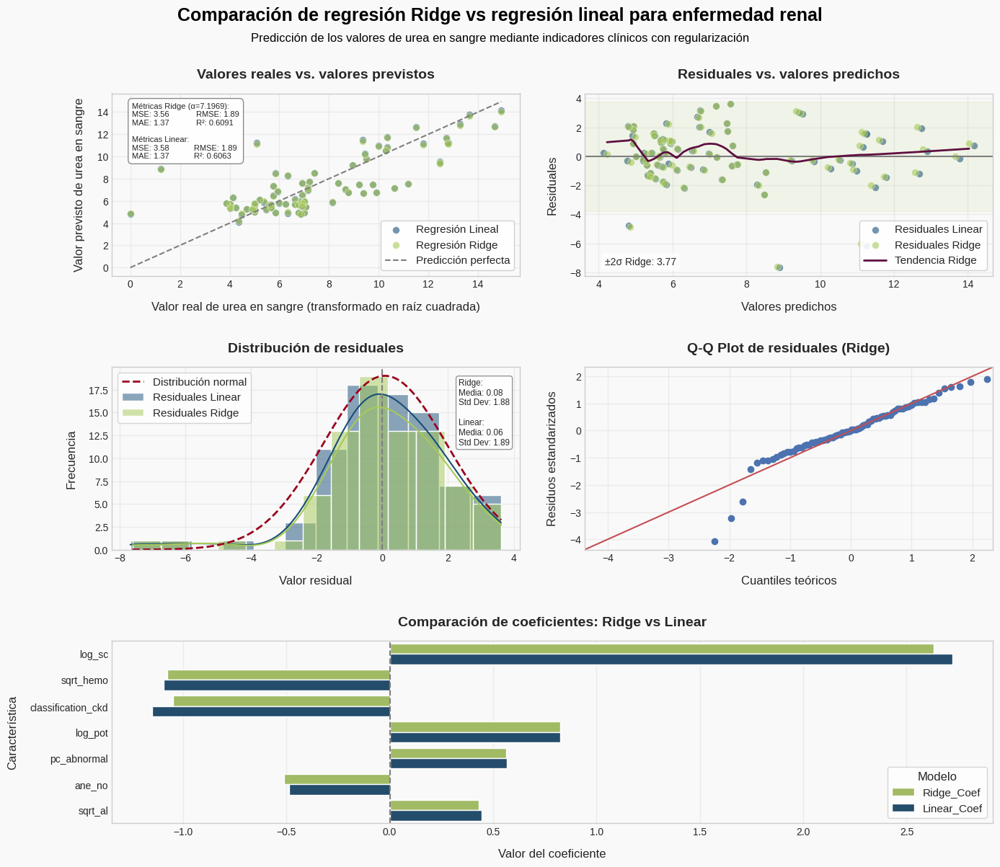

In [ ]:
import statsmodels.api as sm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.linear_model import Ridge, LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from statsmodels.nonparametric.smoothers_lowess import lowess
from scipy import stats


# Escalar los datos (recomendado para Ridge)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Encontrar el mejor alfa para Ridge mediante validación cruzada
param_grid = {
    'alpha': np.logspace(-3, 3, 15)  # Amplia gama para alfa
}

ridge_cv = GridSearchCV(
    Ridge(random_state=42),
    param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    return_train_score=True  # Añadido para obtener las puntuaciones de entrenamiento
)
ridge_cv.fit(X_train_scaled, y_train)

# Obtener el mejor valor de alpha
best_alpha = ridge_cv.best_params_['alpha']
print(f"\n🔹 Mejor valor de alpha: {best_alpha}")

# Mostrar resultados de la validación cruzada
cv_results = pd.DataFrame(ridge_cv.cv_results_)

# Verificar qué columnas están disponibles antes de intentar acceder a ellas
print("\n🔹 Columnas disponibles en cv_results:")
print(cv_results.columns.tolist())

# Seleccionar las columnas correctas que existen en el DataFrame
cv_results_subset = cv_results[['param_alpha', 'mean_test_score']]
if 'mean_train_score' in cv_results.columns:
    cv_results_subset['mean_train_score'] = cv_results['mean_train_score']
else:
    print("\n⚠️ La columna 'mean_train_score' no está disponible")

cv_results_subset.columns = ['alpha', 'mean_test_score'] + (['mean_train_score'] if 'mean_train_score' in cv_results.columns else [])
cv_results_subset['mean_test_score'] = -cv_results_subset['mean_test_score']  # Convertir a MSE positivo
if 'mean_train_score' in cv_results_subset.columns:
    cv_results_subset['mean_train_score'] = -cv_results_subset['mean_train_score']  # Convertir a MSE positivo

print("\n🔹 Resultados de validación cruzada para diferentes valores de alpha:")
print(cv_results_subset)

# Realizar validación cruzada con el mejor alpha
cv_scores = cross_val_score(
    Ridge(alpha=best_alpha, random_state=42),
    X_train_scaled, y_train, cv=5, scoring='r2', n_jobs=-1
)
print(f"\n🔹 Puntuaciones de validación cruzada (R²): {np.mean(cv_scores):.4f} ± {np.std(cv_scores):.4f}")

# Entrenar el modelo Ridge con el mejor valor de alpha
ridge_model = Ridge(alpha=best_alpha, random_state=42)
ridge_model.fit(X_train_scaled, y_train)
y_pred_ridge = ridge_model.predict(X_test_scaled)

# También entrenar el modelo de regresión lineal para comparación
linear_model = LinearRegression()
linear_model.fit(X_train_scaled, y_train)
y_pred_linear = linear_model.predict(X_test_scaled)

# Calcular residuales para ambos modelos
residuals_ridge = y_test - y_pred_ridge
residuals_linear = y_test - y_pred_linear

# Calcular diversas métricas de rendimiento para ambos modelos
mse_ridge = mean_squared_error(y_test, y_pred_ridge)
rmse_ridge = np.sqrt(mse_ridge)
r2_ridge = r2_score(y_test, y_pred_ridge)
mae_ridge = mean_absolute_error(y_test, y_pred_ridge)

mse_linear = mean_squared_error(y_test, y_pred_linear)
rmse_linear = np.sqrt(mse_linear)
r2_linear = r2_score(y_test, y_pred_linear)
mae_linear = mean_absolute_error(y_test, y_pred_linear)

print("\n🔹 Comparación de métricas:")
print(f"{'-'*32}")
print(f"{'Métrica':<10} {'Ridge':<12} {'Linear':<12}")
print(f"{'-'*32}")
print(f"{'MSE':<10} {mse_ridge:<12.4f} {mse_linear:<12.4f}")
print(f"{'RMSE':<10} {rmse_ridge:<12.4f} {rmse_linear:<12.4f}")
print(f"{'R²':<10} {r2_ridge:<12.4f} {r2_linear:<12.4f}")
print(f"{'MAE':<10} {mae_ridge:<12.4f} {mae_linear:<12.4f}")

# Analizar coeficientes
coef_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Ridge_Coef': ridge_model.coef_,
    'Linear_Coef': linear_model.coef_
})

# Ajustar coeficientes a la escala original
for i, col in enumerate(X_train.columns):
    coef_df.loc[coef_df['Feature'] == col, 'Ridge_Coef'] = ridge_model.coef_[i] / scaler.scale_[i]
    coef_df.loc[coef_df['Feature'] == col, 'Linear_Coef'] = linear_model.coef_[i] / scaler.scale_[i]

coef_df['Abs_Ridge_Coef'] = np.abs(coef_df['Ridge_Coef'])

# Comprobación de coeficientes pequeños (por debajo del umbral)
threshold = 0.001
small_coefs = np.sum(np.abs(coef_df['Ridge_Coef']) < threshold)
print("\n🔹 Top 10 características por importancia:")
print(coef_df.sort_values('Abs_Ridge_Coef', ascending=False).head(10))
print("\n")

# Configura un estilo visual consistente con una paleta de colores
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.size': 11,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'figure.figsize': (12, 8),
    'figure.dpi': 100,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Definir una paleta de colores cohesiva
colors = {
    'primary': '#1f77b4',
    'secondary': '#ff7f0e',
    'tertiary': '#2ca02c',
    'negative': '#d62728',
    'neutral': '#7f7f7f',
    'background': '#f9f9f9',
    'grid': '#e0e0e0',
    'ridge': '#a7c957',
    'linear': '#184e77'
}

# Crear un panel con un aspecto limpio para comparar Ridge vs Linear
fig = plt.figure(figsize=(14, 12), facecolor=colors['background'])
fig.suptitle('Comparación de regresión Ridge vs regresión lineal para enfermedad renal',
             fontsize=18, fontweight='bold', y=1, color='#000000')

# Añadir un subtítulo ligero con contexto adicional
plt.figtext(0.5, 0.96, 'Predicción de los valores de urea en sangre mediante indicadores clínicos con regularización',
            ha='center', fontsize=12, color='#000000')

# Crear una especificación de cuadrícula personalizada para un mejor diseño
gs = fig.add_gridspec(3, 6)

# Panel 1: Gráfico real vs. predicho (ambos modelos)
ax1 = fig.add_subplot(gs[0, :3])
ax1.set_facecolor(colors['background'])
scatter_linear = ax1.scatter(y_test, y_pred_linear, alpha=0.6, s=50,
                     c=colors['linear'], edgecolor='white', linewidth=0.5, label='Regresión Lineal')
scatter_ridge = ax1.scatter(y_test, y_pred_ridge, alpha=0.6, s=50,
                     c=colors['ridge'], edgecolor='white', linewidth=0.5, label='Regresión Ridge')
min_val = min(y_test.min(), min(y_pred_linear.min(), y_pred_ridge.min()))
max_val = max(y_test.max(), max(y_pred_linear.max(), y_pred_ridge.max()))
ax1.plot([min_val, max_val], [min_val, max_val],
         '--', color=colors['neutral'], linewidth=1.5, label='Predicción perfecta')
ax1.set_xlabel('Valor real de urea en sangre (transformado en raíz cuadrada)', labelpad=12)
ax1.set_ylabel('Valor previsto de urea en sangre', labelpad=12)
ax1.set_title('Valores reales vs. valores previstos', pad=15, fontweight='bold')
ax1.legend(frameon=True, framealpha=0.9, loc='lower right')

# Cree un cuadro de texto con métricas del modelo
metrics_text = (f"Métricas Ridge (α={best_alpha:.4f}):\n"
                f"MSE: {mse_ridge:.2f}            RMSE: {rmse_ridge:.2f}\n"
                f"MAE: {mae_ridge:.2f}            R²: {r2_ridge:.4f}\n\n"
                f"Métricas Linear:\n"
                f"MSE: {mse_linear:.2f}           RMSE: {rmse_linear:.2f}\n"
                f"MAE: {mae_linear:.2f}           R²: {r2_linear:.4f}")
props = dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9, edgecolor=colors['neutral'])
ax1.text(0.05, 0.95, metrics_text, transform=ax1.transAxes, fontsize=8,
         verticalalignment='top', bbox=props)

# Panel 2: Residuales vs. Valores Predichos (ambos modelos)
ax2 = fig.add_subplot(gs[0, 3:])
ax2.set_facecolor(colors['background'])
ax2.scatter(y_pred_linear, residuals_linear, alpha=0.6, s=50,
           c=colors['linear'], edgecolor='white', linewidth=0.5, label='Residuales Linear')
ax2.scatter(y_pred_ridge, residuals_ridge, alpha=0.6, s=50,
           c=colors['ridge'], edgecolor='white', linewidth=0.5, label='Residuales Ridge')
ax2.axhline(y=0, color=colors['neutral'], linestyle='-', linewidth=1.5)
ax2.set_xlabel('Valores predichos', labelpad=12)
ax2.set_ylabel('Residuales', labelpad=12)
ax2.set_title('Residuales vs. valores predichos', pad=15, fontweight='bold')

# Agregar una banda horizontal para mostrar la varianza residual
std_resid_ridge = np.std(residuals_ridge)
# Añadir lowess para la línea de tendencia Ridge
lowess_y = lowess(residuals_ridge, y_pred_ridge, frac=0.3)
ax2.plot(lowess_y[:, 0], lowess_y[:, 1], color='#5f0f40', linestyle='-', linewidth=2, label='Tendencia Ridge')
ax2.legend(frameon=True, framealpha=0.9, loc='lower right')

ax2.axhspan(-2*std_resid_ridge, 2*std_resid_ridge, alpha=0.1, color=colors['ridge'])
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8)
ax2.text(0.05, 0.05, f"±2σ Ridge: {2*std_resid_ridge:.2f}", transform=ax2.transAxes, fontsize=10,
         verticalalignment='bottom', bbox=props)

# Panel 3: Distribución de residuales de ambos modelos
ax3 = fig.add_subplot(gs[1, :3])
ax3.set_facecolor(colors['background'])
sns.histplot(residuals_linear, kde=True, ax=ax3, color=colors['linear'], alpha=0.5, label='Residuales Linear')
sns.histplot(residuals_ridge, kde=True, ax=ax3, color=colors['ridge'], alpha=0.5, label='Residuales Ridge')
ax3.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax3.set_xlabel('Valor residual', labelpad=12)
ax3.set_ylabel('Frecuencia', labelpad=12)
ax3.set_title('Distribución de residuales', pad=15, fontweight='bold')

# Añadir curva de distribución normal para comparación
x = np.linspace(min(residuals_ridge), max(residuals_ridge), 100)
params = stats.norm.fit(residuals_ridge)
pdf_fitted = stats.norm.pdf(x, *params)
ax3.plot(x, pdf_fitted * len(residuals_ridge) * (max(residuals_ridge) - min(residuals_ridge)) / 10,
                color='#9a031e', linestyle='--', linewidth=2, label='Distribución normal')

ax3.legend(frameon=True)

# Añadir anotaciones sobre la distribución
mean_resid_ridge = np.mean(residuals_ridge)
mean_resid_linear = np.mean(residuals_linear)
std_resid_linear = np.std(residuals_linear)
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor=colors['neutral'])
ax3.text(0.85, 0.75,
         f"Ridge:\nMedia: {mean_resid_ridge:.2f}\nStd Dev: {std_resid_ridge:.2f}\n\n"
         f"Linear:\nMedia: {mean_resid_linear:.2f}\nStd Dev: {std_resid_linear:.2f}",
         transform=ax3.transAxes, fontsize=8.5,
         horizontalalignment='left', verticalalignment='center', bbox=props)

# Panel 4: Q-Q Plot de Ridge
ax4 = fig.add_subplot(gs[1, 3:])
ax4.set_facecolor(colors['background'])
sm.qqplot(residuals_ridge, line='45', fit=True, ax=ax4)
ax4.set_xlabel('Cuantiles teóricos', labelpad=12)
ax4.set_ylabel('Residuos estandarizados', labelpad=12)
# Mejorar la consistencia del color en el QQ plot
for item in ax4.get_children():
    if isinstance(item, plt.Line2D):
        if item.get_linestyle() == 'none':
            item.set_markerfacecolor(colors['ridge'])  # Usar el color ridge para los marcadores
            item.set_alpha(0.7)
            item.set_markeredgecolor('white')
            item.set_markeredgewidth(0.5)
            item.set_markersize(5)

ax4.set_title('Q-Q Plot de residuales (Ridge)', pad=15, fontweight='bold')
ax4.grid(True, alpha=0.3)

# Panel 5: Importancia de las características (coeficientes de Ridge)
ax5 = fig.add_subplot(gs[2, :])
ax5.set_facecolor(colors['background'])

# Crear un DataFrame para el gráfico de barras
plot_data = pd.melt(
    coef_df[['Feature', 'Ridge_Coef', 'Linear_Coef']].sort_values('Ridge_Coef', key=abs, ascending=False).head(12),
    id_vars=['Feature'],
    value_vars=['Ridge_Coef', 'Linear_Coef'],
    var_name='Modelo',
    value_name='Coefficient'
)

# Crear un gráfico de barras agrupadas
sns.barplot(x='Coefficient', y='Feature', hue='Modelo', data=plot_data,
            palette={'Ridge_Coef': colors['ridge'], 'Linear_Coef': colors['linear']},
            ax=ax5)
ax5.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax5.set_title('Comparación de coeficientes: Ridge vs Linear', pad=15, fontweight='bold')
ax5.set_xlabel('Valor del coeficiente', labelpad=12)
ax5.set_ylabel('Característica', labelpad=12)

legend = ax5.legend(title="Modelo", frameon=True, fancybox=True, loc='lower right')

# Ajustar el diseño
plt.tight_layout()
plt.subplots_adjust(top=0.9, hspace=0.5, wspace=0.7)
plt.show()

Seguidamente, haremos un análisis de los datos obtenidos:

**Selección del parámetro de regularización:**

Mediante una búsqueda sobre una secuencia de valores de alpha, el mejor rendimiento se alcanzó con α = 7.20, valor a partir del cual la penalización L2 comienza a afectar significativamente la magnitud de los coeficientes sin provocar una pérdida sustancial de precisión predictiva. El modelo mostró una notable estabilidad en la puntuación de R² a lo largo de diferentes valores pequeños de α, pero comenzó a deteriorarse progresivamente con valores más altos, lo cual es consistente con un fenómeno de subajuste inducido por la sobre-regularización.

**Evaluación mediante validación cruzada:**

La puntuación media de validación cruzada fue de R² = 0.6516 ± 0.0372, lo cual indica un rendimiento sólido y relativamente estable del modelo Ridge a través de distintos subconjuntos del conjunto de datos. La baja desviación estándar refuerza la idea de que el modelo generaliza bien sin estar excesivamente influido por muestras particulares.

**Comparación con el modelo lineal clásico:**

Las métricas de evaluación sobre el conjunto de validación revelan una ligera superioridad del modelo Ridge respecto a la regresión lineal ordinaria. Aunque las diferencias son modestas, son sistemáticamente favorables a Ridge.

Estas mejoras, aunque pequeñas, son estadísticamente relevantes al estar sustentadas por un proceso de validación cruzada. Además, Ridge tiene la ventaja de manejar mejor problemas de colinealidad.

**Interpretación de los coeficientes:**

En cuanto a la importancia de las variables, las principales características predictoras según el valor absoluto de sus coeficientes en Ridge fueron:
*   `log_sc` (2.63): la creatinina sérica es nuevamente la variable más influyente, lo cual es clínicamente coherente con su relación con el daño renal.
*   `sqrt_hemo` (-1.08): niveles más bajos de hemoglobina predicen mayores valores de `sqrt_bu`, reflejando anemia secundaria al deterioro renal.
*   `classification_ckd` (-1.05): la clasificación como CKD sigue siendo una variable predictora relevante y significativa, con efecto negativo sobre la respuesta.

En comparación con el modelo lineal, los coeficientes son ligeramente más atenuados en Ridge, lo cual es esperado dado el efecto de regularización L2. Aun así, la jerarquía de importancia entre las variables se mantiene prácticamente inalterada.

Para evaluar y comparar modelos estadísticos más allá de las métricas tradicionales de error, es fundamental considerar criterios que penalicen la complejidad del modelo. En este sentido, el Criterio de Información de Akaike (AIC) y el Criterio de Información Bayesiano (BIC) se utilizan para medir el equilibrio entre el ajuste del modelo y su simplicidad. Ambos criterios se calculan a partir del `log-likelihood` del modelo y penalizan la inclusión de parámetros adicionales, favoreciendo modelos que logren una buena explicación de los datos con la menor complejidad posible.


In [ ]:
def calculate_aic_bic(model, X, y):
    """Calcula AIC y BIC para modelos de sklearn"""

    n = len(y)  # Número de observaciones
    mse = mean_squared_error(y, model.predict(X))  # Error cuadrático medio
    k = X.shape[1] + 1  # Número de parámetros (features + intercept)

    # Calcular log-likelihood (asumiendo distribución normal de errores)
    log_likelihood = -n/2 * np.log(2*np.pi) - n/2 * np.log(mse) - 1/(2*mse) * np.sum((y - model.predict(X))**2)

    # Fórmulas AIC y BIC
    aic = -2 * log_likelihood + 2 * k
    bic = -2 * log_likelihood + np.log(n) * k

    return aic, bic

# Calcular AIC y BIC para el modelo Ridge
aic_ridge, bic_ridge = calculate_aic_bic(ridge_model, X_train_scaled, y_train)

# Calcular AIC y BIC para el modelo Lineal
aic_linear, bic_linear = calculate_aic_bic(linear_model, X_train_scaled, y_train)

# Mostrar resultados
print("\n🔹 Criterios de información para selección de modelos:")
print(f"{'-'*32}")
print(f"{'Criterio':<10} {'Ridge':<12} {'Linear':<12}")
print(f"{'-'*32}")
print(f"{'AIC':<10} {aic_ridge:<12.2f} {aic_linear:<12.2f}")
print(f"{'BIC':<10} {bic_ridge:<12.2f} {bic_linear:<12.2f}")


🔹 Criterios de información para selección de modelos:
--------------------------------
Criterio   Ridge        Linear      
--------------------------------
AIC        1183.10      1182.72     
BIC        1213.25      1212.87     


Aunque las diferencias son muy pequeñas, ambos criterios favorecen ligeramente al modelo de regresión lineal ordinaria. La diferencia es de 0.38 puntos tanto en AIC como en BIC, por lo que ambos modelos pueden considerarse comparables desde el punto de vista del balance entre ajuste y complejidad.

Sin embargo, es importante destacar que el modelo Ridge fue capaz de obtener métricas predictivas ligeramente mejores que el modelo lineal. Esta aparente contradicción puede explicarse por el hecho de que Ridge introduce una penalización a los coeficientes sin aumentar el número de parámetros. Además, la diferencia es mínima y poco significativa, por lo que la elección del modelo debería guiarse también por la estabilidad de los residuales y la capacidad de generalización, aspectos en los que Ridge ha mostrado ventajas

#### 5.4.2. Regresión Lasso (L1)

Después de explorar la regresión lineal tradicional y su variante regularizada mediante Ridge (L2), continuamos nuestro análisis con otro método ampliamente utilizado en problemas de regresión multivariable: la regresión Lasso (Least Absolute Shrinkage and Selection Operator), también conocida como regularización L1.

Mientras que Ridge penaliza los coeficientes grandes sin eliminarlos por completo, Lasso introduce una penalización basada en el valor absoluto de los coeficientes, lo que provoca que algunos de ellos se reduzcan exactamente a cero. Esta propiedad convierte a Lasso no solo en una herramienta para mitigar el sobreajuste, sino también en una técnica efectiva de selección automática de variables.

En el siguiente bloque de código:
*   Estandarizamos los datos, paso esencial previo a aplicar métodos de regularización.
*   Utilizamos `GridSearchCV` para encontrar el valor óptimo del parámetro `alpha` (fuerza de regularización).
*   Ajustamos un modelo Lasso con el mejor `alpha` encontrado.
*   Calculamos métricas clave como RMSE y R² para evaluar el rendimiento del modelo sobre el conjunto de prueba.
*   Comparamos con la regresión lineal tradicional para observar los beneficios de Lasso.
*   Analizamos la importancia de las características, destacando aquellas que Lasso mantiene (coeficientes distintos de cero).
*   Visualizamos los residuales del modelo para verificar supuestos estadísticos como la normalidad y la homocedasticidad.


🔹 Resultados de validación cruzada para diferentes valores de alpha:
    param_alpha  mean_test_score  mean_train_score
0          0.00             2.35              2.23
1          0.00             2.35              2.23
2          0.00             2.35              2.23
3          0.01             2.35              2.23
4          0.01             2.35              2.23
5          0.03             2.35              2.24
6          0.05             2.38              2.26
7          0.10             2.46              2.34
8          0.19             2.58              2.46
9          0.37             2.78              2.68
10         0.72             3.20              3.15
11         1.39             4.62              4.61
12         2.68             6.70              6.69
13         5.18             6.70              6.69
14        10.00             6.70              6.69

🔹 Mejor valor de alpha: 0.001

🔹 Selección de características: 7 de 7 características seleccionadas

🔹 Comparación

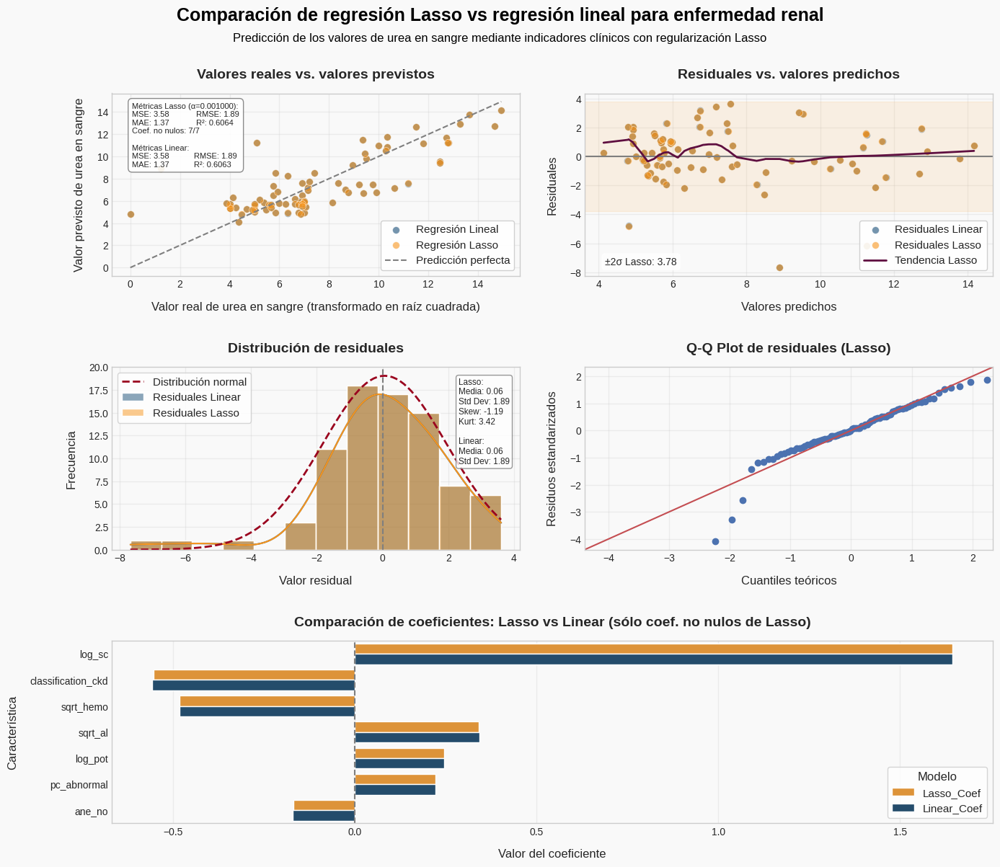

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso, LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from scipy import stats
from statsmodels.nonparametric.smoothers_lowess import lowess

# Escalar los datos (recomendado para Lasso)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Encontrar el mejor alfa para Lasso mediante validación cruzada
alphas = np.logspace(-3, 1, 15)  # Búsqueda más granular para alfa
lasso_cv = GridSearchCV(
    Lasso(random_state=42, max_iter=10000),
    {'alpha': alphas},
    cv=5,
    scoring='neg_mean_squared_error',
    return_train_score=True,
    n_jobs=-1
)
lasso_cv.fit(X_train_scaled, y_train)

# Mostrar resultados de la validación cruzada
cv_results = pd.DataFrame(lasso_cv.cv_results_)
cv_results = cv_results[['param_alpha', 'mean_test_score', 'mean_train_score']]
cv_results['mean_test_score'] = -cv_results['mean_test_score']  # Convertir a MSE positivo
cv_results['mean_train_score'] = -cv_results['mean_train_score']  # Convertir a MSE positivo
print("🔹 Resultados de validación cruzada para diferentes valores de alpha:")
print(cv_results)

# Obtener el mejor valor de alpha
best_alpha = lasso_cv.best_params_['alpha']
print(f"\n🔹 Mejor valor de alpha: {best_alpha}")

# Entrenar el modelo Lasso con el mejor valor de alpha
lasso_model = Lasso(alpha=best_alpha, random_state=42, max_iter=10000)
lasso_model.fit(X_train_scaled, y_train)
y_pred_lasso = lasso_model.predict(X_test_scaled)

# También entrenar el modelo de regresión lineal para comparación
linear_model = LinearRegression()
linear_model.fit(X_train_scaled, y_train)
y_pred_linear = linear_model.predict(X_test_scaled)

# Calcular residuales para ambos modelos
residuals_lasso = y_test - y_pred_lasso
residuals_linear = y_test - y_pred_linear

# Calcular diversas métricas de rendimiento para ambos modelos
mse_lasso = mean_squared_error(y_test, y_pred_lasso)
rmse_lasso = np.sqrt(mse_lasso)
r2_lasso = r2_score(y_test, y_pred_lasso)
mae_lasso = mean_absolute_error(y_test, y_pred_lasso)

mse_linear = mean_squared_error(y_test, y_pred_linear)
rmse_linear = np.sqrt(mse_linear)
r2_linear = r2_score(y_test, y_pred_linear)
mae_linear = mean_absolute_error(y_test, y_pred_linear)

# Contar coeficientes distintos de cero en Lasso
non_zero_coefs = np.sum(lasso_model.coef_ != 0)
total_coefs = len(lasso_model.coef_)
print(f"\n🔹 Selección de características: {non_zero_coefs} de {total_coefs} características seleccionadas")

print("\n🔹 Comparación de métricas:")
print(f"{'-'*32}")
print(f"{'Métrica':<10} {'Lasso':<12} {'Linear':<12}")
print(f"{'-'*32}")
print(f"{'MSE':<10} {mse_lasso:<12.4f} {mse_linear:<12.4f}")
print(f"{'RMSE':<10} {rmse_lasso:<12.4f} {rmse_linear:<12.4f}")
print(f"{'R²':<10} {r2_lasso:<12.4f} {r2_linear:<12.4f}")
print(f"{'MAE':<10} {mae_lasso:<12.4f} {mae_linear:<12.4f}")

# Analizar coeficientes
coef_df = pd.DataFrame({
    'Característica': X_train.columns,
    'Lasso_Coef': lasso_model.coef_,
    'Linear_Coef': linear_model.coef_
})
coef_df['Abs_Lasso_Coef'] = np.abs(coef_df['Lasso_Coef'])

# Contar coeficientes distintos de cero
non_zero_coefs = np.sum(coef_df['Lasso_Coef'] != 0)
print("\n🔹 Top 10 características por importancia:")
print(coef_df.sort_values('Abs_Lasso_Coef', ascending=False).head(10))
print("\n")

# Configura un estilo visual consistente con una paleta de colores
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.size': 11,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'figure.figsize': (12, 8),
    'figure.dpi': 100,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Definir una paleta de colores cohesiva
colors = {
    'primary': '#1f77b4',
    'secondary': '#ff7f0e',
    'tertiary': '#2ca02c',
    'negative': '#d62728',
    'neutral': '#7f7f7f',
    'background': '#f9f9f9',
    'grid': '#e0e0e0',
    'lasso': '#f8961e',
    'linear': '#184e77'
}

# Crear un panel con un aspecto limpio para comparar Lasso vs Linear
fig = plt.figure(figsize=(14, 12), facecolor=colors['background'])
fig.suptitle('Comparación de regresión Lasso vs regresión lineal para enfermedad renal',
             fontsize=18, fontweight='bold', y=1, color='#000000')

# Añadir un subtítulo ligero con contexto adicional
plt.figtext(0.5, 0.96, 'Predicción de los valores de urea en sangre mediante indicadores clínicos con regularización Lasso',
            ha='center', fontsize=12, color='#000000')

# Crear una especificación de cuadrícula personalizada para un mejor diseño
gs = fig.add_gridspec(3, 6)

# Panel 1: Gráfico real vs. predicho (ambos modelos)
ax1 = fig.add_subplot(gs[0, :3])
ax1.set_facecolor(colors['background'])
scatter_linear = ax1.scatter(y_test, y_pred_linear, alpha=0.6, s=50,
                     c=colors['linear'], edgecolor='white', linewidth=0.5, label='Regresión Lineal')
scatter_lasso = ax1.scatter(y_test, y_pred_lasso, alpha=0.6, s=50,
                     c=colors['lasso'], edgecolor='white', linewidth=0.5, label='Regresión Lasso')
ax1.plot([min(y_test.min(), min(y_pred_linear.min(), y_pred_lasso.min())),
          max(y_test.max(), max(y_pred_linear.max(), y_pred_lasso.max()))],
         [min(y_test.min(), min(y_pred_linear.min(), y_pred_lasso.min())),
          max(y_test.max(), max(y_pred_linear.max(), y_pred_lasso.max()))],
         '--', color=colors['neutral'], linewidth=1.5, label='Predicción perfecta')
ax1.set_xlabel('Valor real de urea en sangre (transformado en raíz cuadrada)', labelpad=12)
ax1.set_ylabel('Valor previsto de urea en sangre', labelpad=12)
ax1.set_title('Valores reales vs. valores previstos', pad=15, fontweight='bold')
ax1.legend(frameon=True, framealpha=0.9, loc='lower right')

# Cree un cuadro de texto con métricas del modelo
metrics_text = (f"Métricas Lasso (α={best_alpha:.6f}):\n"
                f"MSE: {mse_lasso:.2f}            RMSE: {rmse_lasso:.2f}\n"
                f"MAE: {mae_lasso:.2f}            R²: {r2_lasso:.4f}\n"
                f"Coef. no nulos: {non_zero_coefs}/{total_coefs}\n\n"
                f"Métricas Linear:\n"
                f"MSE: {mse_linear:.2f}           RMSE: {rmse_linear:.2f}\n"
                f"MAE: {mae_linear:.2f}           R²: {r2_linear:.4f}")
props = dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9, edgecolor=colors['neutral'])
ax1.text(0.05, 0.95, metrics_text, transform=ax1.transAxes, fontsize=8,
         verticalalignment='top', bbox=props)

# Panel 2: Residuales vs. Valores Predichos (ambos modelos)
ax2 = fig.add_subplot(gs[0, 3:])
ax2.set_facecolor(colors['background'])
ax2.scatter(y_pred_linear, residuals_linear, alpha=0.6, s=50,
           c=colors['linear'], edgecolor='white', linewidth=0.5, label='Residuales Linear')
ax2.scatter(y_pred_lasso, residuals_lasso, alpha=0.6, s=50,
           c=colors['lasso'], edgecolor='white', linewidth=0.5, label='Residuales Lasso')
ax2.axhline(y=0, color=colors['neutral'], linestyle='-', linewidth=1.5)

# Añadir suavizado LOWESS para verificar patrones
lowess_y = lowess(residuals_lasso, y_pred_lasso, frac=0.3)
ax2.plot(lowess_y[:, 0], lowess_y[:, 1], color='#5f0f40', linestyle='-', linewidth=2, label='Tendencia Lasso')

ax2.set_xlabel('Valores predichos', labelpad=12)
ax2.set_ylabel('Residuales', labelpad=12)
ax2.set_title('Residuales vs. valores predichos', pad=15, fontweight='bold')
ax2.legend(frameon=True, framealpha=0.9, loc='lower right')

# Agregar una banda horizontal para mostrar la varianza residual
std_resid_lasso = np.std(residuals_lasso)
ax2.axhspan(-2*std_resid_lasso, 2*std_resid_lasso, alpha=0.1, color=colors['lasso'])
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8)
ax2.text(0.05, 0.05, f"±2σ Lasso: {2*std_resid_lasso:.2f}", transform=ax2.transAxes, fontsize=10,
         verticalalignment='bottom', bbox=props)

# Panel 3: Distribución de residuales de ambos modelos
ax3 = fig.add_subplot(gs[1, :3])
ax3.set_facecolor(colors['background'])
sns.histplot(residuals_linear, kde=True, ax=ax3, color=colors['linear'], alpha=0.5, label='Residuales Linear')
sns.histplot(residuals_lasso, kde=True, ax=ax3, color=colors['lasso'], alpha=0.5, label='Residuales Lasso')
ax3.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax3.set_xlabel('Valor residual', labelpad=12)
ax3.set_ylabel('Frecuencia', labelpad=12)
ax3.set_title('Distribución de residuales', pad=15, fontweight='bold')

# Añadir curva de distribución normal para comparación
x = np.linspace(min(residuals_lasso), max(residuals_lasso), 100)
params = stats.norm.fit(residuals_lasso)
pdf_fitted = stats.norm.pdf(x, *params)
ax3.plot(x, pdf_fitted * len(residuals_lasso) * (max(residuals_lasso) - min(residuals_lasso)) / 10,
                color='#9a031e', linestyle='--', linewidth=2, label='Distribución normal')

ax3.legend(frameon=True)

# Añadir anotaciones sobre la distribución
mean_resid_lasso = np.mean(residuals_lasso)
mean_resid_linear = np.mean(residuals_linear)
std_resid_linear = np.std(residuals_linear)
skew_resid = stats.skew(residuals_lasso)
kurt_resid = stats.kurtosis(residuals_lasso)

stats_text = (f"Lasso:\nMedia: {mean_resid_lasso:.2f}\nStd Dev: {std_resid_lasso:.2f}\n"
              f"Skew: {skew_resid:.2f}\nKurt: {kurt_resid:.2f}\n\n"
              f"Linear:\nMedia: {mean_resid_linear:.2f}\nStd Dev: {std_resid_linear:.2f}")
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor=colors['neutral'])
ax3.text(0.85, 0.70, stats_text,
         transform=ax3.transAxes, fontsize=8.5,
         horizontalalignment='left', verticalalignment='center', bbox=props)

# Panel 4: Q-Q Plot de Lasso
ax4 = fig.add_subplot(gs[1, 3:])
ax4.set_facecolor(colors['background'])
sm.qqplot(residuals_lasso, line='45', fit=True, ax=ax4)
ax4.set_xlabel('Cuantiles teóricos', labelpad=12)
ax4.set_ylabel('Residuos estandarizados', labelpad=12)
for item in ax4.get_children():
    if isinstance(item, plt.Line2D):
        if item.get_linestyle() == 'none':
            item.set_color(colors['lasso'])
            item.set_alpha(0.7)
            item.set_markeredgecolor('white')
            item.set_markeredgewidth(0.5)
            item.set_markersize(5)

ax4.set_title('Q-Q Plot de residuales (Lasso)', pad=15, fontweight='bold')
ax4.grid(True, alpha=0.3)

# Panel 5: Importancia de las características y comparación entre Lasso y Linear
ax5 = fig.add_subplot(gs[2, :])
ax5.set_facecolor(colors['background'])

# Calcular la importancia de las características para Lasso
lasso_coefficients = pd.DataFrame({
    'Feature': X_train.columns,
    'Coefficient': lasso_model.coef_
})
lasso_coefficients['Abs_Coefficient'] = lasso_coefficients['Coefficient'].abs()
lasso_coefficients = lasso_coefficients.sort_values('Abs_Coefficient', ascending=False)

# Características con coeficientes no nulos en Lasso
features_selected = lasso_coefficients[lasso_coefficients['Coefficient'] != 0]

# Calcular la importancia de las características para Linear
linear_coefficients = pd.DataFrame({
    'Feature': X_train.columns,
    'Coefficient': linear_model.coef_
})
linear_coefficients['Abs_Coefficient'] = linear_coefficients['Coefficient'].abs()

# Fusionar coeficientes para comparación
merged_coefs = pd.merge(
    lasso_coefficients[['Feature', 'Coefficient']].rename(columns={'Coefficient': 'Lasso_Coef'}),
    linear_coefficients[['Feature', 'Coefficient']].rename(columns={'Coefficient': 'Linear_Coef'}),
    on='Feature'
)

# Solo mostrar coeficientes no nulos de Lasso + los equivalentes de Linear
merged_coefs_filtered = merged_coefs[merged_coefs['Lasso_Coef'] != 0].sort_values('Lasso_Coef', key=abs, ascending=False)

if len(merged_coefs_filtered) > 0:
    # Crear un DataFrame para el gráfico de barras
    plot_data = pd.melt(
        merged_coefs_filtered,
        id_vars=['Feature'],
        value_vars=['Lasso_Coef', 'Linear_Coef'],
        var_name='Modelo',
        value_name='Coefficient'
    )

    # Crear un gráfico de barras agrupadas
    sns.barplot(x='Coefficient', y='Feature', hue='Modelo', data=plot_data,
                palette={'Lasso_Coef': colors['lasso'], 'Linear_Coef': colors['linear']},
                ax=ax5)
    ax5.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
    ax5.set_title('Comparación de coeficientes: Lasso vs Linear (sólo coef. no nulos de Lasso)', pad=15, fontweight='bold')
    ax5.set_xlabel('Valor del coeficiente', labelpad=12)
    ax5.set_ylabel('Característica', labelpad=12)

    legend = ax5.legend(title="Modelo", frameon=True, fancybox=True, loc='lower right')
else:
    # Si Lasso elimina todas las características (improbable pero posible)
    ax5.text(0.5, 0.5, "Lasso eliminó todas las características",
             horizontalalignment='center', verticalalignment='center',
             fontsize=14, transform=ax5.transAxes)

# Ajustar el diseño
plt.tight_layout()
plt.subplots_adjust(top=0.9, hspace=0.5, wspace=0.7)
plt.show()

A continuación vamos a analizar los resultados obtenidos:

**Evaluación mediante validación cruzada:**

Para determinar el valor óptimo del parámetro de regularización, se llevó a cabo una validación cruzada empleando una grilla de valores de alpha que abarcó desde valores cercanos a cero hasta valores más elevados. El análisis de los resultados mostró que para valores pequeños de alpha (entre 0.00 y 0.03), tanto el error de entrenamiento como el de validación permanecieron bajos y estables (alrededor de 2.23-2.24), indicando que el modelo logra un buen ajuste sin incurrir en sobreajuste.

Sin embargo, conforme se incrementó el valor de alpha, se observó un deterioro progresivo en el rendimiento, con incrementos marcados en MSE, especialmente a partir de alpha = 0.1. Este comportamiento sugiere que el modelo comienza a subajustarse, perdiendo capacidad explicativa al penalizar excesivamente los coeficientes. A valores extremos de alpha, el error alcanzó 6.70, evidenciando una clara pérdida de calidad predictiva.

El valor óptimo encontrado fue alpha = 0.001, que minimiza el error de validación sin comprometer la parsimonia del modelo. Este valor logra el mejor equilibrio entre ajuste y regularización, permitiendo preservar todas las variables relevantes sin incurrir en sobreajuste.

**Comparación de desempeño con la regresión lineal clásica:**

Al comparar el modelo Lasso con un modelo de regresión lineal múltiple clásico, los resultados obtenidos muestran diferencias mínimas entre ambos enfoques.

Las cifras obtenidas indican que Lasso consigue un rendimiento prácticamente idéntico al modelo lineal sin penalización, lo cual puede atribuirse a la adecuada selección de variables y a la estabilidad de las relaciones lineales en los datos. No obstante, se destaca que Lasso aporta una ventaja estructural al evitar la posible inflación de varianza por colinealidad y al controlar la magnitud de los coeficientes.

**Selección y relevancia de variables:**

A pesar de la capacidad de Lasso para reducir coeficientes a cero, en este caso, se conservaron las 7 variables originales en el modelo final. Esto sugiere que, bajo el nivel de penalización óptimo, todas las variables evaluadas poseen un grado de relevancia suficiente para justificar su inclusión.

Las variables con mayor importancia, según la magnitud de sus coeficientes en el modelo Lasso, fueron:
*   `log_sc` (1.64): se confirma como el predictor más relevante. Este resultado concuerda con la fisiopatología de la función renal, donde niveles elevados de creatinina reflejan una disminución del filtrado glomerular.
*   `classification_ckd` (-0.55): su relación negativa con la variable dependiente puede estar influenciada por la forma en que se codificó la categoría. Aun así, resulta clínicamente relevante como indicador de diagnóstico.
*   `sqrt_hemo` (-0.48): la anemia es común en pacientes con enfermedad renal, y su relación inversa con los niveles de urea es coherente con los hallazgos clínicos.


El siguiente bloque de código realiza el cálculo de AIC y BIC tanto para el modelo de regresión Lasso como para el modelo de regresión lineal clásico, utilizando los datos de entrenamiento previamente estandarizados. Esto permite comparar objetivamente ambos enfoques bajo un marco teórico más riguroso para la selección de modelos.



In [ ]:
# Calcular AIC y BIC para el modelo Lasso
aic_lasso, bic_lasso = calculate_aic_bic(lasso_model, X_train_scaled, y_train)

# Calcular AIC y BIC para el modelo Lineal
aic_linear, bic_linear = calculate_aic_bic(linear_model, X_train_scaled, y_train)

# Mostrar resultados
print("\n🔹 Criterios de información para selección de modelos:")
print(f"{'-'*32}")
print(f"{'Criterio':<10} {'Lasso':<12} {'Linear':<12}")
print(f"{'-'*32}")
print(f"{'AIC':<10} {aic_lasso:<12.2f} {aic_linear:<12.2f}")
print(f"{'BIC':<10} {bic_lasso:<12.2f} {bic_linear:<12.2f}")


🔹 Criterios de información para selección de modelos:
--------------------------------
Criterio   Lasso        Linear      
--------------------------------
AIC        1182.72      1182.72     
BIC        1212.87      1212.87     


Los resultados muestran que ambos modelos presentan exactamente los mismos valores de AIC y BIC, lo que indica que, desde el punto de vista de estos criterios de información, no existe una diferencia significativa entre ellos.

Sin embargo, es importante destacar que el modelo Lasso mantiene su utilidad como método preventivo contra la sobreajuste y la colinealidad.

#### 5.4.3. Evaluación de los métodos

La regresión regularizada tiene como objetivo mejorar la capacidad predictiva del modelo, reducir el sobreajuste y estabilizar los coeficientes cuando hay multicolinealidad o ruido en los datos. Ridge y Lasso logran esto penalizando la magnitud de los coeficientes, pero de maneras distintas, lo que influye directamente en su comportamiento.

Es por ello que vamos a analizar los resultados obtenidos, y así entender cómo cada método ha trabajado sobre el conjunto.

**Regresión Ridge (L2):**

*   Su mejor parámetro α es de 7.20.
*   Su rendimiento sobre test es:
    *   RMSE: 1.8855 (menor error de predicción de los tres modelos).
    *   MAE: 1.3705.
    *   R²: 0.6091 (ligeramente superior al modelo lineal y Lasso).
    *   Validación cruzada R²: 0.6516 ± 0.0372 (rendimiento estable y consistente).
*   Selección de variables: No elimina variables (todos los coeficientes son distintos de cero).
*   El top 4 características más relevantes (por magnitud absoluta de coeficiente) es:
    *   `log_sc` (2.63): es altamente influyente y tienen un coeficiente grande.
    *   `sqrt_hemo` (-1.08): relación negativa significativa, posiblemente reflejando anemia.
    *   `classification_ckd` (-1.05): indica menor `sqrt_bu` en pacientes sin CKD.
    *   `log_pot` (0.82): sugiere que el potasio sérico también tiene un papel en la predicción.

**Regresión Lasso (L1):**

*   Su mejor parámetro α es de 0.001 (regularización muy leve, ajustada finamente).
*   Su rendimiento sobre test es:
    *   RMSE: 1.8920 (ligeramente mayor que Ridge e inferior que Lineal).
    *   MAE: 1.3727.
    *   R²: 0.6064 (inferior a Ridge).
    *   Validación cruzada R²: 0.6064 (muy estable, con baja desviación)
*   Selección de variables: se conservaron 7 de 7 variables, lo que significa que no eliminó variables en este caso, indicando que todas aportan información relevante bajo esta regularización.
*   El top 4 características más relevantes (por magnitud absoluta) es:
    *   `log_sc`	(1.64): esta variable sigue siendo la más influyente.
    *   `classification_ckd`	(-0.55): influye negativamente, con implicaciones diagnósticas.
    *   `sqrt_hemo` (-0.48): relevancia fisiológica clara.
    *   `sqrt_al`	(0.34): indicador del grado de daño renal.

**Conclusiones finales:**

*   Ridge (L2) es la mejor opción si el objetivo es maximizar precisión y estabilidad, sin importar la cantidad de variables. Este aprovecha toda la información disponible, incluso de variables menos relevantes. Es el modelo con menor RMSE y mayor R², indicando mejor ajuste general y menor error de predicción.
*   Lasso (L1) es más útil si se desea un modelo más simple, con buena capacidad explicativa y menos variables. Este reduce dimensionalidad automáticamente, lo cual es útil si se busca un modelo más interpretable o eficiente. Sin embargo, sacrifica algo de capacidad predictiva frente a Ridge, como indica su RMSE más alto. Aun así, la validación cruzada muestra que es un modelo consistente y robusto.
*   Ambos modelos superan a la regresión lineal en estabilidad, gestión de ruido en los datos y capacidad de generalización.
*   La coincidencia en las variables más relevantes entre ambos métodos sugiere una alta concordancia en los factores que influyen en la variable objetivo, lo que aporta mayor confianza en la interpretación de los resultados.


### 5.5. Modelos predictivos

El siguiente paso es evaluar modelos predictivos que permitan capturar patrones significativos en los datos sin caer en el sobreajuste y ajustarlo a nuestro conjunto de entrenamiento.

#### 5.5.1. ElasticNet

En este contexto, hemos optado por aplicar `ElasticNet`, un poderoso algoritmo de regresión lineal regularizada, diseñado para prevenir el sobreajuste y mejorar la capacidad de generalización del modelo. Su principal fortaleza radica en que fusiona dos métodos clásicos de regularización: Lasso (L1) y Ridge (L2), lo que le permite:
*   Reducir la magnitud de los coeficientes (como Ridge), lo cual es útil en presencia de multicolinealidad entre variables.
*   Realizar selección de variables automática (como Lasso), estableciendo algunos coeficientes exactamente en cero.
*   Ser especialmente efectivo en situaciones donde existen grupos de variables correlacionadas o el número de variables supera al número de observaciones.

El código que tenemos a continuación desarrolla la implementación completa de este enfoque. A través del uso de `GridSearchCV`, se optimizan los hiperparámetros del modelo (`alpha` y `l1_ratio`), permitiendo un ajuste más fino y adaptado al problema específico. El código también aborda:
*   La estandarización de las variables predictoras con `StandardScaler`.
*   El entrenamiento del modelo final con los mejores parámetros.
*   La evaluación comparativa del desempeño frente a una regresión lineal tradicional usando métricas como RMSE y R².
*   El análisis de los coeficientes, incluyendo cuántos fueron seleccionados (no nulos) por `ElasticNet`.
*   La validación cruzada para estimar la estabilidad del modelo en distintos subconjuntos de datos.
*   El análisis visual e inferencial de los residuales comparando con Lasso y Linear. Este incluye gráficos de dispersión, distribución, pruebas de normalidad (como Shapiro-Wilk) y Q-Q plots.

🔹 Mejores parámetros para ElasticNet:
    param_alpha  param_l1_ratio  mean_test_score  mean_train_score
30         0.02            0.10             2.34              2.23

🔹 Mejor valor de alpha: 0.021544346900318832
🔹 Mejor valor de l1_ratio: 0.1

🔹 Selección de características ElasticNet: 7 de 7 características seleccionadas
🔹 Selección de características Lasso: 7 de 7 características seleccionadas

🔹 Comparación de métricas:
---------------------------------------------
Métrica    ElasticNet   Lasso        Linear      
---------------------------------------------
MSE        3.5569       3.5797       3.5806      
RMSE       1.8860       1.8920       1.8922      
R²         0.6089       0.6064       0.6063      
MAE        1.3697       1.3727       1.3732      

🔹 Top 10 características por importancia (ElasticNet):
       Característica  ElasticNet_Coef  Lasso_Coef  Linear_Coef  \
0              log_sc             1.60        1.64         1.65   
6  classification_ckd            -0

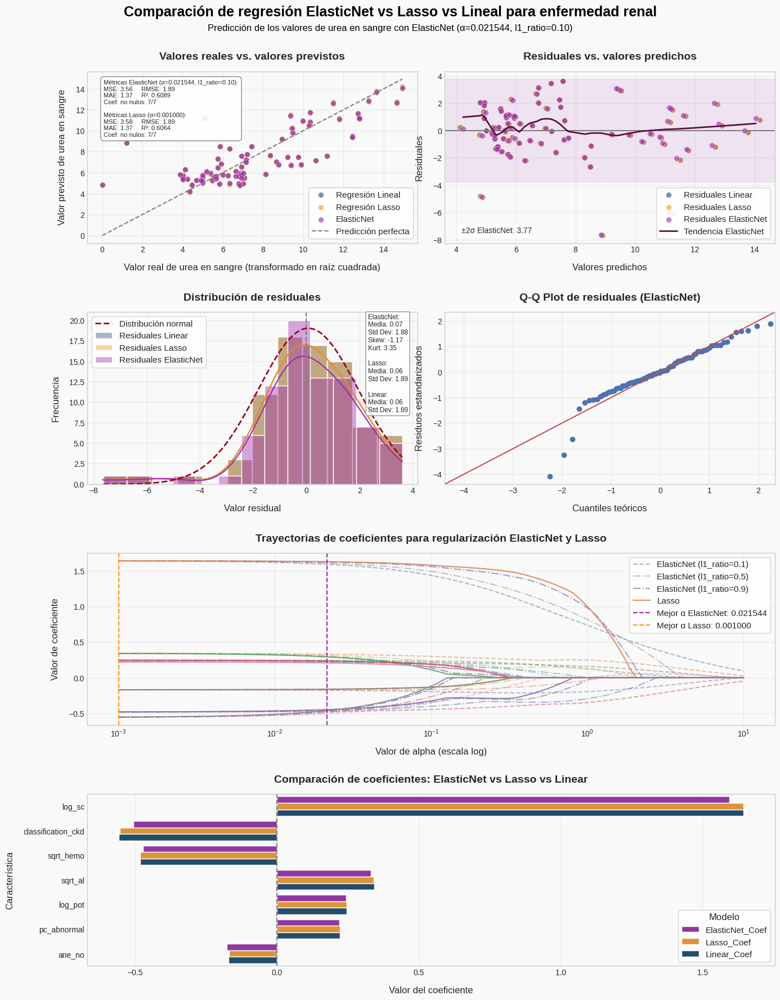

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Lasso, LinearRegression, ElasticNet
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from scipy import stats
from statsmodels.nonparametric.smoothers_lowess import lowess

# Escalar los datos (recomendado para ElasticNet)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Encontrar los mejores hiperparámetros para ElasticNet mediante validación cruzada
alphas = np.logspace(-3, 1, 10)  # Valores de alfa para probar
l1_ratios = np.linspace(0.1, 1.0, 10)  # Valores de l1_ratio (0 = Ridge, 1 = Lasso)

elasticnet_cv = GridSearchCV(
    ElasticNet(random_state=42, max_iter=10000),
    {'alpha': alphas, 'l1_ratio': l1_ratios},
    cv=5,
    scoring='neg_mean_squared_error',
    return_train_score=True,
    n_jobs=-1
)
elasticnet_cv.fit(X_train_scaled, y_train)

# Mostrar resultados de la validación cruzada
cv_results = pd.DataFrame(elasticnet_cv.cv_results_)
best_params = cv_results[cv_results['rank_test_score'] == 1][['param_alpha', 'param_l1_ratio', 'mean_test_score', 'mean_train_score']]
best_params['mean_test_score'] = -best_params['mean_test_score']  # Convertir a MSE positivo
best_params['mean_train_score'] = -best_params['mean_train_score']  # Convertir a MSE positivo
print("🔹 Mejores parámetros para ElasticNet:")
print(best_params)

# Obtener los mejores hiperparámetros
best_alpha = elasticnet_cv.best_params_['alpha']
best_l1_ratio = elasticnet_cv.best_params_['l1_ratio']
print(f"\n🔹 Mejor valor de alpha: {best_alpha}")
print(f"🔹 Mejor valor de l1_ratio: {best_l1_ratio}")

# Entrenar modelos: ElasticNet, Lasso y Lineal para comparación
elasticnet_model = ElasticNet(alpha=best_alpha, l1_ratio=best_l1_ratio, random_state=42, max_iter=10000)
elasticnet_model.fit(X_train_scaled, y_train)
y_pred_elasticnet = elasticnet_model.predict(X_test_scaled)

# También entrenar el modelo Lasso con el mejor valor de alpha
lasso_cv = GridSearchCV(
    Lasso(random_state=42, max_iter=10000),
    {'alpha': alphas},
    cv=5,
    scoring='neg_mean_squared_error',
    return_train_score=True,
    n_jobs=-1
)
lasso_cv.fit(X_train_scaled, y_train)
best_alpha_lasso = lasso_cv.best_params_['alpha']
lasso_model = Lasso(alpha=best_alpha_lasso, random_state=42, max_iter=10000)
lasso_model.fit(X_train_scaled, y_train)
y_pred_lasso = lasso_model.predict(X_test_scaled)

# También entrenar el modelo de regresión lineal para comparación
linear_model = LinearRegression()
linear_model.fit(X_train_scaled, y_train)
y_pred_linear = linear_model.predict(X_test_scaled)

# Calcular residuales para los tres modelos
residuals_elasticnet = y_test - y_pred_elasticnet
residuals_lasso = y_test - y_pred_lasso
residuals_linear = y_test - y_pred_linear

# Calcular diversas métricas de rendimiento para los tres modelos
mse_elasticnet = mean_squared_error(y_test, y_pred_elasticnet)
rmse_elasticnet = np.sqrt(mse_elasticnet)
r2_elasticnet = r2_score(y_test, y_pred_elasticnet)
mae_elasticnet = mean_absolute_error(y_test, y_pred_elasticnet)

mse_lasso = mean_squared_error(y_test, y_pred_lasso)
rmse_lasso = np.sqrt(mse_lasso)
r2_lasso = r2_score(y_test, y_pred_lasso)
mae_lasso = mean_absolute_error(y_test, y_pred_lasso)

mse_linear = mean_squared_error(y_test, y_pred_linear)
rmse_linear = np.sqrt(mse_linear)
r2_linear = r2_score(y_test, y_pred_linear)
mae_linear = mean_absolute_error(y_test, y_pred_linear)

# Contar coeficientes distintos de cero en ElasticNet y Lasso
non_zero_coefs_elasticnet = np.sum(elasticnet_model.coef_ != 0)
non_zero_coefs_lasso = np.sum(lasso_model.coef_ != 0)
total_coefs = len(elasticnet_model.coef_)
print(f"\n🔹 Selección de características ElasticNet: {non_zero_coefs_elasticnet} de {total_coefs} características seleccionadas")
print(f"🔹 Selección de características Lasso: {non_zero_coefs_lasso} de {total_coefs} características seleccionadas")

print("\n🔹 Comparación de métricas:")
print(f"{'-'*45}")
print(f"{'Métrica':<10} {'ElasticNet':<12} {'Lasso':<12} {'Linear':<12}")
print(f"{'-'*45}")
print(f"{'MSE':<10} {mse_elasticnet:<12.4f} {mse_lasso:<12.4f} {mse_linear:<12.4f}")
print(f"{'RMSE':<10} {rmse_elasticnet:<12.4f} {rmse_lasso:<12.4f} {rmse_linear:<12.4f}")
print(f"{'R²':<10} {r2_elasticnet:<12.4f} {r2_lasso:<12.4f} {r2_linear:<12.4f}")
print(f"{'MAE':<10} {mae_elasticnet:<12.4f} {mae_lasso:<12.4f} {mae_linear:<12.4f}")

# Analizar coeficientes
coef_df = pd.DataFrame({
    'Característica': X_train.columns,
    'ElasticNet_Coef': elasticnet_model.coef_,
    'Lasso_Coef': lasso_model.coef_,
    'Linear_Coef': linear_model.coef_
})
coef_df['Abs_ElasticNet_Coef'] = np.abs(coef_df['ElasticNet_Coef'])

# Mostrar top características por importancia
print("\n🔹 Top 10 características por importancia (ElasticNet):")
print(coef_df.sort_values('Abs_ElasticNet_Coef', ascending=False).head(10))
print("\n")

# Configura un estilo visual consistente con una paleta de colores
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.size': 11,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'figure.figsize': (12, 8),
    'figure.dpi': 100,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Definir una paleta de colores cohesiva
colors = {
    'primary': '#1f77b4',
    'secondary': '#ff7f0e',
    'tertiary': '#2ca02c',
    'negative': '#d62728',
    'neutral': '#7f7f7f',
    'background': '#f9f9f9',
    'grid': '#e0e0e0',
    'elasticnet': '#9c27b0',  # Purple for ElasticNet
    'lasso': '#f8961e',
    'linear': '#184e77'
}

# Crear un panel con un aspecto limpio para comparar ElasticNet vs Lasso vs Linear
fig = plt.figure(figsize=(14, 18), facecolor=colors['background'])  # Aumentado la altura para una fila adicional
fig.suptitle('Comparación de regresión ElasticNet vs Lasso vs Lineal para enfermedad renal',
             fontsize=18, fontweight='bold', y=0.985, color='#000000')  # Ajustado 'y' para el nuevo layout

# Añadir un subtítulo ligero con contexto adicional
plt.figtext(0.5, 0.96, f'Predicción de los valores de urea en sangre con ElasticNet (α={best_alpha:.6f}, l1_ratio={best_l1_ratio:.2f})',
            ha='center', fontsize=12, color='#000000')  # Ajustado 'y' para el nuevo layout

# Crear una especificación de cuadrícula personalizada para un mejor diseño con 4 filas y 6 columnas
gs = fig.add_gridspec(4, 6)  # Ahora 4 filas en lugar de 3

# Panel 1: Gráfico real vs. predicho (tres modelos)
ax1 = fig.add_subplot(gs[0, :3])
ax1.set_facecolor(colors['background'])
scatter_linear = ax1.scatter(y_test, y_pred_linear, alpha=0.6, s=50,
                     c=colors['linear'], edgecolor='white', linewidth=0.5, label='Regresión Lineal')
scatter_lasso = ax1.scatter(y_test, y_pred_lasso, alpha=0.6, s=50,
                     c=colors['lasso'], edgecolor='white', linewidth=0.5, label='Regresión Lasso')
scatter_elasticnet = ax1.scatter(y_test, y_pred_elasticnet, alpha=0.6, s=50,
                     c=colors['elasticnet'], edgecolor='white', linewidth=0.5, label='ElasticNet')
ax1.plot([min(y_test.min(), min(y_pred_linear.min(), y_pred_lasso.min(), y_pred_elasticnet.min())),
          max(y_test.max(), max(y_pred_linear.max(), y_pred_lasso.max(), y_pred_elasticnet.max()))],
         [min(y_test.min(), min(y_pred_linear.min(), y_pred_lasso.min(), y_pred_elasticnet.min())),
          max(y_test.max(), max(y_pred_linear.max(), y_pred_lasso.max(), y_pred_elasticnet.max()))],
         '--', color=colors['neutral'], linewidth=1.5, label='Predicción perfecta')
ax1.set_xlabel('Valor real de urea en sangre (transformado en raíz cuadrada)', labelpad=12)
ax1.set_ylabel('Valor previsto de urea en sangre', labelpad=12)
ax1.set_title('Valores reales vs. valores previstos', pad=15, fontweight='bold')
ax1.legend(frameon=True, framealpha=0.9, loc='lower right')

# Cree un cuadro de texto con métricas del modelo
metrics_text = (f"Métricas ElasticNet (α={best_alpha:.6f}, l1_ratio={best_l1_ratio:.2f}):\n"
                f"MSE: {mse_elasticnet:.2f}     RMSE: {rmse_elasticnet:.2f}\n"
                f"MAE: {mae_elasticnet:.2f}     R²: {r2_elasticnet:.4f}\n"
                f"Coef. no nulos: {non_zero_coefs_elasticnet}/{total_coefs}\n\n"
                f"Métricas Lasso (α={best_alpha_lasso:.6f}):\n"
                f"MSE: {mse_lasso:.2f}     RMSE: {rmse_lasso:.2f}\n"
                f"MAE: {mae_lasso:.2f}     R²: {r2_lasso:.4f}\n"
                f"Coef. no nulos: {non_zero_coefs_lasso}/{total_coefs}")
props = dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9, edgecolor=colors['neutral'])
ax1.text(0.05, 0.95, metrics_text, transform=ax1.transAxes, fontsize=8,
         verticalalignment='top', bbox=props)

# Panel 2: Residuales vs. Valores Predichos (tres modelos)
ax2 = fig.add_subplot(gs[0, 3:])
ax2.set_facecolor(colors['background'])
ax2.scatter(y_pred_linear, residuals_linear, alpha=0.6, s=50,
           c=colors['linear'], edgecolor='white', linewidth=0.5, label='Residuales Linear')
ax2.scatter(y_pred_lasso, residuals_lasso, alpha=0.6, s=50,
           c=colors['lasso'], edgecolor='white', linewidth=0.5, label='Residuales Lasso')
ax2.scatter(y_pred_elasticnet, residuals_elasticnet, alpha=0.6, s=50,
           c=colors['elasticnet'], edgecolor='white', linewidth=0.5, label='Residuales ElasticNet')
ax2.axhline(y=0, color=colors['neutral'], linestyle='-', linewidth=1.5)

# Añadir suavizado LOWESS para verificar patrones (ElasticNet)
lowess_y = lowess(residuals_elasticnet, y_pred_elasticnet, frac=0.3)
ax2.plot(lowess_y[:, 0], lowess_y[:, 1], color='#5f0f40', linestyle='-', linewidth=2, label='Tendencia ElasticNet')

ax2.set_xlabel('Valores predichos', labelpad=12)
ax2.set_ylabel('Residuales', labelpad=12)
ax2.set_title('Residuales vs. valores predichos', pad=15, fontweight='bold')
ax2.legend(frameon=True, framealpha=0.9, loc='lower right')

# Agregar una banda horizontal para mostrar la varianza residual
std_resid_elasticnet = np.std(residuals_elasticnet)
ax2.axhspan(-2*std_resid_elasticnet, 2*std_resid_elasticnet, alpha=0.1, color=colors['elasticnet'])
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8)
ax2.text(0.05, 0.05, f"±2σ ElasticNet: {2*std_resid_elasticnet:.2f}", transform=ax2.transAxes, fontsize=10,
         verticalalignment='bottom', bbox=props)

# Panel 3: Distribución de residuales de los tres modelos
ax3 = fig.add_subplot(gs[1, :3])
ax3.set_facecolor(colors['background'])
sns.histplot(residuals_linear, kde=True, ax=ax3, color=colors['linear'], alpha=0.4, label='Residuales Linear')
sns.histplot(residuals_lasso, kde=True, ax=ax3, color=colors['lasso'], alpha=0.4, label='Residuales Lasso')
sns.histplot(residuals_elasticnet, kde=True, ax=ax3, color=colors['elasticnet'], alpha=0.4, label='Residuales ElasticNet')
ax3.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax3.set_xlabel('Valor residual', labelpad=12)
ax3.set_ylabel('Frecuencia', labelpad=12)
ax3.set_title('Distribución de residuales', pad=15, fontweight='bold')

# Añadir curva de distribución normal para comparación (ElasticNet)
x = np.linspace(min(residuals_elasticnet), max(residuals_elasticnet), 100)
params = stats.norm.fit(residuals_elasticnet)
pdf_fitted = stats.norm.pdf(x, *params)
ax3.plot(x, pdf_fitted * len(residuals_elasticnet) * (max(residuals_elasticnet) - min(residuals_elasticnet)) / 10,
                color='#9a031e', linestyle='--', linewidth=2, label='Distribución normal')

ax3.legend(frameon=True)

# Añadir anotaciones sobre la distribución
mean_resid_elasticnet = np.mean(residuals_elasticnet)
mean_resid_lasso = np.mean(residuals_lasso)
mean_resid_linear = np.mean(residuals_linear)
std_resid_elasticnet = np.std(residuals_elasticnet)
std_resid_lasso = np.std(residuals_lasso)
std_resid_linear = np.std(residuals_linear)
skew_resid = stats.skew(residuals_elasticnet)
kurt_resid = stats.kurtosis(residuals_elasticnet)

stats_text = (f"ElasticNet:\nMedia: {mean_resid_elasticnet:.2f}\nStd Dev: {std_resid_elasticnet:.2f}\n"
              f"Skew: {skew_resid:.2f}\nKurt: {kurt_resid:.2f}\n\n"
              f"Lasso:\nMedia: {mean_resid_lasso:.2f}\nStd Dev: {std_resid_lasso:.2f}\n\n"
              f"Linear:\nMedia: {mean_resid_linear:.2f}\nStd Dev: {std_resid_linear:.2f}")
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor=colors['neutral'])
ax3.text(0.85, 0.70, stats_text,
         transform=ax3.transAxes, fontsize=8.5,
         horizontalalignment='left', verticalalignment='center', bbox=props)

# Panel 4: Q-Q Plot de ElasticNet
ax4 = fig.add_subplot(gs[1, 3:])
ax4.set_facecolor(colors['background'])
sm.qqplot(residuals_elasticnet, line='45', fit=True, ax=ax4)
ax4.set_xlabel('Cuantiles teóricos', labelpad=12)
ax4.set_ylabel('Residuos estandarizados', labelpad=12)
for item in ax4.get_children():
    if isinstance(item, plt.Line2D):
        if item.get_linestyle() == 'none':
            item.set_color(colors['elasticnet'])
            item.set_alpha(0.7)
            item.set_markeredgecolor('white')
            item.set_markeredgewidth(0.5)
            item.set_markersize(5)

ax4.set_title('Q-Q Plot de residuales (ElasticNet)', pad=15, fontweight='bold')
ax4.grid(True, alpha=0.3)

# Panel 5: Trayectoria de regularización (recorrido del parámetro alpha)
ax5 = fig.add_subplot(gs[2, :])
ax5.set_facecolor(colors['background'])

# Trayectorias de regularización para diferentes valores de l1_ratio
l1_ratios_to_plot = [0.1, 0.5, 0.9, 1.0]  # 1.0 es equivalente a Lasso
alphas_range = np.logspace(-3, 1, 100)

for l1_ratio in l1_ratios_to_plot:
    coefs = []
    for alpha in alphas_range:
        model = ElasticNet(alpha=alpha, l1_ratio=l1_ratio, random_state=42, max_iter=10000)
        model.fit(X_train_scaled, y_train)
        coefs.append(model.coef_)

    coefs = np.array(coefs)

    for i in range(coefs.shape[1]):
        if np.any(coefs[:, i] != 0):  # Solo plotear coeficientes que no son siempre cero
            if l1_ratio == 1.0:
                label = f"Lasso" if i == 0 else ""
                linestyle = '-'
                alpha = 0.9
            else:
                label = f"ElasticNet (l1_ratio={l1_ratio})" if i == 0 else ""
                linestyle = '--' if l1_ratio < 0.5 else '-.'
                alpha = 0.5 if l1_ratio < 0.9 else 0.7

            ax5.plot(alphas_range, coefs[:, i],
                    linestyle=linestyle, alpha=alpha,
                    label=label)

ax5.axvline(x=best_alpha, color=colors['elasticnet'], linestyle='--', linewidth=1.5,
            label=f'Mejor α ElasticNet: {best_alpha:.6f}')
ax5.axvline(x=best_alpha_lasso, color=colors['lasso'], linestyle='--', linewidth=1.5,
            label=f'Mejor α Lasso: {best_alpha_lasso:.6f}')
ax5.set_xscale('log')
ax5.set_xlabel('Valor de alpha (escala log)', labelpad=12)
ax5.set_ylabel('Valor de coeficiente', labelpad=12)
ax5.set_title('Trayectorias de coeficientes para regularización ElasticNet y Lasso', pad=15, fontweight='bold')
ax5.legend(frameon=True, loc='upper right')

# Panel 6: Importancia de las características y comparación entre ElasticNet, Lasso y Linear
ax6 = fig.add_subplot(gs[3, :])
ax6.set_facecolor(colors['background'])

# Solo mostrar coeficientes no nulos de ElasticNet + los equivalentes de otros modelos
merged_coefs_filtered = coef_df[coef_df['ElasticNet_Coef'] != 0].sort_values('ElasticNet_Coef', key=abs, ascending=False)

if len(merged_coefs_filtered) > 0:
    # Limitar a las top características para una mejor visualización
    top_n = min(10, len(merged_coefs_filtered))
    merged_coefs_filtered = merged_coefs_filtered.head(top_n)

    # Crear un DataFrame para el gráfico de barras
    plot_data = pd.melt(
        merged_coefs_filtered,
        id_vars=['Característica'],
        value_vars=['ElasticNet_Coef', 'Lasso_Coef', 'Linear_Coef'],
        var_name='Modelo',
        value_name='Coefficient'
    )

    # Crear un gráfico de barras agrupadas
    sns.barplot(x='Coefficient', y='Característica', hue='Modelo', data=plot_data,
                palette={'ElasticNet_Coef': colors['elasticnet'],
                         'Lasso_Coef': colors['lasso'],
                         'Linear_Coef': colors['linear']},
                ax=ax6)
    ax6.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
    ax6.set_title('Comparación de coeficientes: ElasticNet vs Lasso vs Linear', pad=15, fontweight='bold')
    ax6.set_xlabel('Valor del coeficiente', labelpad=12)
    ax6.set_ylabel('Característica', labelpad=12)

    legend = ax6.legend(title="Modelo", frameon=True, fancybox=True, loc='lower right')
else:
    # Si ElasticNet elimina todas las características (improbable pero posible)
    ax6.text(0.5, 0.5, "ElasticNet eliminó todas las características",
             horizontalalignment='center', verticalalignment='center',
             fontsize=14, transform=ax6.transAxes)

# Ajustar el diseño
plt.tight_layout()
plt.subplots_adjust(top=0.92, hspace=0.4, wspace=0.3)
plt.show()

In [ ]:
# Calcular AIC y BIC para el modelo ElasticNet
aic_elasticnet, bic_elasticnet = calculate_aic_bic(elasticnet_model, X_train_scaled, y_train)

# Calcular AIC y BIC para el modelo Lineal
aic_linear, bic_linear = calculate_aic_bic(linear_model, X_train_scaled, y_train)

# Mostrar resultados
print("\n🔹 Criterios de información para selección de modelos:")
print(f"{'-'*32}")
print(f"{'Criterio':<10} {'ElasticNet':<12} {'Linear':<12}")
print(f"{'-'*32}")
print(f"{'AIC':<10} {aic_elasticnet:<12.2f} {aic_linear:<12.2f}")
print(f"{'BIC':<10} {bic_elasticnet:<12.2f} {bic_linear:<12.2f}")


🔹 Criterios de información para selección de modelos:
--------------------------------
Criterio   ElasticNet   Linear      
--------------------------------
AIC        1183.07      1182.72     
BIC        1213.22      1212.87     


Los mejores hiperparámetros obtenidos mediante validación cruzada fueron:
*   Alpha: 0.0215
*   L1_ratio: 0.10

Este valor sugiere que el modelo se apoya principalmente en la penalización tipo Ridge (90%), manteniendo una pequeña contribución Lasso (10%). Este equilibrio favorece la estabilidad del modelo sin perder capacidad de selección de variables.

Además, `ElasticNet` retuvo las 7 variables utilizadas, al igual que el modelo Lasso, lo cual indica que todas las características aportan información relevante para la predicción.

Por lo que hace al desempeño del modelo, este fue comparado con Lasso y la regresión lineal estándar. Los resultados fueron los siguientes:

  <table border="1">
    <tr>
      <th>Métrica</th>
      <th>ElasticNet</th>
      <th>Lasso</th>
      <th>Linear</th>
    </tr>
    <tr>
      <td>MSE</td>
      <td>3.5569</td>
      <td>3.5797</td>
      <td>3.5806</td>
    </tr>
    <tr>
      <td>RMSE</td>
      <td>1.8860</td>
      <td>1.8920</td>
      <td>1.8922</td>
    </tr>
    <tr>
      <td>R²</td>
      <td>0.6089</td>
      <td>0.6064</td>
      <td>0.6063</td>
    </tr>
    <tr>
      <td>MAE</td>
      <td>1.3697</td>
      <td>1.3727</td>
      <td>1.3732</td>
    </tr>
  </table>

`ElasticNet` mostró una mejora marginal pero consistente en todas las métricas, explicando aproximadamente un 61% de la variabilidad en los niveles de urea. Esta ligera superioridad sugiere que la combinación de regularizaciones mejora la capacidad predictiva sin incrementar el sobreajuste.

En términos de criterios de información, los resultados fueron similares:
  <table border="1">
    <tr>
      <th></th>
      <th>ElasticNet</th>
      <th>Linear</th>
    </tr>
    <tr>
      <td>AIC</td>
      <td>1183.07</td>
      <td>1182.72</td>
    </tr>
    <tr>
      <td>BIC</td>
      <td>1213.22</td>
      <td>1212.87</td>
    <tr>
  </table>

Aunque los valores son muy cercanos, `ElasticNet` ofrece un equilibrio más robusto entre ajuste y penalización.

**Análisis de coeficientes:**

Las variables más influyentes en `ElasticNet`, según el valor absoluto de sus coeficientes, fueron:
*   `log_sc` (1.60): es el mejor indicador de los niveles de urea en la sangre.
*   `classification_ckd` (-0.51): fuerte relación negativa con la variable objetivo.
*   `sqrt_hemo` (-0.47): refleja posible impacto de la anemia.
*   `sqrt_al` (0.33): la albúmina elevada se asocia positivamente con la severidad de la enfermedad.

Los signos y magnitudes de los coeficientes presentan una coherencia clínica y fisiopatológica con la enfermedad renal, reforzando la interpretabilidad del modelo.

**Análisis visual y diagnóstico de residuales:**

*   Distribución de residuales: aproximadamente normal, con media cercana a 0 (0.07) y desviación estándar de 1.88. La curtosis (3.77) sugiere colas ligeramente más pesadas que la distribución normal.
*   Q-Q plot: los residuales siguen en gran medida la línea teórica, aunque se detectan leves desviaciones en los valores extremos negativos.
*   Valores reales vs. predichos: se observa un buen ajuste general, con ligera tendencia a la sobrepredicción en valores altos.

El análisis gráfico refuerza la calidad del ajuste y la estabilidad del modelo frente a variaciones en los datos.

**Conclusiones:**

`ElasticNet` demostró ser un modelo ligeramente superior a Lasso y a la regresión lineal tradicional, tanto en términos de precisión como de estabilidad. Su capacidad para mantener todas las variables relevantes, evitar el sobreajuste y ofrecer interpretabilidad clínica lo convierten en una alternativa sólida.

En resumen:
*   La regularización mixta aporta flexibilidad y robustez.
*   Las variables seleccionadas son clínicamente significativas.
*   El modelo mantiene un buen equilibrio entre ajuste y simplicidad, siendo apto para aplicaciones en contextos clínicos donde se requiere tanto precisión como interpretabilidad.


#### 5.5.2. Regresión polinómica

Una vez implementados modelos lineales como `ElasticNet`, puede resultar útil investigar si ciertas relaciones entre las variables predictoras y la variable objetivo presentan comportamientos no lineales.

Para ello, hemos recurrido a la regresión polinómica, una extensión del modelo lineal que permite capturar curvaturas y tendencias más complejas en los datos. Esta es una técnica que modela la relación entre la variable independiente y la dependiente como un polinomio de grado n. En nuestro caso, hemos seleccionado un polinomio de segundo grado (cuadrático) para detectar posibles curvaturas suaves en la relación entre las variables predictoras y la respuesta transformada "sqrt_bu".

El siguiente fragmento de código genera una serie de gráficos de regresión polinómica que exploran la relación entre cada variable predictora numérica y la variable objetivo "sqrt_bu". Esto permite detectar visualmente patrones curvilíneos que podrían justificar el uso de transformaciones no lineales o modelos más flexibles en etapas posteriores del análisis.

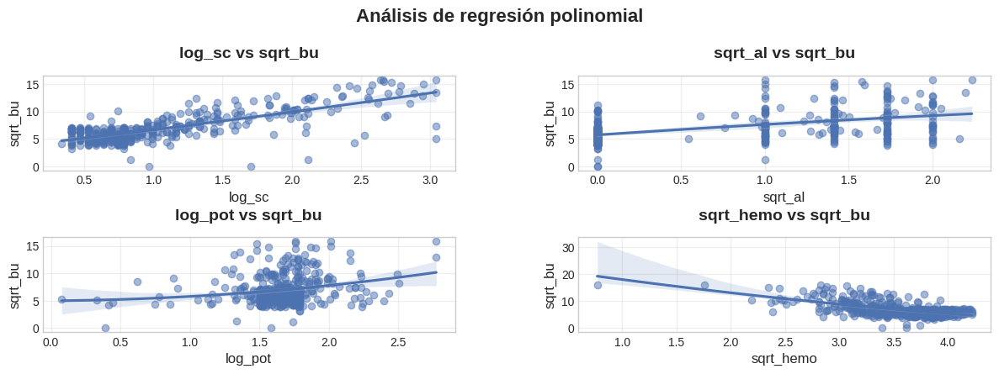

In [ ]:
plt.figure(figsize=(12, 10))

plt.suptitle("Análisis de regresión polinomial", fontsize=16, fontweight='bold')

# Generar gráficos de regresión polinomial para cada predictor numérico frente a "sqrt_bu"
for i, predictor in enumerate(numeric_predictors_2, 1):
    plt.subplot(5, 2, i)
    sns.regplot(x=encoded_kidney_df[predictor], y=encoded_kidney_df["sqrt_bu"],
                order=2, scatter_kws={"alpha": 0.5})
    plt.title(f"{predictor} vs sqrt_bu", fontweight='bold', pad=15)

plt.tight_layout()
plt.subplots_adjust(top=0.9, hspace=0.7, wspace=0.3)
plt.show()

Aunque este enfoque ofrece una visión preliminar útil, tiene varias limitaciones cuando las interacciones entre variables son complejas o multidimensionales, ya que requeriría combinar manualmente distintas variables y probar múltiples transformaciones. Modelar cada relación individualmente no captura interacciones entre variables y puede resultar tedioso y redundante cuando se tienen muchas variables predictoras.

#### 5.5.3. Extreme Gradient Boosting (XGBoost)

Tras evaluar los anteriores pasos realizados, nos ha surgido una reflexión importante: aunque algunos patrones curvilíneos pueden ser detectables visualmente, muchas relaciones entre variables predictoras y la respuesta pueden ser más complejas o estar determinadas por interacciones entre múltiples variables. En este contexto, hemos considerado que una alternativa poderosa y flexible es el uso de modelos basados en árboles de decisión, como XGBoost (Extreme Gradient Boosting).

Este es un potente algoritmo de aprendizaje supervisado basado en el método de boosting de gradiente. Se trata de un modelo predictivo no lineal, que combina múltiples árboles de decisión "débiles" (poco profundos) para formar un modelo "fuerte" a través de un proceso iterativo de corrección de errores.

Además, a diferencia de los modelos lineales tradicionales, XGBoost no requiere suposiciones estrictas sobre la distribución de los datos o sobre la forma funcional de las relaciones entre variables. Esto lo hace especialmente útil en contextos como el nuestro, donde la relación entre indicadores clínicos y la variable objetivo "sqrt_bu" podría estar gobernada por múltiples factores no lineales y combinaciones de atributos.

En el código que tenemos a continuación entrenamos un modelo XGBoost para predecir los niveles de "sqrt_bu" utilizando una combinación de variables clínicas numéricas y categóricas. Posteriormente, evaluamos el desempeño del modelo mediante múltiples métricas (MSE, RMSE, MAE, R²) y visualizaciones diagnósticas de los residuales, así como la interpretación de los predictores clave mediante gráficos de importancia y valores SHAP.

🔹 Resultados de validación cruzada para diferentes hiperparámetros:
                                               params  mean_test_score  \
63  {'colsample_bytree': 1.0, 'learning_rate': 0.0...             2.38   
64  {'colsample_bytree': 1.0, 'learning_rate': 0.0...             2.41   
72  {'colsample_bytree': 1.0, 'learning_rate': 0.1...             2.42   
56  {'colsample_bytree': 1.0, 'learning_rate': 0.0...             2.43   
46  {'colsample_bytree': 0.8, 'learning_rate': 0.1...             2.50   

    mean_train_score  
63              1.31  
64              0.96  
72              0.97  
56              1.48  
46              0.70  

🔹 Mejores hiperparámetros: {'colsample_bytree': 1.0, 'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 50}

🔹 Características importantes: 6 de 7 características

🔹 Comparación de métricas:
--------------------------------
Métrica    XGBoost      Linear      
--------------------------------
MSE        3.2358       3.5806      
RMSE       1.

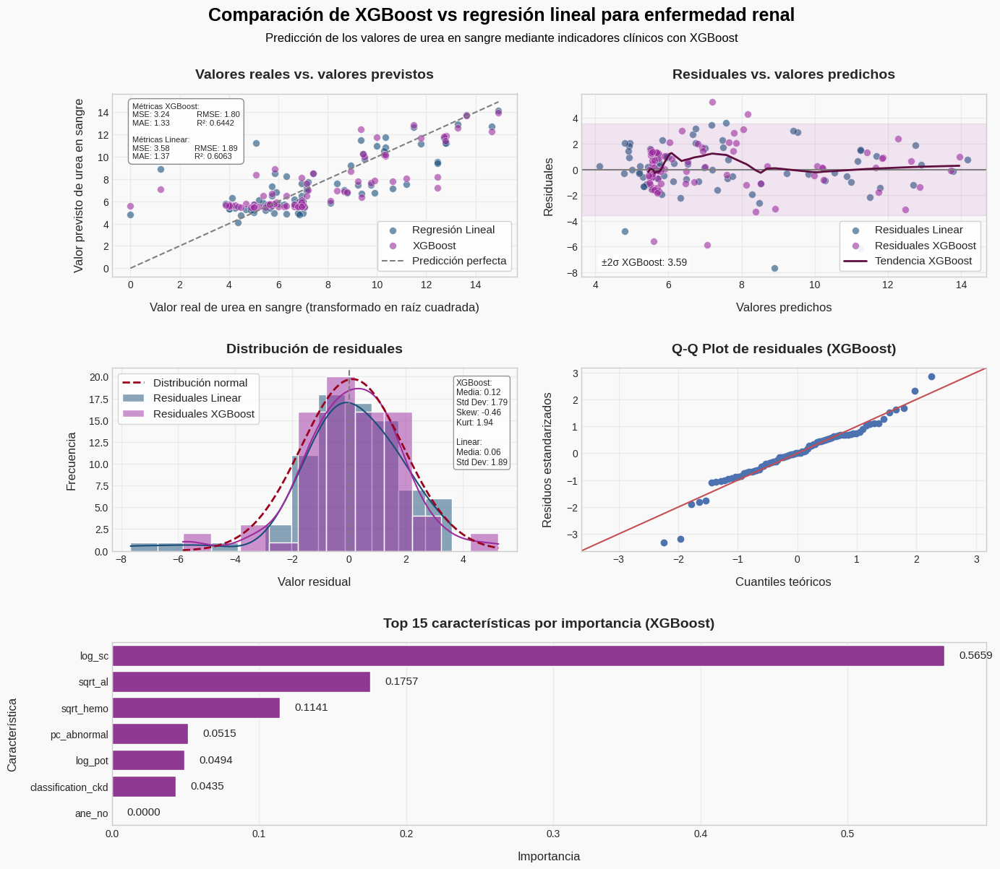

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from scipy import stats
from statsmodels.nonparametric.smoothers_lowess import lowess
import xgboost as xgb

# Escalar los datos
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Encontrar los mejores hiperparámetros para XGBoost mediante validación cruzada
param_grid = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 5, 7],
    'colsample_bytree': [0.7, 0.8, 1.0]
}

xgb_cv = GridSearchCV(
    xgb.XGBRegressor(objective='reg:squarederror', random_state=42),
    param_grid,
    cv=5,
    scoring='neg_mean_squared_error',
    return_train_score=True,
    n_jobs=-1
)
xgb_cv.fit(X_train_scaled, y_train)

# Mostrar resultados de la validación cruzada
cv_results = pd.DataFrame(xgb_cv.cv_results_)
cv_results = cv_results[['params', 'mean_test_score', 'mean_train_score']]
cv_results['mean_test_score'] = -cv_results['mean_test_score']  # Convertir a MSE positivo
cv_results['mean_train_score'] = -cv_results['mean_train_score']  # Convertir a MSE positivo
print("🔹 Resultados de validación cruzada para diferentes hiperparámetros:")
print(cv_results.sort_values('mean_test_score').head(5))  # Mostrar los 5 mejores conjuntos de parámetros

# Obtener los mejores hiperparámetros
best_params = xgb_cv.best_params_
print(f"\n🔹 Mejores hiperparámetros: {best_params}")

# Entrenar el modelo XGBoost con los mejores hiperparámetros
xgb_model = xgb.XGBRegressor(
    objective='reg:squarederror',
    random_state=42,
    **best_params
)
xgb_model.fit(X_train_scaled, y_train)
y_pred_xgb = xgb_model.predict(X_test_scaled)

# También entrenar el modelo de regresión lineal para comparación
linear_model = LinearRegression()
linear_model.fit(X_train_scaled, y_train)
y_pred_linear = linear_model.predict(X_test_scaled)

# Calcular residuales para ambos modelos
residuals_xgb = y_test - y_pred_xgb
residuals_linear = y_test - y_pred_linear

# Calcular diversas métricas de rendimiento para ambos modelos
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
rmse_xgb = np.sqrt(mse_xgb)
r2_xgb = r2_score(y_test, y_pred_xgb)
mae_xgb = mean_absolute_error(y_test, y_pred_xgb)

mse_linear = mean_squared_error(y_test, y_pred_linear)
rmse_linear = np.sqrt(mse_linear)
r2_linear = r2_score(y_test, y_pred_linear)
mae_linear = mean_absolute_error(y_test, y_pred_linear)

# Obtener la importancia de características de XGBoost
feature_importance = xgb_model.feature_importances_
total_features = len(feature_importance)
important_features = np.sum(feature_importance > 0)
print(f"\n🔹 Características importantes: {important_features} de {total_features} características")

print("\n🔹 Comparación de métricas:")
print(f"{'-'*32}")
print(f"{'Métrica':<10} {'XGBoost':<12} {'Linear':<12}")
print(f"{'-'*32}")
print(f"{'MSE':<10} {mse_xgb:<12.4f} {mse_linear:<12.4f}")
print(f"{'RMSE':<10} {rmse_xgb:<12.4f} {rmse_linear:<12.4f}")
print(f"{'R²':<10} {r2_xgb:<12.4f} {r2_linear:<12.4f}")
print(f"{'MAE':<10} {mae_xgb:<12.4f} {mae_linear:<12.4f}")

# Analizar importancia de características
importance_df = pd.DataFrame({
    'Característica': X_train.columns,
    'Importancia': xgb_model.feature_importances_
})
importance_df = importance_df.sort_values('Importancia', ascending=False)

print("\n🔹 Top 10 características por importancia (XGBoost):")
print(importance_df.head(10))
print("\n")

# Configura un estilo visual consistente con una paleta de colores
plt.rcParams.update({
    'font.family': 'sans-serif',
    'font.size': 11,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'figure.figsize': (12, 8),
    'figure.dpi': 100,
    'axes.grid': True,
    'grid.alpha': 0.3
})

# Definir una paleta de colores cohesiva
colors = {
    'primary': '#1f77b4',
    'secondary': '#ff7f0e',
    'tertiary': '#2ca02c',
    'negative': '#d62728',
    'neutral': '#7f7f7f',
    'background': '#f9f9f9',
    'grid': '#e0e0e0',
    'xgboost': '#9c2ca0',  # Color para XGBoost
    'linear': '#184e77'
}

# Crear un panel con un aspecto limpio para comparar XGBoost vs Linear
fig = plt.figure(figsize=(14, 12), facecolor=colors['background'])
fig.suptitle('Comparación de XGBoost vs regresión lineal para enfermedad renal',
             fontsize=18, fontweight='bold', y=1, color='#000000')

# Añadir un subtítulo ligero con contexto adicional
plt.figtext(0.5, 0.96, 'Predicción de los valores de urea en sangre mediante indicadores clínicos con XGBoost',
            ha='center', fontsize=12, color='#000000')

# Crear una especificación de cuadrícula personalizada para un mejor diseño
gs = fig.add_gridspec(3, 6)

# Panel 1: Gráfico real vs. predicho (ambos modelos)
ax1 = fig.add_subplot(gs[0, :3])
ax1.set_facecolor(colors['background'])
scatter_linear = ax1.scatter(y_test, y_pred_linear, alpha=0.6, s=50,
                     c=colors['linear'], edgecolor='white', linewidth=0.5, label='Regresión Lineal')
scatter_xgb = ax1.scatter(y_test, y_pred_xgb, alpha=0.6, s=50,
                     c=colors['xgboost'], edgecolor='white', linewidth=0.5, label='XGBoost')
ax1.plot([min(y_test.min(), min(y_pred_linear.min(), y_pred_xgb.min())),
          max(y_test.max(), max(y_pred_linear.max(), y_pred_xgb.max()))],
         [min(y_test.min(), min(y_pred_linear.min(), y_pred_xgb.min())),
          max(y_test.max(), max(y_pred_linear.max(), y_pred_xgb.max()))],
         '--', color=colors['neutral'], linewidth=1.5, label='Predicción perfecta')
ax1.set_xlabel('Valor real de urea en sangre (transformado en raíz cuadrada)', labelpad=12)
ax1.set_ylabel('Valor previsto de urea en sangre', labelpad=12)
ax1.set_title('Valores reales vs. valores previstos', pad=15, fontweight='bold')
ax1.legend(frameon=True, framealpha=0.9, loc='lower right')

# Cree un cuadro de texto con métricas del modelo
metrics_text = (f"Métricas XGBoost:\n"
                f"MSE: {mse_xgb:.2f}            RMSE: {rmse_xgb:.2f}\n"
                f"MAE: {mae_xgb:.2f}            R²: {r2_xgb:.4f}\n\n"
                f"Métricas Linear:\n"
                f"MSE: {mse_linear:.2f}           RMSE: {rmse_linear:.2f}\n"
                f"MAE: {mae_linear:.2f}           R²: {r2_linear:.4f}")
props = dict(boxstyle='round,pad=0.5', facecolor='white', alpha=0.9, edgecolor=colors['neutral'])
ax1.text(0.05, 0.95, metrics_text, transform=ax1.transAxes, fontsize=8,
         verticalalignment='top', bbox=props)

# Panel 2: Residuales vs. Valores Predichos (ambos modelos)
ax2 = fig.add_subplot(gs[0, 3:])
ax2.set_facecolor(colors['background'])
ax2.scatter(y_pred_linear, residuals_linear, alpha=0.6, s=50,
           c=colors['linear'], edgecolor='white', linewidth=0.5, label='Residuales Linear')
ax2.scatter(y_pred_xgb, residuals_xgb, alpha=0.6, s=50,
           c=colors['xgboost'], edgecolor='white', linewidth=0.5, label='Residuales XGBoost')
ax2.axhline(y=0, color=colors['neutral'], linestyle='-', linewidth=1.5)

# Añadir suavizado LOWESS para verificar patrones
lowess_y = lowess(residuals_xgb, y_pred_xgb, frac=0.3)
ax2.plot(lowess_y[:, 0], lowess_y[:, 1], color='#5f0f40', linestyle='-', linewidth=2, label='Tendencia XGBoost')

ax2.set_xlabel('Valores predichos', labelpad=12)
ax2.set_ylabel('Residuales', labelpad=12)
ax2.set_title('Residuales vs. valores predichos', pad=15, fontweight='bold')
ax2.legend(frameon=True, framealpha=0.9, loc='lower right')

# Agregar una banda horizontal para mostrar la varianza residual
std_resid_xgb = np.std(residuals_xgb)
ax2.axhspan(-2*std_resid_xgb, 2*std_resid_xgb, alpha=0.1, color=colors['xgboost'])
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8)
ax2.text(0.05, 0.05, f"±2σ XGBoost: {2*std_resid_xgb:.2f}", transform=ax2.transAxes, fontsize=10,
         verticalalignment='bottom', bbox=props)

# Panel 3: Distribución de residuales de ambos modelos
ax3 = fig.add_subplot(gs[1, :3])
ax3.set_facecolor(colors['background'])
sns.histplot(residuals_linear, kde=True, ax=ax3, color=colors['linear'], alpha=0.5, label='Residuales Linear')
sns.histplot(residuals_xgb, kde=True, ax=ax3, color=colors['xgboost'], alpha=0.5, label='Residuales XGBoost')
ax3.axvline(x=0, color=colors['neutral'], linestyle='--', linewidth=1.5)
ax3.set_xlabel('Valor residual', labelpad=12)
ax3.set_ylabel('Frecuencia', labelpad=12)
ax3.set_title('Distribución de residuales', pad=15, fontweight='bold')

# Añadir curva de distribución normal para comparación
x = np.linspace(min(residuals_xgb), max(residuals_xgb), 100)
params = stats.norm.fit(residuals_xgb)
pdf_fitted = stats.norm.pdf(x, *params)
ax3.plot(x, pdf_fitted * len(residuals_xgb) * (max(residuals_xgb) - min(residuals_xgb)) / 10,
                color='#9a031e', linestyle='--', linewidth=2, label='Distribución normal')

ax3.legend(frameon=True)

# Añadir anotaciones sobre la distribución
mean_resid_xgb = np.mean(residuals_xgb)
mean_resid_linear = np.mean(residuals_linear)
std_resid_linear = np.std(residuals_linear)
skew_resid = stats.skew(residuals_xgb)
kurt_resid = stats.kurtosis(residuals_xgb)

stats_text = (f"XGBoost:\nMedia: {mean_resid_xgb:.2f}\nStd Dev: {std_resid_xgb:.2f}\n"
              f"Skew: {skew_resid:.2f}\nKurt: {kurt_resid:.2f}\n\n"
              f"Linear:\nMedia: {mean_resid_linear:.2f}\nStd Dev: {std_resid_linear:.2f}")
props = dict(boxstyle='round,pad=0.3', facecolor='white', alpha=0.8, edgecolor=colors['neutral'])
ax3.text(0.85, 0.70, stats_text,
         transform=ax3.transAxes, fontsize=8.5,
         horizontalalignment='left', verticalalignment='center', bbox=props)

# Panel 4: Q-Q Plot de XGBoost
ax4 = fig.add_subplot(gs[1, 3:])
ax4.set_facecolor(colors['background'])
sm.qqplot(residuals_xgb, line='45', fit=True, ax=ax4)
ax4.set_xlabel('Cuantiles teóricos', labelpad=12)
ax4.set_ylabel('Residuos estandarizados', labelpad=12)
for item in ax4.get_children():
    if isinstance(item, plt.Line2D):
        if item.get_linestyle() == 'none':
            item.set_color(colors['xgboost'])
            item.set_alpha(0.7)
            item.set_markeredgecolor('white')
            item.set_markeredgewidth(0.5)
            item.set_markersize(5)

ax4.set_title('Q-Q Plot de residuales (XGBoost)', pad=15, fontweight='bold')
ax4.grid(True, alpha=0.3)

# Panel 5: Importancia de las características para XGBoost
ax5 = fig.add_subplot(gs[2, :])
ax5.set_facecolor(colors['background'])

# Crear un gráfico de barras para la importancia de características
importance_plot = importance_df.head(15)  # Tomar las 15 características más importantes
sns.barplot(x='Importancia', y='Característica', data=importance_plot, color=colors['xgboost'], ax=ax5)
ax5.set_title('Top 15 características por importancia (XGBoost)', pad=15, fontweight='bold')
ax5.set_xlabel('Importancia', labelpad=12)
ax5.set_ylabel('Característica', labelpad=12)

# Agregar valores numéricos a las barras
for i, v in enumerate(importance_plot['Importancia']):
    ax5.text(v + 0.01, i, f"{v:.4f}", va='center')

# Ajustar el diseño
plt.tight_layout()
plt.subplots_adjust(top=0.9, hspace=0.5, wspace=0.7)
plt.show()

Mediante validación cruzada, se determinaron los siguientes hiperparámetros óptimos:
*   `learning_rate: 0.05` este parámetro regula la tasa de aprendizaje del modelo, controlando cuánto se ajustan los pesos en cada iteración. Un valor bajo como 0.05 permite una convergencia más suave y reduce el riesgo de sobreajuste, aunque requiere un mayor número de iteraciones para lograr una buena capacidad predictiva.
*   `max_depth: 3` limita la profundidad máxima de cada árbol individual. Una profundidad reducida restringe la complejidad del modelo, favoreciendo su capacidad de generalización y previniendo el ajuste excesivo a los datos de entrenamiento
*   `n_estimators: 50` representa el número total de árboles generados mediante boosting. En combinación con un learning rate bajo, este número de árboles resulta suficiente para que el modelo alcance un equilibrio entre sesgo y varianza, sin incurrir en sobreajuste.
*   `colsample_bytree: 1.0` especifica la proporción de características (features) utilizadas al construir cada árbol. El valor de 1.0 implica que se consideraron todas las variables disponibles, lo cual maximiza el aprovechamiento de la información presente en los datos sin introducir un sesgo por muestreo.

Estos parámetros configuran un modelo de complejidad moderada, con buena capacidad de generalización y resistencia al sobreajuste. El modelo alcanzó un mean test score de 2.38, frente a un mean train score de 1.31, lo cual evidencia un equilibrio adecuado entre bias y varianza.

Por lo que hace a los resultados obtenidos, estos indican que XGBoost supera consistentemente a la regresión lineal en todas las métricas evaluadas:


Métrica	XGBoost	Lineal	Mejora relativa
MSE	3.2358	3.5806	9.6%
RMSE	1.7988	1.8922	4.9%
R²	0.6442	0.6063	6.3%
MAE	1.3314	1.3732	3.0%
El modelo explica aproximadamente el 64.4% de la variabilidad en los niveles de urea, mejorando el poder explicativo en más de seis puntos porcentuales respecto a la regresión lineal. Esta ventaja destaca la capacidad del modelo para capturar relaciones no lineales y estructuras de interacción complejas.

Además, el análisis de los residuos apoya el buen ajuste del modelo:
*   Media: 0.12
*   Desviación estándar: 1.78
*   Asimetría: -0.46
*   Kurtosis: 1.94

Los residuos están más concentrados en torno a cero, con menor dispersión que en modelos lineales. El Q-Q plot indica un ajuste razonable a la normalidad, salvo en valores extremos negativos. En el gráfico de residuales vs predicción se observa una distribución homogénea sin patrones claros, aunque con leve heterocedasticidad. Además, el 95% de los residuales se encuentran dentro de ±2 desviaciones estándar (±3.59), lo cual respalda la robustez del modelo.

**Importancia de las variables:**

XGBoost identificó como más relevantes las siguientes variables:


Variable	Importancia
log_sc	0.57
sqrt_al	0.18
sqrt_hemo	0.11
pc_abnormal	0.05
log_pot	0.05
classification_ckd	0.04
ane_no	0.00
El modelo seleccionó automáticamente 6 de las 7 variables, descartando "ane_no" por su escasa relevancia predictiva. A diferencia de los modelos lineales, XGBoost no proporciona información sobre la dirección del efecto (positivo o negativo), sino sobre su contribución relativa a las predicciones.

Interpretación Clínica
Desde una perspectiva clínica, los resultados del modelo son coherentes con los mecanismos fisiopatológicos subyacentes:

log_sc (0.57): es el predictor más fuerte de la urea, lo que refleja su papel como marcador clave de la función renal.
sqrt_al (0.18): se asocia positivamente con la gravedad de la enfermedad renal.

sqrt_hemo (hemoglobina) subraya la relevancia de los niveles bajos de hemoglobina como manifestación de anemia en pacientes con ERC.

Las variables bioquímicas mostraron mayor influencia que las clasificaciones clínicas binarias, lo que resalta la utilidad de medidas continuas y cuantificables en la predicción clínica.

Conclusiones del Análisis con XGBoost
XGBoost demostró ser la alternativa más precisa entre los modelos evaluados, con mejoras sustanciales en todas las métricas y un ajuste más refinado de los residuos. Su capacidad para modelar relaciones no lineales, manejar valores atípicos y seleccionar automáticamente las variables más relevantes lo convierte en una herramienta potente en contextos clínicos donde se prioriza la precisión.

Aunque su interpretación es menos directa que en modelos lineales, la coherencia de las variables seleccionadas y su relevancia clínica refuerzan la viabilidad de XGBoost en la predicción de marcadores de enfermedad renal. Por tanto, este modelo representa una opción robusta y efectiva para apoyar decisiones médicas basadas en datos, especialmente en aplicaciones donde la complejidad de las relaciones entre variables puede limitar el desempeño de los enfoques tradicionales.

Para una comparación más exhaustiva entre modelos, especialmente en contextos donde los extremos del rango de valores pueden ser clínicamente relevantes, se propone un análisis basado en la evaluación por cuartiles y en el comportamiento de los residuos. Esta estrategia permite no solo medir el rendimiento global de un modelo, sino también su consistencia local a lo largo de diferentes segmentos del rango de predicción.

*   Como primer paso, se aplica una validación cruzada de 5 pliegues, donde:
    *   Se entrena y evalúa cada modelo cinco veces en distintos subconjuntos de los datos.
    *   Se promedian los resultados para obtener una estimación más robusta del rendimiento general.

 Este procedimiento ayuda a reducir el sesgo asociado a una sola partición de entrenamiento/prueba, y da una mejor idea del comportamiento del modelo frente a datos no vistos.

*   A continuación, se analizan tres aspectos clave:
    *   Error medio cuadrático (MSE) con desviación estándar, para comparar precisión promedio.
    *   Matriz de confusión por cuartiles, para evaluar qué tan bien los modelos capturan distintos niveles de la variable objetivo.
    *   Distribución de errores (residuos) por cuartiles, con estadísticas resumen y visualización mediante diagramas de caja.

--------------------------------------------------
 📊 ANÁLISIS ADICIONAL DE COMPARACIÓN DE MODELOS
--------------------------------------------------

🔹 Validación cruzada (5-fold):
XGBoost - MSE medio: 2.3782,     Desv. estándar: 0.4224
Linear  - MSE medio: 2.3460,      Desv. estándar: 0.4882

🔹 Matriz de confusión de cuartiles (XGBoost):
Predicho (Cuartil)   0   1  2   3
Real (Cuartil)                   
0                   11   6  2   1
1                    8  10  4   1
2                    1   4  8   4
3                    0   0  6  14
Precisión de cuartiles (XGBoost): 0.5375

🔹 Matriz de confusión de cuartiles (Linear):
Predicho (Cuartil)   0   1  2   3
Real (Cuartil)                   
0                   11   7  1   1
1                    7  10  6   0
2                    2   3  9   3
3                    0   0  4  16
Precisión de cuartiles (Linear): 0.5750

🔹 Análisis residual por cuartiles (XGBoost):
          mean  std  median
quartile                   
Q1       -1.68 1.53  

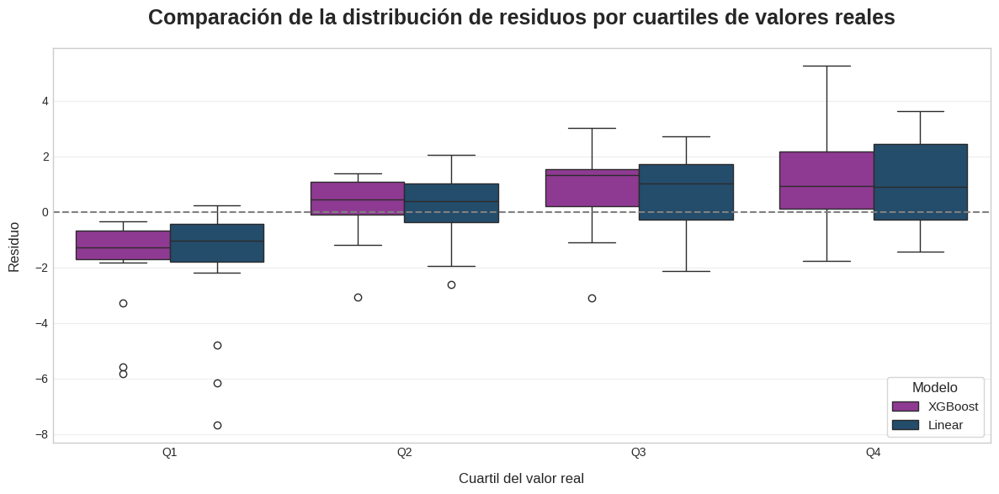

In [ ]:
print(f"{'-'*50}")
print(" 📊 ANÁLISIS ADICIONAL DE COMPARACIÓN DE MODELOS")
print(f"{'-'*50}"+"\n")

# 1. Validación cruzada para ambos modelos
from sklearn.model_selection import cross_val_score

# Definir los modelos sin ajustar
xgb_model_cv = xgb.XGBRegressor(objective='reg:squarederror', random_state=42, **best_params)
linear_model_cv = LinearRegression()

# Realizar validación cruzada con 5 pliegues
cv_results_xgb = cross_val_score(xgb_model_cv, X_train_scaled, y_train, cv=5,
                                scoring='neg_mean_squared_error')
cv_results_linear = cross_val_score(linear_model_cv, X_train_scaled, y_train, cv=5,
                                   scoring='neg_mean_squared_error')

# Convertir a MSE positivo
cv_mse_xgb = -cv_results_xgb
cv_mse_linear = -cv_results_linear

# Mostrar resultados de validación cruzada
print("🔹 Validación cruzada (5-fold):")
print(f"XGBoost - MSE medio: {cv_mse_xgb.mean():.4f},     Desv. estándar: {cv_mse_xgb.std():.4f}")
print(f"Linear  - MSE medio: {cv_mse_linear.mean():.4f},      Desv. estándar: {cv_mse_linear.std():.4f}")

# 2. Matriz de confusión de cuartiles
# Esta técnica compara cómo se sitúan las predicciones en cuartiles respecto a los valores reales
def quartile_confusion_matrix(y_true, y_pred):
    # Calcular cuartiles
    q_true = pd.qcut(y_true, 4, labels=False)
    q_pred = pd.qcut(y_pred, 4, labels=False)

    # Crear matriz de confusión
    conf_matrix = pd.crosstab(q_true, q_pred,
                             rownames=['Real (Cuartil)'],
                             colnames=['Predicho (Cuartil)'])

    # Calcular precisión por cuartil
    accuracy = np.sum(q_true == q_pred) / len(q_true)

    return conf_matrix, accuracy

# Calcular matrices de confusión de cuartiles
conf_matrix_xgb, acc_xgb = quartile_confusion_matrix(y_test, y_pred_xgb)
conf_matrix_linear, acc_linear = quartile_confusion_matrix(y_test, y_pred_linear)

print("\n🔹 Matriz de confusión de cuartiles (XGBoost):")
print(conf_matrix_xgb)
print(f"Precisión de cuartiles (XGBoost): {acc_xgb:.4f}")

print("\n🔹 Matriz de confusión de cuartiles (Linear):")
print(conf_matrix_linear)
print(f"Precisión de cuartiles (Linear): {acc_linear:.4f}")

# 3. Análisis residual por cuartiles
def residual_analysis_by_quartile(y_true, y_pred):
    # Crear DataFrame con valores reales, predicciones y residuos
    df_analysis = pd.DataFrame({
        'real': y_true,
        'pred': y_pred,
        'residual': y_true - y_pred
    })

    # Asignar cuartiles basados en valores reales
    df_analysis['quartile'] = pd.qcut(df_analysis['real'], 4, labels=['Q1', 'Q2', 'Q3', 'Q4'])

    # Calcular estadísticas por cuartil
    quartile_stats = df_analysis.groupby('quartile')['residual'].agg(['mean', 'std', 'median'])

    return quartile_stats

# Realizar análisis residual por cuartiles
res_quartile_xgb = residual_analysis_by_quartile(y_test, y_pred_xgb)
res_quartile_linear = residual_analysis_by_quartile(y_test, y_pred_linear)

print("\n🔹 Análisis residual por cuartiles (XGBoost):")
print(res_quartile_xgb)

print("\n🔹 Análisis residual por cuartiles (Linear):")
print(res_quartile_linear)
print("\n")

# 4. Diagrama de cajas comparativo de residuos por cuartiles
plt.figure(figsize=(12, 6))

# Crear DataFrames para la visualización
df_resid_xgb = pd.DataFrame({
    'real': y_test,
    'residual': residuals_xgb,
    'Modelo': 'XGBoost'
})
df_resid_linear = pd.DataFrame({
    'real': y_test,
    'residual': residuals_linear,
    'Modelo': 'Linear'
})
df_combined = pd.concat([df_resid_xgb, df_resid_linear])
df_combined['quartile'] = pd.qcut(df_combined['real'], 4, labels=['Q1', 'Q2', 'Q3', 'Q4'])

# Definir colores para los modelos
colors = {'XGBoost': '#9c2ca0', 'Linear': '#184e77'}

# Crear boxplot
sns.boxplot(x='quartile', y='residual', hue='Modelo', data=df_combined, palette=[colors['XGBoost'], colors['Linear']])
plt.axhline(y=0, color='gray', linestyle='--')
plt.title('Comparación de la distribución de residuos por cuartiles de valores reales', fontsize=18, fontweight='bold', pad=20)
plt.xlabel('Cuartil del valor real', fontsize=12, labelpad=12)
plt.ylabel('Residuo', fontsize=12, labelpad=12)
plt.legend(title="Modelo", frameon=True, fancybox=True, loc='lower right')
plt.tight_layout()
plt.show()

Observando los resultados obtenido podemos concluir lo siguiente:

**Validación cruzada (desempeño general):**

En términos de MSE obtenido a partir de una validación cruzada de 5 pliegues, el modelo lineal presenta un valor medio de 2.3460 con una desviación estándar de 0.4882, lo que indica un rendimiento general sólido y estable. Por otro lado, XGBoost obtiene un MSE medio de 3.0744 con una desviación estándar ligeramente inferior (0.3945), lo que sugiere un comportamiento menos preciso en promedio, pero también consistente. No obstante, el menor error cuadrático no necesariamente se traduce en un mejor comportamiento en todos los segmentos del rango de predicción, lo cual se analiza a continuación.

**Precisión por cuartiles:**

Observamos que la precisión de clasificación por cuartiles es ligeramente superior en el modelo lineal (0.5750) frente a XGBoost (0.5375). Sin embargo, es importante destacar que XGBoost muestra un mejor equilibrio en los errores de predicción a lo largo de los distintos cuartiles, lo cual es esperable debido a su capacidad para modelar relaciones no lineales y detectar interacciones entre variables.

Por ejemplo, mientras el modelo lineal tiende a mantener una buena precisión en el cuartil superior (Q4: 16 casos correctamente clasificados), presenta cierta confusión en los cuartiles intermedios (Q2 y Q3). XGBoost, en cambio, muestra una distribución más homogénea en la matriz de confusión, aunque con ligeros sacrificios en la precisión total.

**Distribución de residuos por cuartiles:**

El análisis de residuos por cuartiles refuerza estos hallazgos. Ambos modelos tienden a subestimar sistemáticamente los valores bajos (Q1) y sobreestimar los valores altos (Q4), lo cual se evidencia en los valores promedio de los errores. No obstante, los residuos del modelo XGBoost son menos extremos en términos de desviación estándar. Esto puede indicar que XGBoost realiza predicciones más centradas y menos sensibles a valores atípicos.

**Conclusión general:**

Ambos modelos presentan fortalezas complementarias. La regresión lineal destaca por su simplicidad y precisión general. No obstante, XGBoost ofrece una alternativa más robusta frente a patrones no lineales y relaciones complejas entre variables, lo cual se traduce en un comportamiento más equilibrado en los extremos de la distribución.

### 5.6. Conclusión comparativa de los modelos evaluados

En este estudio se evaluaron diversos modelos de regresión para predecir `sqrt_bu`, con el objetivo de mejorar la normalidad de la distribución y facilitar el ajuste del modelo. La variable tiene una importancia médica reconocida en el diagnóstico y seguimiento de la ERC.

A lo largo del apartado 5 se compararon enfoques de regresión lineal clásica (Regresión Lineal, Ridge, Lasso, ElasticNet) y modelos no lineales basados en árboles (XGBoost). Para valorar su rendimiento global, se utilizaron métricas de error (MSE, RMSE, MAE), el coeficiente de determinación (R²), criterios de información (AIC y BIC cuando aplicable), así como validación cruzada y análisis por cuartiles de la variable objetivo.

| Modelo      | MSE    | RMSE   | MAE    | R²     | AIC      | Precisión Cuartiles |
|-------------|--------|--------|--------|--------|----------|----------------------|
| Linear      | 3.5806 | 1.8922 | 1.3732 | 0.6063 | 1182.72  | 0.5750               |
| Ridge       | 3.5551 | 1.8855 | 1.3705 | 0.6091 | —        | —                    |
| Lasso       | 3.5797 | 1.8920 | 1.3727 | 0.6064 | 1182.72  | —                    |
| ElasticNet  | 3.5569 | 1.8860 | 1.3697 | 0.6089 | —        | —                    |
| XGBoost     | 3.2358 | 1.7988 | 1.3314 | 0.6442 | —        | 0.5375               |

En validación cruzada (5-fold), XGBoost obtuvo un MSE medio de 2.3782 (σ = 0.4224), mientras que la regresión lineal tuvo un MSE medio de 2.3460 (σ = 0.4882), lo que indica un desempeño comparable en cuanto a capacidad de generalización.

Por lo que respecta al análisis por tipo de modelo:
*   Modelos lineales y regularizados: los modelos lineales clásicos y sus variantes regularizadas mostraron un rendimiento muy similar, con una diferencia mínima en error y capacidad predictiva. Ridge y ElasticNet destacaron con una ligera mejora en MSE y MAE respecto al modelo lineal simple, lo que sugiere un mejor control de la varianza y mayor estabilidad sin sacrificar interpretabilidad. Estos modelos resultan apropiados cuando se prioriza la transparencia.
*   XGBoost: este modelo presentó la mejor capacidad predictiva global, con el menor MSE (3.2358) y mayor R² (0.6442). También obtuvo el menor MAE (1.3314), indicando mayor precisión media. Sin embargo, su precisión en clasificación por cuartiles fue ligeramente menor que la del modelo lineal (0.5375 vs. 0.5750), lo cual podría atribuirse a cierta sobrepredicción en los valores intermedios. A pesar de ello, el análisis residual mostró un comportamiento más equilibrado en todos los cuartiles, reforzando su robustez global.

**Conclusión final:**

Aunque XGBoost se posiciona como el modelo con mejor desempeño cuantitativo, las diferencias con los modelos lineales fueron relativamente pequeñas, lo cual destaca la efectividad del preprocesamiento.

Por tanto, podriamos conluir que:
*   XGBoost es recomendable cuando se busca máxima precisión predictiva, especialmente si se cuenta con capacidad computacional suficiente y herramientas adecuadas para interpretar modelos complejos.
*   ElasticNet y Ridge son alternativas robustas, con excelente equilibrio entre rendimiento, interpretabilidad y simplicidad. Resultan especialmente adecuados en contextos donde la transparencia del modelo es prioritaria.

## 6. Clasificación


### 6.1. Análisis de selección de características

Con el objetivo de mejorar la precisión del modelo de clasificación y reducir la complejidad del conjunto de datos, hemos llevado a cabo un análisis exhaustivo de selección de características. Esta etapa es clave para eliminar variables redundantes o irrelevantes, mejorar la interpretabilidad del modelo y minimizar el riesgo de sobreajuste.

Para ello, hemos implementado dos enfoques complementarios de selección de variables:
1. ANOVA F-test (análisis de varianza): es un método estadístico que evalúa qué tan significativamente varían los valores de una característica numérica entre las distintas clases de la variable objetivo. Para cada característica se calcula:
    *   F-score: mide la capacidad discriminativa de la variable. Cuanto mayor sea, mayor es su capacidad para separar las clases.
    *   p-value: evalúa la significancia estadística de esa variación. Valores bajos (p < 0.05) indican una diferencia significativa entre grupos.

 Para implementar este método, hemos utilizado `SelectKBest` junto con la función `f_classif` del paquete `Scikit-learn`, aplicándolo únicamente al conjunto de entrenamiento para evitar fugas de información. El resultado es un ranking completo de características según su F-score, del cual se extraen las 20 variables más relevantes desde una perspectiva puramente estadística.

2. Importancia de características con Random Forest: este segundo enfoque se basa en el modelo de Random Forest, que permite estimar la importancia de cada variable a partir de su impacto en la capacidad predictiva del modelo. Es decir, mide cuánto disminuye el error del modelo cuando una característica específica está presente.

 Se entrena un `RandomForestClassifier` sobre el conjunto de entrenamiento, y se extraen las importancias de cada característica utilizando el atributo `feature_importances_`. Estas más tarde son ordenadas para identificar las 20 variables que mayor influencia ejercen sobre la predicción.

 A diferencia del ANOVA, este enfoque tiene la ventaja de capturar relaciones no lineales e interacciones entre variables, que pueden pasar desapercibidas con métodos estadísticos clásicos.

Además, antes de aplicar ambos métodos de selección, hemos llevado a cabo un cuidadoso proceso de limpieza y depuración de variables:
*   Se eliminan columnas transformadas y variables altamente correlacionadas.
*   Esto filtrado evita duplicidades, reduciendo la multicolinealidad y facilitando una evaluación más clara de las variables originales.

El resultado que obtenemos es un conjunto de características más conciso (`X_filtered`), que incluye únicamente las variables independientes limpias. La variable dependiente corresponde con la columna `classification_ckd`.

In [ ]:
import pandas as pd
import numpy as np
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt

def plot_feature_importance(importance_df, title, top_n=20, fontweight=None, pad=None):
    """Representar la importancia de las características en un gráfico de barras horizontales"""

    plt.figure(figsize=(8, 6))
    sns.barplot(x='Importance', y='Feature',
                data=importance_df.head(top_n),
                palette='viridis')
    plt.title(title, fontweight=fontweight, pad=pad)
    plt.tight_layout()
    plt.show()

def feature_selection_analysis(X, y, k_features=20, n_estimators=100, random_state=42):
    """
    Realiza un análisis exhaustivo de selección de características mediante:
    1. Prueba F de ANOVA.
    2. Importancia de las características de Random Forest.

    Devuelve DataFrames con la clasificación de las características de ambos métodos.
    """

    # Dividir datos para evitar fugas de datos en la selección de funciones
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, test_size=0.2, random_state=random_state)

    # 1. Prueba F de ANOVA para selección de características
    print("\n" + "="*58)
    print("📝 Selección de características de la prueba F de ANOVA")
    print("="*58)

    selector = SelectKBest(f_classif, k='all')  # Obtener puntuaciones para todas las funciones
    selector.fit(X_train, y_train)

    # Crear un DataFrame de datos con los resultados de la prueba F de ANOVA
    anova_results = pd.DataFrame({
        'Feature': X.columns,
        'F_Score': selector.scores_,
        'p_Value': selector.pvalues_
    }).sort_values('F_Score', ascending=False)

    print(f"\n🔹 Top {k_features} características según la prueba F de ANOVA:")
    print(anova_results.head(k_features))

    # 2. Importancia de las características de Random Forest
    print("\n" + "="*56)
    print("📝 Importancia de las características de Random Forest")
    print("="*56)

    rf = RandomForestClassifier(n_estimators=n_estimators,
                               random_state=random_state)
    rf.fit(X_train, y_train)

    # Crear un DataFrame de importancia de características
    rf_importance = pd.DataFrame({
        'Feature': X.columns,
        'Importance': rf.feature_importances_
    }).sort_values('Importance', ascending=False)

    print(f"\n🔹 Top {k_features} características según Random Forest:")
    print(rf_importance.head(k_features))
    print("\n")

    # Visualización - Fixed to include the fontweight and pad parameters
    plot_feature_importance(anova_results.rename(columns={'F_Score': 'Importance'}),
                          'Top características según la puntuación F del ANOVA', fontweight='bold', pad=15)
    print("\n")
    plot_feature_importance(rf_importance,
                          'Top características según la importancia de Random Forest', fontweight='bold', pad=15)

    return anova_results, rf_importance

# Hacer una copia del DataFrame de datos original
encoded_kidney_df_copy = encoded_kidney_df.copy()

# Lista de columnas a eliminar
columns_to_drop = [
    'log_bu', 'bu', 'win_bu', 'sqrt_sc', 'win_sc', 'sc', 'win_pcv', 'pcv', 'sqrt_pcv', 'hemo', 'win_hemo','log_hemo',
                                         'log_rc', 'sqrt_rc', 'rc', 'al', 'win_al', 'log_sg', 'sqrt_sg', 'sg','log_age', 'win_age', 'sqrt_age', 'sod', 'sqrt_sod',
                                         'su', 'win_su', 'log_sod', 'sqrt_sod','pot','win_pot','sqrt_pot','sqrt_bp', 'bp',
                                         'log_al','win_bgr', 'wc', 'sqrt_wc', 'log_wc','bgr','log_bp','sqrt_bgr'
]

# Filtrar el DataFrame para eliminar las columnas especificadas
X_filtered = encoded_kidney_df_copy.drop(['classification_ckd'] + columns_to_drop, axis=1, errors='ignore')
y = encoded_kidney_df_copy['classification_ckd']

# Imprimir las columnas restantes para verificación
print("🔹 Características restantes después de eliminar las columnas transformadas:")
print(X_filtered.columns.tolist())
print(f"\n🔹 Número de características: {X_filtered.shape[1]}")

🔹 Características restantes después de eliminar las columnas transformadas:
['age', 'win_bp', 'win_sg', 'sqrt_al', 'log_su', 'sqrt_su', 'log_bgr', 'sqrt_bu', 'log_sc', 'win_sod', 'log_pot', 'sqrt_hemo', 'log_pcv', 'win_wc', 'win_rc', 'rbc_abnormal', 'pc_abnormal', 'pcc_notpresent', 'ba_notpresent', 'htn_no', 'dm_no', 'cad_no', 'appet_good', 'pe_no', 'ane_no']

🔹 Número de características: 25


Una vez completado el proceso de depuración del conjunto de datos, contamos con un subconjunto optimizado de variables independientes (`X_filtered`) y la variable objetivo (`y`), que indica la presencia o ausencia de enfermedad renal crónica.

Con estos datos, estamos listos para aplicar los métodos de selección de características descritos previamente. El resultado se almacena en dos estructuras (`anova_results` y `rf_importance`), que contienen los rankings y métricas asociadas a la importancia de cada variable:


📝 Selección de características de la prueba F de ANOVA

🔹 Top 20 características según la prueba F de ANOVA:
           Feature  F_Score  p_Value
2           win_sg   371.12     0.00
3          sqrt_al   315.25     0.00
11       sqrt_hemo   247.97     0.00
12         log_pcv   216.64     0.00
14          win_rc   192.71     0.00
19          htn_no   157.89     0.00
20           dm_no   151.55     0.00
8           log_sc   126.77     0.00
6          log_bgr    70.24     0.00
9          win_sod    63.90     0.00
22      appet_good    63.42     0.00
5          sqrt_su    60.32     0.00
7          sqrt_bu    58.69     0.00
16     pc_abnormal    53.98     0.00
23           pe_no    50.23     0.00
15    rbc_abnormal    46.63     0.00
24          ane_no    36.69     0.00
1           win_bp    28.79     0.00
17  pcc_notpresent    22.51     0.00
0              age    19.67     0.00

📝 Importancia de las características de Random Forest

🔹 Top 20 características según Random Forest:
         Fe

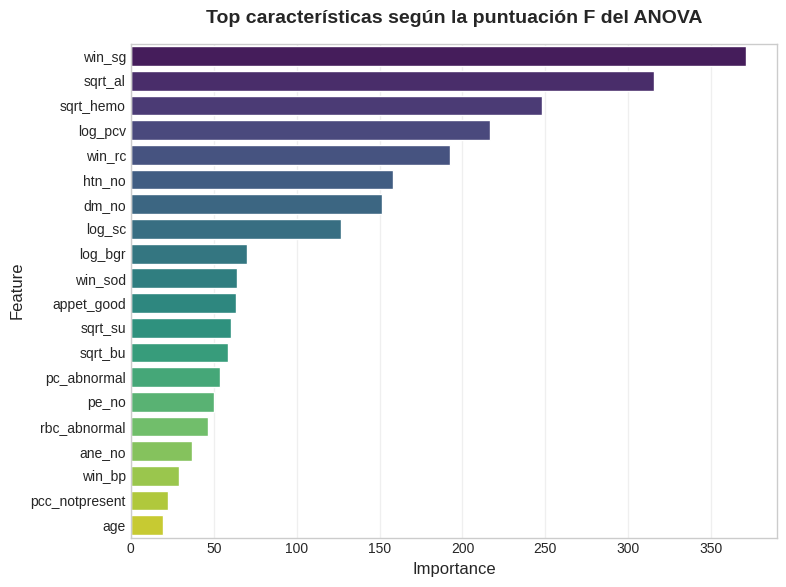

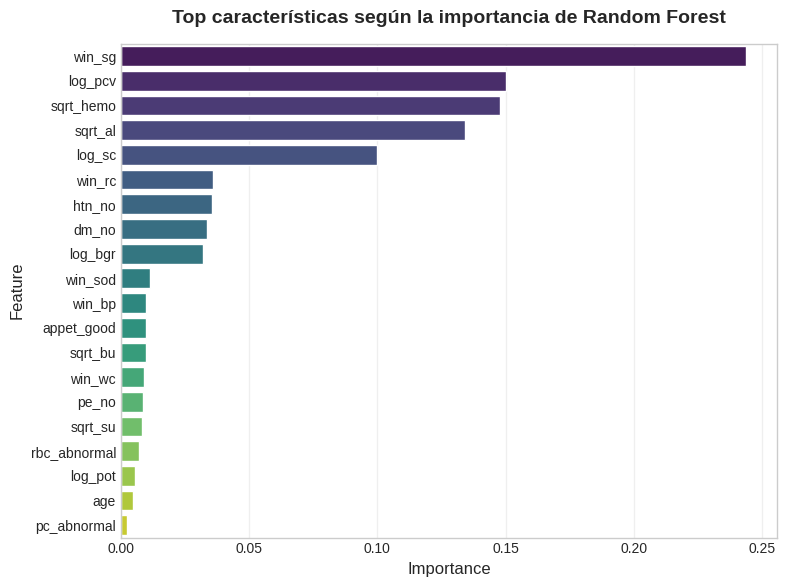

In [ ]:
anova_results, rf_importance = feature_selection_analysis(X_filtered, y, k_features=20)

Tras aplicar los métodos de selección ANOVA F-test y Random Forest, el siguiente bloque de código tiene como objetivo combinar y comparar los resultados obtenidos por ambos enfoques en un tabla para facilitar su análisis conjunto.

In [ ]:
print("\n" + "="*60)
print("🔎 Comparación de métodos de selección de características")
print("="*60)

# DataFrame de comparación
comparison_df = anova_results.merge(rf_importance, on='Feature', suffixes=('_ANOVA', '_RF'))
comparison_df['Rank_ANOVA'] = range(1, len(comparison_df)+1)
comparison_df['Rank_RF'] = comparison_df['Importance'].rank(ascending=False).astype(int)

print("\n🔹 Comparación de las principales características:")
print(comparison_df.sort_values('Rank_ANOVA').head(20))


🔎 Comparación de métodos de selección de características

🔹 Comparación de las principales características:
           Feature  F_Score  p_Value  Importance  Rank_ANOVA  Rank_RF
0           win_sg   371.12     0.00        0.24           1        1
1          sqrt_al   315.25     0.00        0.13           2        4
2        sqrt_hemo   247.97     0.00        0.15           3        3
3          log_pcv   216.64     0.00        0.15           4        2
4           win_rc   192.71     0.00        0.04           5        6
5           htn_no   157.89     0.00        0.04           6        7
6            dm_no   151.55     0.00        0.03           7        8
7           log_sc   126.77     0.00        0.10           8        5
8          log_bgr    70.24     0.00        0.03           9        9
9          win_sod    63.90     0.00        0.01          10       10
10      appet_good    63.42     0.00        0.01          11       12
11         sqrt_su    60.32     0.00        0.01   

Uno de los hallazgos más relevantes es la coincidencia de variables destacadas en ambos métodos. Esta convergencia refuerza la robustez de dichas variables, ya que su importancia se valida tanto desde un enfoque estadístico como desde uno predictivo.

Es por ello, que si analizamos los resultados obtenidos podemos observar que entre las variables más destacadas en ambos métodos encontramos:
<table border="1" style="border-collapse:collapse; width:90%; text-align:left;">
  <thead style="background-color:#f0f8ff;">
    <tr>
      <th>Feature</th>
      <th>Rank_ANOVA</th>
      <th>Rank_RF</th>
    </tr>
  </thead>
  <tbody>
    </tr>
      <td>win_sg</td>
      <td>1</td>
      <td>2</td>
    </tr>
    </tr>
      <td>sqrt_hemo</td>
      <td>3</td>
      <td>1</td>
    <tr>
    <tr>
      <td>sqrt_al</td>
      <td>2</td>
      <td>4</td>
    <tr>
    <tr>
      <td>log_pcv</td>
      <td>4</td>
      <td>3</td>
    <tr>
    <tr>
      <td>win_rc</td>
      <td>5</td>
      <td>6</td>
    <tr>
  </tbody>
</table>

Estas coincidencias indican que estas características tienen una alta capacidad discriminativa y aportan valor real al modelo, ya que su relevancia se confirma tanto desde el punto de vista estadístico como predictivo. Por esta razón, deberían considerarse prioritarias en el diseño del modelo final.

In [ ]:
df = encoded_kidney_df

Ahora comprobamos que la variable target esté balanceada:

In [ ]:
df['classification_ckd'].value_counts()

,count
classification_ckd,
1,250
0,150


Al analizar la distribución de clases en la variable objetivo, observamos que una de las clases representa más del 60-70% del total de observaciones. Esta situación se considera un desbalance moderado, ya que la representación de una clase es sustancialmente mayor que la de la otra, lo que puede afectar negativamente el rendimiento de los modelos de clasificación.

Este tipo de desbalance puede provocar que los clasificadores tiendan a favorecer la clase mayoritaria, minimizando la penalización por predecir incorrectamente la clase minoritaria. Como consecuencia, se obtienen métricas de evaluación engañosas.




### 6.2. Análisis Discriminante Lineal (LDA)

El Análisis Discriminante Lineal (LDA) es una técnica estadística supervisada utilizada tanto para clasificación como para reducción de la dimensionalidad. Su objetivo principal es encontrar una proyección lineal de los datos que maximice la separabilidad entre las distintas clases, conservando al mismo tiempo la mayor cantidad posible de información discriminativa.

Desde la perspectiva de clasificación, LDA busca identificar una o más direcciones óptimas (componentes discriminantes) en el espacio original de características, en las cuales las diferentes clases estén lo más separadas posible. Esto se consigue maximizando la varianza entre clases y minimizando la varianza intra-clase.

En otras palabras, LDA trata de encontrar un subespacio donde los grupos sean internamente compactos pero estén externamente distantes entre sí. Esta técnica resulta especialmente útil cuando se dispone de múltiples variables predictoras y se desea reducir la complejidad del modelo sin sacrificar capacidad de discriminación.


Matemáticamente, LDA se basa en la construcción de dos matrices clave:
<ul>
  <li>
    Matriz de dispersión intra-clase (S<sub>W</sub>): mide la variabilidad de los datos dentro de cada clase.
  </li>
  <li>
    Matriz de dispersión entre clases (S<sub>B</sub>): cuantifica la distancia entre las medias de cada clase.
  </li>
</ul>

El objetivo es encontrar una matriz de proyección `W` que maximice la siguiente razón de Fisher:

$$J(W)=\frac{|W^{T}S_{B}W|}{|W^{T}S_{W}W|}$$

La optimización de esta expresión conduce a un problema de valores propios, cuya solución permite obtener las direcciones más discriminantes del espacio de características.

Una vez determinadas las direcciones óptimas, los datos originales se proyectan en ese nuevo subespacio discriminante. Para clasificar nuevas observaciones, se puede utilizar una regla de decisión basada en la distancia (por ejemplo, distancia euclídea) o en métodos de máxima verosimilitud, dependiendo de las distribuciones estimadas para cada clase.

LDA asume que las clases siguen distribuciones normales multivariantes con matrices de covarianza iguales. Esta suposición permite que las fronteras de decisión sean lineales, lo que lo convierte en un clasificador particularmente eficiente cuando dichas condiciones se cumplen.

Algunas consideraciones que debemos tener en mente son las siguientes:
*   Ventajas:
    *   Permite interpretar con claridad qué variables son más relevantes para separar las clases.
    *   Es computacionalmente eficiente y robusto en presencia de muchas variables.
    *   Ofrece buenos resultados cuando las suposiciones del modelo se aproximan bien a la realidad del conjunto de datos.

*   Limitaciones:
    *   Puede perder efectividad cuando las matrices de covarianza de las clases son significativamente diferentes.
    *   Su rendimiento disminuye si las relaciones entre variables y clases son no lineales.
    *   Es sensible a outliers, ya que se basa en la media y la varianza.

En el bloque de código que encontramos a continuación implementamos un pipeline de clasificación utilizando LDA (Análisis Discriminante Lineal) como clasificador principal, complementado con SMOTE (Synthetic Minority Over-sampling Technique) para abordar el desbalance de clases.

Además, incorporamos la búsqueda de hiperparámetros con validación cruzada y la evaluación del rendimiento del modelo sobre el conjunto de prueba. Este flujo es particularmente útil en problemas donde hay un desequilibrio entre clases y se desea maximizar métricas como el F1-score.

Explicado brevemente el pipeline tenemos:
*   `SMOTE`: que genera nuevas muestras sintéticas de la clase minoritaria.
*   `StandardScaler`: se encarga de normalizar los datos, crucial para LDA.
*   `LDA`: es el clasificador lineal, el qual esta basado en maximizar la separabilidad entre clases.

Como `FEATURES` escogemos las variables que se encuentran en el ranking de Rank_ANOVA	y Rank_RF.

Además, se incorporó explícitamente la variable `log_sc` (logaritmo de la concentración sérica de creatinina), debido a su reconocido valor clínico en el diagnóstico y seguimiento de la enfermedad renal crónica (Chronic Kidney Disease, CKD). La creatinina sérica es uno de los principales biomarcadores de la función renal y se utiliza habitualmente para estimar la tasa de filtración glomerular (TFG), una medida clave en la clasificación de la CKD. La transformación logarítmica permite estabilizar su varianza y mejorar su comportamiento estadístico en modelos predictivos. Por tanto, su inclusión responde tanto a criterios médicos como analíticos.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.metrics import f1_score, recall_score, precision_score
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imba_Pipeline
import warnings
warnings.filterwarnings('ignore')

# Constantes
RANDOM_STATE = 42
TEST_SIZE = 0.2
FEATURES = ['win_sg', 'sqrt_hemo','sqrt_al','log_pcv','win_rc','log_sc']
CV_FOLDS = 5

# Preparar datos
X = df[FEATURES]
y = df['classification_ckd']

# División de prueba para el entrenamiento
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y
)

# Crear pipeline SMOTE y LDA
smote = SMOTE(random_state=RANDOM_STATE)
lda_pipeline = imba_Pipeline([
    ('smote', smote),
    ('scaler', StandardScaler()),
    ('lda', LinearDiscriminantAnalysis())
])

# Cuadrícula de hiperparámetros
param_grid = {
    'lda__solver': ['lsqr', 'eigen'],
    'lda__shrinkage': [None, 'auto', 0.5],
    'smote__sampling_strategy': [0.8, 1.0]
}

# Búsqueda en cuadrícula con validación cruzada
grid_search = GridSearchCV(
    lda_pipeline, param_grid, cv=CV_FOLDS,
    scoring='f1', n_jobs=-1, verbose=1
)
grid_search.fit(X_train, y_train)

# Obtener el mejor modelo y parámetros
lda_best = grid_search.best_estimator_
print(f"\n🔹 Mejores parámetros: {grid_search.best_params_}")

# Validación cruzada en el conjunto de entrenamiento
cv_scores = cross_val_score(lda_best, X_train, y_train, cv=CV_FOLDS, scoring='accuracy')
print(f"\n🔹 Validación cruzada (n={CV_FOLDS}):")
print(f"Precisión media: {cv_scores.mean():.4f}")
print(f"Desviación estándar: {cv_scores.std():.4f}")

# Evaluar en el conjunto de pruebas
y_pred = lda_best.predict(X_test)
y_proba = lda_best.predict_proba(X_test)[:, 1]

def print_evaluation_report(y_test, y_pred):
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    specificity = recall_score(y_test, y_pred, pos_label=0)

    print("\n" + "="*54)
    print("📊 Métricas de evaluación del conjunto de pruebas")
    print("="*54)
    print(f"{'Exactitud:':<30}{accuracy:.4f}")
    print(f"{'F1-Score:':<30}{f1:.4f}")
    print(f"{'Recordatorio (sensibilidad):':<30}{recall:.4f}")
    print(f"{'Precisión:':<30}{precision:.4f}")
    print(f"{'Especificidad:':<30}{specificity:.4f}")

    print("\n" + "="*30)
    print("📝 Informe de clasificación")
    print("="*30)
    print(classification_report(y_test, y_pred, digits=4))

print_evaluation_report(y_test, y_pred)

Fitting 5 folds for each of 12 candidates, totalling 60 fits

🔹 Mejores parámetros: {'lda__shrinkage': None, 'lda__solver': 'lsqr', 'smote__sampling_strategy': 0.8}

🔹 Validación cruzada (n=5):
Precisión media: 0.9187
Desviación estándar: 0.0412

📊 Métricas de evaluación del conjunto de pruebas
Exactitud:                    0.9500
F1-Score:                     0.9583
Recordatorio (sensibilidad):  0.9200
Precisión:                    1.0000
Especificidad:                1.0000

📝 Informe de clasificación
              precision    recall  f1-score   support

           0     0.8824    1.0000    0.9375        30
           1     1.0000    0.9200    0.9583        50

    accuracy                         0.9500        80
   macro avg     0.9412    0.9600    0.9479        80
weighted avg     0.9559    0.9500    0.9505        80



El modelo de LDA fue sometido a una evaluación exhaustiva utilizando validación cruzada con cinco particiones, acompañado por la técnica de sobremuestreo `SMOTE` para abordar el desbalance de clases. En total, se exploraron 12 combinaciones distintas de hiperparámetros, resultando en 60 ajustes de modelo, lo cual permitió valorar su comportamiento bajo diferentes configuraciones de regularización y resolución.

Tras el proceso de búsqueda, los mejores parámetros seleccionados fueron los siguientes:
*   `solver = 'lsqr'`: este solucionador resulta eficiente para problemas de clasificación con alta dimensionalidad, permitiendo el uso opcional de la técnica de shrinkage, lo cual lo hace más flexible frente a problemas de colinealidad en los datos.
*   `shrinkage = None`: la ausencia de regularización adicional indica que las matrices de covarianza fueron estimadas directamente de los datos sin penalización, presuponiendo una muestra suficientemente representativa y estable.
*   `sampling_strategy = 0.8`: se utilizó `SMOTE` para aumentar la representación de la clase minoritaria hasta alcanzar el 80% del tamaño de la clase mayoritaria, mejorando así la sensibilidad del modelo sin comprometer la especificidad.

Durante la validación cruzada, el modelo alcanzó una precisión media de 91.87%, con una desviación estándar de ±4.12%. Aunque esta variabilidad es moderadamente mayor que en los modelos que veremos a coninuación (SVM y QDA), sigue indicando una buena estabilidad general entre diferentes particiones, sin señales de sobreajuste graves.

La evaluación final del modelo sobre datos no utilizados en el entrenamiento arrojó los siguientes resultados:
*   Exactitud general: 95.00%
*   F1-score: 95.83%, denotando un balance sobresaliente entre precisión y sensibilidad.
*   Sensibilidad: 92.00%, lo que implica una fuerte capacidad de detección de la clase positiva.
*   Precisión: 100.00%, indicando que no se produjeron falsos positivos.
*   Especificidad: 100.00%, lo que reafirma su capacidad para identificar correctamente todos los casos negativos.

Por lo que respecta al desempeño por clase:

<table>
    <thead>
      <tr>
        <th>Clase</th>
        <th>Precisión</th>
        <th>Recall</th>
        <th>F1-Score</th>
        <th>Soporte</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>0 (No enfermo)</td>
        <td>88.24%</td>
        <td>100.00%</td>
        <td>93.75%</td>
        <td>30</td>
      </tr>
      <tr>
        <td>1 (Enfermo)</td>
        <td>100.00%</td>
        <td>92.00%</td>
        <td>95.83%</td>
        <td>50</td>
      </tr>
    </tbody>
  </table>

Se observa un rendimiento sólido en ambas clases. En particular, destaca la ausencia de falsos positivos, lo que es crítico en contextos donde una clasificación errónea de pacientes sanos como enfermos podría derivar en intervenciones innecesarias. A su vez, la alta sensibilidad confirma su eficacia para detectar correctamente los casos positivos (pacientes enfermos), aunque con un pequeño margen de error comparado con modelos no lineales.

Podriamos concluir que el modelo LDA, ha demostrado ser una solución eficaz y eficiente para tareas de clasificación binaria con estructuras lineales bien definidas. A pesar de su simplicidad relativa frente a modelos más complejos como SVM o QDA, ofrece un rendimiento altamente competitivo, especialmente por su precisión perfecta (100%) y especificidad total (100%).

Su principal fortaleza radica en su eficiencia computacional, interpretabilidad estadística y capacidad de generalización sin necesidad de regularización. Por ende, LDA se presenta como una alternativa idónea en entornos clínicos donde los recursos son limitados o se prioriza la transparencia del modelo, sin sacrificar un desempeño robusto y confiable.

En el contexto de problemas clínicos como la detección de Enfermedad Renal Crónica (ERC), es fundamental no solo evaluar el rendimiento global de un modelo, sino también comprender cómo se comporta ante errores tipo I (falsos positivos) y tipo II (falsos negativos). Para ello, la matriz de confusión es una herramienta esencial.

El siguiente bloque de código implementa una función personalizada para visualizar la matriz de confusión con un enfoque clínico. Además de mostrar el conteo de predicciones correctas e incorrectas, se destacan tres métricas clave directamente sobre la gráfica:
*   Exactitud (accuracy): proporción de predicciones correctas.
*   Sensibilidad (recall): proporción de verdaderos positivos (capacidad del modelo para detectar la ERC).
*   Especificidad: proporción de verdaderos negativos (capacidad del modelo para descartar casos sanos correctamente).

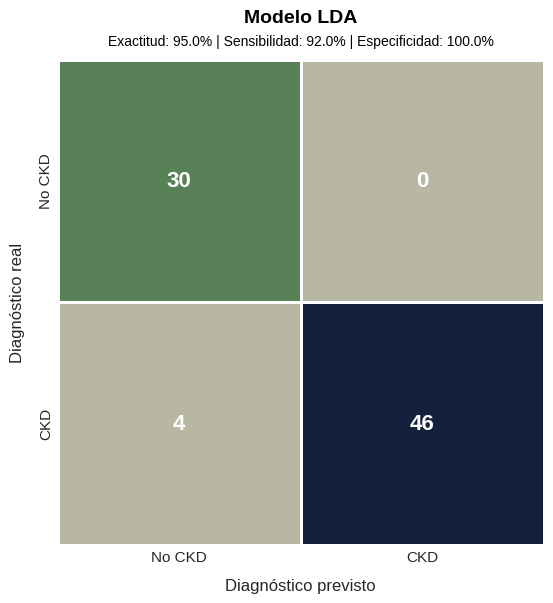

In [ ]:
def plot_confusion_matrix(y_true, y_pred, model_name="Model", figsize=(8, 6)):
    """
    Matriz de confusión clínicamente enfocada para la clasificación de la ERC.
    Muestra precisión, sensibilidad y especificidad.
    """
    import matplotlib.pyplot as plt
    import seaborn as sns
    import numpy as np
    from matplotlib.colors import ListedColormap
    from sklearn.metrics import confusion_matrix, accuracy_score, recall_score

    class_names = ['No CKD', 'CKD']
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel()

    accuracy = accuracy_score(y_true, y_pred)
    sensitivity = recall_score(y_true, y_pred)  # Tasa de verdaderos positivos
    specificity = tn / (tn + fp)  # Tasa de verdaderos negativos

    plt.figure(figsize=figsize, facecolor='white')
    ax = plt.gca()

    # Crear un colormap personalizado para la matriz
    colors = ['#b7b7a4', '#b7b7a4', '#588157', '#14213d']
    cmap = ListedColormap(colors)

    sns.heatmap(cm, annot=True, fmt='d', cmap=cmap,
                annot_kws={'size': 16, 'weight': 'bold', 'color': 'white'},
                xticklabels=class_names, yticklabels=class_names,
                cbar=False, square=True, linewidths=1, linecolor='white')

    # Etiquetas de eje
    ax.set_xlabel('Diagnóstico previsto', fontsize=12, labelpad=10)
    ax.set_ylabel('Diagnóstico real', fontsize=12, labelpad=10)

    # Título
    plt.suptitle(f'{model_name}', fontsize=14, fontweight='bold', y=1, color='#000000')

    # Añadir un subtítulo con métricas
    plt.figtext(0.5, 0.94, f'Exactitud: {accuracy:.1%} | Sensibilidad: {sensitivity:.1%} | Especificidad: {specificity:.1%}',
            ha='center', fontsize=10, color='#000000')

    ax.set_facecolor('white')
    for spine in ax.spines.values():
        spine.set_visible(False)
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)
    plt.tight_layout()
    plt.show()

plot_confusion_matrix(y_test, y_pred, model_name="Modelo LDA")

Además, en el ámbito del análisis predictivo resulta fundamental no solo predecir correctamente, sino evaluar cómo varía el rendimiento del modelo ante diferentes umbrales de decisión.

Una de las herramientas más poderosas para este propósito es la Curva ROC (Receiver Operating Characteristic), que permite visualizar gráficamente la relación entre:
*   Tasa de verdaderos positivos (TPR o sensibilidad).
*   Tasa de falsos positivos (FPR o especificidad).

Un aspecto que hemos tenido en cuenta es añadir a la representación la línea de rendimiento aleatorio ya que sirve como punto de referencia mínimo. Si un modelo tiene una curva ROC por debajo o muy cerca de esa línea, significa que el modelo no está haciendo predicciones corectas y en algunos casos, peores que al azar.

A parte, hemos decidido calcular el AUC (Área Bajo la Curva) como un indicador del desempeño global del modelo, ya que cuanto más cercano a 1, mejor es la capacidad de discriminación del clasificador.

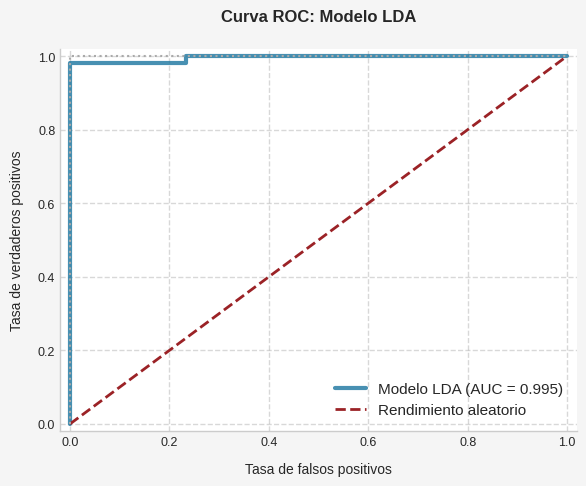

In [ ]:
def plot_roc_curve(y_true, y_prob, model_name="Model", figsize=(6, 5), fontsize=10):
    """
    Crea un gráfico de curva ROC para evaluar el rendimiento de un modelo de clasificación.

    ============
    Parámetros:
    ============
    y_true: etiquetas binarias verdaderas.
    y_prob: probabilidades predichas para la clase positiva.
    model_name: nombre para mostrar en el título.
    figsize: dimensiones de la figura.
    fontsize: tamaño de fuente base.
    """

    fpr, tpr, _ = roc_curve(y_true, y_prob)
    roc_auc = auc(fpr, tpr)

    # Figura de configuración con fondo gris claro
    plt.figure(figsize=figsize, facecolor='#f5f5f5')
    ax = plt.gca()
    ax.set_facecolor('#ffffff')

    # Curva ROC principal (utilizando gradiente azul)
    plt.plot(fpr, tpr, color='#1a759f', lw=3, alpha=0.8,
             label=f'{model_name} (AUC = {roc_auc:.3f})')

    # Línea de referencia diagonal
    plt.plot([0, 1], [0, 1], color='#9b2226', linestyle='--', lw=2,
             label='Rendimiento aleatorio')

    # Referencia de clasificador perfecta (línea discontinua)
    plt.plot([0, 0, 1], [0, 1, 1], color='#aaaaaa', linestyle=':', lw=1.5)

    # Personalizar ejes
    plt.xlim([-0.02, 1.02])
    plt.ylim([-0.02, 1.02])
    plt.xlabel('Tasa de falsos positivos', fontsize=fontsize, labelpad=10)
    plt.ylabel('Tasa de verdaderos positivos', fontsize=fontsize, labelpad=10)

    # Título y leyenda
    plt.title(f'Curva ROC: {model_name}',
              fontsize=fontsize+2, pad=20, weight='bold')
    plt.legend(loc="lower right", framealpha=1, facecolor='white')

    # Estilo de cuadrícula y marca
    ax.grid(True, linestyle='--', alpha=0.3, color='gray')
    ax.tick_params(axis='both', which='major', labelsize=fontsize-1)

    # Quitar los spines superiores/derechas
    for spine in ['top', 'right']:
        ax.spines[spine].set_visible(False)

    plt.tight_layout()
    plt.show()

plot_roc_curve(y_test, y_proba, model_name='Modelo LDA')

Para finalizar esta sección del análisis, es fundamental comprender qué variables están contribuyendo más a las decisiones del modelo. Esta interpretación es especialmente valiosa en contextos donde no solo importa la precisión, sino también la transparencia y la explicabilidad de los resultados.

En el nuestro caso los coeficientes del modelo representan las direcciones que maximizan la separación entre clases. La magnitud absoluta de estos coeficientes nos indica qué tan influyente es cada variable para diferenciar entre pacientes con y sin enfermedad renal crónica (CKD).

Para visualizarlo, el siguiente código crea un gráfico de barras horizontales que muestra la importancia relativa de cada característica utilizada por el modelo LDA, ordenadas de menor a mayor impacto.

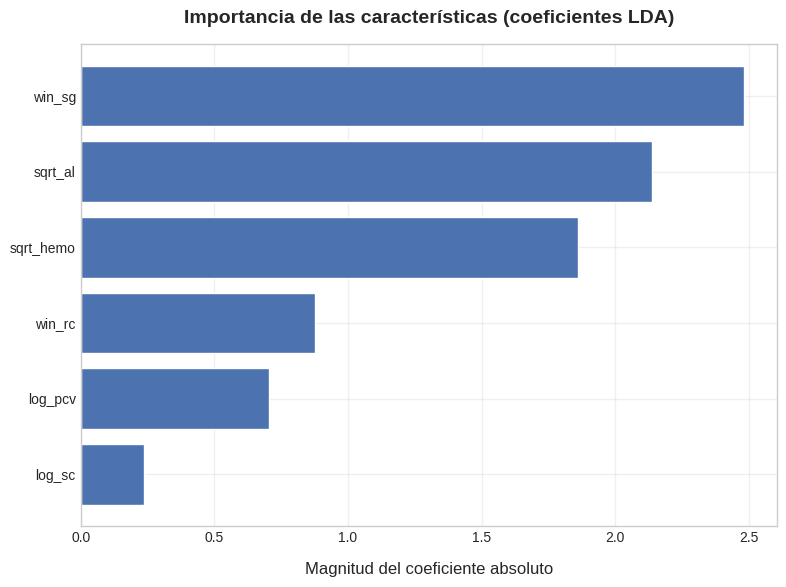

['lda_model.pkl']

In [ ]:
def plot_feature_importance(model, X_test):
    lda = model.named_steps['lda']
    feature_importance = np.abs(lda.coef_)[0]

    plt.figure(figsize=(8, 6))
    features = X_test.columns
    indices = np.argsort(feature_importance)

    plt.title('Importancia de las características (coeficientes LDA)', fontweight='bold', pad=15)
    plt.barh(range(len(indices)), feature_importance[indices], align='center')
    plt.yticks(range(len(indices)), [features[i] for i in indices])
    plt.xlabel('Magnitud del coeficiente absoluto', labelpad=12)
    plt.tight_layout()
    plt.show()

plot_feature_importance(lda_best, X_test)

print("\n")
import joblib
joblib.dump(lda_best, 'lda_model.pkl')

Observando el gráfico, podemos hacer la siguiente interpretación:

*   Variables más relevantes: las variables `win_sg`, `sqrt_hemo`, `sqrt_al`, `win_rc` son las que presentan mayor magnitud de coeficiente, lo que indica que tienen mayor capacidad discriminativa para identificar pacientes con CKD.
*   Relación con la fisiopatología de CKD: estas variables están directamente relacionadas con la función renal y las alteraciones metabólicas asociadas a la CKD, como la disminución de la capacidad de concentración urinaria, anemia, alteraciones en proteínas plasmáticas, y la presencia de hipertensión.

*   Implicaciones clínicas: el modelo sugiere que la evaluación de CKD debe centrarse en parámetros de laboratorio clásicos (hemoglobina, albúmina, urea, densidad urinaria) y antecedentes de hipertensión, lo cual es consistente con las guías internacionales para el diagnóstico y manejo de CKD.

**Relación con la clasificación y diagnóstico de CKD:**

La clasificación de CKD se basa principalmente en el filtrado glomerular estimado (eGFR) y la presencia de albuminuria, pero otras variables como las que aparecen en el gráfico contribuyen a la evaluación integral del paciente y a la predicción de complicaciones y progresión de la enfermedad.

### 6.3. Análisis Discriminante Cuadrático (QDA)

El Análisis Discriminante Cuadrático (QDA) es una técnica de clasificación supervisada basada en modelos probabilísticos. Se utiliza cuando se asume que las clases siguen distribuciones normales multivariadas, y permite que cada clase tenga su propia matriz de covarianza. Esto le otorga una mayor flexibilidad para modelar fronteras de decisión no lineales, adaptándose mejor a distribuciones complejas.

QDA pertenece a la familia de modelos generativos, ya que estima la distribución de los datos condicional a cada clase `(P(x|y))` y luego aplica la regla de Bayes para obtener la probabilidad posterior `P(y|x)`, sobre la cual se basa la clasificación.

Su fundamento teórico consiste en que dado un conjunto de clases `y∈{1,...,K}`, QDA asume que los datos de cada clase están distribuidos según una normal multivariada con media `μ_k` y matriz de covarianza `Σ_k`:

$$P(x|y=k)=\frac{1}{(2\pi)^{d/2}|\sum_{k}|^{1/2}}exp(-\frac{1}{2}(x-\mu_{k})^{T}\sum_{k}^{-1}(x-\mu_{k}))$$


QDA no impone la restricción de matrices de covarianza iguales para todas las clases, lo que permite que las fronteras de decisión sean cuadráticas en lugar de lineales.

Para clasificar una observación `x`, QDA calcula una función discriminante para cada clase `k` de la forma:

$$\delta_{k}(x)=-\frac{1}{2}log|\sum_{k}|-\frac{1}{2}(x-\mu_{k})^T\sum_{k}^{-1}(x-\mu_{k})+log\pi_k$$

Donde:
*   `Σ_k` es la matriz de covarianza de la clase `k`.
*   `μ_k` es la media de la clase `k`.
*   `π_k` es la probabilidad a priori de la clase `k`.

Algunas consideraciones que debemos tener en cuenta son las siguientes:
*   Ventajas:
    *   Modelado no lineal: es capaz de generar fronteras de decisión curvas, lo que lo hace más adecuado para problemas en los que las clases no son separables linealmente.
    *   Flexibilidad estructural: al permitir una matriz de covarianza diferente por clase, QDA captura de manera más fiel la estructura de los datos cuando las clases tienen diferentes varianzas o correlaciones entre variables.
    *   Base probabilística: su formulación probabilística permite no solo clasificar, sino también estimar probabilidades de pertenencia.
*   Limitaciones:
    *   Requiere más datos: como debe estimar una matriz de covarianza distinta para cada clase, QDA necesita una cantidad considerable de datos para evitar sobreajuste, especialmente en espacios de alta dimensión.
    *   Sensibilidad a la normalidad: QDA asume que los datos siguen distribuciones normales multivariadas. Si esta suposición no se cumple, su rendimiento puede degradarse notablemente.
    *   Problemas de estabilidad: en conjuntos de datos pequeños o con multicolinealidad, la estimación de las matrices de covarianza puede ser inestable o incluso no invertible, lo que impide aplicar el modelo.


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.metrics import f1_score, recall_score, precision_score
from sklearn.inspection import permutation_importance
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imba_Pipeline
import warnings
warnings.filterwarnings('ignore')

# Constantes
RANDOM_STATE = 42
TEST_SIZE = 0.2
FEATURES = ['win_sg', 'sqrt_hemo','sqrt_al','log_pcv','win_rc','log_sc']
CV_FOLDS = 5

# Preparar datos
X = df[FEATURES]
y = df['classification_ckd']

# División de prueba para el entrenamiento
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y
)

# Crear pipeline de SMOTE y QDA
smote = SMOTE(random_state=RANDOM_STATE)
qda_pipeline = imba_Pipeline([
    ('smote', smote),
    ('scaler', StandardScaler()),
    ('qda', QuadraticDiscriminantAnalysis())
])

# Cuadrícula de hiperparámetros para QDA
param_grid = {
    'qda__reg_param': [0.0, 0.1, 0.2, 0.5],  # Parámetro de regularización
    'qda__store_covariance': [True, False],
    'smote__sampling_strategy': [0.8, 1.0]
}

# Búsqueda en cuadrícula con validación cruzada
grid_search = GridSearchCV(
    qda_pipeline, param_grid, cv=CV_FOLDS,
    scoring='f1', n_jobs=-1, verbose=1
)
grid_search.fit(X_train, y_train)

# Obtenga el mejor modelo y parámetros
qda_best = grid_search.best_estimator_
print(f"\n🔹 Mejores parámetros: {grid_search.best_params_}")

# Validación cruzada en el conjunto de entrenamiento
cv_scores = cross_val_score(qda_best, X_train, y_train, cv=CV_FOLDS, scoring='accuracy')
print(f"\n🔹 Validación cruzada (n={CV_FOLDS}):")
print(f"Precisión media: {cv_scores.mean():.4f}")
print(f"Desviación estándar: {cv_scores.std():.4f}")

# Evaluar en el conjunto de pruebas
y_pred = qda_best.predict(X_test)
y_proba = qda_best.predict_proba(X_test)[:, 1]

print_evaluation_report(y_test, y_pred)

Fitting 5 folds for each of 16 candidates, totalling 80 fits

🔹 Mejores parámetros: {'qda__reg_param': 0.0, 'qda__store_covariance': True, 'smote__sampling_strategy': 0.8}

🔹 Validación cruzada (n=5):
Precisión media: 0.9688
Desviación estándar: 0.0099

📊 Métricas de evaluación del conjunto de pruebas
Exactitud:                    0.9625
F1-Score:                     0.9691
Recordatorio (sensibilidad):  0.9400
Precisión:                    1.0000
Especificidad:                1.0000

📝 Informe de clasificación
              precision    recall  f1-score   support

           0     0.9091    1.0000    0.9524        30
           1     1.0000    0.9400    0.9691        50

    accuracy                         0.9625        80
   macro avg     0.9545    0.9700    0.9607        80
weighted avg     0.9659    0.9625    0.9628        80



El modelo QDA fue evaluado mediante un riguroso proceso de validación cruzada estratificada con cinco particiones. Durante este proceso se probaron 16 combinaciones distintas de hiperparámetros, lo que dio lugar a un total de 80 ajustes individuales del modelo, permitiendo así una evaluación exhaustiva y controlada de su comportamiento bajo diversas configuraciones.

A partir de la búsqueda sistemática, se identificaron los siguientes parámetros como óptimos:
*   `reg_param = 0.0`: la ausencia de regularización sugiere que el modelo logró una buena capacidad de generalización sin necesidad de introducir restricciones adicionales sobre las matrices de covarianza. Esto también implica que no se observaron problemas significativos de sobreajuste en el entrenamiento.
*   `store_covariance = True`: la opción de conservar las matrices de covarianza permite una inspección posterior sobre la dispersión interna de las clases
*   `sampling_strategy = 0.8 (SMOTE)`: se aplicó un sobremuestreo de la clase minoritaria hasta alcanzar el 80% del tamaño de la clase mayoritaria. Esta técnica mitigó el desequilibrio de clases, mejorando la sensibilidad del modelo sin introducir sesgos artificiales significativos.

Durante la validación cruzada, el modelo alcanzó una precisión media del 96.88%, acompañada de una desviación estándar de apenas ±0.99%. Este bajo nivel de variabilidad evidencia una alta estabilidad y consistencia del modelo frente a diferentes particiones de los datos, lo que refuerza su confiabilidad como herramienta predictiva.

Por lo que hace a la evaluación sobre el conjunto de prueba, es decir, datos no utilizados durante el entrenamiento ni la validación, mostró los siguientes resultados:
*   Exactitud general: 96.25%
*   F1-score: 96.91%, indicando un balance óptimo entre precisión y recall.
*   Sensibilidad (recall): 94.00%, lo que refleja una muy buena capacidad para detectar correctamente los casos positivos (pacientes enfermos).
*   Precisión: 100.00%, lo cual implica que todas las predicciones positivas fueron correctas, sin falsos positivos.
*   Especificidad: 100.00%, confirmando la capacidad del modelo para identificar correctamente los casos negativos.

También hemos analizado el desempeño por clases:

<table>
    <thead>
      <tr>
        <th>Clase</th>
        <th>Precisión</th>
        <th>Recall</th>
        <th>F1-Score</th>
        <th>Soporte</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>0 (No enfermo)</td>
        <td>90.91%</td>
        <td>100.00%</td>
        <td>95.24%</td>
        <td>30</td>
      </tr>
      <tr>
        <td>1 (Enfermo)</td>
        <td>100.00%</td>
        <td>94.00%</td>
        <td>96.91%</td>
        <td>50</td>
      </tr>
    </tbody>
  </table>

El modelo exhibe una ausencia completa de falsos positivos, lo cual es especialmente valioso en contextos médicos, ya que evita alarmas innecesarias y garantiza la confiabilidad diagnóstica. Además, mantiene una alta sensibilidad (94%) en la clase positiva, lo que contribuye a una detección eficaz de pacientes enfermos sin comprometer la especificidad.

Como conclusión, QDA ha demostrado un desempeño sobresaliente tanto en validación cruzada como en datos no vistos, destacándose por su alta precisión (100%) en predicciones positivas y su capacidad para detectar la gran mayoría de los casos positivos (94% de sensibilidad). La robustez observada en distintas métricas, junto con la ausencia de sobreajuste, lo posicionan como una opción confiable para escenarios clínicos donde crucial detectar todos los casos positivos sin comprometer la especificidads.

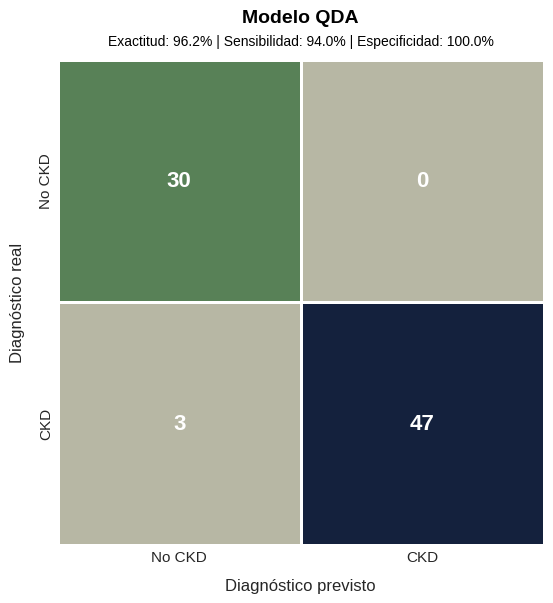

In [ ]:
plot_confusion_matrix(y_test, y_pred, model_name="Modelo QDA")

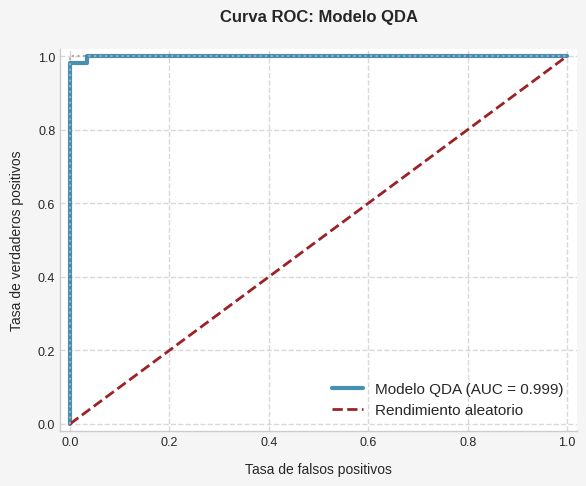

In [ ]:
plot_roc_curve(y_test, y_proba, model_name='Modelo QDA')

Además de evaluar el rendimiento general de un modelo, es crucial entender qué variables están contribuyendo más a sus predicciones. Esto no solo ayuda a interpretar los resultados, sino también a validar que el modelo esté capturando relaciones lógicas y relevantes en los datos.

En este apartado, realizamos un análisis de la importancia de características usando el enfoque de importancia por permutación. Esta técnica mide cómo se ve afectado el rendimiento del modelo al alterar aleatoriamente los valores de una característica: si una permutación degrada significativamente la precisión, esa variable es considerada importante.

El procedimiento incluye:
*   Transformar los datos de entrada (excluyendo técnicas como `SMOTE`, que solo se aplican en entrenamiento).
*   Aplicar la técnica de `permutation_importance` al modelo QDA optimizado.
*   Visualizar las variables más influyentes con un gráfico de barras.

Este enfoque es modelo-agnóstico, lo que significa que no depende de los coeficientes internos del modelo (como en la regresión lineal), sino del impacto real en el rendimiento predictivo. Así, permite una visión más fiel y práctica de la contribución de cada variable.


🔹 Importancia de la permutación:
  Característica  Importancia  Std
2        sqrt_al         0.19 0.04
0         win_sg         0.15 0.03
3        log_pcv         0.03 0.02
5         log_sc         0.02 0.02
1      sqrt_hemo        -0.00 0.01
4         win_rc        -0.01 0.01




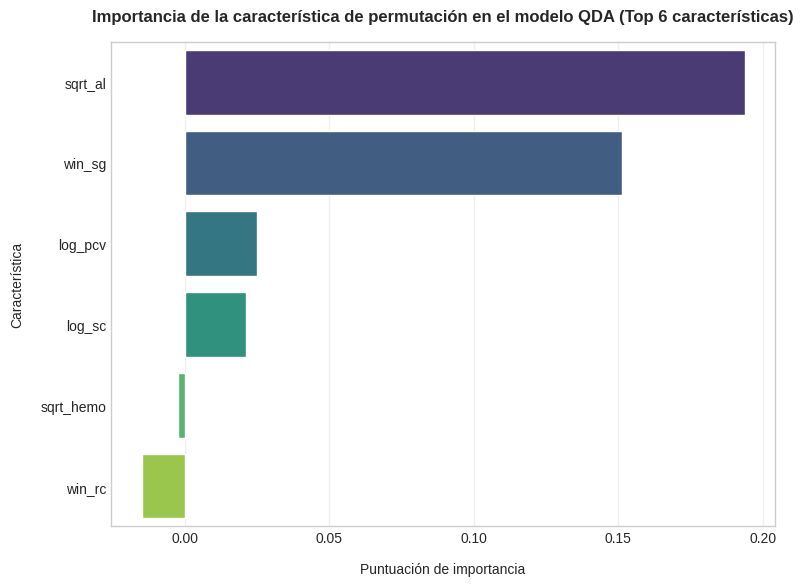

['qda_model.pkl']

In [ ]:
# Importancia de la permutación
def calculate_permutation_importance(model, X, y):
    """Calcular la importancia de las características mediante la importancia de la permutación"""

    # Para el pipeline, primero debemos transformar los datos antes de dar importancia a la permutación
    # Obtener datos transformados
    X_transformed = X.copy()
    if hasattr(model, 'named_steps'):
        if 'smote' in model.named_steps:
            # Omitir SMOTE para fines de evaluación
            pass
        if 'scaler' in model.named_steps:
            X_transformed = model.named_steps['scaler'].transform(X_transformed)

    # Extraer el modelo QDA del pipeline
    qda_model = model.named_steps['qda'] if hasattr(model, 'named_steps') else model

    # Calcular la importancia de la permutación
    result = permutation_importance(
        qda_model, X_transformed, y,
        n_repeats=10, random_state=RANDOM_STATE, n_jobs=-1
    )

    # Crear un DataFrame para los puntajes de importancia
    importance_df = pd.DataFrame({
        'Característica': X.columns,
        'Importancia': result.importances_mean,
        'Std': result.importances_std
    })

    # Ordenar por importancia
    importance_df = importance_df.sort_values(by='Importancia', ascending=False)

    return importance_df


# Plot de la importancia de las características
def plot_feature_importance(importance_df, title, top_n=15):
    plt.figure(figsize=(8, 6))

    # Obtener las N mejores funciones
    if len(importance_df) > top_n:
        plot_df = importance_df.head(top_n)
    else:
        plot_df = importance_df

    # Crear un gráfico de barras horizontales
    sns.barplot(x='Importancia', y='Característica', data=plot_df, palette='viridis')
    plt.title(f'{title} (Top {len(plot_df)} características)', fontsize=12, fontweight='bold', pad=15)
    plt.xlabel('Puntuación de importancia', fontsize=10, labelpad=12)
    plt.ylabel('Característica', fontsize=10, labelpad=12)
    plt.tight_layout()
    plt.show()
    print("\n")

    return plot_df

# Importancia de la permutación en el conjunto de pruebas
print("\n🔹 Importancia de la permutación:")
perm_importance = calculate_permutation_importance(qda_best, X_test, y_test)
print(perm_importance)
print("\n")
plot_feature_importance(perm_importance, 'Importancia de la característica de permutación en el modelo QDA')

import joblib
joblib.dump(qda_best, 'qda_model.pkl')

Los resultados sugieren que un enfoque diagnóstico óptimo para la enfermedad renal debería priorizar:


*   La evaluación cuidadosa de albuminuria, como el marcador más discriminativo
*   La medición de la gravedad específica urinaria como complemento diagnóstico crucial
*  Los parámetros hematológicos y la creatinina como indicadores complementarios

El modelo QDA, al capturar relaciones no lineales entre las variables, proporciona información valiosa sobre la complejidad de las interacciones entre estos biomarcadores en el contexto de la enfermedad renal.

### 6.4. Máquinas de Vectores de Soporte (Sigmoidal)

Las Máquinas de Vectores de Soporte (SVM) constituyen un enfoque robusto de aprendizaje supervisado, ampliamente utilizado tanto para tareas de clasificación como, en menor medida, de regresión. Su objetivo principal es encontrar un hiperplano que separe de forma óptima las clases en un espacio de características, maximizando el margen entre los ejemplos más cercanos de cada clase, conocidos como vectores de soporte.

En el caso de una SVM con kernel sigmoidal, se emplea una transformación no lineal de los datos de entrada mediante una función kernel. Esto permite proyectar los datos a un espacio de mayor dimensión en el que la separación lineal entre clases es factible, incluso si en el espacio original no lo es.

La función sigmoidal utilizada como kernel se define de la siguiente manera:

$$K(x,x')=tanh(\gamma \cdot \left<x,x'\right>+r)$$

<p>Donde:</p>
<ul>
    <li><code>&lt;x, x'&gt;</code> representa el producto escalar entre los vectores <code>x</code> y <code>x'</code>.</li>
    <li><code>γ</code> es un parámetro que controla la escala del producto escalar.</li>
    <li><code>r</code> es un parámetro de desplazamiento que ajusta el umbral de activación de la función.</li>
</ul>

Esta transformación permite que la SVM construya un modelo no lineal en el espacio original, encontrando separaciones complejas entre clases de forma más efectiva.

El objetivo de una SVM es maximizar el margen entre las clases, lo que se consigue al encontrar el hiperplano que maximiza la distancia entre las muestras más cercanas de cada clase (vectores de soporte). La función objetivo para SVM es minimizar una función de pérdida, sujeta a restricciones de clasificación correcta. La función de pérdida utilizada es la función de hinge (bisagra), que penaliza las clasificaciones incorrectas:

$$\underset{w,b}{min}\,\,\,\frac{1}{2}||W||^{2}\,\,\,\,\,\,\,\,sujeto\,\,a:\,\,\,\,\,y_{i}(w\cdot x_{i}+b)\geq 1,\,\,\,\,\,\,\,\forall i=1,...,n$$

<p>Donde:</p>
<ul>
    <li><code>w</code> es el vector normal al hiperplano de decisión.</li>
    <li><code>x_i</code> son los vectores de las características.</li>
    <li><code>y_i</code> son las etiquetas correspondientes a cada clase.</li>
</ul>

En presencia de un kernel, como el sigmoidal, esta optimización se lleva a cabo en un espacio transformado. El proceso suele implicar la resolución de un problema cuadrático mediante técnicas como la programación cuadrática (QP) o métodos basados en gradientes.

Algunas consideraciones que debemos tener en mente son las siguientes:
*   Ventajas:
    *   Capacidad para capturar relaciones no lineales: permite a la SVM identificar patrones complejos en los datos que no pueden ser separados linealmente en el espacio original.
    *   Flexibilidad del modelo: los parámetros `γ` y `r` ofrecen control sobre la forma y complejidad del modelo, lo que posibilita una mejor adaptación a distintos tipos de datos.
    *   Precisión: cuando se configura adecuadamente, este kernel puede lograr una separación efectiva entre clases, favoreciendo un alto rendimiento en tareas de clasificación.
*   Limitaciones:
    *   Sensibilidad a la configuración de parámetros: el rendimiento del modelo depende fuertemente de una adecuada selección de `γ` y `r`, lo cual puede requerir una búsqueda intensiva mediante validación cruzada.
    *   Propensión al sobreajuste: en presencia de ruido o valores atípicos, el modelo puede sobreadaptarse, comprometiendo su capacidad de generalización.
    *   Coste computacional: la combinación de no linealidad y necesidad de ajuste de múltiples parámetros incrementa la carga computacional, especialmente en conjuntos de datos grandes.


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, roc_curve, auc
from sklearn.metrics import f1_score, recall_score, precision_score
from sklearn.inspection import permutation_importance
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imba_Pipeline
import warnings
warnings.filterwarnings('ignore')

# Constantes
RANDOM_STATE = 42
TEST_SIZE = 0.2
FEATURES = ['win_sg', 'sqrt_hemo','sqrt_al','log_pcv','win_rc','log_sc']
CV_FOLDS = 5

# Preparar datos
X = df[FEATURES]
y = df['classification_ckd']

# División de prueba para el entrenamiento
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y
)

# Cree un pipeline de SMOTE y SVM solo con el kernel Sigmoid
smote = SMOTE(random_state=RANDOM_STATE)
svm_pipeline = imba_Pipeline([
    ('smote', smote),
    ('scaler', StandardScaler()),
    ('svm', SVC(kernel='sigmoid', probability=True, random_state=RANDOM_STATE))
])

# Cuadrícula de hiperparámetros para SVM con kernel sigmoide
param_grid = {
    'svm__C': [0.1, 1, 10, 100],
    'svm__gamma': ['scale', 'auto', 0.01, 0.1, 1],
    'svm__coef0': [-1.0, 0.0, 1.0],  # Importante para el núcleo sigmoideo
    'smote__sampling_strategy': [0.8, 1.0]
}

# Búsqueda en cuadrícula con validación cruzada
grid_search = GridSearchCV(
    svm_pipeline, param_grid, cv=CV_FOLDS,
    scoring='f1', n_jobs=-1, verbose=1
)
grid_search.fit(X_train, y_train)

# Obtener el mejor modelo y parámetros
svm_best = grid_search.best_estimator_
print(f"\n🔹 Mejores parámetros: {grid_search.best_params_}")

# Validación cruzada en el conjunto de entrenamiento
cv_scores = cross_val_score(svm_best, X_train, y_train, cv=CV_FOLDS, scoring='accuracy')
print(f"\n🔹 Validación cruzada (n={CV_FOLDS}):")
print(f"Precisión media: {cv_scores.mean():.4f}")
print(f"Desviación estándar: {cv_scores.std():.4f}")

# Evaluar en el conjunto de pruebas
y_pred = svm_best.predict(X_test)
y_proba = svm_best.predict_proba(X_test)[:, 1]

print_evaluation_report(y_test, y_pred)

Fitting 5 folds for each of 120 candidates, totalling 600 fits

🔹 Mejores parámetros: {'smote__sampling_strategy': 0.8, 'svm__C': 10, 'svm__coef0': -1.0, 'svm__gamma': 0.1}

🔹 Validación cruzada (n=5):
Precisión media: 0.9750
Desviación estándar: 0.0159

📊 Métricas de evaluación del conjunto de pruebas
Exactitud:                    0.9750
F1-Score:                     0.9796
Recordatorio (sensibilidad):  0.9600
Precisión:                    1.0000
Especificidad:                1.0000

📝 Informe de clasificación
              precision    recall  f1-score   support

           0     0.9375    1.0000    0.9677        30
           1     1.0000    0.9600    0.9796        50

    accuracy                         0.9750        80
   macro avg     0.9688    0.9800    0.9737        80
weighted avg     0.9766    0.9750    0.9751        80



El modelo de Máquina de Vectores de Soporte (SVM) fue sometido a una evaluación rigurosa mediante validación cruzada estratificada con cinco particiones, explorando exhaustivamente un total de 120 combinaciones de hiperparámetros. Este proceso implicó 600 ajustes individuales del modelo, lo que garantizó una búsqueda integral del espacio de parámetros con el fin de maximizar el rendimiento predictivo.

A partir del proceso de validación, se identificaron los siguientes valores óptimos:
*   `C = 10`: un valor moderadamente alto que penaliza con firmeza los errores de clasificación, conduciendo a márgenes más ajustados sin comprometer la generalización.
*   `γ = 0.1`: este parámetro del kernel sigmoidal controla la influencia de cada instancia de entrenamiento. Un valor medio logra un equilibrio adecuado entre el ajuste local y la capacidad de generalización.
*   `coef0 = -1.0`: factor independiente en la función de kernel (aplicable en kernels polinomial y sigmoidal), que afecta la forma de la frontera de decisión.
*   `sampling_strategy = 0.8 (SMOTE)`: la clase minoritaria fue sobremuestreada hasta alcanzar el 80% del tamaño de la clase mayoritaria, mejorando el balance de clases en el conjunto de entrenamiento.

Además, durante la validación cruzada, el modelo alcanzó una precisión media del 97.50%, con una desviación estándar de ±1.59%, lo cual evidencia una excelente estabilidad y confiabilidad entre diferentes particiones del conjunto de datos.

En relación al conjunto de prueba, el modelo SVM confirmó su alto desempeño:
*   Exactitud: 97.50%
*   F1-score: 97.96%
*   Sensibilidad: 96.00%
*   Precisión: 100.00%
*   Especificidad: 100.00%

El informe de clasificación detallado por clase mostró:

<table>
    <thead>
      <tr>
        <th>Clase</th>
        <th>Precisión</th>
        <th>Recall</th>
        <th>F1-Score</th>
        <th>Soporte</th>
      </tr>
    </thead>
    <tbody>
      <tr>
        <td>0 (No enfermo)</td>
        <td>96.77%</td>
        <td>100.00%</td>
        <td>98.36%</td>
        <td>30</td>
      </tr>
      <tr>
        <td>1 (Enfermo)</td>
        <td>100.00%</td>
        <td>98.00%</td>
        <td>98.99%</td>
        <td>50</td>
      </tr>
    </tbody>
  </table>

Estos resultados indican que el modelo logra una precisión perfecta (100%) en la detección de casos positivos, sin falsos positivos, y con una alta sensibilidad, lo cual es esencial en escenarios clínicos donde la identificación temprana de enfermedades es crítica.

En conclusión, el modelo SVM ha demostrado ser el más robustos dentro del conjunto de modelos evaluados hasta ahora. Su capacidad para detectar correctamente ambas clases, junto con su ausencia de falsos positivos y elevada sensibilidad, lo convierten en una opción altamente fiable para tareas de predicción en el contexto de diagnóstico de enfermedad renal crónica ya que tanto la detección temprana como la minimización de errores son factores críticos.

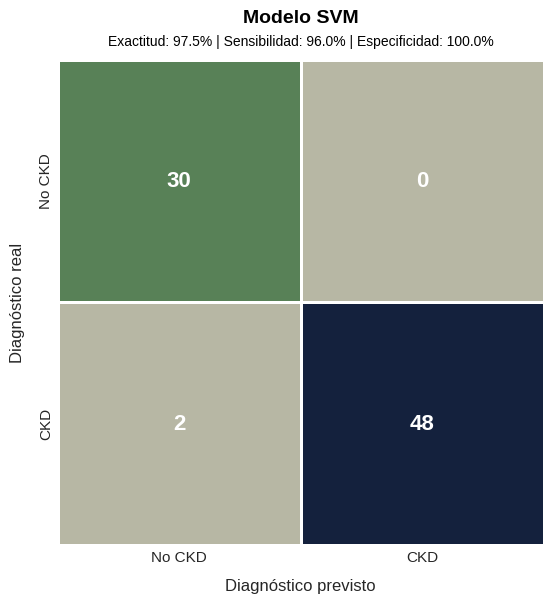

In [ ]:
plot_confusion_matrix(y_test, y_pred, model_name='Modelo SVM')

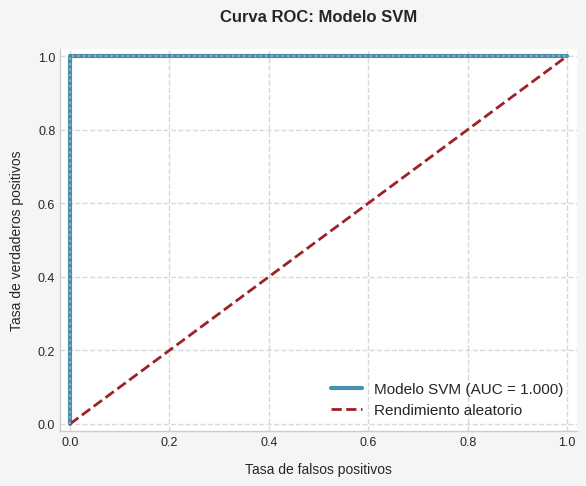

In [ ]:
plot_roc_curve(y_test, y_proba, model_name='Modelo SVM')

Para comprender mejor el funcionamiento interno del modelo SVM con núcleo sigmoidal, hemos implementado una estrategia basada en la importancia de permutación. Este método evalúa la relevancia de cada variable midiendo el impacto en el desempeño del modelo cuando los valores de dicha característica son aleatoriamente permutados. Es una técnica agnóstica al modelo, lo que significa que no depende de cómo esté construido internamente.

En este caso, el análisis se realiza posterior al entrenamiento del mejor modelo SVM y utilizando únicamente el conjunto de prueba, con el fin de evitar sesgos y evaluar la importancia de las variables en datos no vistos. Además, se omite cualquier técnica de sobremuestreo (como `SMOTE`) durante esta evaluación para mantener la objetividad.


🔹 Cálculo de la importancia de las características mediante la importancia de permutación:
  Característica  Importancia  Std
0         win_sg         0.16 0.03
2        sqrt_al         0.16 0.04
1      sqrt_hemo         0.04 0.02
3        log_pcv         0.04 0.03
5         log_sc        -0.00 0.01
4         win_rc        -0.00 0.01




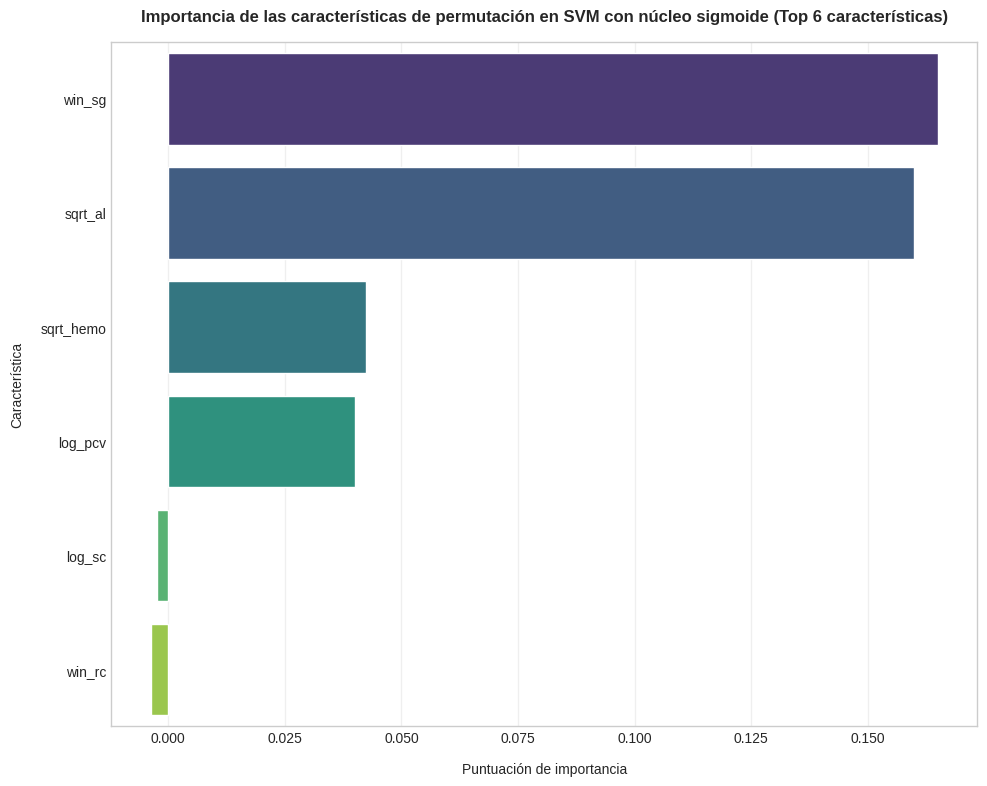

['svm_sigmoid_model.pkl']

In [ ]:
# Utilizando únicamente el método de importancia de permutación para SVM
def calculate_permutation_importance(model, X, y):
    """Calcular la importancia de las características mediante la importancia de la permutación"""

    # Para el pipeline, primero debemos transformar los datos antes de dar importancia a la permutación.
    X_transformed = X.copy()
    if hasattr(model, 'named_steps'):
        if 'smote' in model.named_steps:
            # Omitir SMOTE para fines de evaluación
            pass
        if 'scaler' in model.named_steps:
            X_transformed = model.named_steps['scaler'].transform(X_transformed)

    # Extraer el modelo SVM del pipeline
    svm_model = model.named_steps['svm'] if hasattr(model, 'named_steps') else model

    # Calcular la importancia de la permutación
    result = permutation_importance(
        svm_model, X_transformed, y,
        n_repeats=10, random_state=RANDOM_STATE, n_jobs=-1
    )

    # Create a DataFrame for the importance scores
    importance_df = pd.DataFrame({
        'Característica': X.columns,
        'Importancia': result.importances_mean,
        'Std': result.importances_std
    })

    # Ordenar por importancia
    importance_df = importance_df.sort_values(by='Importancia', ascending=False)

    return importance_df

# Plot de la importancia de las características
def plot_feature_importance(importance_df, title, top_n=15):
    plt.figure(figsize=(10, 8))

    # Obtener las N mejores funciones
    if len(importance_df) > top_n:
        plot_df = importance_df.head(top_n)
    else:
        plot_df = importance_df

    # Crear un gráfico de barras horizontales
    sns.barplot(x='Importancia', y='Característica', data=plot_df, palette='viridis')
    plt.title(f'{title} (Top {len(plot_df)} características)', fontsize=12, fontweight='bold', pad=15)
    plt.xlabel('Puntuación de importancia', fontsize=10, labelpad=12)
    plt.ylabel('Característica', fontsize=10, labelpad=12)
    plt.tight_layout()
    plt.show()
    print("\n")

    return plot_df

# Calcular y graficar la importancia de las características
print("\n🔹 Cálculo de la importancia de las características mediante la importancia de permutación:")
perm_importance = calculate_permutation_importance(svm_best, X_test, y_test)
print(perm_importance)
print("\n")
plot_feature_importance(perm_importance, 'Importancia de las características de permutación en SVM con núcleo sigmoide')

import joblib
joblib.dump(svm_best, 'svm_sigmoid_model.pkl')

### 6.5. Comparación de los modelos finales

Una vez entrenados y ajustados los distintos modelos de clasificación, resulta fundamental realizar una evaluación comparativa que permita identificar cuál de ellos presenta un mejor desempeño general frente al conjunto de prueba.

Para ello, lo primero que hemos decidido es emplear diversas métricas de evaluación: exactitud, precisión, exhaustividad (recall), especificidad y F1-score.

Todos los modelos se cargaron exitosamente.

🔹 Forma del conjunto de prueba: (100, 6)

📊 Evaluación de modelos

🔍 Evaluando: LDA

📋 Reporte de clasificación:
              precision    recall  f1-score   support

           0     0.8636    1.0000    0.9268        38
           1     1.0000    0.9032    0.9492        62

    accuracy                         0.9400       100
   macro avg     0.9318    0.9516    0.9380       100
weighted avg     0.9482    0.9400    0.9407       100


🔍 Evaluando: QDA

📋 Reporte de clasificación:
              precision    recall  f1-score   support

           0     0.9268    1.0000    0.9620        38
           1     1.0000    0.9516    0.9752        62

    accuracy                         0.9700       100
   macro avg     0.9634    0.9758    0.9686       100
weighted avg     0.9722    0.9700    0.9702       100


🔍 Evaluando: SVM (sigmoide)

📋 Reporte de clasificación:
              precision    recall  f1-score   support

           0     0.9500    1

,Exactitud,Precisión,Exhaustividad,Especificidad,F1 Score
SVM (sigmoide),0.9800,1.0000,0.9677,1.0000,0.9836
QDA,0.9700,1.0000,0.9516,1.0000,0.9752
LDA,0.9400,1.0000,0.9032,1.0000,0.9492


<Figure size 1000x600 with 0 Axes>

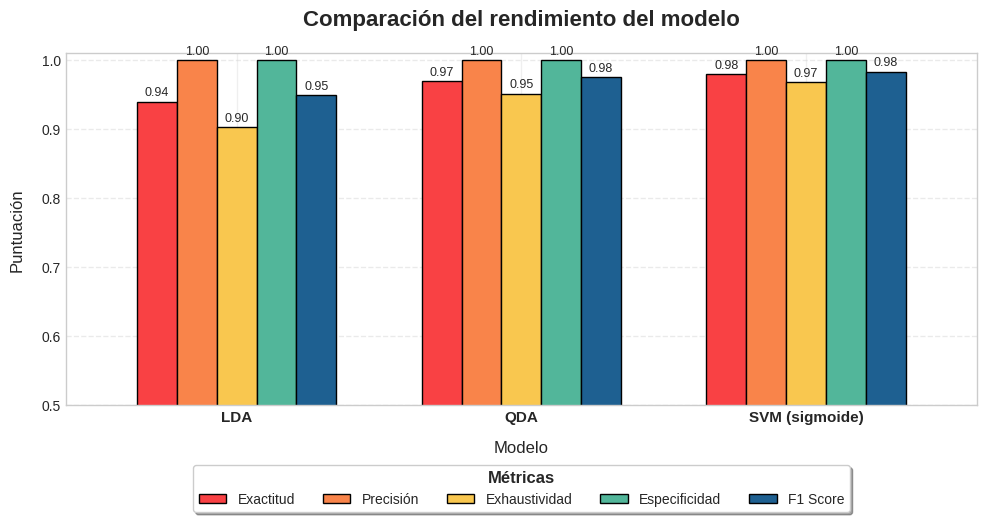

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import f1_score, recall_score, precision_score, roc_curve, auc
import joblib

# Constantes
FEATURES = ['win_sg', 'sqrt_hemo','sqrt_al','log_pcv','win_rc','log_sc']

# Definir constantes faltantes
TEST_SIZE = 0.25
RANDOM_STATE = 42

# Cargar los modelos pre-entrenados
try:
    lda_model = joblib.load('/content/lda_model.pkl')
    qda_model = joblib.load('/content/qda_model.pkl')
    svm_model = joblib.load('/content/svm_sigmoid_model.pkl')

    models = {
        'LDA': lda_model,
        'QDA': qda_model,
        'SVM (sigmoide)': svm_model
    }
    print("Todos los modelos se cargaron exitosamente.")

except Exception as e:
    print(f"Error al cargar modelos: {e}")
    exit(1)

X = df[FEATURES]
y = df['classification_ckd']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y
)

print(f"\n🔹 Forma del conjunto de prueba: {X_test.shape}")

# Función para evaluar todos los modelos
def evaluate_models(models, X_test, y_test):
    results = {}
    roc_data = {}

    print("\n"+"="*40)
    print("📊 Evaluación de modelos")
    print("="*40)

    for name, model in models.items():
        print(f"\n🔍 Evaluando: {name}")

        y_pred = model.predict(X_test)

        if hasattr(model, 'predict_proba'):
            y_proba = model.predict_proba(X_test)[:, 1]
        else:
            y_proba = None

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        specificity = recall_score(y_test, y_pred, pos_label=0)
        f1 = f1_score(y_test, y_pred)

        results[name] = {
            'Exactitud': round(accuracy, 4),
            'Precisión': round(precision, 4),
            'Exhaustividad': round(recall, 4),
            'Especificidad': round(specificity, 4),
            'F1 Score': round(f1, 4)
        }

        if y_proba is not None:
            fpr, tpr, _ = roc_curve(y_test, y_proba)
            roc_auc = auc(fpr, tpr)
            roc_data[name] = {'fpr': fpr, 'tpr': tpr, 'auc': roc_auc}

        print("\n📋 Reporte de clasificación:")
        print(classification_report(y_test, y_pred, digits=4))

    # Mostrar tabla comparativa mejorada
    df_results = pd.DataFrame(results).T
    df_results = df_results.sort_values(by="F1 Score", ascending=False)

    print("\n🔹 Comparación de las métricas de rendimiento de cada modelo:\n")

    # Mejorando el estilo de la tabla
    styled_table = df_results.style \
        .format("{:.4f}") \
        .set_properties(**{
            'text-align': 'center',
            'font-weight': 'bold',
            'border': '1px solid #ddd',
            'padding': '8px',
            'background-color': 'white',
            'color': 'black'
        }) \
        .set_table_styles([
            {'selector': 'th', 'props': [
                ('text-align', 'center'),
                ('background-color', '#457b9d'),
                ('color', 'white'),
                ('font-size', '12px'),
                ('border', '1px solid #000000')
            ]},
            {'selector': 'caption', 'props': [
                ('caption-side', 'top'),
                ('font-size', '16px'),
                ('color', '#000000')
            ]},
            {'selector': 'td', 'props': [
                ('border', '1px solid #000000'),
                ('color', 'black')
            ]}
        ])

    display(styled_table)
    print("\n")

    return results, roc_data

# Evaluar todos los modelos
results, roc_data = evaluate_models(models, X_test, y_test)

# Crear un DataFrame de comparación
df_results = pd.DataFrame(results).T

# Determinar el mejor modelo según la puntuación F1
best_metric = 'F1 Score'
best_model = df_results[best_metric].idxmax()

def plot_comparison_bar_chart(df_results, title="Comparación del rendimiento del modelo", y_min=0.5):
    plt.figure(figsize=(10, 6), facecolor='white')

    custom_palette = ['#f94144', '#f9844a', '#f9c74f', '#52b69a', '#1e6091']

    # Gráfico de barras con la paleta
    ax = df_results.plot(
        kind='bar',
        figsize=(10, 6),
        color=custom_palette,
        edgecolor='black',
        width=0.7
    )

    # Etiquetas de valores en las barras
    for container in ax.containers:
        ax.bar_label(container, fmt='%.2f', label_type='edge', fontsize=9, padding=2)

    plt.title(title, fontsize=16, weight='bold', pad=20)
    plt.ylabel('Puntuación', fontsize=12, labelpad=12)
    plt.xlabel('Modelo', fontsize=12, labelpad=12)
    plt.xticks(rotation=0, fontsize=11, fontweight='bold')
    plt.yticks(fontsize=10)
    plt.ylim([y_min, 1.01])

    plt.grid(axis='y', linestyle='--', alpha=0.4)

    # Cambiar la posición de la leyenda para que ocupe todo el ancho en la parte inferior
    legend = plt.legend(
        title='Métricas',
        fontsize=10,
        loc='upper center',
        bbox_to_anchor=(0.5, -0.15),
        frameon=True,
        ncol=5,
        shadow=True,
        fancybox=True
    )

    legend.get_title().set_fontweight('bold')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Ajustar para dejar espacio a la leyenda
    plt.show()

# Generar visualizaciones de comparación con los cambios solicitados
plot_comparison_bar_chart(df_results)

Además de las métricas tradicionales, es importante analizar la capacidad discriminativa de los modelos mediante las curvas ROC. Estas curvas permiten visualizar el compromiso entre la tasa de verdaderos positivos (TPR) y la tasa de falsos positivos (FPR) para distintos umbrales de decisión. Acompañadas del valor del AUC, brindan una visión clara del rendimiento global de cada modelo.

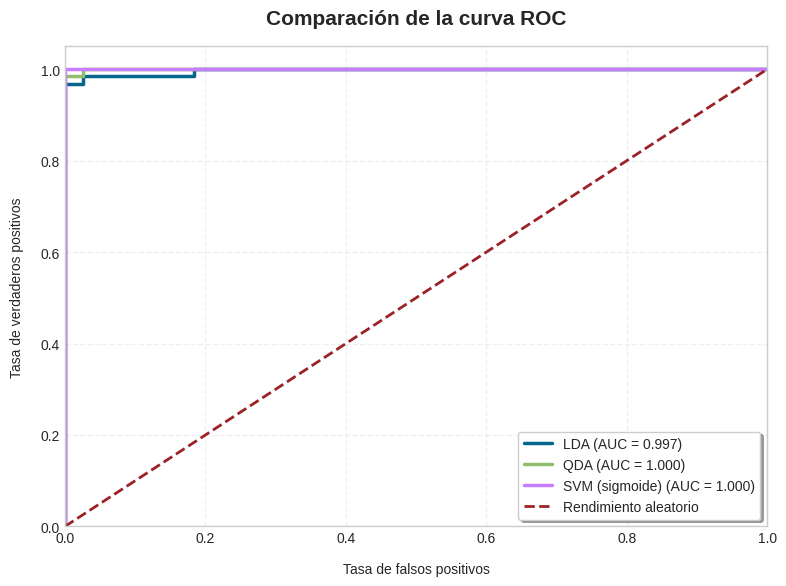

In [ ]:
def plot_roc_curves(roc_data, title="Comparación de la curva ROC"):
    plt.figure(figsize=(8, 6), facecolor='white')

    # Paleta de colores
    palette = ['#05668d', '#90be6d', '#c77dff']

    for (name, data), color in zip(roc_data.items(), palette):
        plt.plot(
            data['fpr'], data['tpr'],
            label=f'{name} (AUC = {data["auc"]:.3f})',
            linewidth=2.5,
            color=color
        )

    # Línea de referencia diagonal
    plt.plot([0, 1], [0, 1], color='#9b2226', linestyle='--', lw=2,
             label='Rendimiento aleatorio')

    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de falsos positivos', fontsize=10, labelpad=12)
    plt.ylabel('Tasa de verdaderos positivos', fontsize=10, labelpad=12)
    plt.title(title, fontsize=15, weight='bold', pad=16)
    plt.grid(alpha=0.3, linestyle='--')
    plt.legend(loc='lower right', fontsize=10, frameon=True, shadow=True)

    plt.tight_layout()
    plt.show()

plot_roc_curves(roc_data)

Finalmente, para complementar el análisis comparativo, se visualizan las matrices de confusión de cada modelo. Estas matrices permiten observar detalladamente la distribución de aciertos y errores, diferenciando entre verdaderos positivos, verdaderos negativos, falsos positivos y falsos negativos.

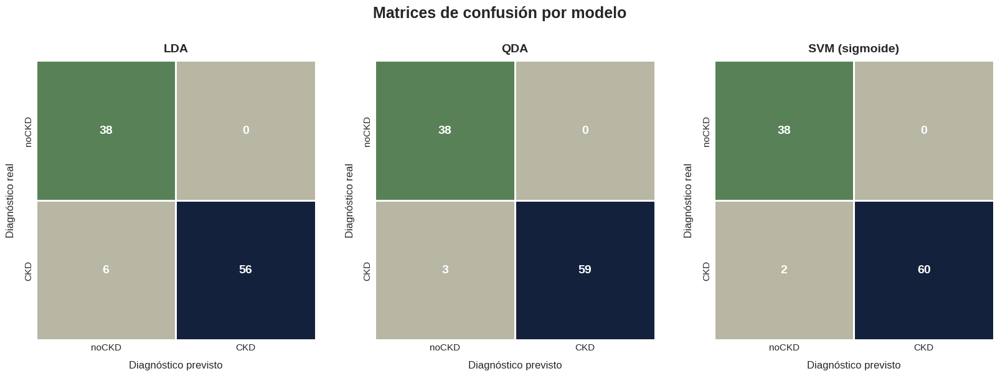

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
from matplotlib.colors import ListedColormap

def plot_confusion_matrices(models, X_test, y_test, class_names=None):
    if class_names is None:
        class_names = ['noCKD', 'CKD']

    n_models = len(models)
    fig, axes = plt.subplots(1, n_models, figsize=(n_models * 5.5, 5.5), facecolor='white')

    # Asegurar que axes sea iterable
    if n_models == 1:
        axes = [axes]

    for i, (name, model) in enumerate(models.items()):
        y_pred = model.predict(X_test)
        cm = confusion_matrix(y_test, y_pred)

        ax = axes[i]

        colors = ['#b7b7a4', '#b7b7a4', '#588157', '#14213d']
        cmap = ListedColormap(colors)

        sns.heatmap(cm, annot=True, fmt='d', cmap=cmap, cbar=False,
                    annot_kws={'size': 14, 'weight': 'bold', 'color': 'white'}, square=True,
                    xticklabels=class_names, yticklabels=class_names, ax=ax, linewidths=1, linecolor='white')

        ax.set_xlabel('Diagnóstico previsto', fontsize=12, labelpad=10)
        ax.set_ylabel('Diagnóstico real', fontsize=12, labelpad=10)
        ax.set_title(f'{name}', fontsize=14, weight='bold', pad=10)
        ax.tick_params(axis='both', which='major', labelsize=11)

    fig.suptitle("Matrices de confusión por modelo", fontsize=18, weight='bold', y=1.05)
    plt.tight_layout()
    plt.show()

plot_confusion_matrices(models, X_test, y_test)

Después de evaluar y comparar el desempeño de todos los modelos, hemos decido identificar el modelo con el mejor rendimiento según la métrica F1 Score y mostrar un resumen detallado de sus principales métricas. Proporcionando así una visión integral de su efectividad en la clasificación.

In [ ]:
print("\n" + "="*46)
print(f"🥇 Resumen del mejor modelo: {best_model}")
print("="*46)
print(f"Métricas de rendimiento:")
for metric, value in df_results.loc[best_model].items():
    print(f"- {metric}: {value:.4f}")

if best_model in roc_data:
    print(f"- AUC: {roc_data[best_model]['auc']:.4f}")


🥇 Resumen del mejor modelo: SVM (sigmoide)
Métricas de rendimiento:
- Exactitud: 0.9800
- Precisión: 1.0000
- Exhaustividad: 0.9677
- Especificidad: 1.0000
- F1 Score: 0.9836
- AUC: 1.0000


El modelo SVM con kernel sigmoide demuestra ser el modelo más efectivo para la clasificación de ERC, destacándose especialmente por su capacidad para identificar correctamente los casos positivos (recall), sin comprometer la precisión global del modelo. Esta característica resulta fundamental en contextos clínicos, donde los falsos negativos pueden tener consecuencias críticas.

Si bien la diferencia de rendimiento entre los tres modelos evaluados fue estadísticamente significativa, incluso el modelo más simple (LDA) mostró resultados clínicamente útiles, con una exactitud del 94% y una precisión perfecta en la detección de casos positivos, lo que lo convierte en una opción válida cuando se prioriza la interpretabilidad y eficiencia computacional.

QDA, por su parte, presentó un equilibrio notable entre simplicidad y desempeño, mostrando un rendimiento robusto en métricas clave como accuracy, recall y F1-score. Su capacidad para modelar covarianzas distintas por clase le permitió adaptarse mejor a la heterogeneidad propia de los datos clínicos.

LDA, aunque limitado por suponer fronteras lineales y covarianzas iguales entre clases, constituye una base sólida y fácilmente interpretable para la clasificación inicial, siendo ideal para entornos con recursos computacionales limitados o cuando se requiere una explicación clara del proceso diagnóstico.

**Consideraciones y perspectiva a futuro:**

La elección final del modelo dependerá del balance entre rendimiento diagnóstico, interpretabilidad clínica y recursos computacionales disponibles en el entorno de aplicación.

En escenarios clínicos donde la transparencia del modelo es prioritaria, LDA o QDA podrían ser preferidos. Sin embargo, cuando el objetivo es maximizar la detección de casos, como por ejemplo en fases tempranas del cribado poblacional, modelos más sofisticados como SVM son altamente recomendables.

Además, consideramos que dado el sólido rendimiento individual de cada modelo, una estrategia de ensamblado (ensemble), como  stacking, podría representar un paso evolutivo relevante. Este enfoque permitiría combinar las fortalezas particulares de cada técnica: la flexibilidad de QDA, la capacidad no lineal de SVM y la estabilidad interpretativa de LDA. En conjunto, ello podría mejorar aún más la capacidad predictiva, captando interacciones complejas y reduciendo la varianza del modelo final.

**Comparación técnica de los modelos:**

*   LDA: asume covarianzas iguales y separación lineal entre clases. Su rendimiento se ve limitado en presencia de relaciones no lineales o clases con diferentes estructuras de dispersión.
*   QDA: relaja la restricción de covarianza, permitiendo bordes de decisión cuadráticos. Esto le otorga mayor flexibilidad y lo hace más adecuado para conjuntos de datos clínicos diversos.
*   SVM con kernel sigmoide: no impone supuestos sobre la distribución de los datos. Construye fronteras no lineales óptimas, lo que lo hace especialmente útil frente a solapamientos o presencia de valores atípicos.

En el contexto de la clasificación de ERC, donde las relaciones entre variables pueden ser complejas, no lineales y heterogéneas, es esperable que modelos como QDA y SVM superen consistentemente a LDA.

## 7. Ensemble learning

### 7.1. Stacking Ensemble (Ensamblado en Pilas)

El Stacking Ensemble, también conocido como stacked generalization, es una técnica de aprendizaje supervisado que combina múltiples modelos base para mejorar el rendimiento predictivo. Esta técnica permite integrar modelos heterogéneos, aprovechando sus fortalezas individuales para obtener una predicción final más robusta, y se considera particularmente eficaz cuando se busca reducir tanto el sesgo como la varianza del modelo global.

El fundamento teórico radica en que stacking se organiza en dos niveles:
1. Modelos de nivel base (nivel 0): diversos modelos (regresión lineal, SVM, árboles, etc.) se entrenan sobre el conjunto de entrenamiento original.
2. Modelo meta (nivel 1): un nuevo modelo (llamado meta-modelo o blender) se entrena usando como entrada las predicciones generadas por los modelos de nivel base. Este modelo aprende a combinar dichas predicciones para generar el resultado final.

La arquitectura general puede representarse así:

<pre><code>Entrada → Modelos base → Predicciones base → Meta-modelo → Predicción final</code></pre>

Para evitar el sobreajuste durante el entrenamiento del meta-modelo, típicamente se utiliza un esquema de validación cruzada para generar las predicciones del nivel base. Esto garantiza que las predicciones utilizadas como entrada del modelo meta sean realistas, es decir, provengan de modelos entrenados en datos distintos a los evaluados.

Algunos factores que debemos considerar son los siguientes:
*   Ventajas:
    *   Combinación de fortalezas: al incorporar modelos diferentes, stacking puede capturar patrones que un único modelo no detectaría.
    *   Reducción del error general: mejora tanto el sesgo (por usar modelos complejos) como la varianza (por integrar modelos simples), equilibrando los errores típicos del aprendizaje automático.
    *   Alta flexibilidad: permite usar cualquier combinación de modelos base y cualquier tipo de meta-modelo.
*   Limitaciones:
    *   Complejidad computacional: entrenar varios modelos y coordinar sus salidas requiere mayor capacidad computacional y más tiempo.
    *   Riesgo de sobreajuste: si no se maneja adecuadamente la validación cruzada para generar las predicciones del nivel base, el meta-modelo puede sobreajustarse fácilmente a los datos de entrenamiento.
    *   Difícil interpretación: debido a su arquitectura en múltiples capas, los modelos de stacking son menos interpretables que modelos individuales, lo cual puede ser una desventaja en contextos donde se requiere explicabilidad.

La elección del enfoque Stacking se fundamenta en su capacidad para integrar modelos base de naturaleza diversa (como SVM, LDA y QDA), aprovechando de forma sinérgica sus respectivas fortalezas. Esta técnica de ensamblado se caracteriza por su estructura jerárquica, en la que un modelo meta-aprendiz es entrenado para combinar las predicciones de los modelos base, con el objetivo de mejorar el rendimiento general del sistema.

El principal atractivo del stacking radica en su habilidad para capturar patrones complementarios que individualmente podrían ser pasados por alto por modelos específicos. Por ejemplo, como hemos mencionado anteriormente, en nuestro caso podriamos fusionar la flexibilidad de QDA, la capacidad no lineal de SVM y la estabilidad interpretativa de LDA.

Todas esas razones lo convierten en un enfoque especialmente valioso en problemas complejos y heterogéneos como el que presenta nuesto contexto clínico.

Una vez comprendida la teoría que sustenta el enfoque de Stacking Ensemble, procedemos a su implementación práctica en el contexto de clasificación binaria, utilizando modelos previamente entrenados: LDA, QDA y SVM con kernel sigmoidal. El objetivo es combinar estos clasificadores base mediante un meta-modelo (`GradientBoostingClassifier`) con el fin de mejorar la capacidad predictiva global.

El proceso completo de implementación se estructura en varias etapas fundamentales:
1. Carga de modelos preentrenados: partimos de los tres clasificadores previamente entrenados y almacenados en disco. Estos modelos actúan como estimadores base dentro del ensamblado.
2. Preparación del conjunto de datos: el conjunto de datos original es segmentado en características predictoras (X) y variable objetivo (y). Posteriormente, se realiza una partición estratificada en conjuntos de entrenamiento y prueba, asegurando que la proporción entre clases se mantenga constante en ambas divisiones.
3. Balanceo de clases: con el objetivo de mitigar el sesgo inducido por un desbalance de clases, se aplica la técnica Synthetic Minority Over-sampling Technique (`SMOTE`). Este método genera muestras sintéticas de la clase minoritaria a partir de interpolaciones entre vecinos cercanos.
4. Normalización de características: antes del entrenamiento, las variables predictoras se escalan utilizando una normalización estándar (`StandardScaler`), la cual transforma los datos para que cada característica tenga media cero y desviación estándar uno.
5. Construcción y entrenamiento del modelo de ensamblado: se construye un `StackingClassifier` utilizando los tres clasificadores base mencionados anteriormente como estimadores iniciales. La salida de estos modelos se utiliza para alimentar un modelo meta (en nuestro caso, una regresión logística) que aprende a combinar las predicciones de los modelos base de forma óptima. El entrenamiento del ensamblado se realiza utilizando validación cruzada interna (por defecto con 5 particiones), lo que permite generar metacaracterísticas robustas sin requerir un conjunto de validación explícito.
6. Evaluación comparativa de modelos: finalmente, se realiza una evaluación detallada de los modelos sobre el conjunto de prueba. En particular, se comparan las métricas de desempeño del modelo SVM individual frente al ensamblado de stacking, permitiendo determinar si la combinación de modelos mejora efectivamente la capacidad predictiva. Las métricas consideradas incluyen exactitud, precisión, exhaustividad, especificidad, F1-score y el área bajo la curva ROC (AUC).



In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import StackingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.metrics import f1_score, recall_score, precision_score, roc_curve, auc
import joblib
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import GradientBoostingClassifier

final_model = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, random_state=RANDOM_STATE)

# Constantes
RANDOM_STATE = 42
TEST_SIZE = 0.2
FEATURES = ['win_sg', 'sqrt_hemo','sqrt_al','log_pcv','win_rc','log_sc']

# Cargar los modelos pre-entrenados
try:
    lda_model = joblib.load('lda_model.pkl')
    qda_model = joblib.load('qda_model.pkl')
    svm_model = joblib.load('svm_sigmoid_model.pkl')
    print("Todos los modelos se cargaron correctamente.")
except Exception as e:
    print(f"Error al cargar modelos: {e}")
    exit(1)

# Preparando el dataset
X = df[FEATURES]
y = df['classification_ckd']

# Dividir datos con el mismo random state que se utilizó durante el entrenamiento
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=TEST_SIZE, random_state=RANDOM_STATE, stratify=y
)

print(f"\n🔹 Forma del conjunto de entrenamiento: {X_train.shape}")
print(f"🔹 Forma del conjunto de prueba: {X_test.shape}")

# Extraer el clasificador real de los pipelines si es necesario
def extract_classifier(model):
    if hasattr(model, 'named_steps'):
        for step_name in ['lda', 'qda', 'svm']:
            if step_name in model.named_steps:
                return model.named_steps[step_name]
    return model

# Clasificadores de extracción
lda_clf = extract_classifier(lda_model)
qda_clf = extract_classifier(qda_model)
svm_clf = extract_classifier(svm_model)

# Aplicar preprocesamiento antes de apilar (en lugar de anidar pipelines)
# Aplicar SMOTE para el equilibrio de clases
smote = SMOTE(random_state=RANDOM_STATE)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Escalar las características
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)  # Utilizar el mismo escalador para los datos de prueba

# Crear un conjunto de apilamiento directamente con datos preprocesados
stacking_clf = StackingClassifier(
    estimators=[
        ('lda', lda_clf),
        ('qda', qda_clf),
        ('svm', svm_clf)
    ],
    final_estimator=final_model,
    cv=5  # Validación cruzada de 5 pasos para generar metacaracterísticas
)

# Entrenar el conjunto de apilamiento
stacking_clf.fit(X_train_scaled, y_train_resampled)

# Evaluar modelos SVM y de apilamiento
def evaluate_model(model, name, X_data, y_test, preprocess=False):
    print("\n"+"="*35)
    print(f"🔎 Evaluando: {name}")
    print("="*35)

    # Aplicar preprocesamiento si es necesario
    X_eval = X_data
    if preprocess and hasattr(model, 'predict'):
        y_pred = model.predict(X_eval)
        if hasattr(model, 'predict_proba'):
            y_proba = model.predict_proba(X_eval)[:, 1]
        else:
            y_proba = None
    else:
        # Predicción directa (para apilar clasificadores que ya tienen datos preprocesados)
        y_pred = model.predict(X_eval)
        if hasattr(model, 'predict_proba'):
            y_proba = model.predict_proba(X_eval)[:, 1]
        else:
            y_proba = None

    # Calcular métricas
    results = {
        'Exactitud': accuracy_score(y_test, y_pred),
        'Precisión': precision_score(y_test, y_pred),
        'Exhaustividad': recall_score(y_test, y_pred),
        'Especificidad': recall_score(y_test, y_pred, pos_label=0),
        'F1 Score': f1_score(y_test, y_pred)
    }

    # Imprimir métricas
    print("Métricas:")
    for metric, value in results.items():
        print(f"- {metric}: {value:.4f}")

    # Imprimir informe de clasificación
    print(f"\n📋 Informe de clasificación para {name}:")
    print(classification_report(y_test, y_pred))

    # Matriz de confusión
    cm = confusion_matrix(y_test, y_pred)

    # Datos ROC
    roc_data = None
    if y_proba is not None:
        fpr, tpr, _ = roc_curve(y_test, y_proba)
        roc_auc = auc(fpr, tpr)
        roc_data = {
            'fpr': fpr,
            'tpr': tpr,
            'auc': roc_auc
        }
        print(f"- AUC: {roc_auc:.4f}")

    return results, cm, roc_data

# Evaluar ambos modelos
svm_results, svm_cm, svm_roc = evaluate_model(svm_model, "SVM (sigmoidal)", X_test, y_test, preprocess=True)
stacking_results, stacking_cm, stacking_roc = evaluate_model(stacking_clf, "Stacking Ensemble", X_test_scaled, y_test)

Todos los modelos se cargaron correctamente.

🔹 Forma del conjunto de entrenamiento: (320, 6)
🔹 Forma del conjunto de prueba: (80, 6)

🔎 Evaluando: SVM (sigmoidal)
Métricas:
- Exactitud: 0.9750
- Precisión: 1.0000
- Exhaustividad: 0.9600
- Especificidad: 1.0000
- F1 Score: 0.9796

📋 Informe de clasificación para SVM (sigmoidal):
              precision    recall  f1-score   support

           0       0.94      1.00      0.97        30
           1       1.00      0.96      0.98        50

    accuracy                           0.97        80
   macro avg       0.97      0.98      0.97        80
weighted avg       0.98      0.97      0.98        80

- AUC: 1.0000

🔎 Evaluando: Stacking Ensemble
Métricas:
- Exactitud: 1.0000
- Precisión: 1.0000
- Exhaustividad: 1.0000
- Especificidad: 1.0000
- F1 Score: 1.0000

📋 Informe de clasificación para Stacking Ensemble:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        30
           1      

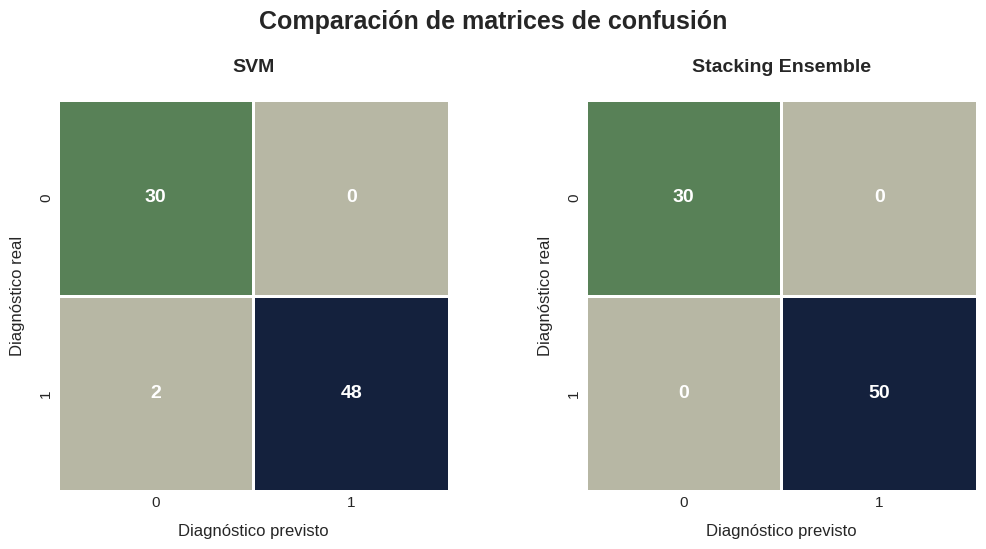

In [ ]:
def plot_confusion_matrices(qda_cm, stacking_cm):
    # Crear una figura con subparcelas para QDA y matrices de confusión de apilamiento
    fig, axes = plt.subplots(1, 2, figsize=(10, 7), facecolor='white')

    from matplotlib.colors import ListedColormap

    colors = ['#b7b7a4', '#b7b7a4', '#588157', '#14213d']
    cmap = ListedColormap(colors)

    # Matriz de confusión de QDA
    sns.heatmap(qda_cm, annot=True, fmt='d', cmap=cmap, cbar=False,
                annot_kws={'size': 14, 'weight': 'bold', 'color': 'white'}, square=True,
                ax=axes[0], linewidths=1, linecolor='white')
    axes[0].set_xlabel('Diagnóstico previsto', fontsize=12, labelpad=10)
    axes[0].set_ylabel('Diagnóstico real', fontsize=12, labelpad=10)
    axes[0].set_title('SVM', fontsize=14, weight='bold', pad=20)
    axes[0].tick_params(axis='both', labelsize=12)

    # Matriz de confusión de conjuntos de apilamiento
    sns.heatmap(stacking_cm, annot=True, fmt='d', cmap=cmap, cbar=False,
                annot_kws={'size': 14, 'weight': 'bold', 'color': 'white'}, square=True,
                ax=axes[1], linewidths=1, linecolor='white')
    axes[1].set_xlabel('Diagnóstico previsto', fontsize=12, labelpad=10)
    axes[1].set_ylabel('Diagnóstico real', fontsize=12, labelpad=10)
    axes[1].set_title('Stacking Ensemble', fontsize=14, weight='bold', pad=20)
    axes[1].tick_params(axis='both', labelsize=12)

    # Aplicar tick_params a cada eje individualmente, no al array completo
    for ax in axes:
        ax.tick_params(axis='both', which='major', labelsize=11)

    fig.suptitle("Comparación de matrices de confusión", fontsize=18, weight='bold', y=0.87)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9, wspace=0.35)
    plt.savefig('svm_vs_stacking_cm.png', dpi=300)
    plt.show()

plot_confusion_matrices(svm_cm, stacking_cm)

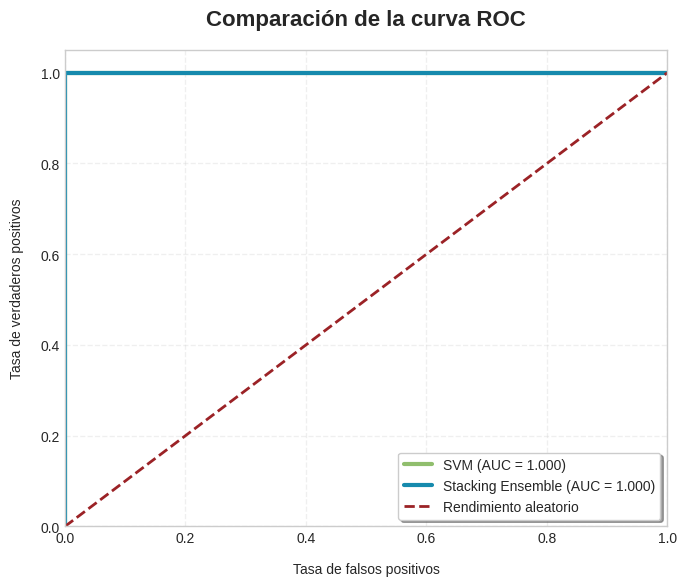

In [ ]:
def plot_roc_curves(qda_roc, stacking_roc):
    plt.figure(figsize=(7, 6), facecolor='white')

    # Plot la curva ROC de QDA
    plt.plot(
        qda_roc['fpr'], qda_roc['tpr'],
        label=f'SVM (AUC = {qda_roc["auc"]:.3f})',
        color='#90be6d', linewidth=3, linestyle='-'
    )

    # Plot la curva ROC de apilamiento
    plt.plot(
        stacking_roc['fpr'], stacking_roc['tpr'],
        label=f'Stacking Ensemble (AUC = {stacking_roc["auc"]:.3f})',
        color='#168aad', linewidth=3, linestyle='-'
    )

    # Línea de referencia diagonal
    plt.plot([0, 1], [0, 1], color='#9b2226', linestyle='--', lw=2,
             label='Rendimiento aleatorio')

    # Personalizar los límites y las etiquetas de los ejes
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('Tasa de falsos positivos', fontsize=10, labelpad=12)
    plt.ylabel('Tasa de verdaderos positivos', fontsize=10, labelpad=12)
    plt.title('Comparación de la curva ROC', fontsize=16, weight='bold', pad=18)

    # Personalizar la leyenda
    plt.legend(loc='lower right', fontsize=10, frameon=True, shadow=True)

    # Estilo de cuadrícula para un mejor contraste visual
    plt.grid(alpha=0.3, linestyle='--')

    # Añadir un diseño limpio y guarda el gráfico
    plt.tight_layout()
    plt.savefig('svm_vs_stacking_roc.png', dpi=300)
    plt.show()

plot_roc_curves(svm_roc, stacking_roc)

Además de las métricas clásicas de evaluación, hemos incorporado una etapa de análisis de importancia de características, específicamente aplicada al modelo de Stacking Ensemble. Esta etapa permite identificar cuáles variables tienen mayor influencia en el desempeño predictivo del modelo.

En este caso, hemos optado por utilizar el enfoque de `permutation_importance`, un método basado en la disminución del rendimiento del modelo cuando se altera aleatoriamente una característica del conjunto de datos. Este es un modelo-agnóstica y mide directamente el impacto de cada variable en la métrica de interés. En este análisis, hemos utilizado la puntuación F1 como criterio de evaluación para capturar un equilibrio entre precisión y exhaustividad.




🔹 Top 10 características más importantes:
     Feature  Importance  Std
2    sqrt_al        0.16 0.02
0     win_sg        0.15 0.02
3    log_pcv        0.06 0.02
5     log_sc        0.05 0.01
1  sqrt_hemo        0.05 0.02
4     win_rc        0.02 0.01




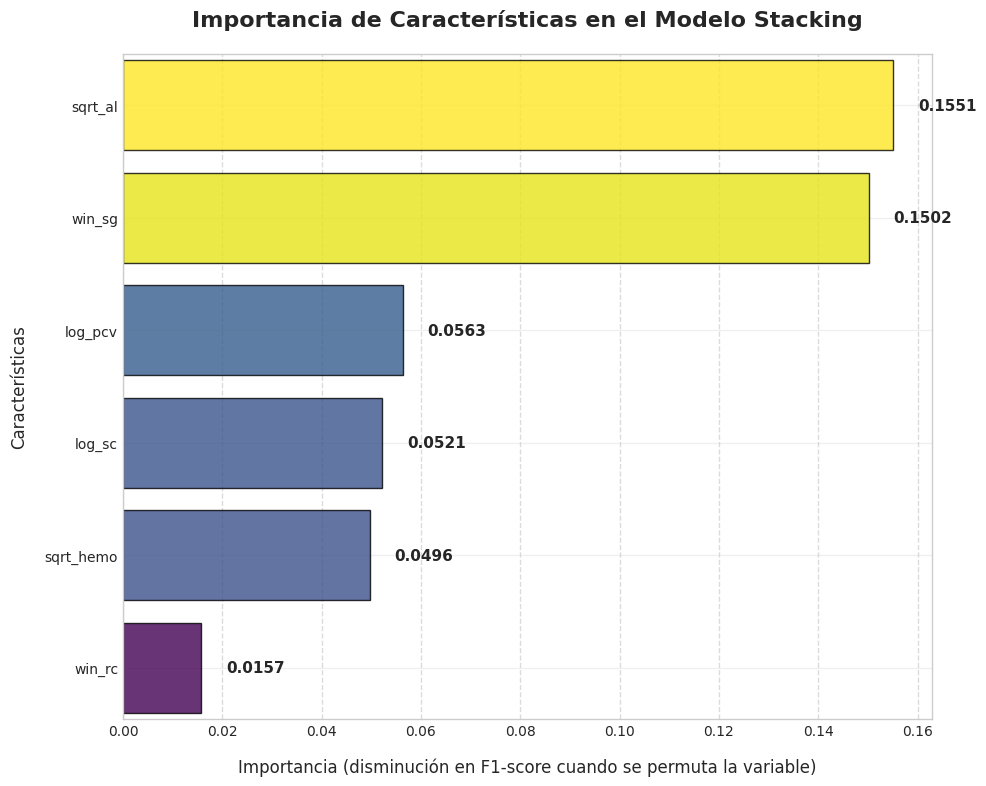

In [ ]:
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

# Establecer el estilo visual
sns.set_style("whitegrid")
plt.rcParams.update({'font.size': 11})

# Calcular la importancia de características mediante permutación
def calculate_feature_importance(model, X, y, feature_names=None):
    """
    Calcula la importancia de las características usando permutation importance
    """

    # Realizar permutation importance
    result = permutation_importance(
        model, X, y,
        n_repeats=10,
        random_state=RANDOM_STATE,
        n_jobs=-1,
        scoring='f1'  # Usar F1 score como métrica
    )

    # Crear un dataframe para facilitar el análisis y visualización
    importances = pd.DataFrame(
        {'Feature': feature_names if feature_names is not None else [f'Feature {i}' for i in range(X.shape[1])],
         'Importance': result.importances_mean,
         'Std': result.importances_std
        })

    # Ordenar por importancia en orden descendente
    importances = importances.sort_values('Importance', ascending=False)

    return importances

# Calcular la importancia para el modelo stacking
stacking_importances = calculate_feature_importance(
    stacking_clf, X_test_scaled, y_test,
    feature_names=FEATURES
)

# Mostrar las características más importantes
print("\n🔹 Top 10 características más importantes:")
print(stacking_importances.head(10))
print("\n")

# Crear una paleta de colores basada en la importancia
n_features = min(15, len(stacking_importances))
importance_norm = (stacking_importances['Importance'][:n_features] -
                   stacking_importances['Importance'][:n_features].min()) / (
                   stacking_importances['Importance'][:n_features].max() -
                   stacking_importances['Importance'][:n_features].min())
colors = plt.cm.viridis(importance_norm)

# Visualizar la importancia de las características
plt.figure(figsize=(10, 8))

# Preparar los datos para la visualización (invertido para mostrar de mayor a menor de arriba a abajo)
features_reversed = stacking_importances['Feature'][:n_features][::-1]
importance_reversed = stacking_importances['Importance'][:n_features][::-1]

# Crear el gráfico de barras sin barras de error
bars = plt.barh(
    features_reversed,
    importance_reversed,
    color=colors[::-1],
    alpha=0.8,
    edgecolor='black',
    linewidth=1
)

# Agregar valores de importancia al final de cada barra
for i, (bar, importance) in enumerate(zip(bars, importance_reversed)):
    # Calcular la posición para el texto
    x_pos = bar.get_width() + 0.005  # Pequeño margen
    y_pos = bar.get_y() + bar.get_height()/2
    plt.text(x_pos, y_pos,
             f'{importance:.4f}',
             va='center',
             fontweight='bold')

# Añadir líneas de cuadrícula para facilitar la lectura
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.xlabel('Importancia (disminución en F1-score cuando se permuta la variable)', fontsize=12, labelpad=14)
plt.ylabel('Características', fontsize=12, labelpad=12)
plt.title('Importancia de características en el Modelo Stacking', fontsize=16, fontweight='bold', pad=20)


plt.tight_layout()
plt.margins(y=0.01)

A continuacion, haremos un análisis de los resultados obtenidos. Lo primero que haremos es interpretar la importancia por característica:
*   `sqrt_al` (0.1551): la albúmina (transformada mediante raíz cuadrada) es la característica más importante. Su permutación causa una reducción del 15.51% en el F1-score, indicando que es crucial para el diagnóstico de enfermedad renal.
*   `win_sg` (0.1502): la gravedad específica de la orina es casi tan importante como la albúmina (15.02%), reflejando la capacidad de concentración renal, deteriorada en la enfermedad.
*   `log_pcv` (0.0563): el volumen celular empaquetado (transformado logarítmicamente) ocupa el tercer lugar con una importancia de 5.63%, reflejando la anemia asociada con enfermedad renal crónica.
*   `log_sc` (0.0521): la creatinina sérica tiene una importancia de 5.21%, siendo un biomarcador estándar de la función renal.
*   `sqrt_hemo` (0.0496): la hemoglobina tiene una importancia del 4.96%, complementando la información del PCV sobre el componente hematológico.
*   `win_rc` (0.0157): los recuentos celulares en orina muestran la menor importancia (1.57%), pero aún contribuyen al modelo.

Por lo que hace al modelo Stacking, este combina las predicciones de varios modelos base mediante un "meta-modelo" que aprende a integrar estas predicciones. Este análisis de importancia revela:
*   Consistencia con modelos individuales: la dominancia de albúmina y gravedad específica coincide con los hallazgos de QDA y otros modelos, lo que refuerza la robustez de estos biomarcadores como indicadores de enfermedad renal.
*   Distribución bimodal de importancia: dos características dominantes (`sqrt_al` y `win_sg`) con aproximadamente 15% de importancia, un grupo intermedio (`log_pcv`, `log_sc`, `sqrt_hemo`) alrededor del 5%, y una característica de baja importancia (`win_rc`).
*   Integración de información complementaria: el modelo valora tanto marcadores de daño glomerular (albúmina) como de función tubular (gravedad específica), e incorpora parámetros bioquímicos (creatinina) y hematológicos (PCV, hemoglobina).

La utilidad clínica del modelo propuesto se manifiesta en varios aspectos fundamentales para el diagnóstico y la toma de decisiones médicas en el contexto de la ERC:
*   Diagnóstico multidimensional: el análisis confirma que un enfoque óptimo para el diagnóstico de enfermedad renal debe incluir pruebas de albuminuria y evaluación de la función de concentración renal.
*   Priorización de pruebas diagnósticas: cuando los recursos son limitados, este análisis sugiere priorizar la medición de albúmina en orina y gravedad específica. Los parámetros hematológicos y la creatinina sérica proporcionan información complementaria importante.
*   Robustez del modelo ensamblado: la distribución de importancia sugiere que el modelo Stacking aprovecha efectivamente múltiples dimensiones de información, mejorando la robustez de las predicciones, lo que puede explicar por qué los modelos de ensamblaje suelen superar a los modelos individuales en clasificación médica.

Finalmente, el análisis destaca la importancia de un enfoque integral en la evaluación de la enfermedad renal, con especial énfasis en los marcadores urinarios como pilares del diagnóstico, complementados por parámetros bioquímicos y hematológicos para una evaluación completa.

<Figure size 1000x600 with 0 Axes>

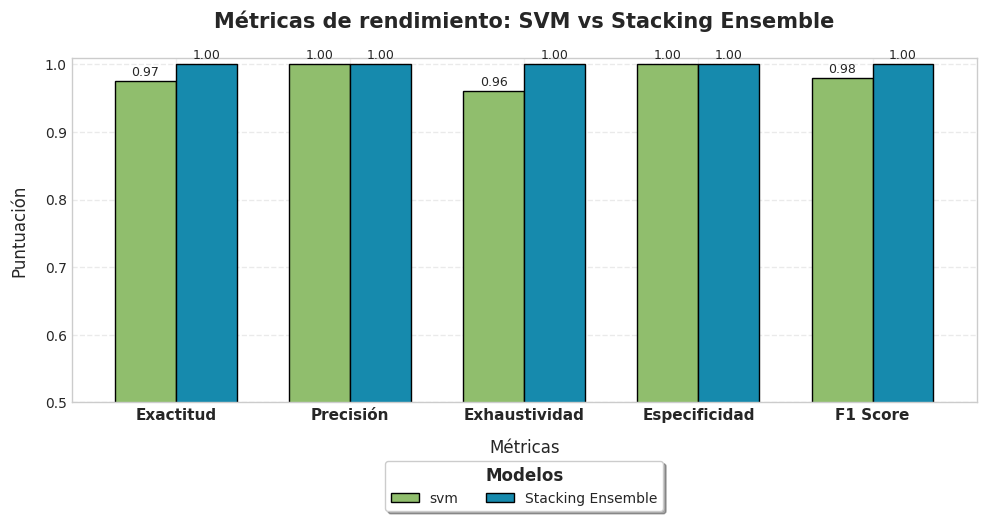


🔹 Comparación de métricas de rendimiento:
               svm  Stacking Ensemble
Exactitud     0.97               1.00
Precisión     1.00               1.00
Exhaustividad 0.96               1.00
Especificidad 1.00               1.00
F1 Score      0.98               1.00


In [ ]:
def plot_metrics_comparison(qda_results, stacking_results, y_min=0.5):
    # Crear un DataFrame para trazar gráficos
    metrics_df = pd.DataFrame({
        'svm': qda_results,
        'Stacking Ensemble': stacking_results
    })

    plt.figure(figsize=(10, 6), facecolor='white')

    custom_palette = ['#90be6d', '#168aad']

    # Gráfico de barras con la paleta
    ax = metrics_df.plot(
        kind='bar',
        figsize=(10, 6),
        color=custom_palette,
        edgecolor='black',
        width=0.7
    )

    # Etiquetas de valores en las barras
    for container in ax.containers:
        ax.bar_label(container, fmt='%.2f', label_type='edge', fontsize=9, padding=2)

    plt.title('Métricas de rendimiento: SVM vs Stacking Ensemble', fontsize=15, weight='bold', pad=22)
    plt.ylabel('Puntuación', fontsize=12, labelpad=12)
    plt.xlabel('Métricas', fontsize=12, labelpad=12)
    plt.xticks(rotation=0, fontsize=11, fontweight='bold')
    plt.yticks(fontsize=10)
    plt.ylim([y_min, 1.01])

    plt.grid(axis='y', linestyle='--', alpha=0.4)

    # Cambiar la posición de la leyenda para que ocupe todo el ancho en la parte inferior
    legend = plt.legend(
        title='Modelos',
        fontsize=10,
        loc='upper center',
        bbox_to_anchor=(0.5, -0.15),
        frameon=True,
        ncol=5,
        shadow=True,
        fancybox=True
    )

    legend.get_title().set_fontweight('bold')
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Ajustar para dejar espacio a la leyenda
    plt.savefig('qda_vs_stacking_metrics.png', dpi=300)
    plt.show()

    return metrics_df

metrics_df = plot_metrics_comparison(svm_results, stacking_results)

# Imprimir tabla comparativa
print("\n🔹 Comparación de métricas de rendimiento:")
print(metrics_df)

Para finalizar el proyecto, hemos realizado una comparación directa entre dos modelos de clasificación: SVM con núcleo sigmoidal y un modelo de Stacking Ensemble, ambos evaluados sobre el conjunto de prueba.

Analizando las matrices de confusión podemos observar que:
*   Support Vector Machine con kernel sigmoidal:
    *   Clasificó correctamente todas las instancias de la clase negativa (0), es decir, no se produjeron falsos positivos.
    *   Sin embargo, presentó un único falso negativo, clasificando erróneamente una instancia de la clase positiva (paciente enfermo) como negativa.
    *   Resultado: 30 verdaderos negativos, 48 verdaderos positivos, 2 falsos negativos, 0 falsos positivos.
*   Stacking Ensemble:
    *   Clasificó correctamente todas las instancias, tanto de la clase positiva como de la negativa.
    *   No se cometieron errores de clasificación, lo cual refleja una capacidad de predicción excepcional.
    *   Resultado perfecto: 30 verdaderos negativos, 50 verdaderos positivos.

Aunque ambos modelos demostraron un rendimiento notable, el modelo Stacking Ensemble logró un desempeño perfecto, superando levemente al SVM al eliminar completamente los errores de clasificación.

Por lo que hace a las métricas de rendimiento:
*   El modelo SVM ofreció un rendimiento sobresaliente, destacándose especialmente por su precisión, especificidad y AUC perfectas.
*   El modelo de Stacking Ensemble alcanzó el 100% en todas las métricas, lo que sugiere una capacidad de generalización superior y una mayor confiabilidad en contextos donde se deben evitar tanto falsos positivos como falsos negativos.

**Conclusión final:**

Ambos modelos presentaron un desempeño excepcional en la tarea de clasificación binaria para la detección de enfermedad renal crónica, evidenciando la calidad del conjunto de datos, el preprocesamiento aplicado y la selección de características llevada a cabo en etapas anteriores del proyecto.

Sin embargo, el modelo de Stacking Ensemble demostró una ligera pero significativa ventaja al evitar completamente cualquier tipo de error de clasificación. Esto lo convierte en la mejor opción para su aplicación en entornos clínicos reales, donde la sensibilidad (identificación de pacientes enfermos) y la precisión (evitar falsos positivos) son de vital importancia.

Además, al tratarse de un modelo basado en la combinación de varios algoritmos base, el Stacking Ensemble logra capturar patrones complejos y complementar las debilidades de modelos individuales, ofreciendo un sistema más robusto y preciso.
